# Natural Language Processing Project Presentation

# Authors:


*   Alessandro Marcassa
*   Lorenzo Franzé
*   Satvik Bisht
*   Teka Kimbi


#Task

1. Medical Meadow Medical Flashcards:

* Website: https://huggingface.co/datasets/medalpaca/medical_meadow_medical_flashcards

* Paper: https://arxiv.org/pdf/2304.08247.pdf
* Description: Information on medical curriculum flashcards has been given to GPT-3.5 and used to
create medical knowledge question answer pairs.
* Task: Medical Question Answering (i.e. train a model to answer medical questions.)




# Data Exploaration

# Introduction

**Basic Description of the Dataset and its Design**

The dataset in our study was derived from the Anki Medical Curriculum flashcards, a comprehensice collection curated and continually updated by medical students. Thes flashcards cover the full breadth of the medcial curriculum, encompassing subjects suche as anatomy, physiology, pathology and pharmacology. Each flashcard typically includes summaries to facilitate the learning and retention of key medical concepts. To create the dataset, the content was extracted from these flashcards, excluding those containing images.
Then, OpenAI's GPT 3.5- turbo was employed to transfrom the flashcard content into coherent, contextually relevant question-answer pairs.

The dataset consists of over 30,000 questions, each accompanied by a corresponding segment of text serving as its answer. Notably, these answers lack any additional context.

**Challenge in having only Question and Answers pairs without context**

A significant challenge of this dataset is the lack of extended context beyond the question and answer pairs. Typically, one of the most straightforward and simplet ways to train and fine-tune a question-answering model involves providing a context along with the question and answer.
Context aids the model in retriving the correct answer by grounding the question relevant information. However, the concise nature of the flashcard means that each pair must stand alone without additional explanatory medical concepts or see the connections between different pieces of information. Additionally, without context, it can be challenging to ensure that the questions are interpreted correctly and that the answers are sufficiently informative

**Our Work**

In tis notebook, we'll delve into a exploratory data analysis of the provided dataset. Our aim is to examine the data's structure and characteristics. Through this exploration, we seek to gain profound insights into both the dataset itself and the task at hand. Ultimately, our goal is to pinpoint a model that effectively addresses the complexity of this challenge

## Import and install

In [ ]:
!pip install -q python-terrier

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.7/110.7 kB 2.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 12.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.6/69.6 kB 6.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 337.9/337.9 kB 12.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 48.8/48.8 kB 3.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 6.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 287.4/287.4 kB 6.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.1/45.1 kB 4.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.4/45.4 kB 2.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 12.3 MB/s eta 0:00:00
  Preparing metadata (setup.p

In [ ]:
!pip install datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 542.0/542.0 kB 7.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 9.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 9.6 MB/s eta 0:00:00


In [ ]:
pip install biopython

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 13.6 MB/s eta 0:00:00


In [ ]:
!pip install keybert

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 171.5/171.5 kB 6.3 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using ca

In [ ]:
import string
from datasets import load_dataset
import re
import nltk
from nltk.corpus import stopwords
import pandas as pd
from collections import Counter
import matplotlib.pyplot as plt
import altair as alt
from gensim.models import Word2Vec
from google.colab import drive
import os
import csv
import numpy as np
from nltk.stem import WordNetLemmatizer
import seaborn as sns
from wordcloud import WordCloud
from nltk.util import ngrams
from nltk import FreqDist
from Bio import Entrez
from keybert import KeyBERT
import pyterrier as pt
from sklearn.feature_extraction.text import TfidfVectorizer
from tqdm import tqdm
import subprocess

## setup

In [ ]:
drive.mount('/content/drive')
os.chdir(f'/content/drive/MyDrive/Colab Notebooks/NLP/Assignment/datasets')
os.getcwd()
HUGGINGFACE = False
SAVE_DATASET = True
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')
kw_model = KeyBERT()

Mounted at /content/drive


[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

1_Pooling/config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

## Utils

The function **preprocess_document** is designed to process a given document, performing various optional text preprocessing steps based on the specified parameters. These parameters include:

* isSorted: If set to True, the function sorts the processed document alphabetically.
* isSet: If set to True, the function converts the processed document into a set, removing any duplicate elements.
* noStopWords: If set to True, the function removes common English stopwords from the processed document.
* lemmatization: If set to True, the function lemmatizes the words in the processed document using WordNet.

The function begins by removing punctuation from the document using a regular expression. Then, depending on the parameters provided, it applies additional processing steps accordingly. Finally, it returns the processed document.

In [ ]:
def preprocess_document(document,noPunctuation=False ,isSorted=False, isSet=False, noStopWords=False, lemmatization=False):
  newDocument = document
  if noPunctuation==True:
    regex = '[' + string.punctuation + ']'
    newDocument = [re.sub(regex,'',item) for item in newDocument]
  if isSet==True:
    newDocument = set(newDocument)
  if noStopWords==True:
    newDocument =  [w for w in newDocument if w not in stopwords.words('english')]
  if isSorted==True:
    newDocument = sorted(newDocument)
  if lemmatization==True:
    lemmatizer = WordNetLemmatizer()
    newDocument = [lemmatizer.lemmatize(w) for w in newDocument]
  return newDocument


The function **create_global_vocabolary** operates on a DataFrame df containing document vocabularies. It aims to create a global vocabulary by aggregating all unique words from the document vocabularies within the DataFrame. The function offers optional parameters for further processing:

* isSorted: When set to True, the function sorts the global vocabulary alphabetically.
* isSet: If set to True, the function converts the global vocabulary into a set to remove any duplicate words.
* noStopWords: If set to True, the function removes common English stopwords from the global vocabulary.

The function iterates over each document vocabulary in the DataFrame, extending the global vocabulary with all unique words encountered. Depending on the specified parameters, it conducts additional processing such as sorting, converting to a set, and removing stopwords. Finally, it returns the resulting global vocabulary.

In [ ]:
def create_global_vocabolary(df,isSorted=False, isSet=False, noStopWords=False):
  global_voc = []
  for document_voc in df:
    global_voc.extend(word for word in document_voc)
  if isSet==True:
    global_voc = set(global_voc)
  if noStopWords==True:
    global_voc =  [w for w in global_voc if w not in stopwords.words('english')]
  if isSorted==True:
    global_voc = sorted(global_voc)
  return global_voc


This function, **nGrams**, generates and visualizes n-grams from a given document. It takes the document as input along with optional parameters for specifying the size of the n-grams and the number of most common n-grams to display. After generating the n-grams and counting their occurrences, it plots the frequency distribution of the top N most common n-grams. This visualization aids in understanding the distribution of word combinations in the document, helping to identify frequently occurring patterns.

In [ ]:
def nGrams(document,size=2,NmostCommon=10):
  # Generate n-grams from the list of words
  ngram_list = list(ngrams(document, size))
  # Count the occurrences of each n-gram
  ngram_counter = FreqDist(ngram_list)
  # Get the top N most common n-grams
  most_common_ngrams = ngram_counter.most_common(NmostCommon)
  # Separate n-grams and counts for plotting
  ngram_tuples, counts = zip(*most_common_ngrams)  # Change the variable name here
  # Convert n-gram tuples to strings for plotting
  ngram_strings = [" ".join(ngram) for ngram in ngram_tuples]
  # Plot the n-gram frequency distribution
  plt.figure(figsize=(10, 5), dpi=125)
  plt.bar(ngram_strings, counts)
  plt.xlabel("N-grams")
  plt.ylabel("Frequency")
  plt.title("Frequency Distribution of Top {} {}-grams after removing punctuation and stopwords".format(NmostCommon, size))
  plt.xticks(rotation=45)
  plt.show()


# Dataset loading

We initiate dataset download with this code snippet, offering flexibility in data retrieval. Depending on the value of the HUGGINGFACE flag, the script fetches the dataset from Hugging Face's repository or directly loads it from a CSV file stored on Google Drive. This versatile approach simplifies the process of acquiring the necessary data for analysis or modeling tasks.

## Huggining face loading

In [ ]:
if HUGGINGFACE == True:
  raw_datasets =  load_dataset("medalpaca/medical_meadow_medical_flashcards", download_mode="force_redownload")
  raw_dataframe = raw_datasets['train'].to_pandas()
  raw_dataframe.to_csv('MedFlashCards.csv', index=False)


## Drive loading

In [ ]:
if not HUGGINGFACE:
  file_dataframe = pd.read_csv('MedFlashCards.csv')
  print(type(file_dataframe))
  print(file_dataframe.head())

<class 'pandas.core.frame.DataFrame'>
                                               input  \
0  What is the relationship between very low Mg2+...   
1  What leads to genitourinary syndrome of menopa...   
2  What does low REM sleep latency and experienci...   
3  What are some possible causes of low PTH and h...   
4  How does the level of anti-müllerian hormone r...   

                                              output  \
0  Very low Mg2+ levels correspond to low PTH lev...   
1  Low estradiol production leads to genitourinar...   
2  Low REM sleep latency and experiencing halluci...   
3  PTH-independent hypercalcemia, which can be ca...   
4  The level of anti-müllerian hormone is directl...   

                       instruction  
0  Answer this question truthfully  
1  Answer this question truthfully  
2  Answer this question truthfully  
3  Answer this question truthfully  
4  Answer this question truthfully  


# Dataset description, Data preprocessing and Feature extraction

In the upcoming lines of code, we'll conduct data preprocessing tasks and explore the dataset to improve its quality and usability. This preprocessing is vital for facilitating data visualization, exploration, and subsequent analysis.

The dataset is organized into a dataframe with columns representing 'question' and 'answer' pairs. For each pair, we'll augment the dataframe with additional columns describing key features such as length and the preprocessed text after removing punctuation, stopwords, and applying lemmatization.

These preprocessing steps enable us to analyze the data more effectively, uncovering insights about its structure and regularities. Through statistical analysis, we can gain a deeper understanding of the dataset, paving the way for more informed analysis and decision-making.

## Number of questions and answers

In the upcoming code lines, our primary focus lies in comprehending the dataset's composition by examing thr quantity of questions and answers.
We will then proceed to detect and eliminat any empty or invalid entries within the dataset. This meticulous process ensures the dataset's intefrity and enhances its quality for subsequent analyses

In [ ]:
dataset_length = len(file_dataframe)
number_empty_entries = file_dataframe.isnull().sum()
total_number_of_empty_entries = number_empty_entries.sum()
file_dataframe.dropna(inplace=True)
dataset_length_no_empty_entries = len(file_dataframe)
number_of_questions = len(file_dataframe['input'])
number_of_answers = len(file_dataframe['output'])

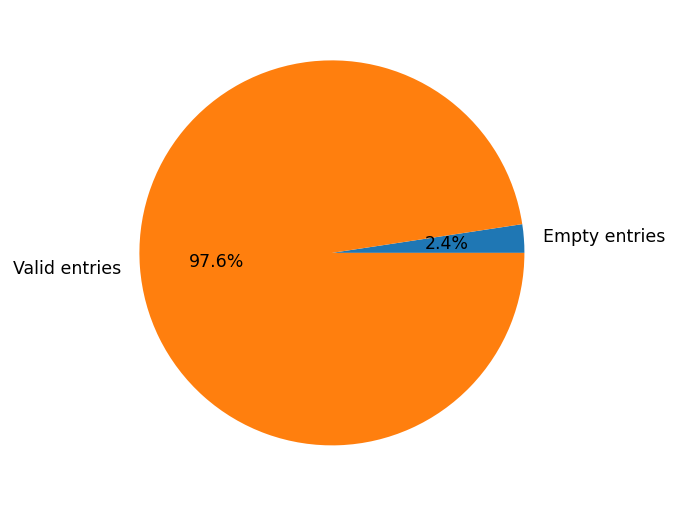

In [ ]:
plt.figure(figsize=(10, 5), dpi=125)
plt.pie([total_number_of_empty_entries, (dataset_length-total_number_of_empty_entries)], labels=['Empty entries', 'Valid entries'], autopct='%1.1f%%')
plt.show()

In [ ]:
print("Number of total question and answer pairs: ",dataset_length )
print("Number of total question and answer pairs without empty entries: ",dataset_length_no_empty_entries )
print("\n")
print("Number of total questions: ",number_of_questions )
print("Number of total answers: ",number_of_questions )



Number of total question and answer pairs:  33955
Number of total question and answer pairs without empty entries:  33547


Number of total questions:  33547
Number of total answers:  33547


## Number of words per question

The code block below is dedicated to severl key tasks:


1.   Text preprocessing of the questions, which involves removing punctuation, stopwords, and performing lemmatization. The processed text will be stored in the datarfame containing the questions

2.   Calcultion of various statistics related to the number of words per question such as maximum word count and length, based on the results obtained from the preprocessing step

3.   Visualization of the distribution of the number of words per question through two histograms and kernal density estimates. One histogram depicts the distribution using the rw form of the data, while the other represents the distribution after preprocessing (excluding stopwords and punctuation). These visualizations provide valuable insights into the characteristics of the dataset


In [ ]:
question_df = pd.DataFrame()
question_df['question'] = file_dataframe['input']

In [ ]:
# Number of words per question
question_df['length'] = question_df['question'].apply(lambda question: len(question.split(' ')))
question_df['noPunctuation'] = question_df['question'].apply(lambda question: preprocess_document(question.lower().split(),noPunctuation=True))
question_df['noStopWords'] = question_df['question'].apply(lambda question: preprocess_document(question.lower().split(),noPunctuation=True, noStopWords=True))
question_df['lemmatized'] = question_df['question'].apply(lambda question: preprocess_document(question.lower().split(),noPunctuation=True, lemmatization=True))
question_df['noStopWords-lemmatized'] = question_df['question'].apply(lambda question: preprocess_document(question.lower().split(),noPunctuation=True, lemmatization=True, noStopWords=True))

In [ ]:
print("Maximum number of words per question: ", max(question_df['length']))
print("Minimum number of words per question: ", min(question_df['length']))
print("Average number of words per question: ", np.mean(question_df['length']))
print("Maximum number of words per question without punctuation and stopwords: ", max(question_df['noStopWords'].apply(lambda question: len(question))))
print("Minimum number of words per question without punctuation and stopwords: ", min(question_df['noStopWords'].apply(lambda question: len(question))))
print("Average number of words per question without punctuation and stopwords: ", np.mean(question_df['noStopWords'].apply(lambda question: len(question))))

Maximum number of words per question:  62
Minimum number of words per question:  3
Average number of words per question:  14.735803499567771
Maximum number of words per question without punctuation and stopwords:  38
Minimum number of words per question without punctuation and stopwords:  1
Average number of words per question without punctuation and stopwords:  7.6244671654693414


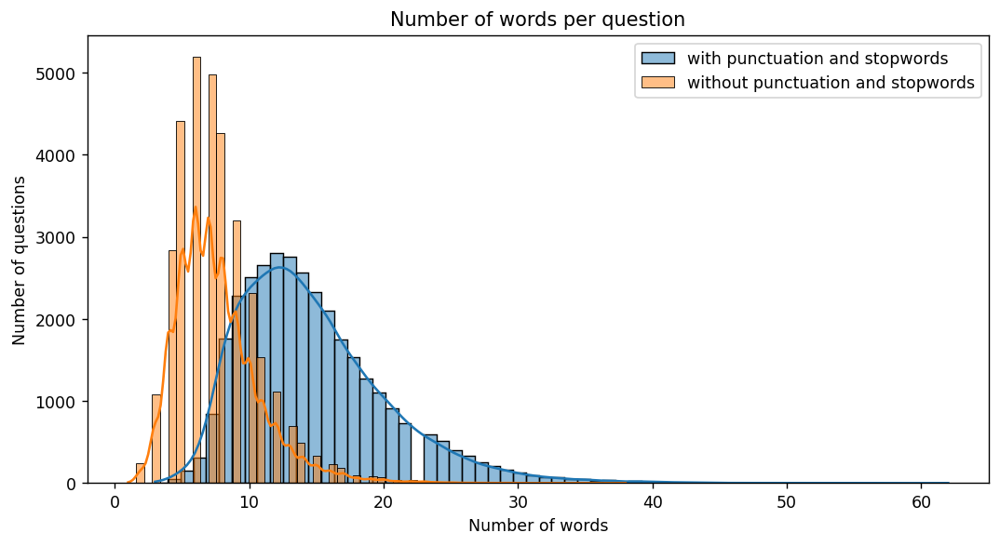

In [ ]:
plt.figure(figsize=(10, 5), dpi=125)
sns.histplot(question_df['length'], bins = max(question_df['length']), kde=True, label='with punctuation and stopwords')
sns.histplot(question_df['noStopWords'].apply(lambda question: len(question)), bins=max(question_df['length']), kde=True, label='without punctuation and stopwords')
plt.xlabel('Number of words')
plt.ylabel('Number of questions')
plt.title('Number of words per question')
plt.legend(loc='upper right')
plt.show()


In [ ]:
question_df

,question,length,noPunctuation,noStopWords,lemmatized,noStopWords-lemmatized
0,What is the relationship between very low Mg2+...,14,"[what, is, the, relationship, between, very, l...","[relationship, low, mg2, levels, pth, levels, ...","[what, is, the, relationship, between, very, l...","[relationship, low, mg2, level, pth, level, ca..."
1,What leads to genitourinary syndrome of menopa...,9,"[what, leads, to, genitourinary, syndrome, of,...","[leads, genitourinary, syndrome, menopause, at...","[what, lead, to, genitourinary, syndrome, of, ...","[lead, genitourinary, syndrome, menopause, atr..."
2,What does low REM sleep latency and experienci...,11,"[what, does, low, rem, sleep, latency, and, ex...","[low, rem, sleep, latency, experiencing, hallu...","[what, doe, low, rem, sleep, latency, and, exp...","[low, rem, sleep, latency, experiencing, hallu..."
3,What are some possible causes of low PTH and h...,12,"[what, are, some, possible, causes, of, low, p...","[possible, causes, low, pth, high, calcium, le...","[what, are, some, possible, cause, of, low, pt...","[possible, cause, low, pth, high, calcium, level]"
4,How does the level of anti-müllerian hormone r...,11,"[how, does, the, level, of, antimüllerian, hor...","[level, antimüllerian, hormone, relate, ovaria...","[how, doe, the, level, of, antimüllerian, horm...","[level, antimüllerian, hormone, relate, ovaria..."
...,...,...,...,...,...,...
33946,"What is Opsoclonus-Myoclonus Ataxia Syndrome, ...",16,"[what, is, opsoclonusmyoclonus, ataxia, syndro...","[opsoclonusmyoclonus, ataxia, syndrome, type, ...","[what, is, opsoclonusmyoclonus, ataxia, syndro...","[opsoclonusmyoclonus, ataxia, syndrome, type, ..."
33947,"What is Opsoclonus-Myoclonus Ataxia Syndrome, ...",16,"[what, is, opsoclonusmyoclonus, ataxia, syndro...","[opsoclonusmyoclonus, ataxia, syndrome, type, ...","[what, is, opsoclonusmyoclonus, ataxia, syndro...","[opsoclonusmyoclonus, ataxia, syndrome, type, ..."
33948,Is A part of B in a proportion of A/B?,10,"[is, a, part, of, b, in, a, proportion, of, ab]","[part, b, proportion, ab]","[is, a, part, of, b, in, a, proportion, of, ab]","[part, b, proportion, ab]"
33949,"What is the mnemonic ""Microtubules Get Constru...",20,"[what, is, the, mnemonic, microtubules, get, c...","[mnemonic, microtubules, get, constructed, poo...","[what, is, the, mnemonic, microtubule, get, co...","[mnemonic, microtubule, get, constructed, poor..."


## Number of words per answer

The subsequent code block is dedicated to the following key objectives:


1.   Conducting text preprocessing on the answers by eliminating punctuation, stopwords, and performing lemmatiazion. The processed text will be intefrated into the dataframe containing the answers

2.   Computing various statistics related to the word count per answer, including maximum, minimum, average word count and length, based on the outcomes of the preprocessing phase

3.   Visualizing the distribution of the word count per answer through two histograms and kernel density estimates. One histogram illustrates the distribution using the original form of the data, while the other showcases the distribution post-preprocessing(excluding stopwords and punctuation). These visualization serve as valuable tools for gaining insights into the dataset's underlying patterns and features


In [ ]:
answers_df = pd.DataFrame()
answers_df['answer'] = file_dataframe['output']

In [ ]:
# Number of words per answers
answers_df['length'] = answers_df['answer'].apply(lambda answer: len(answer.split(' ')))
answers_df['noPunctuation'] = answers_df['answer'].apply(lambda answer: preprocess_document(answer.lower().split(),noPunctuation=True))
answers_df['noStopWords'] = answers_df['answer'].apply(lambda answer: preprocess_document(answer.lower().split(),noPunctuation=True, noStopWords=True))
answers_df['lemmatized'] = answers_df['answer'].apply(lambda answer: preprocess_document(answer.lower().split(),noPunctuation=True, lemmatization=True))
answers_df['noStopWords-lemmatized'] = answers_df['answer'].apply(lambda answer: preprocess_document(answer.lower().split(),noPunctuation=True, lemmatization=True, noStopWords=True))

In [ ]:
print("Maximum number of words per answer: ", max(answers_df['length']))
print("Minimum number of words per answer: ", min(answers_df['length']))
print("Average number of words per answer: ", np.mean(answers_df['length']))
print("Maximum number of words per answer without punctuation and stopwords: ", max(answers_df['noStopWords'].apply(lambda answer: len(answer))))
print("Minimum number of words per answer without punctuation and stopwords: ", min(answers_df['noStopWords'].apply(lambda answer: len(answer))))
print("Average number of words per answer without punctuation and stopwords: ", np.mean(answers_df['noStopWords'].apply(lambda answer: len(answer))))

Maximum number of words per answer:  241
Minimum number of words per answer:  1
Average number of words per answer:  54.09550779503383
Maximum number of words per answer without punctuation and stopwords:  148
Minimum number of words per answer without punctuation and stopwords:  0
Average number of words per answer without punctuation and stopwords:  31.543058991862164


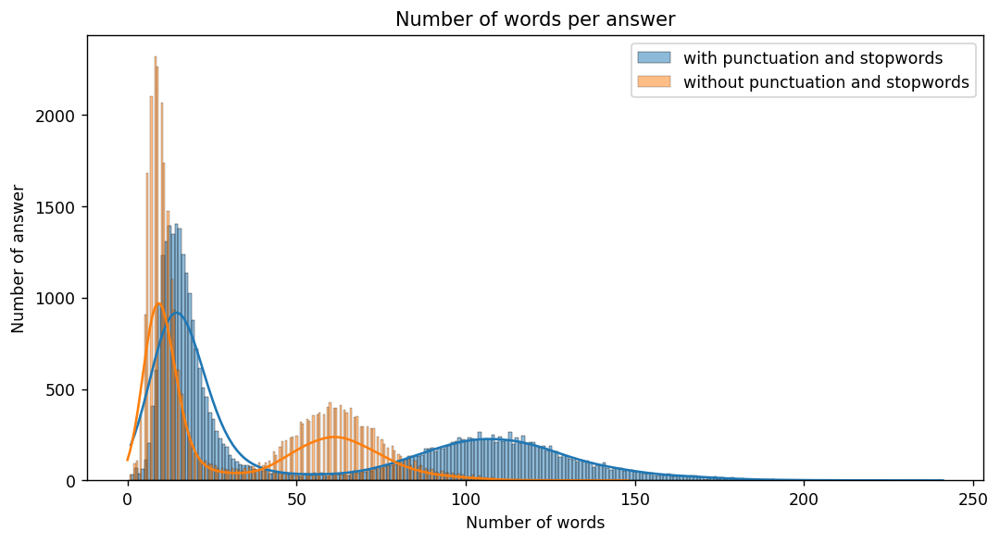

In [ ]:
plt.figure(figsize=(10, 5), dpi=125)
sns.histplot(answers_df['length'], bins = max(answers_df['length']), kde=True, label='with punctuation and stopwords')
sns.histplot(answers_df['noStopWords'].apply(lambda answer: len(answer)), bins=max(answers_df['length']), kde=True, label='without punctuation and stopwords')
plt.xlabel('Number of words')
plt.ylabel('Number of answer')
plt.title('Number of words per answer')
plt.legend(loc='upper right')
plt.show()


## Vocabulary

Vocabulary analysis plays a crucial role in question answering systems for several reasons:



1.   **Understanding and Matching**:Through meticulous examination of the vocabulary, systems decipher the semantics of questions, pinpointing essential terms, phrases, and relationships. This deep comprehension facilitates precise matching with relevant answers, ensuring accurate responses to user queries.

2.  **Semantic Representation**: Vocabulary analysis enriches the semantic representation of questions and answers by identifying synonyms, related terms, and semantic parallels. This augmentation enhances the system's linguistic comprehension and retrieval capabilities.

3.  **Handling Variability**: The variability in vocabulary usage across questions necessitates adaptable mechanisms. Vocabulary analysis empowers systems to recognize diverse expressions of the same concept or intent, effectively addressing linguistic variability.

4.  **Filtering Noise**: Noise, such as stopwords and punctuation, hinders accurate comprehension of questions and answers. Vocabulary analysis effectively filters out these irrelevant elements, focusing solely on crucial content essential for comprehension and matching.

5.  **Detection of Biases**: Vocabulary analysis uncovers potential biases within the dataset, such as the over-representation of certain words or concepts. Recognizing these biases is critical as they could inadvertently influence the behavior and performance of our models.

6. **Guidance for Text Representation Methods**: Understanding the dataset's vocabulary guides the selection of appropriate text representation methods, such as word embeddings or transformers. It also assists in fine-tuning these methods to ensure optimal performance tailored to the dataset's characteristics.

In the forthcoming code block, vocabularies are extracted for both the set of questions and answers. Furthermore, vocabularies are computed individually for each question and answer, encompassing both raw and preprocessed data. Following this, histograms and kernel density estimates are plotted to showcase the distribution of word count within the vocabularies concerning the number of questions.
These visualizations proved valuable insights into the distribution patterns across the dataset's vocabularies

In [ ]:
question_df['Vocabolary'] = question_df['question'].apply(lambda question: preprocess_document(question.lower().split(),isSet=True, isSorted=True))
question_df['Vocabolary-noStopWords'] = question_df['question'].apply(lambda question: preprocess_document(question.lower().split(),noPunctuation=True, noStopWords=True,isSet=True, isSorted=True))

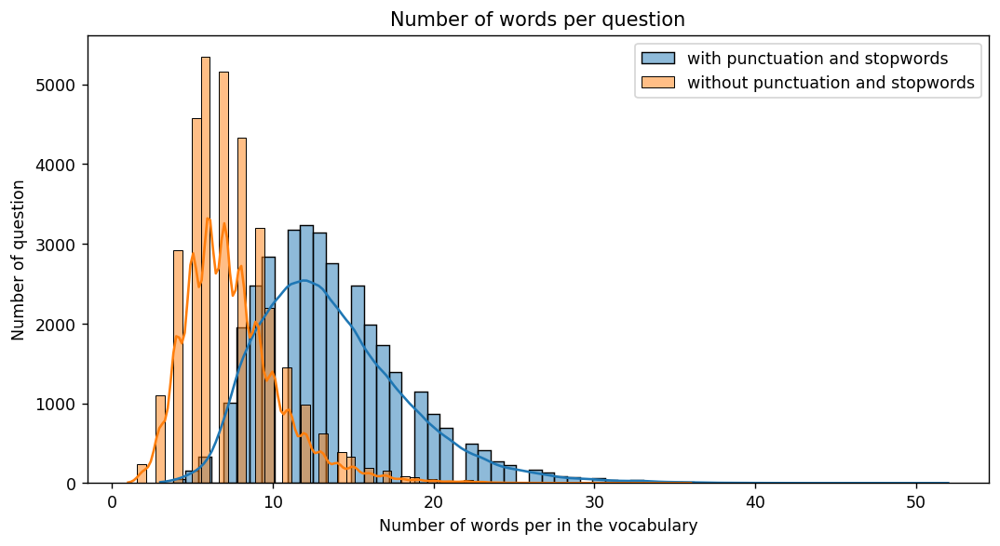

In [ ]:
plt.figure(figsize=(10, 5), dpi=125)
sns.histplot(question_df['Vocabolary'].apply(lambda question: len(question)), bins = max(question_df['length']), kde=True, label='with punctuation and stopwords')
sns.histplot(question_df['Vocabolary-noStopWords'].apply(lambda question: len(question)), bins=max(question_df['length']), kde=True, label='without punctuation and stopwords')
plt.xlabel('Number of words per in the vocabulary')
plt.ylabel('Number of question')
plt.title('Number of words per question')
plt.legend(loc='upper right')
plt.show()


In [ ]:
answers_df['Vocabolary'] = answers_df['answer'].apply(lambda answer: preprocess_document(answer.lower().split(),isSet=True, isSorted=True))
answers_df['Vocabolary-noStopWords'] = answers_df['answer'].apply(lambda answer: preprocess_document(answer.lower().split(),noPunctuation=True, noStopWords=True,isSet=True, isSorted=True))

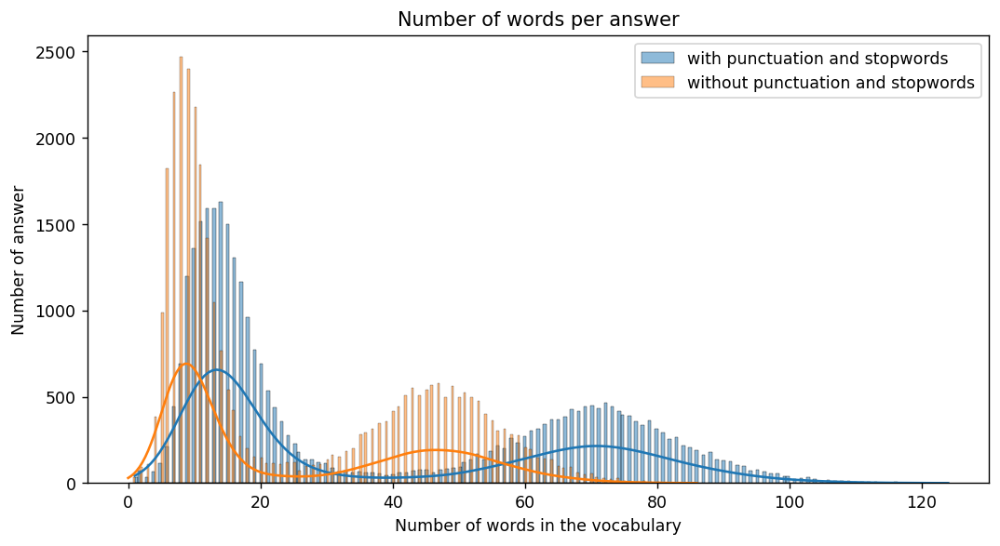

In [ ]:
plt.figure(figsize=(10, 5), dpi=125)
sns.histplot(answers_df['Vocabolary'].apply(lambda answer: len(answer)), bins = max(answers_df['length']), kde=True, label='with punctuation and stopwords')
sns.histplot(answers_df['Vocabolary-noStopWords'].apply(lambda answer: len(answer)), bins=max(answers_df['length']), kde=True, label='without punctuation and stopwords')
plt.xlabel('Number of words in the vocabulary')
plt.ylabel('Number of answer')
plt.title('Number of words per answer')
plt.legend(loc='upper right')
plt.show()


In [ ]:
global_questions_vocabulary = create_global_vocabolary(question_df['Vocabolary'],isSorted=True, isSet=True)
global_questions_vocabulary_noStopwords_noPunctuation = create_global_vocabolary(question_df['Vocabolary-noStopWords'],isSorted=True, isSet=True)

global_answers_vocabulary = create_global_vocabolary(answers_df['Vocabolary'],isSorted=True, isSet=True)
global_answers_vocabulary_noStopwords_noPunctuation = create_global_vocabolary(answers_df['Vocabolary-noStopWords'],isSorted=True, isSet=True)

In [ ]:
print("Number of words in vocabolary of questions: ", len(global_questions_vocabulary))
print("Number of words in vocabolary of questions after removing punctuation and stopwords: ", len(global_questions_vocabulary_noStopwords_noPunctuation))
print("Number of words in vocabolary of answers: ", len(global_answers_vocabulary))
print("Number of words in vocabolary of answers after removing punctuation and stopwords: ", len(global_answers_vocabulary_noStopwords_noPunctuation))

Number of words in vocabolary of questions:  27593
Number of words in vocabolary of questions after removing punctuation and stopwords:  16987
Number of words in vocabolary of answers:  49838
Number of words in vocabolary of answers after removing punctuation and stopwords:  25931


## The Most Common 100 Words

In the upcoming code block, we showcase the 100 most common words for both the questions and the answers

In [ ]:
q = nltk.Counter(create_global_vocabolary(question_df['Vocabolary-noStopWords']))
print("The most common 100 words in the vocabolary of questions: \n", q.most_common(100))
a = nltk.Counter(create_global_vocabolary(answers_df['Vocabolary-noStopWords']))
print("The most common 100 words in the vocabolary of answers: \n", a.most_common(100))

The most common 100 words in the vocabolary of questions: 
 [('type', 2992), ('associated', 2723), ('used', 1984), ('cause', 1946), ('condition', 1737), ('patients', 1628), ('treatment', 1604), ('recommended', 1495), ('syndrome', 1430), ('commonly', 1390), ('name', 1387), ('symptoms', 1382), ('patient', 1364), ('common', 1358), ('potential', 1341), ('disease', 1281), ('effect', 1265), ('typically', 1199), ('may', 1091), ('cells', 953), ('diagnosis', 920), ('risk', 866), ('typical', 820), ('characterized', 816), ('cell', 813), ('medical', 754), ('levels', 734), ('occur', 719), ('specific', 718), ('affect', 712), ('causes', 708), ('blood', 694), ('infection', 692), ('one', 661), ('responsible', 658), ('acute', 654), ('possible', 631), ('mechanism', 627), ('caused', 623), ('body', 619), ('present', 605), ('primary', 605), ('characteristic', 582), ('presents', 558), ('test', 554), ('management', 551), ('result', 540), ('individuals', 537), ('two', 534), ('types', 510), ('cancer', 505), ('i

## WordCloud

In the upcoming code block, we'll create word clouds to illustrate the most prevalent words found in both questions and the answers. Word clouds visually represent word frequency by displaying them in varying sizes: the more frequent a word appears in the text, the larger and more prominent it appears in the cloud. This visualization technique offers an intuitive insight into the mosto common words present.
Hence, word clouds are generated by analyzing the text to identify individual words, tallying their occurences, and then graphically rendering them with larger sizes attributed to more frequent words

### WordCloud for words in questions

In [ ]:
all_questions = ' '.join(question_df['question'])
all_questions_noPunctuation = preprocess_document(all_questions.lower().split(), noPunctuation=True)
all_questions_noStopWords = preprocess_document(all_questions_noPunctuation, noStopWords=True)

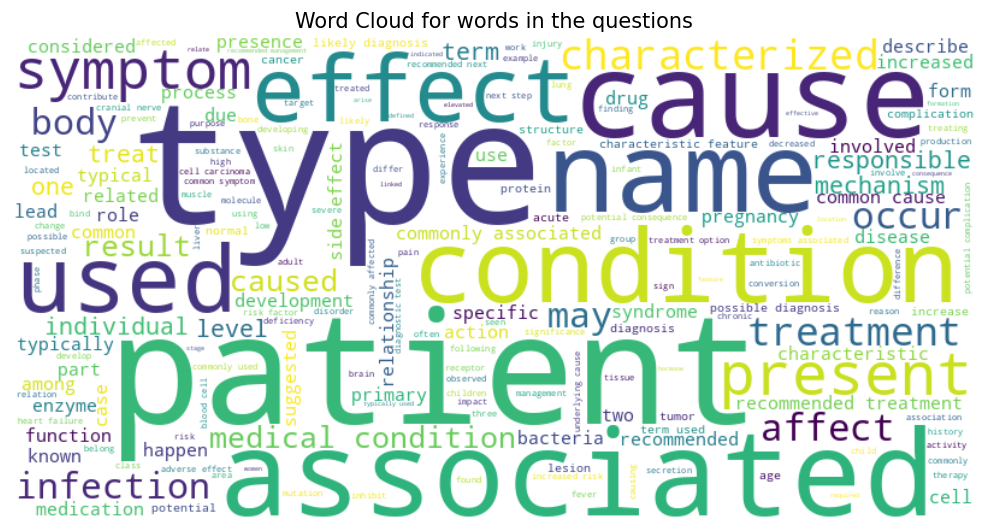

In [ ]:
# Create a WordCloud object
text = ' '.join(all_questions_noPunctuation)
wordcloud = WordCloud(width=800, height=400, background_color="white").generate(text)
# Plot the word cloud
plt.figure(figsize=(10, 5), dpi=125)
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.title('Word Cloud for words in the questions')
plt.show()

### WordCloud for words in questions after removing stopwords

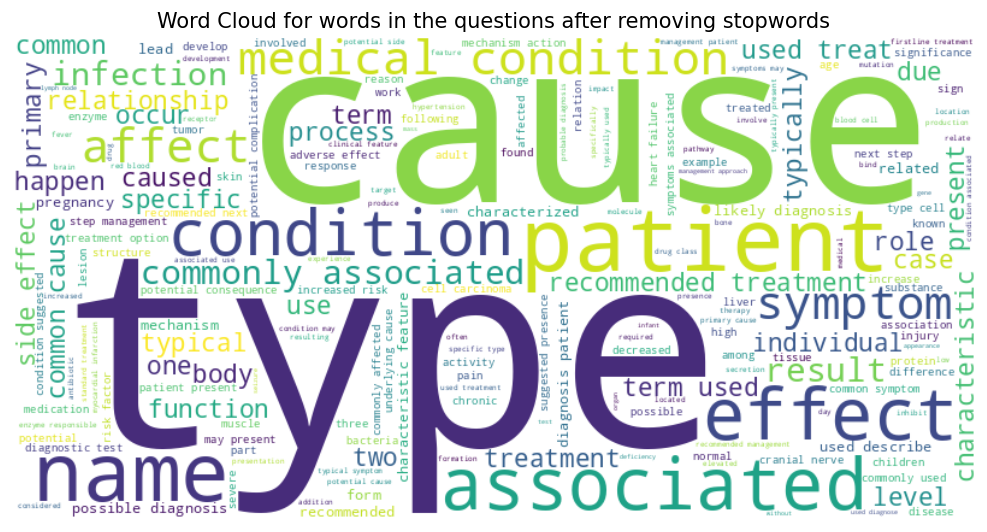

In [ ]:
# Create a WordCloud object
text = ' '.join(all_questions_noStopWords)
wordcloud = WordCloud(width=800, height=400, background_color="white").generate(text)
# Plot the word cloud
plt.figure(figsize=(10, 5), dpi=125)
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.title('Word Cloud for words in the questions after removing stopwords')
plt.show()

### WordCloud for words in answers

In [ ]:
all_answers = ' '.join(answers_df['answer'])
all_answers_noPunctuation = preprocess_document(all_answers.lower().split(), noPunctuation=True)
all_answers_noStopWords = preprocess_document(all_answers_noPunctuation, noStopWords=True)

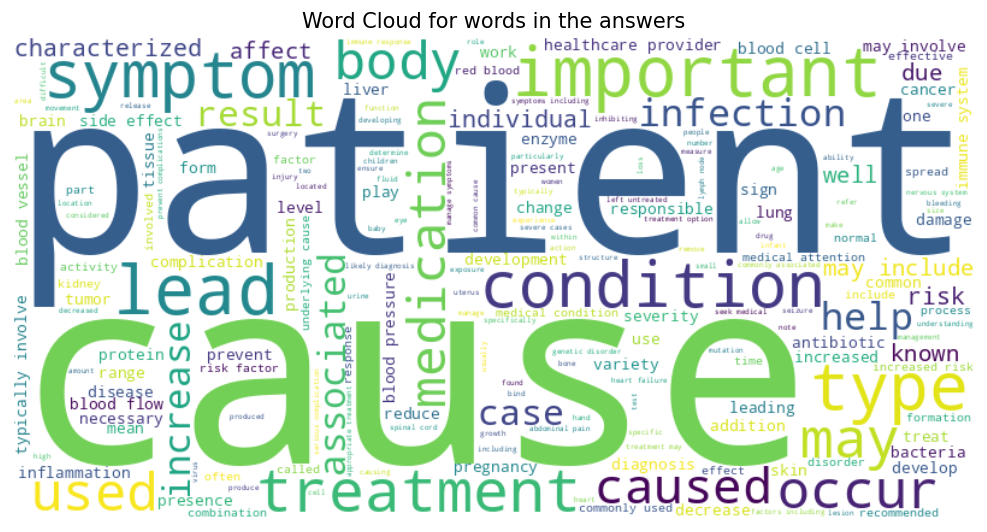

In [ ]:
# Create a WordCloud object
text = ' '.join(all_answers_noPunctuation)
wordcloud = WordCloud(width=800, height=400, background_color="white").generate(text)
# Plot the word cloud
plt.figure(figsize=(10, 5), dpi=125)
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.title('Word Cloud for words in the answers')
plt.show()

### WordCloud for words in answers after removing stopwords

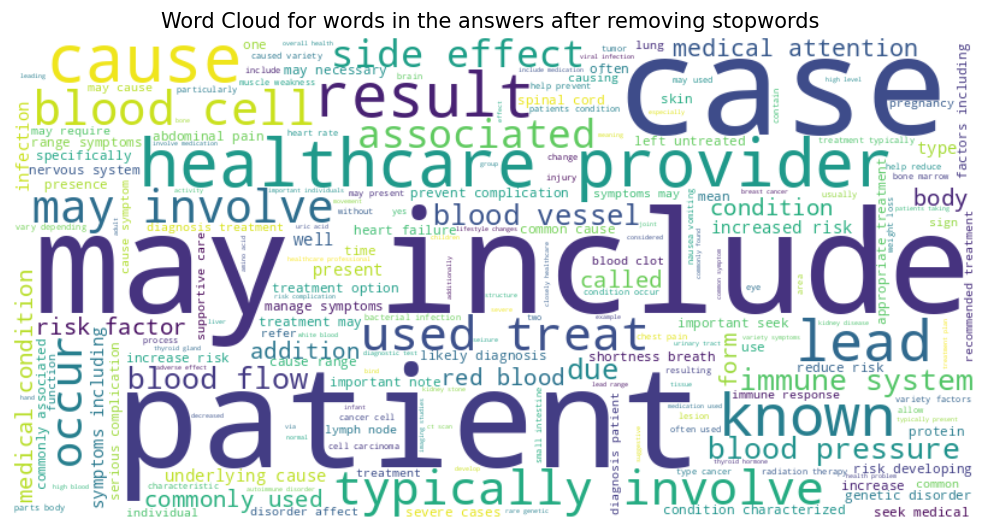

In [ ]:
text = ' '.join(all_answers_noStopWords)
wordcloud = WordCloud(width=800, height=400, background_color="white").generate(text)
# Plot the word cloud
plt.figure(figsize=(10, 5), dpi=125)
plt.imshow(wordcloud, interpolation="bilinear")
plt.axis("off")
plt.title('Word Cloud for words in the answers after removing stopwords ')
plt.show()

## N-grams

N-grams are contiguos sequences of 'n' items (typically words) from a given text. For example, in a text, bigrams (2-grams) would be sequences of two words and trigrams (3-grams) would be sequences of three words. Analyzing n-grams is important because:


1.   **Contextual Insight**: They help in understanding the context and relationships between words in the text

2.   **Pattern Identification**: Common n-grams can reveal frequently occuring phrases and structures, which are useful for languafe modelling and improving text generation

3.   **Noise Reduction**: They assist in filtering out noise by focusing on meaningful word combinations rather than isolated words.




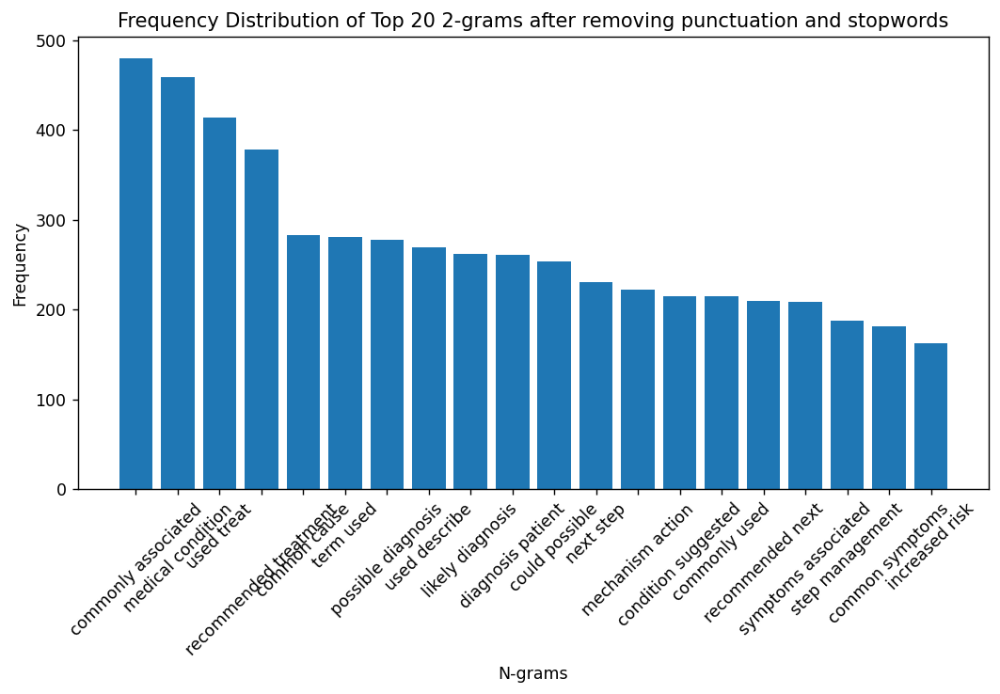

In [ ]:
nGrams(document=all_questions_noStopWords, size=2, NmostCommon=20)

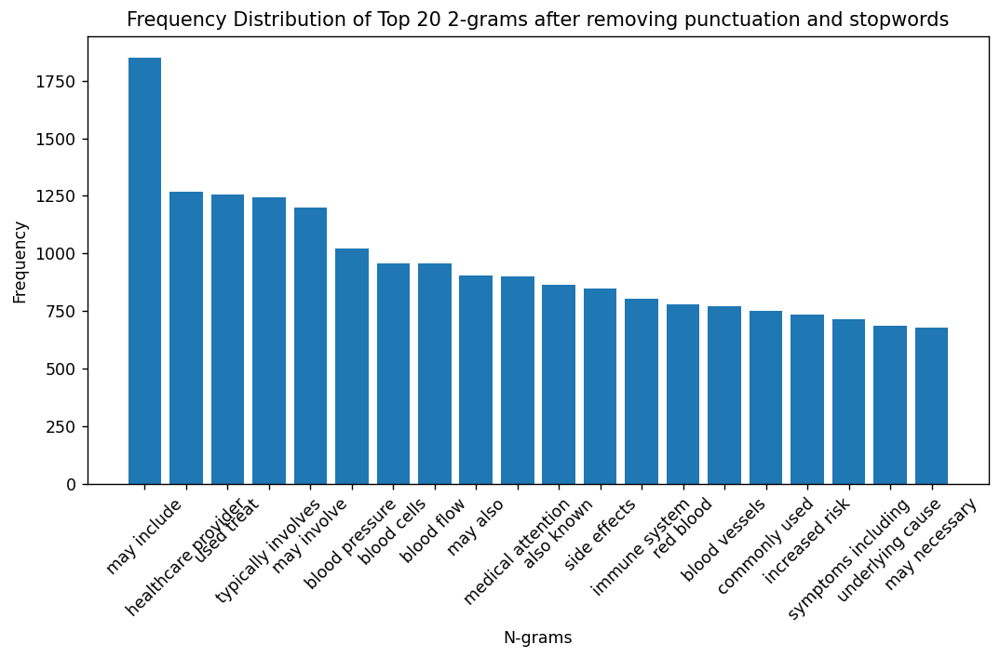

In [ ]:
nGrams(document=all_answers_noStopWords, size=2, NmostCommon=20)

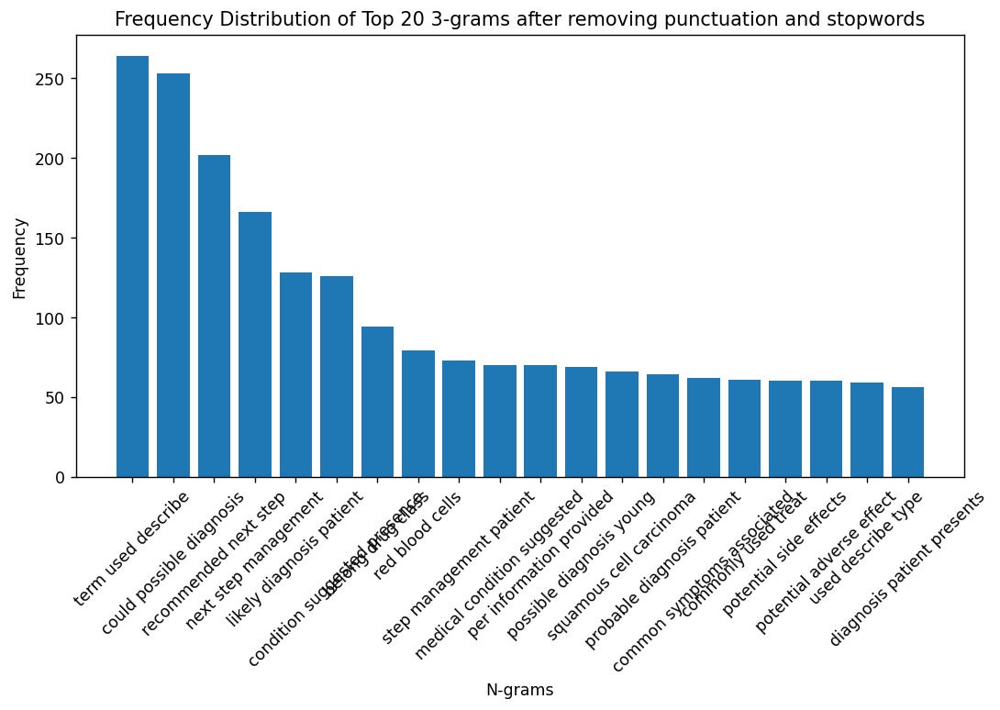

In [ ]:
nGrams(document=all_questions_noStopWords, size=3, NmostCommon=20)

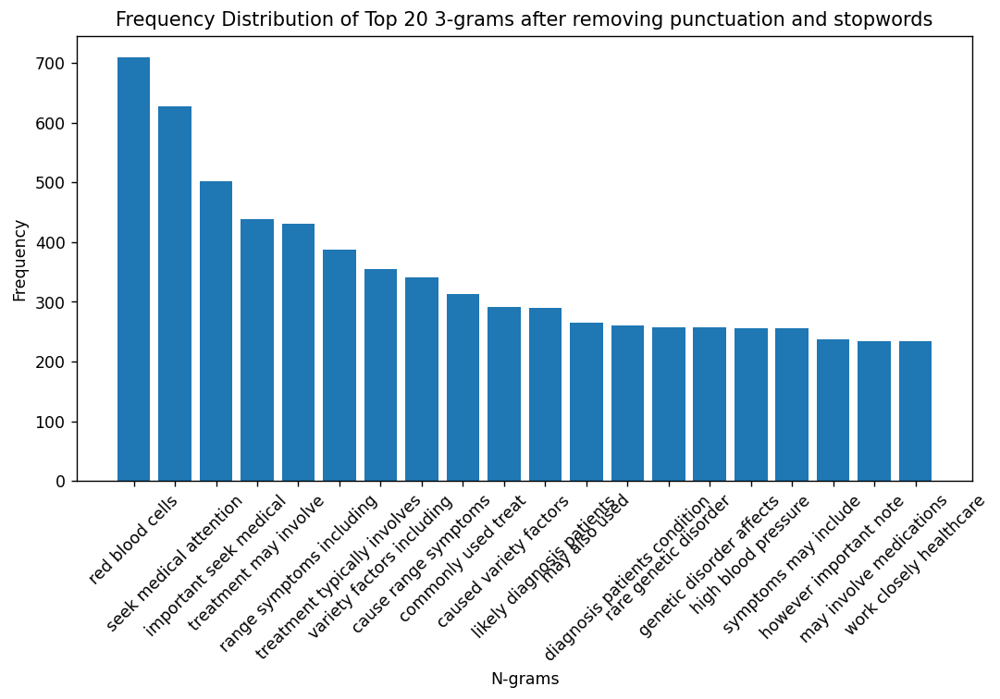

In [ ]:
nGrams(document=all_answers_noStopWords, size=3, NmostCommon=20)

# Save dataset

This code snippet saves the current state of various dataframes to CSV files if the SAVE_DATASET flag is set to True. Each dataframe is saved without the index to keep the files clean and focused on the data.

In [ ]:
if SAVE_DATASET:
  file_dataframe.to_csv('pre_preprocessed_dataset.csv', index=False)
  question_df.to_csv('questions_dataframe.csv', index=False)
  answers_df.to_csv('answers_dataframe.csv', index=False)

# Clustering

#Clustering introduction
In this notebook, we conducted a comprehensive analysis using clustering methodologies of a medical dataset aimed at developing a question-answering model. Our analysis involved utilizing preprocessed data and conducting clustering and visualization techniques to gain insights into the structure and content of the dataset.



*   **Data Exploration and Preprocessing:**
We began by exploring the dataset's characteristics, including word counts, vocabulary richness, and distribution of words. Preprocessing steps such as removing punctuation, stopwords, and lemmatization were applied to standardize the text and improve model performance.
*   **Visualization and Analysis:**
We visualized the dataset using techniques like WordClouds, N-grams, and TF-IDF analysis to uncover common phrases, patterns, and significant terms. This allowed us to gain a deeper understanding of the dataset's content and identify prevalent medical themes.

# Import and install

In [ ]:
TEST_MODEL = True

In [ ]:
if TEST_MODEL:
  !git clone https://github.com/epfml/sent2vec.git
  %cd sent2vec
  !make
  !pip install .
  import sent2vec

Cloning into 'sent2vec'...
remote: Enumerating objects: 425, done.
remote: Counting objects: 100% (22/22), done.
remote: Compressing objects: 100% (20/20), done.
remote: Total 425 (delta 9), reused 4 (delta 1), pack-reused 403
Receiving objects: 100% (425/425), 447.46 KiB | 6.39 MiB/s, done.
Resolving deltas: 100% (261/261), done.
/content/sent2vec
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/args.cc
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/dictionary.cc
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/productquantizer.cc
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/matrix.cc
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/shmem_matrix.cc
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/qmatrix.cc
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/vector.cc
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/model.cc
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/utils.cc
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/fasttext.cc
c++ -pthread -std=c++0x -O3 -f

In [ ]:
!pip install datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 542.0/542.0 kB 5.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 7.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 9.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 6.7 MB/s eta 0:00:00


In [ ]:
import string
from datasets import load_dataset
import re
from mpl_toolkits.mplot3d import Axes3D
from sklearn.preprocessing import LabelEncoder
import nltk
from nltk.corpus import stopwords
import pandas as pd
from collections import Counter
import matplotlib.pyplot as plt
import altair as alt
import seaborn as sns
from gensim.models import Word2Vec
from google.colab import drive
import os
import csv
import numpy as np
import random
from nltk.stem import WordNetLemmatizer
from sklearn.cluster import KMeans
import time
from sklearn import metrics
from sklearn.cluster import KMeans
import time
from tqdm import tqdm
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import MiniBatchKMeans

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import os

path = 'Colab Notebooks/NLP'

os.chdir(f'/content/drive/MyDrive/{path}')
os.getcwd()

'/content/drive/MyDrive/Colab Notebooks/NLP'

In [ ]:
DATAS_PATH = '/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/Datasets'

#Dataset import

In [ ]:
# For the clustering module we have used the pre-processed dataset from our preliminary analysis which has all the details such as
# input and output length, vocabulary and lemmatization
file_dataframe = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/NLP/NLP Project/Datasets/pre_preprocessed_dataset.csv')
print(type(file_dataframe))

<class 'pandas.core.frame.DataFrame'>


In [ ]:
# The below is out preprocessed dataframe

file_dataframe.head()

,input,output,input length,output length,input vocabolary,output vocabolary,lemmatized input,lemmatized output
0,What is the relationship between very low Mg2+...,Very low Mg2+ levels correspond to low PTH lev...,14,17,"['relationship', 'low', 'mg2', 'levels', 'pth'...","['low', 'mg2', 'levels', 'correspond', 'low', ...","['ca2', 'level', 'low', 'mg2', 'pth', 'relatio...","['ca2', 'correspond', 'level', 'low', 'mg2', '..."
1,What leads to genitourinary syndrome of menopa...,Low estradiol production leads to genitourinar...,9,11,"['leads', 'genitourinary', 'syndrome', 'menopa...","['low', 'estradiol', 'production', 'leads', 'g...","['atrophic', 'genitourinary', 'lead', 'menopau...","['atrophic', 'estradiol', 'genitourinary', 'le..."
2,What does low REM sleep latency and experienci...,Low REM sleep latency and experiencing halluci...,11,10,"['low', 'rem', 'sleep', 'latency', 'experienci...","['low', 'rem', 'sleep', 'latency', 'experienci...","['experiencing', 'hallucinationssleep', 'laten...","['experiencing', 'hallucinationssleep', 'laten..."
3,What are some possible causes of low PTH and h...,"PTH-independent hypercalcemia, which can be ca...",12,14,"['possible', 'causes', 'low', 'pth', 'high', '...","['pthindependent', 'hypercalcemia', 'caused', ...","['calcium', 'cause', 'high', 'level', 'low', '...","['cancer', 'caused', 'disease', 'granulomatous..."
4,How does the level of anti-müllerian hormone r...,The level of anti-müllerian hormone is directl...,11,20,"['level', 'antimüllerian', 'hormone', 'relate'...","['level', 'antimüllerian', 'hormone', 'directl...","['antimüllerian', 'hormone', 'level', 'ovarian...","['', 'antimüllerian', 'directly', 'hormone', '..."


In [ ]:
input, output = file_dataframe["input"], file_dataframe["output"]

In [ ]:
documents = input + " " + output

# Documents vectorisation

In order to cluster the documents, we need to first convert them into a vector format. We will use the `TfidfVectorizer` from Scikit-Learn to do this.

The `TfidfVectorizer` is very similar to the `CountVectorizer` we used in the text classification tutorial except that it multiplies the term frequency in the document by the inverse document frequecy of the term across the corpus: $\mathrm{tf}(t, d) \cdot \mathrm{idf}(t)$
- here $\mathrm{tf}(t, d)$ is the count of the term $t$ in the document $d$
- idf is inverse document frequency: $\mathrm{idf}(t) = \log{\frac{n + 1}{\mathrm{df}(t) + 1}} + 1$
- $n$ is the number of documents in collection
- and the document frequency, $\mathrm{df}(t)$ is the number of documents that contain the term $t$
- see https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.TfidfTransformer.html

The use of idf-weighting can be justified in term of information theory:
- the amount of **information** associated with a term quantifies the **amount of surprise** at seeing a term in a document
- the surprise decreases with its (prior) probability of occurrence and information must be additive, so we have:
  - $I(t) = \log{\frac{1}{P(t)}} = -\log{P(t)}$
- the probability of observing a particular term in a document is just the percentage of documents that contain the term:
  - $P(t) = \frac{\mathrm{df}(t)}{n}$
- We smooth this estimate so that small df(t) values don't cause unreasonably high idf values, we have:
  - $P(t) = \frac{\mathrm{df}(t)+1}{n+1}$
  - so $I(t) = \log{\frac{n+1}{\mathrm{df}(t)+1}}$
- The idf value used is then $\mathrm{idf}(t) = I(t) + 1$, where the $+1$ prevents idf from going to zero as df approaches $n$.

In [ ]:
vectorizer = TfidfVectorizer(max_df=0.8, min_df=5, stop_words='english', )

The vectorisation method takes a number of arguments that control the resulting vocabulary. We have set the following arguments:  
- **max_df = 0.8**: remove words occuring in more than half of the documents (note: this will get rid of any corpus-specific tags)
- **min_df = 5**: remove words occuring in less than 5 documents  
- **stop_words = 'english'**: remove stopwords using an english stopword list

We can now fit the vectorizer to the data:
- Note: we could transform the data at the same time, using the `fit_transform()` method, but we'll wait for now to transform the data

In [ ]:
vectorizer.fit(documents)

TfidfVectorizer(max_df=0.8, min_df=5, stop_words='english')

Let's have a quick look at the vocabulary. How big is it?

In [ ]:
vocab = vectorizer.get_feature_names_out()

print(f"Length of vocabulary: {len(vocab)}")

Length of vocabulary: 10952


Wow, that's quite big!

Let's print out a random sample of 100 terms from it to see what they look like:

In [ ]:
sorted(random.sample(vocab.tolist(),100))

['2nd',
 '5fu',
 '80s',
 'adolescent',
 'alkalinity',
 'antigen',
 'art',
 'attention',
 'avoid',
 'azt',
 'aztreonam',
 'believed',
 'break',
 'bronchopulmonary',
 'chromosomal',
 'citrulline',
 'cjd',
 'clumps',
 'coli',
 'controlled',
 'cotransporter',
 'cramping',
 'cyclophosphamide',
 'dermatophytes',
 'diethylcarbamazine',
 'digitalis',
 'disinfection',
 'disseminated',
 'encodes',
 'engulf',
 'equals',
 'estriol',
 'exercise',
 'fragment',
 'friends',
 'genu',
 'halo',
 'happens',
 'hatch',
 'hbs',
 'headache',
 'hyperpigmentation',
 'hypersensitivity',
 'hypoxic',
 'inform',
 'joined',
 'lacrimal',
 'latum',
 'lecithin',
 'leukodystrophy',
 'linked',
 'mac',
 'mcmurray',
 'menopausal',
 'murphy',
 'neurodevelopmental',
 'nitric',
 'orally',
 'orchitis',
 'osmotic',
 'passing',
 'pathogen',
 'perfused',
 'pneumophila',
 'postrema',
 'protrusions',
 'pylorus',
 'radiological',
 'rankl',
 'reactivate',
 'reading',
 'replicate',
 'reversibly',
 'rheumatoid',
 'rhythms',
 'scarring'

Most of the terms look pretty good, but the representation looks reasonable.

Now let's vectorize the dataset:

In [ ]:
vector_outputs = vectorizer.transform(output)

Here is the sparse vector for the first document:


In [ ]:
print(vector_outputs[0])

  (0, 10311)	0.2633572058301853
  (0, 8591)	0.20249989312596864
  (0, 8117)	0.27229860394545863
  (0, 6278)	0.330181972215863
  (0, 5879)	0.5361914682486788
  (0, 5739)	0.45638251553362646
  (0, 2292)	0.37815359579905167
  (0, 1428)	0.2601608691003673


The decimial values are the TF-IDF scores for the terms. We can sort the terms by their TF-IDF values, and print them out as follows:

In [ ]:
sorted([(vocab[j], vector_outputs[0, j]) for j in vector_outputs[0].nonzero()[1]], key=lambda x: -x[1])

[('low', 0.5361914682486788),
 ('levels', 0.45638251553362646),
 ('correspond', 0.37815359579905167),
 ('mg2', 0.330181972215863),
 ('pth', 0.27229860394545863),
 ('turn', 0.2633572058301853),
 ('ca2', 0.2601608691003673),
 ('results', 0.20249989312596864)]

Do the top terms agree with what you expected for the document?

Print it out below:

In [ ]:
print(output[0])

Very low Mg2+ levels correspond to low PTH levels which in turn results in low Ca2+ levels.


## Data exploration

Let's play a bit with our data

### Measuring the similarity between vectorised documents

The vectorizer also normalizes the resulting document representations such that their vectors have length one.
- We can see this by computing the dot-product between a vector representation and itself.
- For example, for the first document in the collection we have:

In [ ]:
vec = vector_outputs[0]
vec.multiply(vec).sum()

0.9999999999999996

To calculate the dot-product we multiplied the sparse vector by itself and then took the sum.

The fact that the vectors have length one (almost length of one due to approximations in the representation) means that the dot-product between vectors computes the cosine of the angle between them.
- The cosine of the angle between tf-idf vectors provides a value in the range [0,1], that is often used to measure the similarity between documents.
- Let's compute the similarity between the first two documents in the collection:

In [ ]:
vector_outputs[0].multiply(vector_outputs[1]).sum()

0.11522692475804687

Here is the second document:

In [ ]:
print(output[1])

Low estradiol production leads to genitourinary syndrome of menopause (atrophic vaginitis).


The similarity value is zero, which isn't surprising since most documents don't share vocabulary.

The average vocabulary size of a document in the collection is:

In [ ]:
nonzero_count = vector_outputs.count_nonzero()
doc_count = vector_outputs.get_shape()[0]

print(f"Average document vocabulary size: {nonzero_count/doc_count}")

Average document vocabulary size: 23.09348078814797


The first two answers came from different categories:

In [ ]:
print(f"1st answer: {output[0]}")
print(f"2st answer: {output[1]}")

1st answer: Very low Mg2+ levels correspond to low PTH levels which in turn results in low Ca2+ levels.
2st answer: Low estradiol production leads to genitourinary syndrome of menopause (atrophic vaginitis).


What if we try to find all the documents similar to the first one? Let's see:

In [ ]:
for i in range(len(output)):
  if vector_outputs[0].multiply(vector_outputs[i]).sum() >= 0.4:
    print(i, ': ', output[i])

0 :  Very low Mg2+ levels correspond to low PTH levels which in turn results in low Ca2+ levels.
12 :  Low Ca2+ and low PTH is seen in primary hypoparathyroidism.
34 :  High Aldosterone levels are associated with low urine sodium levels.
1260 :  Severe decreases in serum Mg2+ concentration cause a decrease in PTH secretion. PTH (parathyroid hormone) is a hormone that regulates calcium and phosphate homeostasis in the body, and its secretion is influenced by the levels of magnesium in the blood. When magnesium levels are low, PTH secretion decreases, which can lead to hypocalcemia (low calcium levels) and other related disorders.
1261 :  A severe decrease in serum Mg2+ concentration causes a decrease in PTH secretion. PTH (parathyroid hormone) is a hormone that regulates calcium and phosphate homeostasis in the body. When magnesium levels are low, PTH secretion decreases, which can lead to hypocalcemia (low calcium levels) and other related disorders.
12042 :  In pseudohypoparathyroidis

### Searching the collection based on keywords

We could even use the same approach to compute the similarity between a search query and each of the documents in a collection in order to find the one that best matches with a query:

In [ ]:
import numpy as np

#query = 'pregnancy'
#query = 'heart attack'
query = 'PAP test'

query_vec = vectorizer.transform([query])[0]

index = np.argmax([query_vec.multiply(vector_outputs[i]).sum() for i in range(len(output))])
print(documents[index])
print("Similarity: ", query_vec.multiply(vector_outputs[index]).sum())

How often should women between the ages of 21-29 have a Pap smear, and what are the recommended screening options for women between the ages of 30-65? Women between the ages of 21-29 should have a Pap smear performed every 3 years. Women between the ages of 30-65 should either continue to have a Pap smear alone every 3 years or preferably have a Pap test and HPV test (co-testing) every 5 years.
Similarity:  0.565873783364458


In [ ]:
vector_inputs = vectorizer.transform(input)

In [ ]:
similarity_matrix_io = np.dot(vector_inputs, vector_outputs.T)
similarity_matrix_ii = np.dot(vector_inputs, vector_inputs.T)
similarity_matrix_oo = np.dot(vector_outputs, vector_outputs.T)

In [ ]:
for i in range(similarity_matrix_io.shape[1]):
  if similarity_matrix_io[0, i] >= 0.4:
    print(i, ': ', output[i])

0 :  Very low Mg2+ levels correspond to low PTH levels which in turn results in low Ca2+ levels.
12 :  Low Ca2+ and low PTH is seen in primary hypoparathyroidism.
34 :  High Aldosterone levels are associated with low urine sodium levels.
1260 :  Severe decreases in serum Mg2+ concentration cause a decrease in PTH secretion. PTH (parathyroid hormone) is a hormone that regulates calcium and phosphate homeostasis in the body, and its secretion is influenced by the levels of magnesium in the blood. When magnesium levels are low, PTH secretion decreases, which can lead to hypocalcemia (low calcium levels) and other related disorders.
1261 :  A severe decrease in serum Mg2+ concentration causes a decrease in PTH secretion. PTH (parathyroid hormone) is a hormone that regulates calcium and phosphate homeostasis in the body. When magnesium levels are low, PTH secretion decreases, which can lead to hypocalcemia (low calcium levels) and other related disorders.
12042 :  In pseudohypoparathyroidis

##Similarity Matrices

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
#@title question - answer similarity matrix
fig, ax = plt.subplots(figsize=(100, 100))

max_val = 100

intersection_matrix = similarity_matrix_io[:max_val, :max_val].todense()

ax.matshow(intersection_matrix, cmap=plt.cm.Blues)

for i in range(max_val):
    for j in range(max_val):
        c = np.round(intersection_matrix[j,i], 2)
        ax.text(i, j, str(c), va='center', ha='center')

In the similarity matrix generated from the initial 100 question-answer pairs, a notable trend emerges: there's a significant similarity between each question and its corresponding answer. This implies a close relationship between the question and its accurate response. Furthermore, some answers exhibit considerable similarity to different questions, suggesting that these questions may be about the same topics or fields.

In [ ]:
fig, ax = plt.subplots(figsize=(100, 100))
#@title question - question similarity matrix

max_val = 100

intersection_matrix = similarity_matrix_ii[:max_val, :max_val].todense()

ax.matshow(intersection_matrix, cmap=plt.cm.Blues)

for i in range(max_val):
    for j in range(max_val):
        c = np.round(intersection_matrix[j,i], 2)
        ax.text(i, j, str(c), va='center', ha='center')

In the similarity matrix derived from the initial 100 question-question pairs, it's notable that each question naturally shows high similarity with itself. However, the more interesting observation arises from the fact that without shuffling the dataset beforehand, similar questions consistently cluster together. This suggests that within the dataset, there are several questions per topic, and those related to the same topics tend to be grouped closely together.

In [ ]:
fig, ax = plt.subplots(figsize=(100, 100))

max_val = 100
#@title answer - answer similarity matrix


intersection_matrix = similarity_matrix_oo[:max_val, :max_val].todense()

ax.matshow(intersection_matrix, cmap=plt.cm.Blues)

for i in range(max_val):
    for j in range(max_val):
        c = np.round(intersection_matrix[j,i], 2)
        ax.text(i, j, str(c), va='center', ha='center')

In the similarity matrix derived from the initial 100 answer-answer pairs, a similar pattern emerges as observed in the analysis of the first 100 question-question pairs. However, this time, the clusters of answers with high similarity to themselves are even more pronounced.

# Clustering

Now we can start applying clustering to our vectorised documents

### Selecting a value for k

When used on low dimensional data, k-Means is often combined with the 'elbow method' (https://en.wikipedia.org/wiki/Elbow_method_(clustering)) for finding the 'right' number of clusters k

The method involves:
- running the clustering algorithm with increasing values of *k*
- plotting the intrinsic evaluation measure (within-cluster sum-of-squares)
- and looking for a point in which improvement in the measure decreases substantially from one time step to the next.

Let's try out the method using the MiniBatch version of k-Means since it is a bit faster to run.
- First generate the performance evaluation measure values across the range of k values:

In [ ]:
if True:
  performance_inertia = []
  performance_labels = []
  sum_time = 0
  k_values = range(10,200, 10)
  for k in k_values:
    print(f'Evaluation with k={k}')
    start =time.time()
    mini_batch = MiniBatchKMeans(n_clusters=k, batch_size=500, random_state=2307, n_init=2).fit(vector_outputs)
    end = time.time()
    execution_time = round(end-start, 2)
    sum_time += execution_time
    i = k_values.index(k)+1
    estimated_remaining_time = round((sum_time/i)*(len(k_values)-i), 2)
    performance_inertia.append(mini_batch.inertia_)
    performance_labels.append(mini_batch.labels_)
    print(f'Inertia:{mini_batch.inertia_}\nExecution time:{execution_time}s\nEstimated remaining time:{estimated_remaining_time}s\n\n')

Evaluation with k=10
Inertia:32718.623921172213
Execution time:0.44s
Estimated remaining time:7.92s


Evaluation with k=20
Inertia:32571.549212865943
Execution time:0.54s
Estimated remaining time:8.33s


Evaluation with k=30
Inertia:33231.46175446377
Execution time:0.2s
Estimated remaining time:6.29s


Evaluation with k=40
Inertia:33222.13447356514
Execution time:0.3s
Estimated remaining time:5.55s


Evaluation with k=50
Inertia:33175.07388233634
Execution time:1.03s
Estimated remaining time:7.03s


Evaluation with k=60
Inertia:32212.94452770784
Execution time:5.6s
Estimated remaining time:17.57s


Evaluation with k=70
Inertia:32280.712460671028
Execution time:3.44s
Estimated remaining time:19.8s


Evaluation with k=80
Inertia:32221.23517905763
Execution time:3.42s
Estimated remaining time:20.58s


Evaluation with k=90
Inertia:32299.849981837815
Execution time:7.35s
Estimated remaining time:24.8s


Evaluation with k=100
Inertia:31994.006089205395
Execution time:5.08s
Estimated remainin

Note that the within-cluster sum-of-squares almost always improves from one iteration to the next as k is increased.
- In theory it should always increase since the more cluster centroids there are, the more flexibility the model has for describing datapoints (assigning them to clusters)
- but in practice the stochasticity of k-Means and also the mini-batch procedure can cause the algorithm to not find the global optimum and thus produce a higher sum-of-squares value than a previous iteration (with lower k).

We'll now use some standard code to plot the performance measure against the value k:

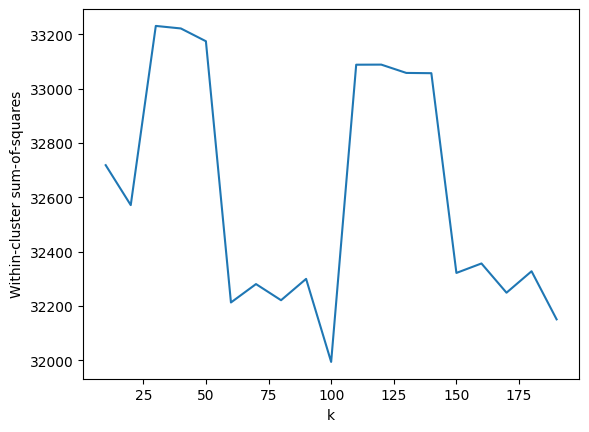

In [ ]:
plt.figure()
plt.plot(k_values, performance_inertia)
plt.ylabel('Within-cluster sum-of-squares')
plt.xlabel('k')
plt.show()

Does it look to you like there is a point on the graph where performance suddenly stops getting a lot better?
- I don't see one ...
- That is likely because we have (i) very high dimensional data and (ii) quite a large number of documents.

So, we can try to analyze the silhouette score in the same range and look into the best scores to find a goof value of k

In [ ]:
from tqdm import tqdm
silhouette_scores = []
for labels in tqdm(performance_labels):
  silhouette_scores.append(metrics.silhouette_score(vector_outputs, labels))

100%|██████████| 19/19 [11:42<00:00, 36.95s/it]


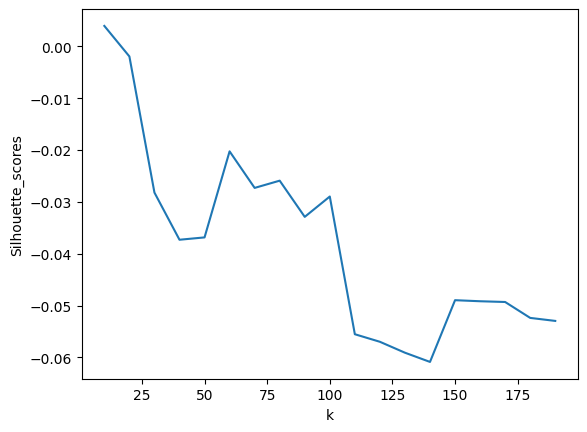

In [ ]:
plt.figure()
plt.plot(k_values, silhouette_scores)
plt.ylabel('Silhouette_scores')
plt.xlabel('k')
plt.show()

In [ ]:
k = k_values[np.argmax(silhouette_scores)]
print(f'The value of K with the highest silhouette_scores is {k}')

The value of K with the highest silhouette_scores is 10


### Clustering with k-Means

Now that we have computed a vector representation, we can perform the clustering.

There are many different clustering algorithms in common use, from k-Means and Hierarchical clustering to DBScan and Spectral clustering.  
- Many of them are implemented in Scikit-learn: https://scikit-learn.org/stable/modules/clustering.html
- You can easily change the code below to try them out.

We will use the k-Means algorithm since it is very popular, fast, scalable and relatively robust.
- k-Means models the dataset using k circlular clusters
- where each cluster is represented by the centroid of the datapoints it contains.

To apply k-Means we need to decide in advance how many clusters to look for.
- We will set the number of clusters to be exactly the number of categories in the dataset to see if the clustering can recover the original groups from the data.

In [ ]:
k = 10

kmeans = KMeans(n_clusters=k, max_iter=100, verbose=True, random_state=2307, n_init=2)
kmeans.fit(vector_outputs)


Initialization complete
Iteration 0, inertia 63516.24591241135.
Iteration 1, inertia 32974.062931478315.
Iteration 2, inertia 32869.14907874812.
Iteration 3, inertia 32820.242830711606.
Iteration 4, inertia 32794.34348283809.
Iteration 5, inertia 32778.79314429635.
Iteration 6, inertia 32768.26663743201.
Iteration 7, inertia 32763.66903940734.
Iteration 8, inertia 32760.029241867014.
Iteration 9, inertia 32756.761068635962.
Iteration 10, inertia 32753.213131701596.
Iteration 11, inertia 32748.42496407015.
Iteration 12, inertia 32743.377122744947.
Iteration 13, inertia 32740.258933356745.
Iteration 14, inertia 32738.340505391072.
Iteration 15, inertia 32737.08974132003.
Iteration 16, inertia 32736.10129014057.
Iteration 17, inertia 32735.445867553317.
Iteration 18, inertia 32734.94523659272.
Iteration 19, inertia 32734.46213456665.
Iteration 20, inertia 32734.089494917607.
Iteration 21, inertia 32733.865106767124.
Iteration 22, inertia 32733.64775741085.
Iteration 23, inertia 32733.4324

KMeans(max_iter=100, n_clusters=10, n_init=2, random_state=2307, verbose=True)

The inertia values are actually the *sum of squared distances between each sample to its closest cluster centroid*
- This is the measure that k-Means seeks to minimise
- Note: It is not the cosine distance between document and the cluster center (which is what we would like to minimise), but given that each vector has length one, the squared Euclidean distance is similar to it.  



### Clustering evaluation

Once we have run our clustering algorithm, we can

#### Investigating the Clusters

The clustering routine has now produced clusters in a very high dimensional feature space (with tens of thousands of dimansions).
- We can't plot such high dimensional data to see whether the clusters look coherent or not.
- Instead we will need to investigate the coherency of the clusters by looking at the terms occuring in them.

We can see the important terms for each cluster by inspecting the centroid vector for the cluster.
- Let's have a look at the terms with high weights in the centroid of the first cluster:

In [ ]:
# Get the centroid for the first cluster
centroid = kmeans.cluster_centers_[0]

# Sort terms according to their weights
# (argsort goes from lowest to highest, we reverse the order through slicing)
sorted_terms = centroid.argsort()[::-1]

# Print out the top 10 terms for the cluster
[vocab[j] for j in sorted_terms[:20]]

['levels',
 'vitamin',
 'deficiency',
 'blood',
 'calcium',
 'iron',
 'hormone',
 'low',
 'serum',
 'increased',
 'body',
 'lead',
 'cause',
 'increase',
 'high',
 'anemia',
 'glucose',
 'decreased',
 'insulin',
 'decrease']

The top 10 terms look pretty consistent.

We could use our dot-product search trick from before to find the document in the collection that is the best exemplar of the cluster:

In [ ]:
index = np.argmax([np.dot(centroid,vec) for vec in vector_outputs.toarray()])

print(documents[index])

What effect does low serum calcium levels have on parathyroid hormone (PTH) levels in the bloodstream? Low serum calcium levels will increase PTH levels in the bloodstream. PTH is a hormone produced by the parathyroid glands that helps regulate calcium levels in the body. When calcium levels in the blood drop too low, the parathyroid glands release more PTH to stimulate the release of calcium from the bones and increase its absorption from the intestines and kidneys. This helps raise blood calcium levels back to normal. However, if low calcium levels persist, it can lead to conditions such as osteoporosis and kidney stones.


We now know what terms were important for defining cluster 0 and have seen a representative document,
- but still don't know how many documents were assigned to to the cluster.
- Let's find out:

In [ ]:
sum(kmeans.labels_ == 0)

1600

We can see which clusters the first 10 documents have been assigned to:

In [ ]:
for i in range(10):
    print(f"document {i} is in cluster {kmeans.labels_[i]}")

document 0 is in cluster 0
document 1 is in cluster 9
document 2 is in cluster 6
document 3 is in cluster 0
document 4 is in cluster 6
document 5 is in cluster 6
document 6 is in cluster 0
document 7 is in cluster 0
document 8 is in cluster 6
document 9 is in cluster 6


Let's now repeat the process (algorithmically) to get the top terms for all the clusters.
- In the code below, we iterate over the clusters, getting the centroid for each, sort the values and printing out the top terms:

In [ ]:
print("Top terms per cluster:")
vocab = vectorizer.get_feature_names_out()

for i in range(kmeans.n_clusters):
    centroid = kmeans.cluster_centers_[i]
    sorted_terms = centroid.argsort()[::-1]
    print(f"Cluster {i}:\t{[vocab[j] for j in sorted_terms[:10]]}")

Top terms per cluster:
Cluster 0:	['levels', 'vitamin', 'deficiency', 'blood', 'calcium', 'iron', 'hormone', 'low', 'serum', 'increased']
Cluster 1:	['cell', 'carcinoma', 'squamous', 'sickle', 'cancer', 'cells', 'tumor', 'type', 'cycle', 'lymphoma']
Cluster 2:	['thyroid', 'hormone', 'gland', 'hyperthyroidism', 'hypothyroidism', 'hormones', 'carcinoma', 'tsh', 'iodine', 'follicular']
Cluster 3:	['cells', 'cancer', 'blood', 'immune', 'type', 'red', 'breast', 'risk', 'cell', 'anemia']
Cluster 4:	['heart', 'blood', 'likely', 'pressure', 'diagnosis', 'patient', 'condition', 'failure', 'cardiac', 'flow']
Cluster 5:	['symptoms', 'treatment', 'infection', 'cause', 'pain', 'condition', 'include', 'complications', 'disease', 'important']
Cluster 6:	['associated', 'patients', 'cause', 'disease', 'typically', 'nerve', 'commonly', 'increased', 'characterized', 'type']
Cluster 7:	['used', 'treat', 'drug', 'class', 'drugs', 'effects', 'medication', 'infections', 'treatment', 'commonly']
Cluster 8:	['

That's interesting.
- It looks like each of the clusters contains relatively consistent terms.

How many documents have been assigned to each cluster?

In [ ]:
print('Number of docs in: ')
number_of_elements = []
for i in range(kmeans.n_clusters):
    n_docs = np.sum(kmeans.labels_ == i)
    print(f"Cluster {i}: {n_docs}")
    number_of_elements.append(n_docs)

Number of docs in: 
Cluster 0: 1600
Cluster 1: 1099
Cluster 2: 330
Cluster 3: 2288
Cluster 4: 1583
Cluster 5: 5183
Cluster 6: 15776
Cluster 7: 2362
Cluster 8: 1780
Cluster 9: 1546


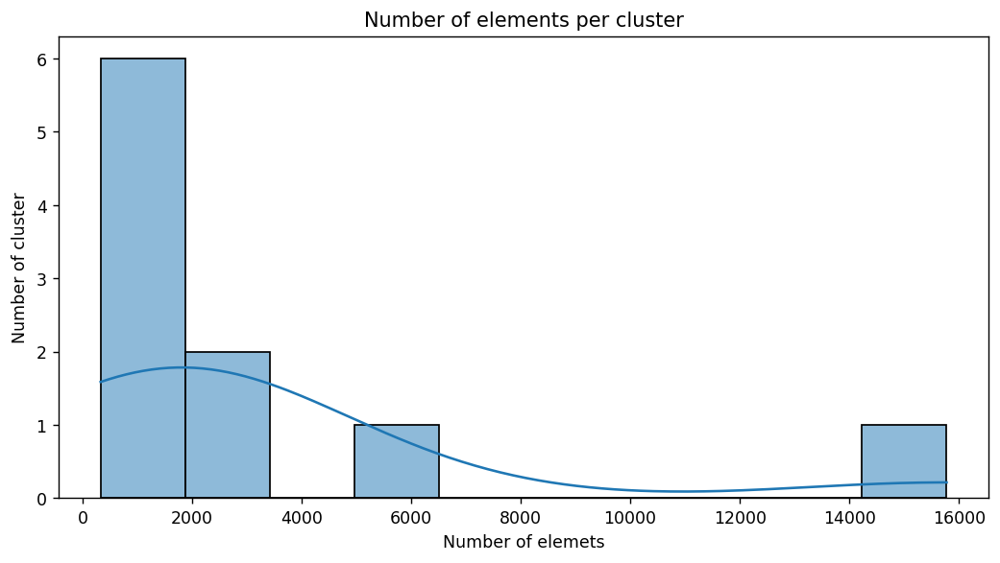

In [ ]:
plt.figure(figsize=(10, 5), dpi=125)
sns.histplot(number_of_elements, bins = k, kde=True)
plt.xlabel('Number of elemets')
plt.ylabel('Number of cluster')
plt.title('Number of elements per cluster')
plt.show()

Looks like there is a very large cluster corresponding to terms that might be more common across the corpus. Mostly, though, the counts are pretty well distributed across the clusters.

#### Quantitative Evaluation of Clustering Results

Let's now move on to the task of quantitatively evaluating the clustering algorithm. There are two ways to evaluate the results of a clustering algorithm:
- **Intrinsic evaluation** - If the ground truth is not known, you could use:
    - Within-cluster sum-of-squares: that is the *inertia* of the K-Means clustering
    - [Silhouette](https://scikit-learn.org/stable/modules/generated/sklearn.metrics.silhouette_score.html#sklearn.metrics.silhouette_score) - "a higher Silhouette Coefficient score relates to a model with better defined clusters"
    
Let's first have a look at the *intrinsic measures*
- print out within-cluster sum-of-squares and the silhouette coefficient:


There are many possible metrics for clustering evaluation: some can be used when the ground truth labels are known, some can be used when the true labels are unknown.



In [ ]:
print("Intrinsic evaluation measures:")
print("Within-cluster sum-of-squares:", str(kmeans.inertia_))
print("Silhouette coefficient:", str(metrics.silhouette_score(vector_outputs, kmeans.labels_)))

Intrinsic evaluation measures:
Within-cluster sum-of-squares: 32732.643366386263
Silhouette coefficient: 0.003886131243916708


The intrinsic evaluation measures are hard to interpret, since their values depend heavily on the difficulty of the clustering task, the amount of data, etc.
- Moreover, the sum-of-squares value will improve monotonically as the number of clusters is increased.


### Minibatch K-means clustering

MiniBatch k-Means is an approximate verions of the k-Means that is designed to scale up to massive datasets by making use of small samples (minibatches) in order to find the k centroids.
- It should be faster to run than k-Means. Let's give it a try:

In [ ]:
mb_kmeans = MiniBatchKMeans(n_clusters=k, batch_size=500, random_state=2307)
mb_kmeans.fit(vector_outputs)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 3 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


MiniBatchKMeans(batch_size=500, n_clusters=10, random_state=2307)

Evaluate the minibatch clustering algorithm to see if the performance compares with the original k-Means on this data:

In [ ]:
print("Intrinsic evaluation measures:")
print("Within-cluster sum-of-squares:", str(mb_kmeans.inertia_))
print("Silhouette coefficient:", str(metrics.silhouette_score(vector_outputs, mb_kmeans.labels_)))

Intrinsic evaluation measures:
Within-cluster sum-of-squares: 32771.46095003698
Silhouette coefficient: 0.0030967807364016752


# Visualisation

Often visualisng the samples and the model output is useful to understand what's going on

### Problems visualising high dimensional data

For a bit of fun, we'll try to transform the high dimensional data into low dimensional data (just 3 dimensions) using a linear dimensionality reduction technique called Singular Value Decomposition.
- We'll transform the `vector_documents` to be 3 dimensional.

In [ ]:
from sklearn.decomposition import TruncatedSVD

svd = TruncatedSVD(3)
reduced_data = svd.fit_transform(vector_outputs)

[x,y,z] = np.transpose(reduced_data)
[x,y,z]

[array([0.08529198, 0.04940652, 0.02818806, ..., 0.00959759, 0.03785933,
        0.03623935]),
 array([-0.02632594, -0.00145852,  0.01243214, ..., -0.00138218,
        -0.01954003,  0.0088363 ]),
 array([ 0.15018188,  0.02364082,  0.00871367, ...,  0.00031248,
        -0.02089901, -0.02446853])]

We can plot the data coloured according to the clusters found by the original k-Means algorithm:

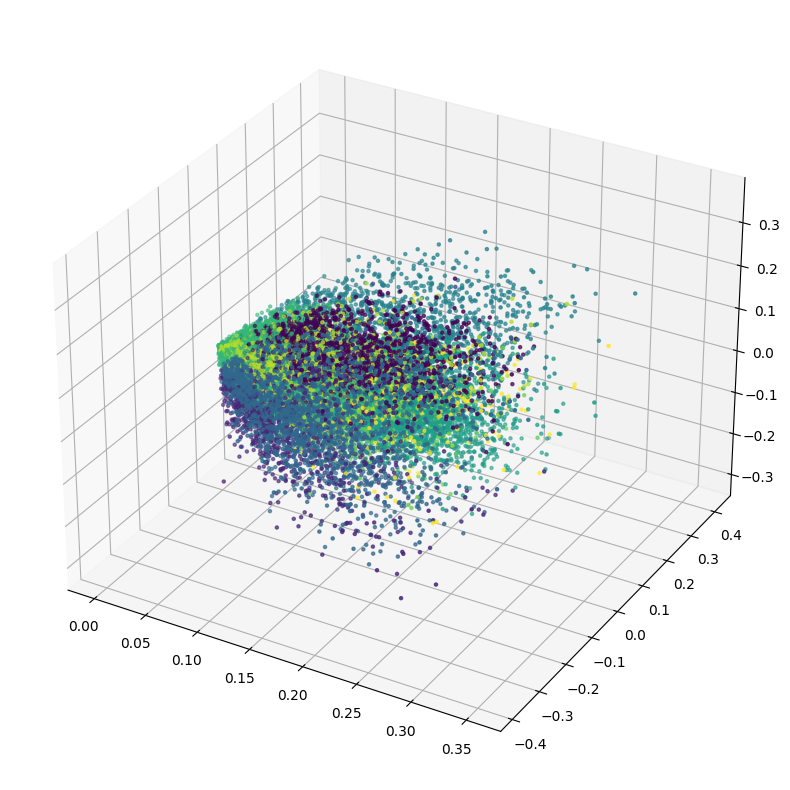

In [ ]:
fig = plt.figure(figsize=(15, 10))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x, y, z, c=kmeans.labels_, marker='.');

# Conclusion from clustering for Answers:

The clustering analysis reveals the main topics within the dataset, with terms consistently associated with specific medical themes, such as **vitamin deficiency**, **cancer types**, **thyroid conditions**, **heart issues**, **symptoms and treatments**, **kidney functions**, and **syndromes**.

Despite the comprehensive clustering, the **silhouette coefficient** is very **low (0.003886)**, indicating that the clusters might not be well-separated and suggesting a need for further refinement or exploration of other clustering techniques to achieve better-defined groupings.

The distribution of documents across clusters highlights varying concentrations, with some clusters (e.g., Cluster 6) containing significantly more documents than others, suggesting prevalent themes within the dataset.

**Term Frequency-Inverse Document Frequency (TF-IDF) Analysis:**
We analyzed the TF-IDF scores for terms within the clusters to identify the most significant terms. For example, terms such as **"levels"** and **"vitamin"** in **Cluster 0** have high TF-IDF scores, indicating their importance in the documents within that cluster. This approach helped us in understanding the key topics and terms that are characteristic of each cluster.

**Cluster Composition and Overlap:**
The cluster composition reveals that certain medical themes dominate the dataset. **Cluster 6**, with the highest number of documents **(15776)**, suggests a predominant focus on patient-related discussions and common diseases. On the other hand, clusters like **Cluster 2** (**330 documents**) focus on more specialized topics such as **thyroid conditions**, indicating less frequent but highly specific content.

**Evaluating Optimal Number of Clusters (k):**
We conducted an evaluation of MiniBatch K-Means clustering over a range of cluster numbers (k) from 10 to 190. The within-cluster sum-of-squares (inertia) decreases as k increases, but the silhouette coefficient remains low throughout. This suggests that while increasing the number of clusters might slightly improve cohesion within clusters, it does not necessarily enhance separation between them.

**Computational Performance:**
The computational performance analysis of MiniBatch K-Means clustering showed varying execution times with different values of k. The execution time generally increases with the number of clusters, reflecting the higher computational complexity. For example, k=10 took 0.44s, whereas k=190 took 17.44s. This information is crucial for optimizing the trade-off between clustering accuracy and computational efficiency.

#Context

#Clustering with contexts

In this section we have used the datasets which we generated using our context retrieval algorithm as the hugging face dataset did not have the context.

In [ ]:
file_dataframe = pd.read_csv('/content/drive/MyDrive/Colab Notebooks/NLP/NLP Project/Datasets/questions_context_dataframe.csv')
print(type(file_dataframe))

<class 'pandas.core.frame.DataFrame'>


In [ ]:
file_dataframe.head()

,question,length,noPunctuation,noStopWords,lemmatized,noStopWords-lemmatized,keywords,contexts
0,What is the relationship between very low Mg2+...,14,"['what', 'is', 'the', 'relationship', 'between...","['relationship', 'low', 'mg2', 'levels', 'pth'...","['what', 'is', 'the', 'relationship', 'between...","['relationship', 'low', 'mg2', 'level', 'pth',...",ca2 pth mg2 levels low,Reduced extracellular Ca2+ is known to promote...
1,What leads to genitourinary syndrome of menopa...,9,"['what', 'leads', 'to', 'genitourinary', 'synd...","['leads', 'genitourinary', 'syndrome', 'menopa...","['what', 'lead', 'to', 'genitourinary', 'syndr...","['lead', 'genitourinary', 'syndrome', 'menopau...",menopause genitourinary vaginitis syndrome atr...,The Postmenopausal Vaginal Microbiome and Geni...
2,What does low REM sleep latency and experienci...,11,"['what', 'does', 'low', 'rem', 'sleep', 'laten...","['low', 'rem', 'sleep', 'latency', 'experienci...","['what', 'doe', 'low', 'rem', 'sleep', 'latenc...","['low', 'rem', 'sleep', 'latency', 'experienci...",hallucinations sleep paralysis latency rem,Narcolepsy type 1 is a disabling disorder with...
3,What are some possible causes of low PTH and h...,12,"['what', 'are', 'some', 'possible', 'causes', ...","['possible', 'causes', 'low', 'pth', 'high', '...","['what', 'are', 'some', 'possible', 'cause', '...","['possible', 'cause', 'low', 'pth', 'high', 'c...",calcium pth causes high low,A 32-year-old lady with a history of bulimia n...
4,How does the level of anti-müllerian hormone r...,11,"['how', 'does', 'the', 'level', 'of', 'antimül...","['level', 'antimüllerian', 'hormone', 'relate'...","['how', 'doe', 'the', 'level', 'of', 'antimüll...","['level', 'antimüllerian', 'hormone', 'relate'...",ovarian hormone müllerian reserve level,Anti-Mullerian hormone is a robust marker of o...


In [ ]:
contexts = file_dataframe["contexts"]

##Context vectorization

We processesed a set of text contexts by first converting them into TF-IDF vectors using TfidfVectorizer.

Then, we evaluated the optimal number of clusters for K-Means clustering by iterating over different k values.

Futhermore, we computed the inertia (within-cluster sum-of-squares) and silhouette scores for each k value, aiding in the assessment of cluster quality.

Finally, we identified the k value with the highest silhouette score as the optimal number of clusters for the given text data.

In [ ]:
vectorizer = TfidfVectorizer(max_df=0.8, min_df=5, stop_words='english', )

In [ ]:
vectorizer.fit(contexts)

TfidfVectorizer(max_df=0.8, min_df=5, stop_words='english')

In [ ]:
vocab = vectorizer.get_feature_names_out()

print(f"Length of vocabulary: {len(vocab)}")

Length of vocabulary: 26451


It's a lot bigger than using only the answers

In [ ]:
vector_contexts = vectorizer.transform(contexts)

In [ ]:
sorted([(vocab[j], vector_contexts[0, j]) for j in vector_contexts[0].nonzero()[1]], key=lambda x: -x[1])

[('ca2', 0.5055627298399121),
 ('mg2', 0.48886021874297336),
 ('pth', 0.27283811070306985),
 ('adenylate', 0.2338648744042026),
 ('cyclase', 0.21392904643208116),
 ('mm', 0.21291059145623448),
 ('secretion', 0.19886797920387445),
 ('gpp', 0.17023411602821137),
 ('concentration', 0.1581290533517575),
 ('nh', 0.14665806562289202),
 ('parathyroid', 0.108453067290898),
 ('repletion', 0.1043604980888794),
 ('stimulated', 0.10212729627131056),
 ('membranes', 0.10150080814581963),
 ('guanine', 0.09354594976168103),
 ('inhibition', 0.08200624034980264),
 ('camp', 0.07886854136016465),
 ('maximal', 0.07535159959904732),
 ('promote', 0.06859800354827948),
 ('presence', 0.06669927995599156),
 ('rat', 0.06186615380494325),
 ('enzyme', 0.05326843040898242),
 ('decrease', 0.05274184017126062),
 ('maximally', 0.051430647059034586),
 ('edta', 0.050764516799448434),
 ('yl', 0.04912091470100998),
 ('metals', 0.04912091470100998),
 ('broken', 0.04745817840297681),
 ('gtp', 0.046772974880840514),
 ('assay

We can try to compare the top words of the first context with the question and the answer to see if they are relevant

In [ ]:
print("Input: ", input[0], "\n")
print("Output: ", output[0], "\n")
print("Context: ", contexts[0])

Input:  What is the relationship between very low Mg2+ levels, PTH levels, and Ca2+ levels? 

Output:  Very low Mg2+ levels correspond to low PTH levels which in turn results in low Ca2+ levels. 

Context:  Reduced extracellular Ca2+ is known to promote PTH secretion, while severe Mg2+ 
depletion has the opposite effect. We have correlated the effects of Mg2+ and 
Ca2+ on parathyroid hormone (PTH) secretion and cAMP accumulation by rat 
parathyroid tissues in vitro with the effects of these two metals on adenylate 
cyclase activity in broken membrane preparations. PTH secretion was maximal at 
0.5 mM Ca2+, falling to low levels as the Ca2+ concentration was increased to 
2.5 mM. Deletion of Mg2+ from the medium resulted in a marked decrease in PTH 
secretion at any given Ca2+ concentration. At a constant Ca2+ concentration of 1 
mM, both PTH secretion and cAMP production rose to maximal rates as the Mg2+ 
concentration was increased from 0 to 2 mM. The adenylate cyclase of rat 
parathy

Mg2, Ca2 and PTH are stricly connected with both the answer and the question

##Selecting a value of k

We evaluated the performance of MiniBatch K-Means clustering over a range of cluster numbers (k) from 10 to 190.

Futhermore, we measured and printed the inertia and execution time for each value of k and estimate the remaining time for the evaluations.

Finally, stored the results for further analysis to determine the optimal number of clusters.

In [ ]:
if True:
  performance_inertia = []
  performance_labels = []
  sum_time = 0
  k_values = range(10,200, 10)
  for k in k_values:
    print(f'Evaluation with k={k}')
    start =time.time()
    mini_batch = MiniBatchKMeans(n_clusters=k, batch_size=500, random_state=2307, n_init=2).fit(vector_contexts)
    end = time.time()
    execution_time = round(end-start, 2)
    sum_time += execution_time
    i = k_values.index(k)+1
    estimated_remaining_time = round((sum_time/i)*(len(k_values)-i), 2)
    performance_inertia.append(mini_batch.inertia_)
    performance_labels.append(mini_batch.labels_)
    print(f'Inertia:{mini_batch.inertia_}\nExecution time:{execution_time}s\nEstimated remaining time:{estimated_remaining_time}s\n\n')

Evaluation with k=10
Inertia:32788.764449994
Execution time:0.77s
Estimated remaining time:13.86s


Evaluation with k=20
Inertia:32607.472527703685
Execution time:1.35s
Estimated remaining time:18.02s


Evaluation with k=30
Inertia:32534.901935455342
Execution time:3.62s
Estimated remaining time:30.61s


Evaluation with k=40
Inertia:32538.308897209543
Execution time:7.59s
Estimated remaining time:49.99s


Evaluation with k=50
Inertia:32702.81043831083
Execution time:3.58s
Estimated remaining time:47.35s


Evaluation with k=60
Inertia:32328.40868717479
Execution time:4.03s
Estimated remaining time:45.37s


Evaluation with k=70
Inertia:32432.48901665106
Execution time:8.67s
Estimated remaining time:50.76s


Evaluation with k=80
Inertia:32481.895252399707
Execution time:5.64s
Estimated remaining time:48.47s


Evaluation with k=90
Inertia:32765.764421358454
Execution time:10.52s
Estimated remaining time:50.86s


Evaluation with k=100
Inertia:32411.782457881658
Execution time:10.3s
Estimate

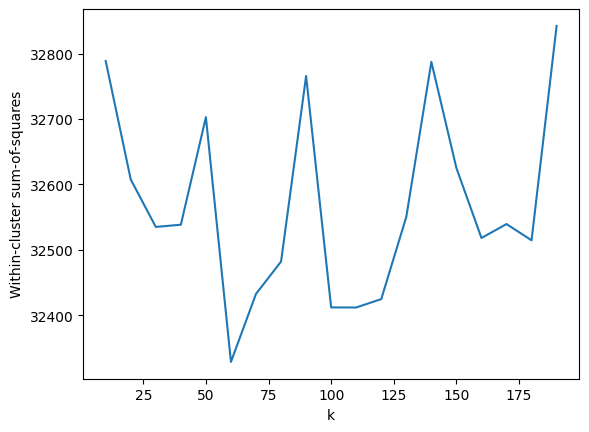

In [ ]:
plt.figure()
plt.plot(k_values, performance_inertia)
plt.ylabel('Within-cluster sum-of-squares')
plt.xlabel('k')
plt.show()

From the graph it is impossible to understand the right value of k so we calculate the silhouette scores for the same k values

In [ ]:
from tqdm import tqdm
silhouette_scores = []
for labels in tqdm(performance_labels):
  silhouette_scores.append(metrics.silhouette_score(vector_contexts, labels))

100%|██████████| 19/19 [16:16<00:00, 51.40s/it]


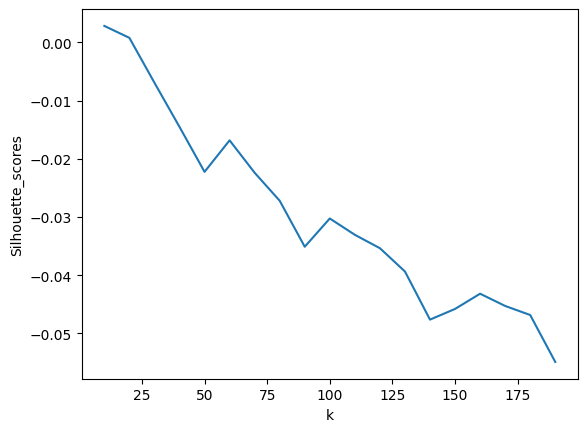

In [ ]:
plt.figure()
plt.plot(k_values, silhouette_scores)
plt.ylabel('Silhouette_scores')
plt.xlabel('k')
plt.show()

In [ ]:
k = k_values[np.argmax(silhouette_scores)]
print(f'The value of K with the highest silhouette_scores is {k}')

The value of K with the highest silhouette_scores is 10


##K-means clustering

We performed K-Means clustering to group similar text documents together. Here's what we learned from this analysis:

**Cluster Themes:** We identified 10 distinct groups (clusters) of text documents. Each cluster has a set of keywords that best represent the common themes or topics found within the documents in that group.

**Understanding Each Group:** We can see the top 10 most important words for each cluster. This helped us understand the core ideas that define each group of documents.

**Finding Representative Documents:** We found a document that closely resembles the central point (centroid) of the first cluster. This document served as a good example of the typical text found within that cluster.

**Distribution of Documents:** We explored how many documents belong to each cluster. We then visualized this distribution using a histogram. This helps us see how many documents fall into each group size category.

**Cluster Quality Check:** We performed some calculations to assess the quality of the clustering. These calculations tell us how tightly documents within each group resemble each other.

In short, this analysis helped us understand how the text documents can be grouped based on their content. We can see the key themes for each group, how many documents fall into each group, and how well the documents within each group are clustered together.

In [ ]:
k = 10

kmeans = KMeans(n_clusters=k, max_iter=100, verbose=True, random_state=2307, n_init=2)
kmeans.fit(vector_contexts)

Initialization complete
Iteration 0, inertia 63821.95605370491.
Iteration 1, inertia 32951.33855370684.
Iteration 2, inertia 32887.44977251749.
Iteration 3, inertia 32855.55648763981.
Iteration 4, inertia 32831.427793859606.
Iteration 5, inertia 32812.5312423155.
Iteration 6, inertia 32802.54379095395.
Iteration 7, inertia 32798.83957392853.
Iteration 8, inertia 32796.84089578173.
Iteration 9, inertia 32795.39346731924.
Iteration 10, inertia 32794.07382164021.
Iteration 11, inertia 32792.630821696424.
Iteration 12, inertia 32791.34732732756.
Iteration 13, inertia 32789.745668030446.
Iteration 14, inertia 32788.16852373995.
Iteration 15, inertia 32786.712070277295.
Iteration 16, inertia 32785.12405366023.
Iteration 17, inertia 32783.08980984668.
Iteration 18, inertia 32781.19069437412.
Iteration 19, inertia 32779.65228623867.
Iteration 20, inertia 32778.03803195854.
Iteration 21, inertia 32775.74981304024.
Iteration 22, inertia 32772.625168265775.
Iteration 23, inertia 32770.31341081748

KMeans(max_iter=100, n_clusters=10, n_init=2, random_state=2307, verbose=True)

In [ ]:
# Get the centroid for the first cluster
centroid = kmeans.cluster_centers_[0]

# Sort terms according to their weights
# (argsort goes from lowest to highest, we reverse the order through slicing)
sorted_terms = centroid.argsort()[::-1]

# Print out the top 10 terms for the cluster
[vocab[j] for j in sorted_terms[:20]]

['virus',
 'hiv',
 'infection',
 'viral',
 'hepatitis',
 'hbv',
 'viruses',
 'hsv',
 'herpes',
 'infected',
 'patients',
 'infections',
 'human',
 'rna',
 'hcv',
 'simplex',
 'replication',
 'dna',
 'cmv',
 'influenza']

In [ ]:
index = np.argmax([np.dot(centroid,vec) for vec in vector_contexts.toarray()])

print(contexts[index])

Hepatitis B virus replication in diverse cell types during chronic hepatitis B 
virus infection.


In [ ]:
print("Top terms per cluster:")
vocab = vectorizer.get_feature_names_out()

for i in range(kmeans.n_clusters):
    centroid = kmeans.cluster_centers_[i]
    sorted_terms = centroid.argsort()[::-1]
    print(f"Cluster {i}:\t{[vocab[j] for j in sorted_terms[:10]]}")

Top terms per cluster:
Cluster 0:	['virus', 'hiv', 'infection', 'viral', 'hepatitis', 'hbv', 'viruses', 'hsv', 'herpes', 'infected']
Cluster 1:	['case', 'patient', 'report', 'old', 'year', 'rare', 'diagnosis', 'symptoms', 'presented', 'disease']
Cluster 2:	['syndrome', 'case', 'patients', 'report', 'associated', 'diagnosis', 'clinical', 'patient', 'rare', 'treatment']
Cluster 3:	['nerve', 'study', 'acid', 'activity', 'blood', 'type', 'protein', 'effects', 'human', 'effect']
Cluster 4:	['treatment', 'disease', 'patients', 'clinical', 'therapy', 'drugs', 'drug', 'review', 'use', 'symptoms']
Cluster 5:	['cancer', 'breast', 'risk', 'lung', 'patients', 'tumor', 'hpv', 'prostate', 'carcinoma', 'women']
Cluster 6:	['pulmonary', 'lung', 'respiratory', 'embolism', 'patients', 'pressure', 'disease', 'ventilation', 'volume', 'hypertension']
Cluster 7:	['patients', 'study', 'group', 'risk', 'age', 'results', '95', 'years', 'ci', 'women']
Cluster 8:	['heart', 'cardiac', 'aortic', 'ventricular', 'le

In [ ]:
print('Number of docs in: ')
number_of_elements = []
for i in range(kmeans.n_clusters):
    n_docs = np.sum(kmeans.labels_ == i)
    print(f"Cluster {i}: {n_docs}")
    number_of_elements.append(n_docs)

Number of docs in: 
Cluster 0: 1142
Cluster 1: 3821
Cluster 2: 1376
Cluster 3: 12542
Cluster 4: 4679
Cluster 5: 917
Cluster 6: 742
Cluster 7: 4481
Cluster 8: 1196
Cluster 9: 2651


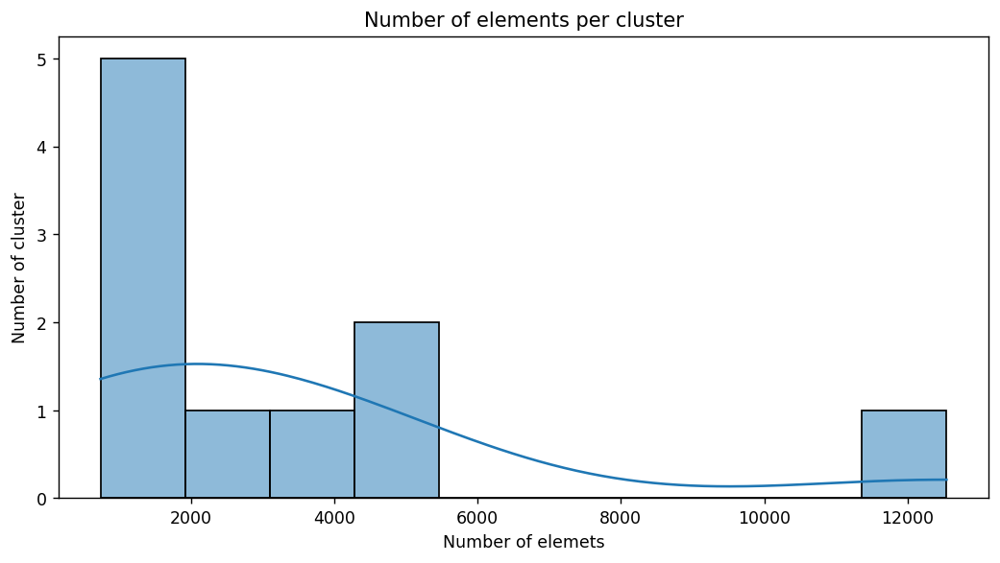

In [ ]:
plt.figure(figsize=(10, 5), dpi=125)
sns.histplot(number_of_elements, bins = k, kde=True)
plt.xlabel('Number of elemets')
plt.ylabel('Number of cluster')
plt.title('Number of elements per cluster')
plt.show()

In [ ]:
print("Intrinsic evaluation measures:")
print("Within-cluster sum-of-squares:", str(kmeans.inertia_))
print("Silhouette coefficient:", str(metrics.silhouette_score(vector_contexts, kmeans.labels_)))

Intrinsic evaluation measures:
Within-cluster sum-of-squares: 32764.72894424961
Silhouette coefficient: 0.0029566628146884964


# Conclusion from clustering for context:

Our clustering analysis reveals distinct themes in the dataset, including viral infections, case reports, syndromes, biological studies, treatments, cancer research, pulmonary diseases, epidemiological studies, cardiac conditions, and cellular biology.

The largest clusters are focused on biological studies and treatments, indicating a significant emphasis in these areas.


**Cluster Size Distribution:**



*   **Observation:** Cluster sizes vary significantly, with the largest cluster (Cluster 3) containing 12,542 documents and the smallest (Cluster 6) containing 742 documents.
*   **Implication:** This suggests that some topics are much more prevalent in the dataset. For instance, biological studies and treatments are heavily represented, indicating these are major areas of focus or interest in the dataset.

**Dominant Themes:**



*   **Clusters with Common Themes:** Multiple clusters (e.g., Clusters 1, 2, and 4) relate to patient care and treatment, though they differ in focus (case reports, clinical syndromes, and therapies).
*   **Implication:** There's a strong emphasis on clinical aspects of medicine, showing a potential overlap in topics, which might suggest a need for more granular clustering.

**Term Overlap:**

*   **Observation:** Some terms like "patients" and "case" appear in multiple clusters, indicating common topics across different clusters.
*   **Implication:** The dataset might benefit from a hierarchical clustering approach to better differentiate between overlapping themes.


**Intrinsic Evaluation Measures:**


*   **Within-cluster sum-of-squares (Inertia):** 32764.73
*   **Silhouette Coefficient:** 0.00296


The high inertia value suggests some clusters are not very compact, and the low silhouette coefficient indicates that the clusters are not well-separated.
This could be because we have a closed-domain dataset (medical one) covering a wide range of highly specilized topics.  To achieve a high level of internal cohesion within each cluster, we would need a large number of clusters, ensuring that each cluster contrains only closely related elements.




# Word Embedding

# Word Embeddings Introduction

Word embeddings are a type of word representation that allows words to be expressed as vectors in a continuous vector space. These vectors capture semantic menaings and relationshps between words bases on their usage in large text of corpora

## Import and Package installation

Let's install some important packages and libraries

In [ ]:
!pip install --upgrade gensim
!pip install scikit-learn
!pip install matplotlib
!pip install datasets
!pip install plotly

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 542.0/542.0 kB 7.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 9.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 10.7 MB/s eta 0:00:00


In [ ]:
!pip install fasttext

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 68.8/68.8 kB 2.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Using cached pybind11-2.12.0-py3-none-any.whl (234 kB)
  Created wheel for fasttext: filename=fasttext-0.9.2-cp310-cp310-linux_x86_64.whl size=4227136 sha256=a54fb68ffb4fa5237623bffd7428ec540df6206d644799cde8f6d82da79faae6
  Stored in directory: /root/.cache/pip/wheels/a5/13/75/f811c84a8ab36eedbaef977a6a58a98990e8e0f1967f98f394
Successfully built fasttext


Let's import some useful libraries

In [ ]:
from google.colab import drive
import os
from gensim.models.word2vec import Word2Vec
import gensim.downloader as api
from gensim.models import FastText, Word2Vec, KeyedVectors
import string
import numpy as np
import pandas as pd
from pandas.core.common import flatten
import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize
from datasets import load_dataset
import re
import csv
import random
import plotly.express as px
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import fasttext
import seaborn as sns
from scipy.spatial.distance import pdist, squareform

## Setup

In [ ]:
drive.mount('/content/drive')
os.chdir(f'/content/drive/MyDrive/Colab Notebooks/NLP/Assignment/datasets')
os.getcwd()

Mounted at /content/drive


'/content/drive/MyDrive/Colab Notebooks/NLP/Assignment/datasets'

Set to true **HUGGINGFACE** to download the dataset directly from HuggingFace

In [ ]:
HUGGINGFACE = False

In [ ]:
nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [ ]:
nltk.download('punkt')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

## Utils

Define a dictionary of contractions and their expansions

In [ ]:
contractions_dict = {
    "can't": "cannot",
    "won't": "will not",
    "I'm": "I am",
    "he's": "he is",
    "she's": "she is",
    "it's": "it is",
    "they're": "they are",
    "we're": "we are",
    "you're": "you are",
    "isn't": "is not",
    "aren't": "are not",
    "wasn't": "was not",
    "weren't": "were not",
    "don't": "do not",
    "doesn't": "does not",
    "didn't": "did not",
    "haven't": "have not",
    "hasn't": "has not",
    "hadn't": "had not",
    "I'll": "I will",
    "you'll": "you will",
    "he'll": "he will",
    "she'll": "she will",
    "we'll": "we will",
    "they'll": "they will",
    "I'd": "I would",
    "you'd": "you would",
    "he'd": "he would",
    "she'd": "she would",
    "we'd": "we would",
    "they'd": "they would",
    "there's": "there is",
    "here's": "here is",
    "how's": "how is",
    "let's": "let us",
    "that's": "that is",
    "what's": "what is",
    "who's": "who is",
    "where's": "where is",
    "why's": "why is",

}

The **expand_contractions** function is designed to expand contractions in a given text based on a provided dictionary of contractions and their corresponding expanded forms.

In [ ]:
def expand_contractions(text, contractions_dict=contractions_dict):
    contractions_pattern = re.compile('({})'.format('|'.join(contractions_dict.keys())),
                                      flags=re.IGNORECASE | re.DOTALL)

    def replace(match):
        match_text = match.group(0)
        expanded_text = contractions_dict.get(match_text.lower())
        return expanded_text

    expanded_text = contractions_pattern.sub(replace, text)
    return expanded_text

The function **preprocess_document** is designed to process a given document, performing various optional text preprocessing steps based on the specified parameters. These parameters include:

* expand: If set to True, the function expands contractions in the document (e.g., "can't" to "cannot").
* isSorted: If set to True, the function sorts the processed document alphabetically.
* isSet: If set to True, the function converts the processed document into a set, removing any duplicate elements.
* noStopWords: If set to True, the function removes common English stopwords from the processed document.
* lemmatization: If set to True, the function lemmatizes the words in the processed document using WordNet.

The function begins by expand contractions, removing punctuation from the document using a regular expression. Then, depending on the parameters provided, it applies additional processing steps accordingly. Finally, it returns the processed document.

In [ ]:
def preprocess_document(document, expand=False, noPunctuation=False, isSorted=False, isSet=False, noStopWords=False, lemmatization=False):
    newDocument = document
    if expand:
        newDocument = [expand_contractions(word) for word in newDocument]
    if noPunctuation:
        regex = '[' + string.punctuation + ']'
        newDocument = [re.sub(regex, '', item) for item in newDocument]
    if isSet:
        newDocument = set(newDocument)
    if noStopWords:
        newDocument = [w for w in newDocument if w not in stopwords.words('english')]
    if isSorted:
        newDocument = sorted(newDocument)
    if lemmatization:
        lemmatizer = WordNetLemmatizer()
        newDocument = [lemmatizer.lemmatize(w) for w in newDocument]
    return ' '.join(newDocument)

The upcoming snippet of code demonstrates how to use vector arithmetci with a pre-trained word embedding model to find terms semantically similar to a given concept given the vocabulary of the embedding.
This technique leverages the semantic relationships captured by the word embeddings to explore and understand the conceptual adjustments within the embedding space

In [ ]:
def adjust_term_vector(model,term, term_to_adjust_from, term_to_adjust_to, topN=10):
  term_vec = model.get_vector(term)
  adjust_from_vec = model.get_vector(term_to_adjust_from)
  adjust_to_vec = model.get_vector(term_to_adjust_to)
  adjusted_vec = term_vec + (adjust_from_vec - adjust_to_vec)
  closest_terms = model.most_similar(adjusted_vec, topn=topN)
  return closest_terms

In [ ]:
def plot_PCA_decomposition(model, words):
  words_vec = np.array([model[word] for word in words])
  pca = PCA(n_components=2)
  words_vec_2d = pca.fit_transform(words_vec)
  plt.figure(figsize=(7, 7))
  plt.scatter(words_vec_2d[:, 0], words_vec_2d[:, 1], edgecolors='k', c='g')
  for word, (x, y) in zip(words, words_vec_2d):
      plt.text(x, y, word, fontsize=12)
  plt.show()

# Dataset loading

**Basic Description of the Dataset and its Design**

The dataset in our study was derived from the Anki Medical Curriculum flashcards, a comprehensice collection curated and continually updated by medical students. Thes flashcards cover the full breadth of the medcial curriculum, encompassing subjects suche as anatomy, physiology, pathology and pharmacology. Each flashcard typically includes summaries to facilitate the learning and retention of key medical concepts. To create the dataset, the content was extracted from these flashcards, excluding those containing images.
Then, OpenAI's GPT 3.5- turbo was employed to transfrom the flashcard content into coherent, contextually relevant question-answer pairs.

The dataset consists of over 30,000 questions, each accompanied by a corresponding segment of text serving as its answer. Notably, these answers lack any additional context.



**Dataset Loading**

We initiate dataset download with this code snippet, offering flexibility in data retrieval. Depending on the value of the HUGGINGFACE flag, the script fetches the dataset from Hugging Face's repository or directly loads it from a CSV file stored on Google Drive. This versatile approach simplifies the process of acquiring the necessary data for analysis or modeling tasks.

## Huggining face loading

In [ ]:
if HUGGINGFACE == True:
  raw_datasets =  load_dataset("medalpaca/medical_meadow_medical_flashcards", download_mode="force_redownload")
  raw_dataframe = raw_datasets['train'].to_pandas()
  raw_dataframe.to_csv('MedFlashCards.csv', index=False)


## Drive loading

In [ ]:
if HUGGINGFACE == False:
  medFlashCards_dataframe = pd.read_csv('MedFlashCards.csv')

question_df = pd.read_csv('questions_dataframe.csv')
answer_df = pd.read_csv('answers_dataframe.csv')


# Learning word embeddings

## Data Preprocessing

Data preprocessing is crucial before training word embeddings because it ensures the text data is clean, consistent, and meaningful. Here's why each operation is important:


*   **Remove Punctuation and Special Characters**: Punctuation and special characters do not carry meaningful semantic information for word embeddings and can introduce noise. Removing them helps focus on the actual words and their relationships

*   **Expand Contractions**: Contractions like "can't" or "won't" are expanded to "cannot" and "will not" to standardize the text. This ensures that the model treats them as the same words rather than different tokens, improving the quality of embeddings

*  **Lowercase Words**: Converting all words to lowercase standardizes the text, so "Apple" and "apple" are treated as the same word. This reduces the vocabulary size and improves the embeddings' consistency.

*  **Lemmatization**: Lemmatization reduces words to their base or root form, such as converting "running" to "run." This helps in grouping similar words together, ensuring that the embeddings capture the core meaning rather than different forms of the same word.

By performing these preprocessing steps, the text data becomes cleaner and more uniform, allowing the word embeddings to capture more accurate and meaningful representations of the words.

In [ ]:
train_questions = question_df['question'].apply(lambda question: preprocess_document(question.lower().split(), noPunctuation=True, expand=True, lemmatization=True ))
train_answers = answer_df['answer'].apply(lambda answer: preprocess_document(answer.lower().split(), noPunctuation=True, expand=True, lemmatization=True ))

First, we will train word embeddings using the Word2Vec implementation from the Gensim package

In [ ]:
train_questions = list(flatten(train_questions))
train_answers = list(flatten(train_answers))

## Tokenization


In the upcoming code block, the tokenization process is performed. Tokenization involves splitting text into smaller units called tokens, which can be words, subwords, or characters. For word embeddings, this typically means breaking down a text into individual words or subwords that can then be converted into vectors.

In [ ]:
train_questions_tokenized = [word_tokenize(question) for question in train_questions]
train_answers_tokenized = [word_tokenize(answer) for answer in train_answers]
tokenized_sentences = train_questions_tokenized + train_answers_tokenized

## Word2Vec

Word2Vec is a method for generating word embeddings by training a shallow neural network on a large corpus of text data. It learns dense vector representations of words based on their context, capturing semantic relationships between words. These embeddings are widely used in NLP tasks to measure semantic similarity and improve performance in various applications



Finally we have the data in the right format for training Word2Vec, so we can provide it to the algorithm. For parameters, we set:
- the embedding size to be 30,
- the minimum count for any vocabulary term to be 5
- the size of the context window to 10.

In [ ]:
model = Word2Vec(tokenized_sentences, vector_size=30, min_count=5, window=10)

Let's see how big the vocabulary is that Word2Vec ended up using, i.e. how many word vectors did it learn:

In [ ]:
num_vectors = len(model.wv)
print('Number of learned vectors: ', num_vectors)

Number of learned vectors:  12824


### Inspecting embeddings and finding similar words

Let's print out one of the vectors to see what looks like now that we have a word2vec model trained:

In [ ]:
term = 'pregnancy'
model.wv[term]

array([ 0.984957  ,  1.3739016 , -2.4191678 ,  4.133384  , -0.6262379 ,
        4.0053144 , -2.171859  ,  1.5274634 , -1.3451711 ,  1.005634  ,
        8.982003  ,  5.5150785 ,  3.1384373 ,  6.410594  , -3.1742835 ,
       -5.5296335 , -0.3376467 , -2.5124896 , -0.8216255 ,  2.8813436 ,
       -1.6556225 , -2.6263    ,  0.66339594, -0.37167728, -4.672228  ,
       -4.867755  ,  0.60901535, -2.911126  ,  0.05925114,  4.121264  ],
      dtype=float32)

We could now use the model to compute similarities between terms based on their cosine distance in the embedding space.


In [ ]:
term = 'heart'
model.wv.most_similar(term)

[('cardiac', 0.7828686833381653),
 ('pulmonary', 0.6891435980796814),
 ('stroke', 0.6551571488380432),
 ('left', 0.6438024640083313),
 ('ventricular', 0.6318501234054565),
 ('flow', 0.6295478940010071),
 ('cardiomyopathy', 0.6183631420135498),
 ('rvr', 0.6173581480979919),
 ('lung', 0.6118032932281494),
 ('arrhythmia', 0.6093399524688721)]

In [ ]:
term = 'virus'
model.wv.most_similar(term)

[('human', 0.8375719785690308),
 ('animal', 0.82331782579422),
 ('viral', 0.8030317425727844),
 ('pathogen', 0.8018832206726074),
 ('member', 0.7666654586791992),
 ('malaria', 0.7534253597259521),
 ('herpesvirus', 0.7475161552429199),
 ('chickenpox', 0.7412557005882263),
 ('reservoir', 0.7403846979141235),
 ('transmission', 0.7320493459701538)]

In [ ]:
term = 'antidepressant'
model.wv.most_similar(term)

[('antipsychotic', 0.9130872488021851),
 ('ssri', 0.9074057936668396),
 ('benzodiazepine', 0.9026447534561157),
 ('tcas', 0.8990811109542847),
 ('carbamazepine', 0.8914530277252197),
 ('tricyclic', 0.8811619281768799),
 ('olanzapine', 0.874509871006012),
 ('snris', 0.8686013221740723),
 ('secondgeneration', 0.8626098036766052),
 ('quetiapine', 0.8601287007331848)]

In [ ]:
term = 'insulin'
model.wv.most_similar(term)

[('glucagon', 0.7963194847106934),
 ('cortisol', 0.7506731748580933),
 ('glucose', 0.7320610880851746),
 ('thyroxinebinding', 0.719237208366394),
 ('renin', 0.7127989530563354),
 ('estrogen', 0.7096562385559082),
 ('adh', 0.7006741762161255),
 ('ocp', 0.6998757719993591),
 ('catecholamine', 0.6993333101272583),
 ('aldosterone', 0.6939207315444946)]


The following snippet of code shows how a word's meaning shifts based on an analogy. Imagine insulin is the base word. We want its meaning to move away from diabetes and closer to pneumonia. The code uses a fancy method (PCA) to create a visual map where closer words have similar meaning

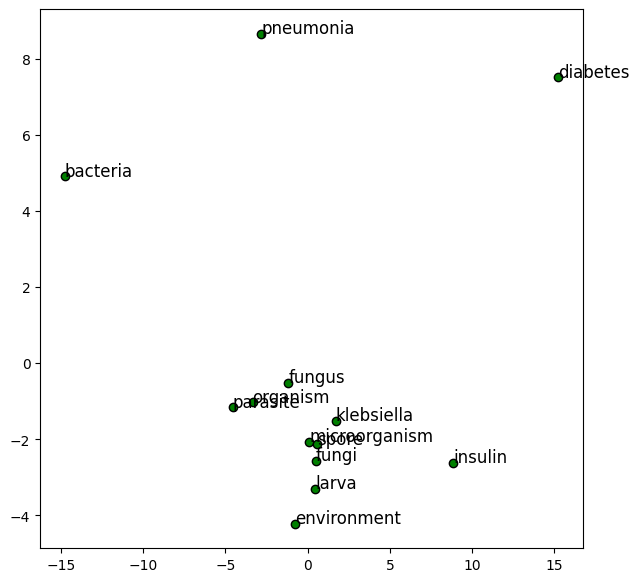

In [ ]:
term_vec = 'insulin'
adjust_from_vec = 'pneumonia'
adjust_to_vec = 'diabetes'
closest_terms = adjust_term_vector(model.wv,term_vec, adjust_from_vec, adjust_to_vec)
words = [word[0] for word in closest_terms] + [term_vec, adjust_from_vec, adjust_to_vec]
plot_PCA_decomposition(model.wv, words)

### Visualising the embedding vectors using t-SNE

We'll now visualise some of the word vectors in a 3 dimensional space using t-SNE.
The vocabulary of word vectors is quite large (around 25,000). Giving them all to t-SNE will cause it to take far too long to converge. So let's first choose a random subset of 500 terms to show.

In [ ]:
sample = random.sample(list(model.wv.key_to_index), 500)
print(sample)

['bonus', 'mmr', 'shortacting', 'laxative', 'prematurity', 'nitrosureas', 'tularensis', 'pde5', 'observing', 'mature', 'two', 'adrenaline', 'highlighting', '21hydroxylase', 'equal', 'orchiopexy', 'gubernaculum', 'twitch', 'silicosis', 'mostly', 'stsegment', 'mhcs', 'bothersome', 'gonad', 'pylorus', 'hp', 'perinatal', 'botryoides', 'catch', 'endocardium', 'splicing', 'latent', 'hydrocarbon', 'immunosorbent', 'epicondyle', 'intramuscularly', 'hiv', 'koplik', 'previously', 'shinedalgarno', 'carboxylase', 'innate', 'chemotherapyinduced', 'ironcontaining', 'spermatogenesis', 'nifedipine', 'toxin', 'purulent', 'odor', 'embolization', 'abducens', 'drowning', 'rolling', 'cholecystectomy', 'excrete', 'sobriety', 'reversibility', 'angioplasty', 'shortness', 'famciclovir', 'encephalopathy', 'dopa', 'term', 'displaying', 'interspersed', '11deoxycorticosterone', 'fibrous', 'dash', 'fit', 'thirdtrimester', 'reninangiotensinaldosterone', 'fastigial', 'agenesis', 'misfolded', 'resume', 'pm', 'deiodina

Now we'll get the word vectors for the sampled terms:

In [ ]:
word_vectors = model.wv[sample]
word_vectors

array([[ 0.06685182, -0.19888394,  0.42301267, ...,  0.53433734,
        -0.01534741,  0.29816443],
       [-0.37866214,  0.17242959, -0.08695994, ...,  0.18164071,
         0.42173502, -0.10814668],
       [-0.41228393,  0.40014538,  0.09201097, ...,  0.12326173,
        -0.20069204,  0.12257712],
       ...,
       [ 0.10597809, -0.3704298 ,  0.60762995, ...,  0.88226527,
         1.1162413 ,  1.0589542 ],
       [-0.07905617,  0.06568398,  0.08211022, ...,  0.15095302,
        -0.08824655,  0.04065832],
       [-0.07243624, -0.15624072, -0.00841592, ...,  0.06018213,
         0.00741082,  0.02679538]], dtype=float32)

And we'll provide the vectors to TSNE to fit a model and transform the data to 3 dimensions:

In [ ]:
tsne = TSNE(n_components=3, n_iter=2000)
tsne_embedding = tsne.fit_transform(word_vectors)

Now transform the data into 3 columns (for x, y, and z):

In [ ]:
x, y, z = np.transpose(tsne_embedding)

And generate the 3d plot:

In [ ]:
fig = px.scatter_3d(x=x, y=y, z=z)
fig.update_traces(marker=dict(size=3,line=dict(width=2)))
fig.show()

Well that's a not a particularly interesting 3d plot!
- How about we label some of the points on the graph to see what words they correspond to:

In [ ]:
fig = px.scatter_3d(x=x[:200],y=y[:200],z=z[:200],text=sample[:200])
fig.update_traces(marker=dict(size=3,line=dict(width=2)),textfont_size=10)
fig.show()

Let's extend the random set of terms with a set of colours to see if they cluster:

In [ ]:
# Add some specific terms to sample:
colours = ['red','green','blue','orange','yellow','purple','pink','cream','brown','black','white','gray']

word_vectors = model.wv[colours+sample]

tsne = TSNE(n_components=3)
tsne_embedding = tsne.fit_transform(word_vectors)

x, y, z = np.transpose(tsne_embedding)

In [ ]:
import plotly.express as px

r = (-200,200)
fig = px.scatter_3d(x=x, y=y, z=z, range_x=r, range_y=r, range_z=r, text=colours + [None] * 500)
fig.update_traces(marker=dict(size=3,line=dict(width=2)),textfont_size=10)
fig.show()

Note: t-SNE is a stochastic algorithm, so run it a couple of times to see how the visualisation changes.

Have a play around with the visualisation to see whether other sets of terms cluster together.

# Loading Pre-trained Embedding

## Glove-wiki-Gigaword-200

Using GloVe embedddings pre-trained on the Wikipedia 2014 + Gigaword 5 dataset (glove-wiki-gigaword-200) can enhance the performance of question answering systems on our dataset. These embeddings are trained on an extensive corpus, capturing deep semantic and synactic nuances. This pretraining provides a wealth of linguistic knowledge. With 200 dimensions, GloVe embeddings achieve a balance between capturing intricate word relationships and maintaning computational efficiency.
Additionally, employing pretrained embeddings accelerates the training process, as the model starts with rich word representations instead of learning them from scratch. Consequently, glove-wiki-gigaword-200 is an effective, efficient, and practical choice for enhancing question-answering systems across various datasets.

**GloVe-Wiki-Gigaword 200 overview**:


*   **Algorithm**: GloVe which captures global word-word co-occurence statistics
*   **Training Data**: Wikipedia and Gigaword corpus
*   **Vector dimension**: 200-dimensional embeddings




In [ ]:
model_wiki = api.load('glove-wiki-gigaword-200')

[==================================================] 100.0% 252.1/252.1MB downloaded


Let's see how big the vocabulary:

In [ ]:
print('Vocabulary size of Wikipedia model: ', len(model_wiki))

Vocabulary size of Wikipedia model:  400000


### Inspecting embeddings and finding similar words

We could now use the model to compute similarities between terms based on their cosine distance in the embedding space

In [ ]:
term = 'virus'
model_wiki.most_similar(term)

[('h5n1', 0.8023861050605774),
 ('flu', 0.7961314916610718),
 ('influenza', 0.7852848172187805),
 ('viruses', 0.7826143503189087),
 ('infected', 0.7646056413650513),
 ('infection', 0.7565535306930542),
 ('avian', 0.736918032169342),
 ('disease', 0.7129627466201782),
 ('h1n1', 0.7127939462661743),
 ('hiv', 0.6872677206993103)]

This code demonstrates how a word's meaning shifts based on analogies using vector arithmetic, such as "king" to "queen" and "man" to "woman." While a pretrained model on a large open-domain corpus can effectively capture complex word relationships, it often struggles with domain-specific analogies, such as "insulin" to "antibiotics" and "diabetes" to "pneumonia." In the following sections, we will explore how using a domain-specific pretrained model can enhance our performance in these specialized contexts.

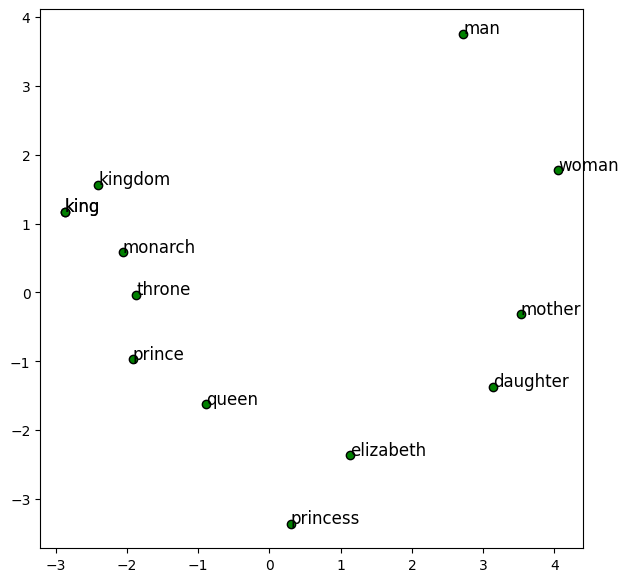

In [ ]:
term_vec = 'king'
adjust_from_vec = 'woman'
adjust_to_vec = 'man'
closest_terms = adjust_term_vector(model_wiki,term_vec, adjust_from_vec, adjust_to_vec)
words = [word[0] for word in closest_terms] + [term_vec, adjust_from_vec, adjust_to_vec]
plot_PCA_decomposition(model_wiki, words)

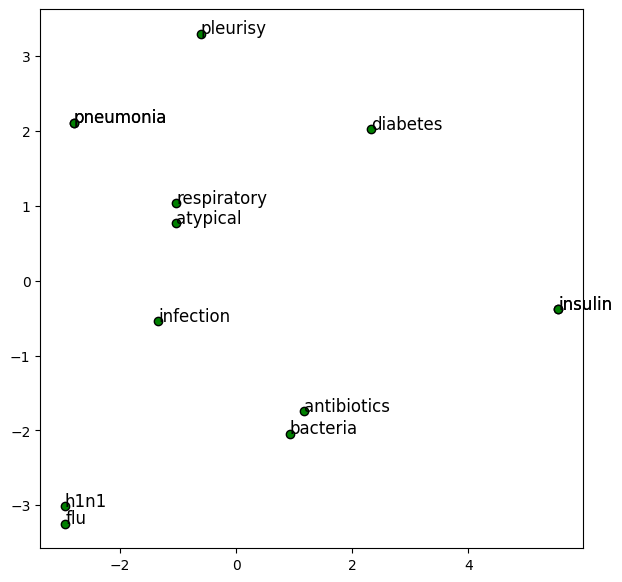

In [ ]:
term_vec = 'insulin'
adjust_from_vec = 'pneumonia'
adjust_to_vec = 'diabetes'
closest_terms = adjust_term_vector(model_wiki,term_vec, adjust_from_vec, adjust_to_vec)
words = [word[0] for word in closest_terms] + [term_vec, adjust_from_vec, adjust_to_vec]
plot_PCA_decomposition(model_wiki, words)

## Word2Ve - PMC - 100

Word embeddings create vector representations of text data, but not all embeddings effectively capture clinical, medical, and biomedical information. These embeddings provide a low-dimensional representation of semantic meaning, facilitating efficient text data analysis. While they are useful across various domains, their application to clinical, medical, and biomedical encounter notes presents several challenges. Commonly available pre-trained embeddings are often derived from broad, non-medical text sources, which may not accurately capture the specific word senses, linguistic relationships, or vocabulary needed in a clinical context. To address this, a training corpus based on clinical case reports from the PubMed Open Access subset is used. Consequently, a medical and biomedical pre-trained embedding model was employed.

**Word2Vec-PMC-Open-Access-All-Manuscripts overview**:


*   **Algorithm**: Word2Vec
*   **Training Data**: PMC Open Access All Manuscripts
*   **Vector dimension**: 100-dimensional embeddings

First download and extract the files from each archive

In [ ]:
!tar -xvf w2v_100d_oa_all.tar.gz

W2V_100/
W2V_100/w2v_oa_all_100d.bin
W2V_100/w2v_oa_all_100d.bin.wv.vectors.npy
W2V_100/w2v_oa_all_100d.bin.trainables.syn1neg.npy


In [ ]:
# Load the model
model = Word2Vec.load('W2V_100/w2v_oa_all_100d.bin')

Let's see how big the vocabulary:

In [ ]:
print(f'Size of the vocabulary: {len(model.wv)}')

Size of the vocabulary: 3748342


### Inspecting embeddings and finding similar words

Return 100-dimensional vector representations of each word

In [ ]:
term = 'diabetes'
model.wv.get_vector(term)

array([ 0.15587237, -0.21526715, -0.0323605 ,  0.76148087, -0.2782854 ,
        0.8411038 , -0.00650625,  0.23433806, -0.0761027 ,  0.00207981,
       -0.4543857 , -0.56023246,  0.19655031, -0.21839005, -0.10521119,
       -0.7835834 , -0.05072837, -0.39997765, -0.2998105 , -0.190565  ,
       -0.30767113, -0.22611964,  0.17512424,  0.6593262 ,  0.3139723 ,
        0.16817726, -0.12756337, -0.53831637,  0.03795823, -0.2157613 ,
        0.02385065, -0.19822836,  0.00516426,  0.34872437,  0.21584529,
       -0.8577351 , -0.26518902, -0.05431383,  0.13116212,  0.13011406,
        0.30474886,  0.7049852 ,  0.2902602 , -0.3332416 , -0.45113745,
       -0.38306913,  0.3473178 ,  0.27516854,  0.16708454,  0.2735584 ,
        0.3073361 , -0.14817624, -0.14050722,  0.13639155, -0.28233448,
        0.3174391 , -0.29256558,  0.5741609 , -0.29911152, -0.4043187 ,
       -0.13000344, -0.1936408 ,  0.18156712, -0.4930326 , -0.11364631,
        0.51986563,  0.5827516 , -0.37697923, -0.41214514,  0.03

In [ ]:
term = 'heart'
model.wv.get_vector(term)

array([ 0.06588871,  0.12963435, -0.20691247, -0.04423665,  0.2269309 ,
       -0.1364273 , -0.2530159 , -0.46485087, -0.25269625,  0.21392882,
       -0.3611834 , -0.23211358, -0.07592588, -0.13356479, -0.07205496,
       -0.05875115,  0.02730198, -0.18926473, -0.02287452,  0.03051401,
        0.20432356, -0.4618003 ,  0.1717871 ,  1.2867819 ,  0.17496017,
       -0.05106358,  0.4412725 , -0.38189805,  0.3641925 ,  0.09629215,
       -0.02156296, -0.16811883,  0.22350307, -0.0425162 ,  0.24586153,
        0.16713923,  0.1058826 ,  0.3592815 ,  0.42844045, -0.2738035 ,
        0.28339168,  0.608544  ,  0.04360754, -0.5102577 , -0.25942618,
       -0.04270536,  0.2818859 , -0.12827787,  0.0987231 ,  0.26725298,
        0.31250048, -0.13091503, -0.7226783 ,  0.5017468 , -0.77895266,
       -0.13317852, -0.19504613,  0.48210967, -0.25118834, -0.5074314 ,
        0.22008288,  0.0405115 ,  0.10661212, -0.18808636, -0.47916555,
       -0.25986305,  0.3770456 ,  0.06979397, -0.09745874, -0.29

In [ ]:
term = 'pregnancy'
model.wv.get_vector(term)

array([ 0.3876718 , -0.20554067,  0.26721066,  0.69642323, -0.16134037,
        0.024119  , -0.35052082, -0.5011512 ,  0.29278904, -0.20137186,
        0.02281141, -0.49786168,  0.2345551 , -0.038245  , -0.22293854,
       -0.4466118 , -0.24806397, -0.16740617, -0.30120847, -0.28024405,
        0.42478663, -0.29440525,  0.4368799 ,  0.7933079 ,  0.52552974,
        0.23457614, -0.2620688 , -0.5737377 , -0.38584918,  0.08757859,
       -0.17154208,  0.2440752 ,  0.10372306,  0.5634213 ,  0.03001689,
       -0.61334354, -0.21322027,  0.0246358 ,  0.3648225 ,  0.6584569 ,
        0.3274665 ,  0.47416034, -0.68190485, -0.28018704, -0.09199507,
        0.06139649,  0.460309  ,  0.08747132,  0.06840397, -0.3425311 ,
        0.18172355, -0.28496417, -0.08614258, -0.28894478, -0.3526635 ,
        0.19265857,  0.1440224 ,  0.70365477,  0.14854184, -0.33009183,
        0.26446   , -0.16543913,  0.4405985 , -0.3465345 ,  0.07069509,
       -0.2495602 ,  0.18496543, -0.17843227, -0.3146148 , -0.39

In [ ]:
model.wv.similarity('myocardial_infarction', 'heart_attack')

0.7921261

We could now use the model to compute similarities between terms based on their cosine distance in the embedding space.


In [ ]:
term = 'delirium'
model.wv.most_similar(term)

[('delirium,', 0.8845890760421753),
 ('delirium.', 0.8689318895339966),
 ('with_delirium', 0.8437003493309021),
 ('delirious', 0.8422060012817383),
 ('delirium_is', 0.8246074914932251),
 ('confusion_assessment_method', 0.8004822731018066),
 ('delirium:', 0.7930217981338501),
 ('delirium)', 0.7926177382469177),
 ('post-icu', 0.7756220698356628),
 ('bpsd', 0.7712751626968384)]

In [ ]:
term = 'heart'
model.wv.most_similar(term)

[('heart,', 0.8543963432312012),
 ('cardiac', 0.8119029402732849),
 ('left_ventricle', 0.8086162805557251),
 ('myocardium', 0.8016836047172546),
 ('heart.', 0.7923861145973206),
 ('left_ventricle,', 0.7900839447975159),
 ('heart_muscle', 0.7879527807235718),
 ('heart)', 0.787436842918396),
 ('myocardium,', 0.7868624329566956),
 ('human_heart', 0.7810763120651245)]

The upcoming snippet of code demonstrates how to use vector arithmetic for word's meaning shifts based on analogies with a pre-trained word embedding model - Word2Vec on PMC Open Access All Manuscripts - to find terms semantically similar to a given concept in the context of medical literature.
This technique leverages the semantic relationships captured by the word embeddings to explore and understand the conceptual adjustments within the embedding space

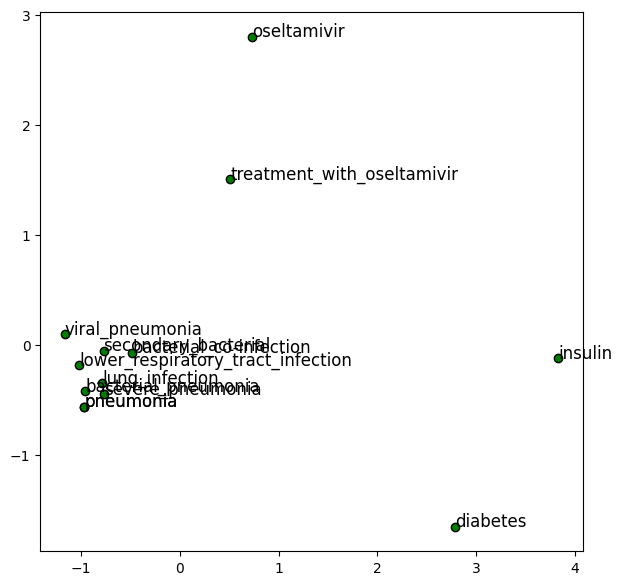

In [ ]:
term_vec = 'insulin'
adjust_from_vec = 'pneumonia'
adjust_to_vec = 'diabetes'
closest_terms = adjust_term_vector(model.wv,term_vec, adjust_from_vec, adjust_to_vec)
words = [word[0] for word in closest_terms] + [term_vec, adjust_from_vec, adjust_to_vec]
plot_PCA_decomposition(model.wv, words)

## FastText - Common Crawl + Wikipedia - 300

fasttext is an extension of the Word2Vec model developed by Facebook AI Research. Unlike traditional Word2Vec, which considers words as atomic units, fasttext trates words as a bags of character n-grams. This approach allows fasttext to generate embeddings for out-of-vocabulary words by aggregating embeddings of their character n-grams, enabling it to handle rare or misspelled words effectively.

In addition to word embeddings, fasttext also supports sentence embeddings. It achieves this by averaging the word embeddings within a sentence to create a fixed-size vector representation of the entire sentence.

**fasttext word vectors for 157 languages overview**:

**Algorithm**: fasttext

**Training Data**: Wikipedia + Commn Crawl

**Vector Dimension**: 300 - dimension embedding

Let's download the model

In [ ]:
# !wget https://dl.fbaipublicfiles.com/fasttext/vectors-wiki/wiki.en.zip
!wget http://dl.fbaipublicfiles.com/fasttext/vectors-crawl/cc.en.300.bin.gz
!gzip -d cc.en.300.bin.gz

--2024-05-26 16:40:56--  http://dl.fbaipublicfiles.com/fasttext/vectors-crawl/cc.en.300.bin.gz
Resolving dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)... 13.226.210.25, 13.226.210.111, 13.226.210.78, ...
Connecting to dl.fbaipublicfiles.com (dl.fbaipublicfiles.com)|13.226.210.25|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 4503593528 (4.2G) [application/octet-stream]
Saving to: ‘cc.en.300.bin.gz’

cc.en.300.bin.gz    100%[===================>]   4.19G  63.6MB/s    in 65s     

2024-05-26 16:42:02 (65.9 MB/s) - ‘cc.en.300.bin.gz’ saved [4503593528/4503593528]



Let's load the model

In [ ]:
ft_model = fasttext.load_model('cc.en.300.bin')

Let's see how big the vocabulary:

In [ ]:
print(f'Size of the vocabulary: {len(ft_model.get_words())}')

Size of the vocabulary: 2000000


### Inspecting embeddings and finding similar words

Return 300-dimensional vector representations of each word

In [ ]:
term = 'diabetes'
ft_model.get_word_vector(term)

array([ 2.66517308e-02, -5.50533133e-03,  4.03945819e-02,  1.43104354e-02,
        1.21714445e-02,  3.73507626e-02,  4.48851362e-02,  7.07524717e-02,
        2.45890114e-02,  2.06059497e-02,  1.02338297e-02, -5.28270043e-02,
       -6.69950247e-02,  3.72967520e-03, -2.40937155e-02,  3.21787829e-03,
        2.69589806e-03,  9.83766541e-02, -9.30464044e-02,  1.68398060e-02,
        7.36800628e-03, -4.16715484e-04, -1.34825185e-02, -3.56079042e-02,
        4.93054837e-03,  2.40103193e-02, -3.05536366e-03, -6.12371676e-02,
        3.45734060e-02,  1.39383614e-01, -3.07154208e-02,  4.38064821e-02,
        5.28979637e-02,  4.45477739e-02,  3.54307890e-02,  2.29135295e-03,
        5.38680255e-02,  8.94212276e-02,  1.57402717e-02, -8.25082790e-03,
       -3.86206098e-02, -1.71223935e-02, -4.24589328e-02,  1.06044553e-01,
       -4.80851568e-02, -7.52982870e-03,  4.24550707e-03, -8.85184680e-04,
        4.01175255e-03,  7.41799921e-02,  5.57622388e-02, -5.69444615e-03,
        7.69035378e-03,  

In [ ]:
term = 'heart'
ft_model.get_word_vector(term)

array([-0.01069687,  0.00749084,  0.02658757,  0.08114164,  0.00507168,
        0.03323174,  0.08663563,  0.08131171,  0.09383441,  0.02778573,
       -0.00543579, -0.05585865,  0.01987327, -0.12310187, -0.03052635,
        0.04407067, -0.03413357,  0.09878649, -0.20513429, -0.05951565,
        0.03060767,  0.09329603, -0.03385869,  0.0049211 , -0.00108816,
       -0.05336034,  0.03967582, -0.04687127,  0.00691536,  0.08799434,
        0.12510814, -0.01051231,  0.16750033,  0.02693585, -0.01639322,
       -0.04386955,  0.04636188,  0.14046961,  0.01264571, -0.00268973,
       -0.05757606,  0.00845254,  0.04046905,  0.09134136, -0.09754813,
        0.04426818,  0.03492715,  0.00722999, -0.03034792, -0.08284545,
        0.00531217,  0.01574977,  0.01269341, -0.05081033, -0.0430023 ,
        0.02883614, -0.06163967,  0.07236434, -0.0622297 ,  0.02622898,
       -0.03778183, -0.07362685, -0.04476019,  0.03067518,  0.07378238,
        0.04446434,  0.08590045, -0.04797767, -0.07052004, -0.00

In [ ]:
term = 'pregnancy'
ft_model.get_word_vector(term)

array([ 0.06442159,  0.02849412, -0.00520854,  0.04224534,  0.05890721,
       -0.04647874,  0.01002928, -0.02467275,  0.06080916,  0.05822769,
       -0.02710035, -0.03775091, -0.00375833,  0.02707931,  0.04183507,
        0.05073382, -0.03351288, -0.04378466, -0.11219592,  0.02444251,
        0.02523908,  0.00695075, -0.01619829, -0.02438295,  0.00566483,
        0.02317011, -0.07134087, -0.00373496,  0.03818878,  0.10423173,
       -0.0502831 , -0.01841491, -0.02388978, -0.06568521,  0.0122    ,
        0.08329898,  0.034153  ,  0.03493753,  0.0022857 , -0.04755963,
        0.03096193, -0.06505139, -0.03324492,  0.09713449, -0.04061525,
        0.00943033,  0.05685892, -0.02212619,  0.03745135, -0.034743  ,
       -0.01422575,  0.02575282, -0.01006156,  0.08419409,  0.02080684,
        0.00757581,  0.08128425,  0.02001539, -0.06189586,  0.04002463,
       -0.03414609, -0.0912771 , -0.01986078,  0.03634254,  0.03533482,
        0.03762887,  0.07031051, -0.02080228,  0.00264135, -0.02

We could now use the model to compute similarities between terms based on their cosine distance in the embedding space.


In [ ]:
term = 'delirium'
ft_model.get_nearest_neighbors(term)

[(0.7114084362983704, 'delerium'),
 (0.7077973484992981, 'delirious'),
 (0.6776441931724548, 'deliriums'),
 (0.6257109045982361, 'tremens'),
 (0.6234448552131653, 'psychosis'),
 (0.6052219867706299, 'catatonia'),
 (0.5902892351150513, 'confusional'),
 (0.5834601521492004, 'convulsions'),
 (0.5795432329177856, 'giddiness'),
 (0.5795360207557678, 'stuporous')]

In [ ]:
term = 'heart'
ft_model.get_nearest_neighbors(term)

[(0.6940825581550598, 'heart.The'),
 (0.6627554893493652, 'heart.So'),
 (0.6598211526870728, 'heart-'),
 (0.6592054963111877, 'heart.This'),
 (0.6467713713645935, 'heart.It'),
 (0.640329897403717, 'hearts'),
 (0.6396079063415527, 'heart.If'),
 (0.6350721120834351, 'heart.I'),
 (0.6320149898529053, 'heart.When'),
 (0.6282981634140015, 'heart.But')]

The upcoming snippet of code demonstrates how to use vector arithmetic for word's meaning shifts based on analogies with a pre-trained word embedding model

In [ ]:
term_vec = 'king'
adjust_from_vec = 'woman'
adjust_to_vec = 'man'

closest_terms = ft_model.get_analogies(adjust_from_vec, adjust_to_vec, term_vec)
closest_terms

[(0.7554811835289001, 'queen'),
 (0.6141632795333862, 'queen-mother'),
 (0.5755330920219421, 'princess'),
 (0.5741076469421387, 'monarch'),
 (0.5688968300819397, 'kings'),
 (0.5649929046630859, 'queenship'),
 (0.5638618469238281, 'Queen'),
 (0.5544734597206116, 'empress'),
 (0.5524800419807434, 'consort'),
 (0.5497491955757141, 'queen.The')]

Let's combine the retrived words with the ones used to retrive them

In [ ]:
words = [word[1] for word in closest_terms] + [term_vec, adjust_from_vec, adjust_to_vec]

In [ ]:
words

['queen',
 'queen-mother',
 'princess',
 'monarch',
 'kings',
 'queenship',
 'Queen',
 'empress',
 'consort',
 'queen.The',
 'king',
 'woman',
 'man']

Let's plot the embeddings in the 2D space using PCA

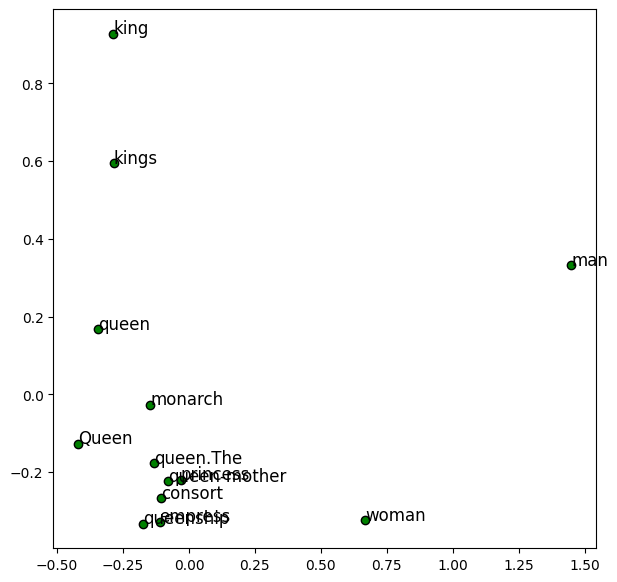

In [ ]:
words_vec = np.array([ft_model.get_word_vector(word) for word in words])
pca = PCA(n_components=2)
words_vec_2d = pca.fit_transform(words_vec)
plt.figure(figsize=(7, 7))
plt.scatter(words_vec_2d[:, 0], words_vec_2d[:, 1], edgecolors='k', c='g')
for word, (x, y) in zip(words, words_vec_2d):
    plt.text(x, y, word, fontsize=12)
plt.show()

In [ ]:
term_vec = 'insulin'
adjust_from_vec = 'pneumonia'
adjust_to_vec = 'diabetes'

closest_terms = ft_model.get_analogies(adjust_from_vec,adjust_to_vec,term_vec)

In [ ]:
words = [word[1] for word in closest_terms] + [term_vec, adjust_from_vec, adjust_to_vec]

In [ ]:
words

['pnuemonia',
 'Pneumonia',
 'antibiotic',
 'pnemonia',
 'antiobiotic',
 'bronchopneumonia',
 'pneumonias',
 'antibiotics',
 'bronchitis',
 'peritonitis',
 'insulin',
 'pneumonia',
 'diabetes']

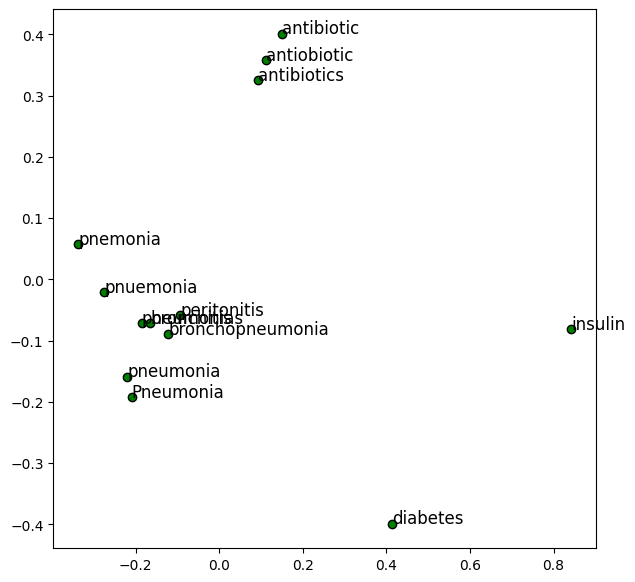

In [ ]:
words_vec = np.array([ft_model.get_word_vector(word) for word in words])
pca = PCA(n_components=2)
words_vec_2d = pca.fit_transform(words_vec)
plt.figure(figsize=(7, 7))
plt.scatter(words_vec_2d[:, 0], words_vec_2d[:, 1], edgecolors='k', c='g')
for word, (x, y) in zip(words, words_vec_2d):
    plt.text(x, y, word, fontsize=12)
plt.show()

In the upcoming line of code, we compute the embeddings for the first 100 questions of the dataset using the FastText model

In [ ]:
word_vectors_questions = np.array([ft_model.get_word_vector(doc) for doc in question_df['question'][:100] ])

Let's proceed to compute the distance matrix of the vector embeddings for the first 100 questions. Subsequently, we'll visualize the similarity matrix using a heatmap. Heatmapes depicting distance metrics offer valuable insights into the similarities between elements and can aid in rudimentary clustering, identifying similar elements within the dataset

In [ ]:
distance_matrix = squareform(pdist(word_vectors_questions, metric='cosine'))
plt.figure(figsize=(100, 100))
sns.heatmap(1 - distance_matrix[:100, :100], annot=True, cmap='coolwarm', square=True)
plt.show()

The same can be done for the first 100 answers

In [ ]:
word_vectors_answers = np.array([ft_model.get_word_vector(doc) for doc in answer_df['answer'][:100] ])

In [ ]:
distance_matrix = squareform(pdist(word_vectors_answers, metric='cosine'))
plt.figure(figsize=(100, 100))
sns.heatmap(1 - distance_matrix[:100, :100], annot=True, cmap='coolwarm', square=True)
plt.show()

By inspecting the heatmap and manually examing the dataset, it becomes evident that there are many similar questions within the dataset. The heatmap reveals clusters of  closely related answers through regions of similar colors, indicating high similarity, Moreover, performing clustering on the dataset could further confirm and identify these groups of similar questions more systematically

 While this approach may not be as sophisticated as more advanced clustering algorithms, it can provide useful initial insights into the structure of the data and potential groupings of similar elements.

##Conclusions

The analysis clearly demonstrates that utilizing pre-trained word embedding models leads to enhanced performance. One compelling analysis underscoring this advantage is the word analogy test (within the medical domain). It vividly illutrastes that pre-trained models talilored to specific domains consistently outperform their conterparts

# Context Retrival

# Context Retrival Introduction

**Introduction to Contextual Question Answering**

In the development of question-answering systems, having a context for each question is often crucial. Typically, models are trained to understand and retrieve answers within a given context. However, our dataset contains only question and answers without any additional context. This presents a unique challenge: how can we train an effective question-answering model without inherent contextual information ?

**Importance of Context**

Context is often vital because it provides the backgrounf information needed for understanding and accurately answering. Without context, the model may struggle to comprehend the nuances and specifics of the questions, leasinf to lower accuracy and reliablity

**Challenges without context**



1.   **Ambiguity**: question cab be ambiguous without context
2.   **Relevance**: without context, it is challenging to determine which information is relevant to the question
3.   **Depth of understanding**: context allows the model to provide more comprehensive and detailed answers

**Proposed Solutions**


**Using External Sources for Context Retrieval**:

 To address the absence of context in our dataset, we propose a method that involves retrieving relevant context from external sources, specifically leveraging the PubMed API to access medical and biomedical papers and their abstracts. Here's an overview of our approach:


 -  **Keyword Extraction**: for each question, we employ keyBERT, a pre-trained mdoel, to extract a set of keywords that capture the essence of the question. These keywords serve as the query terms for retrieving relevant papers and their contexts

 - **Context Retrival**: using the extracted keywords as queries, we utilize the PubMedAPI to search through a vast repository of medical literature. This step aims to retrieve potential contexts from papers and their abstracts, ensuring that the context is domain-specific and directly relevant to the question at hand

 - **Preprocessing and Cleaning**: the retrieved contexts undergo preprocessing and cleaning to ensure they are in the appropriate format for futher analysis. This preprocessing involves removing irrelevant information, normalizing text, and ensuring consistency across retrieved contexts.

 - **Context Ranking**: to prioritize the retrieved contexts, we employ various ranking techniques:

    - **TF-IDF and BM25 Index Search**: These methods assess the importance of terms based on their frequencies within the retrieved contexts and the question itself. This allows us to build a document search engine that matches contexts to a given query (question).

    - **Document vectorization**: utilizing a TD-IDF vectorizer, we compute the textual documents into numerical vectors based on the relevancy of the words and how often they appear in the documents, enabling quantitative comparison.

    - **Sentence Embedding and Cosine Similarity**: We compute sentence embeddings for both the question and the retrieved contexts, then evaluate the cosine similarities between them to obtain similarity scores. This process allows us to rank the contexts based on their relevance to the question. Unlike the previous methods that only consider term frequency, this approach captures the semantic meaning and relationships between words within the sentences.

The last method indeed yielded the best results, as it effectively maintains the semantic relationships between words. This capability enchances the matching process, enabling a more accurate alignment of the question with the context. By considering not only the frequency of terms but also their semantic meaning, this methos provides a more  nuanced understanding of the relationship between the question and the retrieved contexts. This ensures that the generated responses are not only relevant in terms of topic but also in terms of undrlying semantic context, resulting in more precise and informative answers



2.  **Fine-Tuning Pre-Trained Models**
Another solution is to leverage pre-trained models and fine-tune them for our question-answering task. This approach takes advantage of the vast knowledge these models have already acquired during their training


3. **Leveraging Open-Domain Pre-Trained Models**
In addition to domain-specific models, we can also consider open-domain pre-trained models. Literature shows that models trained on vast, open-domain knowledge have performed well on question-answering tasks after fine-tuning.

**Our Work**

In the forthcoming notebook, we will delve into the process of retrieving external context for each question in our dataset. This endeavor will empower us to construct a comprehensive context for every question, a crucial asset in training models that rely on contextual information for optimal performance.

## Import and Install

Let's install some useful libraries

In [ ]:
!pip install -q python-terrier

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 110.7/110.7 kB 1.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.5/1.5 MB 11.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 69.6/69.6 kB 7.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 337.9/337.9 kB 10.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 48.8/48.8 kB 3.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 9.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 287.4/287.4 kB 8.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.1/45.1 kB 2.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.4/45.4 kB 1.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 13.1 MB/s eta 0:00:00
  Preparing metadata (setup.p

In [ ]:
!pip install datasets

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 542.0/542.0 kB 6.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 8.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 9.5 MB/s eta 0:00:00


In [ ]:
!pip install biopython

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.1/3.1 MB 13.2 MB/s eta 0:00:00


In [ ]:
!pip install keybert

  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 171.5/171.5 kB 4.7 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using ca

In [ ]:
!pip install gensim

In [ ]:
!git clone https://github.com/epfml/sent2vec.git
%cd sent2vec
!make
!pip install .

Cloning into 'sent2vec'...
remote: Enumerating objects: 425, done.
remote: Counting objects: 100% (22/22), done.
remote: Compressing objects: 100% (20/20), done.
remote: Total 425 (delta 9), reused 4 (delta 1), pack-reused 403
Receiving objects: 100% (425/425), 447.46 KiB | 1.75 MiB/s, done.
Resolving deltas: 100% (261/261), done.
/content/sent2vec
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/args.cc
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/dictionary.cc
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/productquantizer.cc
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/matrix.cc
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/shmem_matrix.cc
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/qmatrix.cc
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/vector.cc
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/model.cc
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/utils.cc
c++ -pthread -std=c++0x -O3 -funroll-loops -c src/fasttext.cc
c++ -pthread -std=c++0x -O3 -f

Let's import some useful libraries

In [ ]:
from google.colab import drive
import os

from datasets import load_dataset
import numpy as np
import pandas as pd
import csv

from collections import Counter

import matplotlib.pyplot as plt

import re
import string
from string import punctuation

import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize

import pyterrier as pt

from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics.pairwise import euclidean_distances

from keybert import KeyBERT

from gensim.models import Word2Vec
from gensim.models.doc2vec import Doc2Vec, TaggedDocument


from Bio import Entrez

from sentence_transformers import SentenceTransformer

import sent2vec

## Setup

In [ ]:
drive.mount('/content/drive')
os.chdir(f'/content/drive/MyDrive/Colab Notebooks/NLP/Assignment/datasets') #Teka's path
#os.chdir(f'/content/drive/MyDrive/Colab Notebooks/NLP/NLP Project/Datasets')# Alessandro's path
os.getcwd()

Mounted at /content/drive


'/content/drive/MyDrive/Colab Notebooks/NLP/Assignment/datasets'

Variables designated as constants and flags are employed to selectively execute specific segments of the code.

In [ ]:
HUGGINGFACE = False
SAVE_DATASET = True
SET_RANDOM_INDEX = False

Load models and packages

In [ ]:
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

In [ ]:
kw_model = KeyBERT()

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.7k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/612 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/90.9M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/350 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

1_Pooling/config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

In [ ]:
import pyterrier as pt
if not pt.started():
  pt.init()

terrier-assemblies 5.9 jar-with-dependencies not found, downloading to /root/.pyterrier...
Done
terrier-python-helper 0.0.8 jar not found, downloading to /root/.pyterrier...
Done


PyTerrier 0.10.1 has loaded Terrier 5.9 (built by craigm on 2024-05-02 17:40) and terrier-helper 0.0.8



## Utils

The function **preprocess_document** is designed to process a given document, performing various optional text preprocessing steps based on the specified parameters. These parameters include:

* isSorted: If set to True, the function sorts the processed document alphabetically.
* isSet: If set to True, the function converts the processed document into a set, removing any duplicate elements.
* noStopWords: If set to True, the function removes common English stopwords from the processed document.
* lemmatization: If set to True, the function lemmatizes the words in the processed document using WordNet.

The function begins by removing punctuation from the document using a regular expression. Then, depending on the parameters provided, it applies additional processing steps accordingly. Finally, it returns the processed document.

In [ ]:
def preprocess_document(document,noPunctuation=False ,isSorted=False, isSet=False, noStopWords=False, lemmatization=False):
  newDocument = document
  if noPunctuation==True:
    regex = '[' + string.punctuation + ']'
    newDocument = [re.sub(regex,'',item) for item in newDocument]
  if isSet==True:
    newDocument = set(newDocument)
  if noStopWords==True:
    newDocument =  [w for w in newDocument if w not in stopwords.words('english')]
  if isSorted==True:
    newDocument = sorted(newDocument)
  if lemmatization==True:
    lemmatizer = WordNetLemmatizer()
    newDocument = [lemmatizer.lemmatize(w) for w in newDocument]
  return newDocument

The upcoming snippet of code defines three functions for interacting with the PubMed databaes:


1.   **search_pubmed(query, max_results=10)**: Searches PubMed using a specified query and returns a list of PubMed IDs (PMIDs) for the retrieved results, with a default maximum of 10 results.

2.   **fetch_abstracts(pubmed_ids)**: Fetches the abstracts corresponding to a list of PubMed IDs and returns them as text.

3.   **fetch_abstracts_and_summaries(pubmed_ids)**: Retrieves summaries for the PubMed records identified by a list of PubMed IDs and returns them as structured data.


In [ ]:
def search_pubmed(query, max_results=10):
    Entrez.email = "SemanticSurgeons@gmail.com"
    handle = Entrez.esearch(db="pubmed", term=query, retmax=max_results)
    results = Entrez.read(handle)
    handle.close()
    return results["IdList"]

def fetch_abstracts(pubmed_ids):
    Entrez.email = "SemanticSurgeons@gmail.com"
    handle = Entrez.efetch(db="pubmed", id=pubmed_ids, rettype="abstract", retmode="text")
    abstracts = handle.read()
    handle.close()
    return abstracts

def fetch_abstracts_and_summaries(pubmed_ids):
    Entrez.email = "SemanticSurgeons@gmail.com"
    summaries = Entrez.esummary(db="pubmed", id=','.join(pubmed_ids))
    summary_records = Entrez.read(summaries)
    summaries.close()
    return summary_records

The following function, **create_query**, generates a query based on the input question. If the question length exceeds a specified threshold (queryLength), the function extracts keywords using a keyword extraction model and constructs a query using these keywords. Otherwise, it returns the original question

In [ ]:
def create_query(question,queryLength):
  if len(question) > queryLength:
    query = []
    keywords = kw_model.extract_keywords(question, keyphrase_ngram_range=(1, 1), stop_words='english',top_n=queryLength)
    for j in range(len(keywords)):
      key = keywords[j][0]
      query.append(key)
    query = ' '.join(query)
    return query
  else:
    return question

In [ ]:
def most_similar(doc_id,similarity_matrix,matrix):
    print (f'Document: {question_documents_train_set[doc_id]}')
    print ('\n')
    print (f'Similar Documents using {matrix}:')
    if matrix=='Cosine Similarity':
        similar_ix=np.argsort(similarity_matrix[doc_id])[::-1]
        print(similar_ix)
    elif matrix=='Euclidean Distance':
        similar_ix=np.argsort(similarity_matrix[doc_id])
    for ix in similar_ix:
        if ix==doc_id:
            continue
        print('\n')
        print (f'Document: {question_documents_train_set[ix]}')
        print (f'{matrix} : {similarity_matrix[doc_id][ix]}')

# Dataset Loading and preprocessing

We'll begin by loading and preprocessing the dataset to ensure it's in the appropriate format for the context retrieval phase.

In [ ]:
medFlashCards_df = pd.read_csv('MedFlashCards.csv')
medFlashCards_df.dropna(inplace=True)
medFlashCards_df

,input,output,instruction
0,What is the relationship between very low Mg2+...,Very low Mg2+ levels correspond to low PTH lev...,Answer this question truthfully
1,What leads to genitourinary syndrome of menopa...,Low estradiol production leads to genitourinar...,Answer this question truthfully
2,What does low REM sleep latency and experienci...,Low REM sleep latency and experiencing halluci...,Answer this question truthfully
3,What are some possible causes of low PTH and h...,"PTH-independent hypercalcemia, which can be ca...",Answer this question truthfully
4,How does the level of anti-müllerian hormone r...,The level of anti-müllerian hormone is directl...,Answer this question truthfully
...,...,...,...
33946,"What is Opsoclonus-Myoclonus Ataxia Syndrome, ...",Opsoclonus-Myoclonus Ataxia Syndrome is a para...,Answer this question truthfully
33947,"What is Opsoclonus-Myoclonus Ataxia Syndrome, ...",Opsoclonus-Myoclonus Ataxia Syndrome is a para...,Answer this question truthfully
33948,Is A part of B in a proportion of A/B?,"Yes, A is part of B in a proportion of A/B.",Answer this question truthfully
33949,"What is the mnemonic ""Microtubules Get Constru...","The mnemonic ""Microtubules Get Constructed Ver...",Answer this question truthfully


In [ ]:
questions_df = pd.DataFrame(medFlashCards_df['input'])
answers_df = pd.DataFrame(medFlashCards_df['output'])

In [ ]:
questions_df['Cleaned Questions'] = questions_df["input"].apply(lambda question: ' '.join(preprocess_document(question.split(), noPunctuation=True,lemmatization=True )) )

# Context Retrival

In [ ]:
if SET_RANDOM_INDEX == True:
  random_question_index = np.random.randint(0, len(medFlashCards_df)-1)
else:
  random_question_index = 1460

In [ ]:
question = questions_df['Cleaned Questions'][random_question_index]
answer = answers_df['output'][random_question_index]

In [ ]:
print(f'Question: {question}')
print(f'Answers: {answer}')

Question: What cause amoebic brain disease and is associated with freshwater source
Answers: Naegleria fowleri causes amoebic brain disease and is associated with freshwater sources.


We'll now generate the query for retrieving documents from the PubMed API. Considering a query length of 6, we'll use the create_query function to construct the query based on the provided question.

In [ ]:
query_length = 6
query = create_query(question, query_length)

The upcoming code segment starts by setting the maximum number of results to retrieve from a PubMed search and performs the search using the provided query. If the initial search yields no results, it retries the search using the last keyword from the query which is the least important

In [ ]:
max_results = 30  # Maximum number of results to retrieve
pubmed_ids = search_pubmed(query, max_results)
if not pubmed_ids:
    pubmed_ids = search_pubmed(query[:-1], max_results)

This code fetches abstracts for PubMed IDs and creates a DataFrame called "documents" with two columns: "docno" and "text," where each row represents an abstract with an incremented ID.

In [ ]:
abstracts = fetch_abstracts(pubmed_ids)
documents = pd.DataFrame(columns=["docno", "text"])
for idx, abstract in enumerate(abstracts.split("\n\n")):
  newEntry = {'docno': idx + 1, 'text': abstract}
  documents = documents._append(newEntry, ignore_index = True)

Let's preprocess the retrieved contexts to ensure they are in the optimal format for subsequent operations.

In [ ]:
documents['Cleaned Context'] = documents['text'].apply(lambda question: " ".join(preprocess_document(question.split(),noPunctuation=True, lemmatization=True)))

In [ ]:
documents

,docno,text,Cleaned Context
0,1,1. ACS ES T Water. 2023 Mar 15;3(4):1126-1133....,1 ACS ES T Water 2023 Mar 153411261133 doi 101...
1,2,A Case of Primary Amebic Meningoencephalitis A...,A Case of Primary Amebic Meningoencephalitis A...
2,3,"Miko S(1), Cope JR(1), Hlavsa MC(1), Ali IKM(1...",Miko S1 Cope JR1 Hlavsa MC1 Ali IKM1 Brown TW1...
3,4,Author information:\n(1)U.S. Centers for Disea...,Author information 1US Centers for Disease Con...
4,5,Naegleria fowleri is a thermophilic ameba foun...,Naegleria fowleri is a thermophilic ameba foun...
...,...,...,...
88,89,The possibility of congenital infection with A...,The possibility of congenital infection with A...
89,90,"Awadalla HN(1), Sadaka HA.",Awadalla HN1 Sadaka HA
90,91,Author information:\n(1)Department of Parasito...,Author information 1Department of Parasitology...
91,92,Acanthamoeba culbertsoni is one of the free-li...,Acanthamoeba culbertsoni is one of the freeliv...


## Document Search Engine using Indexing

These methods assess the importance of terms based on their frequencies within the retrieved contexts and the question itself

The first step in order to apply any kind of search is to index the whole dataset of contexts

In [ ]:
indexer = pt.DFIndexer("./index_contexts", overwrite=True)
documents['docno'] = documents['docno'].astype(str)
index_ref = indexer.index(documents["Cleaned Context"],documents['docno'])
index_ref.toString()

'./index_contexts/data.properties'

In [ ]:
!ls -lh index_contexts/

total 134K
-rw------- 1 root root 1.6K May 25 08:43 data.direct.bf
-rw------- 1 root root 1.6K May 25 08:43 data.document.fsarrayfile
-rw------- 1 root root 2.9K May 25 08:43 data.inverted.bf
-rw------- 1 root root 112K May 25 08:43 data.lexicon.fsomapfile
-rw------- 1 root root  993 May 25 08:43 data.lexicon.fsomaphash
-rw------- 1 root root 5.2K May 25 08:43 data.lexicon.fsomapid
-rw------- 1 root root 1023 May 25 08:43 data.meta-0.fsomapfile
-rw------- 1 root root  744 May 25 08:43 data.meta.idx
-rw------- 1 root root 1.5K May 25 08:43 data.meta.zdata
-rw------- 1 root root 4.2K May 25 08:43 data.properties


Let's now load the index and print  some information about our collection

In [ ]:
index = pt.IndexFactory.of(index_ref)
print(index.getCollectionStatistics().toString())

Number of documents: 93
Number of terms: 1328
Number of postings: 2459
Number of fields: 0
Number of tokens: 3205
Field names: []
Positions:   false



### TF-IDF Index Search


This code segment initializes a TF-IDF-based batch retrieval system with a specified index and then executes a search using the provided query.

In [ ]:
tf_idf = pt.BatchRetrieve(index, wmodel="TF_IDF")
ranking_td_idf = tf_idf.search(query)
ranking_td_idf

,qid,docid,docno,rank,score,query
0,1,52,53,0,6.013538,amoebic freshwater disease brain cause associated
1,1,91,92,1,5.589591,amoebic freshwater disease brain cause associated
2,1,66,67,2,5.270139,amoebic freshwater disease brain cause associated
3,1,63,64,3,4.640910,amoebic freshwater disease brain cause associated
4,1,31,32,4,4.603874,amoebic freshwater disease brain cause associated
5,1,4,5,5,4.081031,amoebic freshwater disease brain cause associated
6,1,78,79,6,3.699922,amoebic freshwater disease brain cause associated
7,1,58,59,7,3.276339,amoebic freshwater disease brain cause associated
8,1,18,19,8,3.266189,amoebic freshwater disease brain cause associated
9,1,49,50,9,3.216381,amoebic freshwater disease brain cause associated


This code snippet checks if the ranking list is not empty. If it's not empty, it retrieves the most relevant result and, if its length is less than 300 characters, also retrieves the second relevant result and concatenates them. If the ranking list is empty, it assigns 'NAN' to the most relevant result.

In [ ]:
ranking_length = len(ranking_td_idf)
if(ranking_length)!=0:
    most_relevant_result_docno = ranking_td_idf.loc[ranking_td_idf['rank'] == 0, 'docno'].values[0]
    most_relevant_result = documents.loc[documents['docno'] ==  most_relevant_result_docno, 'text'].values[0]

    if len(most_relevant_result) < 300:
      second_relevant_result_docno = ranking_td_idf.loc[ranking['rank'] == 1, 'docno'].values[0]
      second_relevant_result = documents.loc[documents['docno'] ==  most_relevant_result_docno, 'text'].values[0]
      most_relevant_result = most_relevant_result + ' ' + second_relevant_result

else:
      most_relevant_result = 'NAN'

In [ ]:
context_tfIdf = most_relevant_result
print(context_tfIdf)

INTRODUCTION: Primary amoebic meningoencephalitis (PAM) is a rare disease caused 
by the free-living amoeba Naegleria fowleri. Infection occurs by insufflation of 
water containing amoebae into the nasal cavity, and is usually associated with 
bathing in freshwater. Nasal irrigation is a more rarely reported route of 
infection.
CASE PRESENTATION: A fatal case of PAM in a previously healthy Norwegian woman, 
acquired during a holiday trip to Thailand, is described. Clinical findings were 
consistent with rapidly progressing meningoencephalitis. The cause of infection 
was discovered by chance, owing to the unexpected detection of N. fowleri DNA by 
a PCR assay targeting fungi. A conclusive diagnosis was established based on 
sequencing of N. fowleri DNA from brain biopsies, supported by histopathological 
findings. Nasal irrigation using contaminated tap water is suspected as the 
source of infection.
CONCLUSION: The clinical presentation of PAM is very similar to severe bacterial 
men

### BM25 Index Search

This code segment initializes a BM25-based batch retrieval system with a specified index and then executes a search using the provided query.

In [ ]:
bm25 = pt.BatchRetrieve(index, wmodel="BM25")
ranking_bm25 = bm25.search(query)
ranking_bm25

,qid,docid,docno,rank,score,query
0,1,52,53,0,9.418227,amoebic freshwater disease brain cause associated
1,1,91,92,1,8.867455,amoebic freshwater disease brain cause associated
2,1,66,67,2,8.481014,amoebic freshwater disease brain cause associated
3,1,63,64,3,7.273235,amoebic freshwater disease brain cause associated
4,1,31,32,4,6.767356,amoebic freshwater disease brain cause associated
5,1,4,5,5,6.395992,amoebic freshwater disease brain cause associated
6,1,78,79,6,5.642075,amoebic freshwater disease brain cause associated
7,1,49,50,7,5.468598,amoebic freshwater disease brain cause associated
8,1,58,59,8,5.131413,amoebic freshwater disease brain cause associated
9,1,44,45,9,5.052329,amoebic freshwater disease brain cause associated


In [ ]:
ranking_length = len(ranking_bm25)
if(ranking_length)!=0:
    most_relevant_result_docno = ranking_td_idf.loc[ranking_bm25['rank'] == 0, 'docno'].values[0]
    most_relevant_result = documents.loc[documents['docno'] ==  most_relevant_result_docno, 'text'].values[0]

    if len(most_relevant_result) < 300:
      second_relevant_result_docno = ranking_bm25.loc[ranking_bm25['rank'] == 1, 'docno'].values[0]
      second_relevant_result = documents.loc[documents['docno'] ==  most_relevant_result_docno, 'text'].values[0]
      most_relevant_result = most_relevant_result + ' ' + second_relevant_result

else:
      most_relevant_result = 'NAN'

In [ ]:
context_bm25 = most_relevant_result
print(context_bm25)

INTRODUCTION: Primary amoebic meningoencephalitis (PAM) is a rare disease caused 
by the free-living amoeba Naegleria fowleri. Infection occurs by insufflation of 
water containing amoebae into the nasal cavity, and is usually associated with 
bathing in freshwater. Nasal irrigation is a more rarely reported route of 
infection.
CASE PRESENTATION: A fatal case of PAM in a previously healthy Norwegian woman, 
acquired during a holiday trip to Thailand, is described. Clinical findings were 
consistent with rapidly progressing meningoencephalitis. The cause of infection 
was discovered by chance, owing to the unexpected detection of N. fowleri DNA by 
a PCR assay targeting fungi. A conclusive diagnosis was established based on 
sequencing of N. fowleri DNA from brain biopsies, supported by histopathological 
findings. Nasal irrigation using contaminated tap water is suspected as the 
source of infection.
CONCLUSION: The clinical presentation of PAM is very similar to severe bacterial 
men

### Composition

This operator allow to re-rank the output of one retriever using a second retriever

In [ ]:
composition = tf_idf >> bm25
composition_ranking = composition.search(query)
composition_ranking

,qid,docid,docno,rank,score,query
0,1,52,53,0,9.418227,amoebic freshwater disease brain cause associated
1,1,91,92,1,8.867455,amoebic freshwater disease brain cause associated
2,1,66,67,2,8.481014,amoebic freshwater disease brain cause associated
3,1,63,64,3,7.273235,amoebic freshwater disease brain cause associated
4,1,31,32,4,6.767356,amoebic freshwater disease brain cause associated
5,1,4,5,5,6.395992,amoebic freshwater disease brain cause associated
6,1,78,79,6,5.642075,amoebic freshwater disease brain cause associated
7,1,49,50,7,5.468598,amoebic freshwater disease brain cause associated
8,1,58,59,8,5.131413,amoebic freshwater disease brain cause associated
9,1,44,45,9,5.052329,amoebic freshwater disease brain cause associated


In [ ]:
if(len(composition_ranking))!=0:
    most_relevant_result_docno = composition_ranking.loc[composition_ranking['rank'] == 0, 'docno'].values[0]
    most_relevant_result = documents.loc[documents['docno'] ==  most_relevant_result_docno, 'text'].values[0]
    if len(most_relevant_result) < 300:
      second_relevant_result_docno = composition_ranking.loc[composition_ranking['rank'] == 1, 'docno'].values[0]
      second_relevant_result = documents.loc[documents['docno'] ==  most_relevant_result_docno, 'text'].values[0]
      most_relevant_result = most_relevant_result + ' ' + second_relevant_result
else:
      most_relevant_result = 'NAN'

In [ ]:
context_composition_tfIdf_bm25 = most_relevant_result
print(context_composition_tfIdf_bm25)

INTRODUCTION: Primary amoebic meningoencephalitis (PAM) is a rare disease caused 
by the free-living amoeba Naegleria fowleri. Infection occurs by insufflation of 
water containing amoebae into the nasal cavity, and is usually associated with 
bathing in freshwater. Nasal irrigation is a more rarely reported route of 
infection.
CASE PRESENTATION: A fatal case of PAM in a previously healthy Norwegian woman, 
acquired during a holiday trip to Thailand, is described. Clinical findings were 
consistent with rapidly progressing meningoencephalitis. The cause of infection 
was discovered by chance, owing to the unexpected detection of N. fowleri DNA by 
a PCR assay targeting fungi. A conclusive diagnosis was established based on 
sequencing of N. fowleri DNA from brain biopsies, supported by histopathological 
findings. Nasal irrigation using contaminated tap water is suspected as the 
source of infection.
CONCLUSION: The clinical presentation of PAM is very similar to severe bacterial 
men

## Document Search Engine using Document Vectorization

Compute the textual documents into numerical vectors based on the relevancy of the words and how often they appear in the documents

Create lists of contexts and questions from the corresponding dataframes for building the train set

In [ ]:
contexts_list = documents['text'].tolist()
questions_list  = questions_df['input'].tolist()

In [ ]:
train_set = questions_list + contexts_list

This line fits the vectorizer to the training set, learning the vocabulary and the idf (inverse document frequency) values from the training data

In [ ]:
vectorizer = TfidfVectorizer(max_df=0.8, min_df=5, stop_words='english')

In [ ]:
vectorizer.fit(train_set)

TfidfVectorizer(max_df=0.8, min_df=5, stop_words='english')

In [ ]:
learned_vocabulary = vectorizer.get_feature_names_out()
print(f'Length of Vocabulary: {len(learned_vocabulary)}')

Length of Vocabulary: 6239


The upcoming lines of code transform the question and contexts list into their vector representations using the fitted vectorizer. This process converts the text data into numerical vectors based on the learned vocabulary and idf values

In [ ]:
vector_question = vectorizer.transform([question])
vector_contexts = vectorizer.transform(contexts_list)

Let's compute the similarities

In [ ]:
question_contexts_similarities = np.dot(vector_question, vector_contexts.T)

In [ ]:
best_matches = np.argmax(question_contexts_similarities, axis=1)
value = best_matches[0][0, 0]
print(f"The more similar context to question 0 is {best_matches[0]}")
print('CONTEXT:' ,contexts_list[value] )

The more similar context to question 0 is [[49]]
CONTEXT: Fatal primary amoebic meningoencephalitis in a Norwegian tourist returning from 
Thailand.


## Document Search Engine using Document Embedding

A document search engine using embeddings transforms how search results are generated by focusing on the semantic meaning of text rather than just matching keywords. Choosing embeddings for this purpose offers significant advantages. Embeddings capture the semantic meaning of words, enabling more accurate and contextually relevant search results by understanding synonyms and polysemous words. They enhance contextual understanding, improve disambiguation, support scalable and efficient searches, and enable cross-lingual capabilitie

**Doc2Vec**

Doc2Vec is an extension of the Word2Vec model that learns continuous representations for pieces of text, such as sentences, paragraphs, or documents, while also capturing their semantic meanings. In Doc2Vec, each document is represented as a fixed-length vector, just like words are represented as vectors in Word2Vec.

The following code  prepares the data for training a Doc2Vec model by creating a list of tagged documents. Each document is tokenized into words, and a unique tag is assigned to it. The resulting tagged_data list contains TaggedDocument objects, where each object represents a document (question or context) with its corresponding tag.

In [ ]:
question_documents_train_set = [question] + documents['Cleaned Context'].tolist()
tagged_data = [TaggedDocument(words=word_tokenize(doc), tags=[i]) for i, doc in enumerate(question_documents_train_set)]

This code initializes a Doc2Vec model with a vector size of 100 and trains it for 100 epochs using the provided tagged data. During training, the model learns to generate document vectors that represent the semantic meaning of the input documents.

In [ ]:
model_d2v = Doc2Vec(vector_size=100,alpha=0.025, min_count=1)

model_d2v.build_vocab(tagged_data)

for epoch in range(100):
    model_d2v.train(tagged_data,
                total_examples=model_d2v.corpus_count,
                epochs=model_d2v.epochs)

Let's initialize an array to store document embeddings with dimensions corresponding to the number of documents in the dataset and a vector size of 100. Then, we are going  iterate over each document in the dataset, retrieve its corresponding Doc2Vec embedding from the trained model, and assign it to the corresponding position in the document_embeddings array.

In [ ]:
document_embeddings=np.zeros((documents.shape[0],100))

for i in range(len(document_embeddings)):
    document_embeddings[i]= model_d2v.docvecs[i]

<ipython-input-81-7a8159e4f679>:4: DeprecationWarning: Call to deprecated `docvecs` (The `docvecs` property has been renamed `dv`.).
  document_embeddings[i]= model_d2v.docvecs[i]


Let's calculates pairwise similarities and differences between document embeddings using cosine similarity

In [ ]:
pairwise_similarities=cosine_similarity(document_embeddings)

Let's retrieve the most similar documents

In [ ]:
most_similar(0,pairwise_similarities,'Cosine Similarity')

Document: What cause amoebic brain disease and is associated with freshwater source


Similar Documents using Cosine Similarity:
[ 0 78 48 50 76 43  7  8 12 16 18 89 42 17 87 33 58 64 82 60 41  9 46 91
 74 47 83 68 84 62 29 22 71  1 40 35 39 67 61 26  2 66 57 53  3 13 85 69
 65 24 20 49 31 14 77 72 28 36 59 79 37 70 30 11 55  6 51 10 21 92 52 75
 80 19 90 44 23 63  4 56 25 27 54 34  5 32 15 88 81 86 38 45 73]


Document: Author information 1National Center for Emerging and Zoonotic Infectious Diseases Centers for Disease Control and Prevention1600 Clifton Road Atlanta GA 30329 USA jey9cdcgov
Cosine Similarity : 0.7261215865224676


Document: Conflict of interest statement Potential conflict of interest All author No reported conflict
Cosine Similarity : 0.7080370555308303


Document: Fatal primary amoebic meningoencephalitis in a Norwegian tourist returning from Thailand
Cosine Similarity : 0.6972952042767578


Document: Primary amebic meningoencephalitis death associated with sinus ir

**Sentence Transformer**


Sentence Transformers is a versatile toolkit designed for creating fixed-length numerical representations, or embeddings, of sentences and short texts. It harnesses the power of pre-trained transformer models like BERT, RoBERTa, or DistilBERT to encode input sentences into dense vector representations. These embeddings effectively capture the semantic meaning of the sentences, enabling a wide range of downstream tasks such as semantic similarity assessment, text classification, or clustering. In our case, we're utilizing the **all-mpnet-base-v2** variant, which is built on the MPNet architecture.

The upcoming  code initializes a Sentence Transformers model using the **all-mpnet-base-v2** variant, which is based on the MPNet architecture. The model is capable of generating high-quality sentence embeddings for a wide range of natural language processing task

In [ ]:
sbert_model = SentenceTransformer('sentence-transformers/all-mpnet-base-v2')

modules.json:   0%|          | 0.00/349 [00:00<?, ?B/s]

config_sentence_transformers.json:   0%|          | 0.00/116 [00:00<?, ?B/s]

README.md:   0%|          | 0.00/10.6k [00:00<?, ?B/s]

sentence_bert_config.json:   0%|          | 0.00/53.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/571 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/438M [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/363 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/232k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/466k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/239 [00:00<?, ?B/s]

1_Pooling/config.json:   0%|          | 0.00/190 [00:00<?, ?B/s]

We'll employ the previously loaded model to create embeddings for a collection of documents containing both questions and answers, which together constitute the training set

In [ ]:
document_embeddings = sbert_model.encode(question_documents_train_set)

Let's calculates pairwise similarities and differences between document embeddings using cosine similarity

In [ ]:
pairwise_similarities=cosine_similarity(document_embeddings)
pairwise_differences=euclidean_distances(document_embeddings)

Let's retrieve the most similar documents

In [ ]:
most_similar(0,pairwise_similarities,'Cosine Similarity')

Document: What cause amoebic brain disease and is associated with freshwater source


Similar Documents using Cosine Similarity:
[ 0 67 73 53 92 76 64 42  5 86 45  2 50 32 59 79 19 56 82 29 11 71 38 68
 66 18 63 44  6 25 89 85 22 75 55 41 52 10 28 20 33 69 61  8 78 74 91 47
 40 80 26 58 37 31  1 60 46  4 24 72  7 87 54 93 16 13 21 34 88 14 49 35
 15 27 81 39 90 83 62 48 84 57 36 70  3  9 77 23 51 65 43 17 30 12]


Document: Balamuthia mandrillaris is an amoeba found in fresh water and soil that cause granulomatous amoebic encephalitis We report herein an autopsy case of B mandrillaris amoebic encephalitis which wa definitely diagnosed by PCR An 81yearold man who had Sjögrens syndrome manifested drowsiness 2 month before his death with progressive deterioration Neuroimaging demonstrated focus of T2 and fluidattenuated inversion recovery high and T1 lowintensity with irregular postcontrast ring enhancement in the cerebral hemisphere thalamus and midbrain Pathologically multiple hemorrhag

**BioSentVec**

BioSentVec, a pre-trained model, transforms sentences into numerical forms, effectively capturing the intricate connections between words within the realm of biology and medicine. Its training dataset includes a vast collection of over 30 million documents sourced from scholarly articles found in PubMed and clinical notes extracted from the MIMIC-III Clinical Database. This extensive training ensures its proficiency in understanding the language and concepts specific to these fields.

In [ ]:
model_BioSentVec_path = '/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/Datasets/BioSentVec_PubMed_MIMICIII-bigram_d700.bin'
testing_model = sent2vec.Sent2vecModel()

Let's load the model

In [ ]:
try:
    testing_model.load_model(model_BioSentVec_path)
except Exception as e:
    print(e)
print('model successfully loaded')

model successfully loaded


We'll employ the previously loaded model to create embeddings for a collection of documents containing both questions and answers, which together constitute the training set

In [ ]:
document_embeddings = testing_model.embed_sentences(question_documents_train_set)

Let's calculates pairwise similarities and differences between document embeddings using cosine similarity

In [ ]:
pairwise_similarities = cosine_similarity(document_embeddings)

Let's retrieve the most similar documents

In [ ]:
most_similar(0,pairwise_similarities,'Cosine Similarity')

Document: What cause amoebic brain disease and is associated with freshwater source


Similar Documents using Cosine Similarity:
[ 0 53 79 67 59 32 25 45 86 19 38 73  5 92 64 56 11 50 82 76 71 27 22 35
 14  8 89 46 16 48 60 62 37 75  4 63  1  7 21 55 41 39 81 28 15 49 10 85
 34 88 44 78 70 18 31 68 91 52 66 77 57  2 58 42 24 83 72 12 80 87 20 93
 74 26 61 69 33 40 47 90  3 54 51  6 84  9 23 43 13 36 30 17 65 29]


Document: INTRODUCTION Primary amoebic meningoencephalitis PAM is a rare disease caused by the freeliving amoeba Naegleria fowleri Infection occurs by insufflation of water containing amoeba into the nasal cavity and is usually associated with bathing in freshwater Nasal irrigation is a more rarely reported route of infection CASE PRESENTATION A fatal case of PAM in a previously healthy Norwegian woman acquired during a holiday trip to Thailand is described Clinical finding were consistent with rapidly progressing meningoencephalitis The cause of infection wa discovered by ch

# Evaluation

The code cells above showcase three methods for documents retrival based on a given query. Each method successfully organizes the retrieved documents from most relevant to least relevant. It's evident that approaches solely relying on term frequency were surpassed by those utilizing sentence embeddings, which capture semantic relatioships of words within a sentence.
Additionaly, models pre-trained within our specific domain, such as BioSentVec, demonstrated superior accuracy


In [ ]:
tf_idf_bm_25 = "INTRODUCTION: Primary amoebic meningoencephalitis (PAM) is a rare disease caused\
by the free-living amoeba Naegleria fowleri. Infection occurs by insufflation of\
water containing amoebae into the nasal cavity, and is usually associated with\
bathing in freshwater. Nasal irrigation is a more rarely reported route of\
infection.\
CASE PRESENTATION: A fatal case of PAM in a previously healthy Norwegian woman,\
acquired during a holiday trip to Thailand, is described. Clinical findings were\
consistent with rapidly progressing meningoencephalitis. The cause of infection\
was discovered by chance, owing to the unexpected detection of N. fowleri DNA by\
a PCR assay targeting fungi. A conclusive diagnosis was established based on\
sequencing of N. fowleri DNA from brain biopsies, supported by histopathological\
findings. Nasal irrigation using contaminated tap water is suspected as the\
source of infection.\
CONCLUSION: The clinical presentation of PAM is very similar to severe bacterial\
meningitis. This case is a reminder that when standard investigations fail to\
identify a cause of infection in severe meningoencephalitis, it is of crucial\
importance to continue a broad search for a conclusive diagnosis. PAM should be\
considered as a diagnosis in patients with symptoms of severe\
meningoencephalitis returning from endemic areas."

tf_idf_vectorizer = "Fatal primary amoebic meningoencephalitis in a Norwegian tourist returning from\
Thailand."

doc2vec = " Author information 1National Center for Emerging and Zoonotic Infectious Diseases Centers\
 for Disease Control and Prevention1600 Clifton Road Atlanta GA 30329 USA jey9cdcgov"

sentence_transformer = "Balamuthia mandrillaris is an amoeba found in fresh water and soil that cause\
 granulomatous amoebic encephalitis We report herein an autopsy case of B mandrillaris amoebic\
  encephalitis which wa definitely diagnosed by PCR An 81yearold man who had Sjögrens syndrome\
   manifested drowsiness 2 month before his death with progressive deterioration Neuroimaging\
    demonstrated focus of T2 and fluidattenuated inversion recovery high and T1 lowintensity with\
     irregular postcontrast ring enhancement in the cerebral hemisphere thalamus and midbrain\
      Pathologically multiple hemorrhagic and necrotic lesion were found in the cerebrum thalamus\
       midbrain pons medulla and cerebellum which were characterized by liquefactive necrosis marked \
        edema hemorrhage and necrotizing vasculitis associated with the perivascular accumulation of amoebic\
         trophozoite a few cyst and the infiltration of numerous neutrophil and microgliamacrophages The trophozoite\
          were ovoid or round 1060 μm in diameter and they showed foamy cytoplasm and a round nucleus with small\
           karyosome in the center The PCR and immunohistochemistry from paraffinembedded brain specimen revealed\
            angioinvasive encephalitis due to B mandrillaris Human case of B mandrillaris brain infection are rare\
             in Japan with only a few brief report in the literature"

bioSentVec = "INTRODUCTION Primary amoebic meningoencephalitis PAM is a rare disease caused by the freeliving\
 amoeba Naegleria fowleri Infection occurs by insufflation of water containing amoeba into the nasal cavity\
  and is usually associated with bathing in freshwater Nasal irrigation is a more rarely reported route of infection\
   CASE PRESENTATION A fatal case of PAM in a previously healthy Norwegian woman acquired during a holiday trip\
    to Thailand is described Clinical finding were consistent with rapidly progressing meningoencephalitis\
     The cause of infection wa discovered by chance owing to the unexpected detection of N fowleri DNA by a\
      PCR assay targeting fungi A conclusive diagnosis wa established based on sequencing of N fowleri DNA\
       from brain biopsy supported by histopathological finding Nasal irrigation using contaminated tap water\
        is suspected a the source of infection CONCLUSION The clinical presentation of PAM is very similar to\
         severe bacterial meningitis This case is a reminder that when standard investigation fail to identify\
          a cause of infection in severe meningoencephalitis it is of crucial importance to continue a broad search\
           for a conclusive diagnosis PAM should be considered a a diagnosis in patient with symptom of severe\
            meningoencephalitis returning from endemic area"

In [ ]:
print(f'Question: {question}\n')
print(f'TF-IDF>>BM25: {tf_idf_bm_25 }\n')
print(f'TF-IDF Vectorizer: {tf_idf_vectorizer}\n')
print(f'Doc2Vec: {doc2vec}\n')
print(f'sentence transformers: {sentence_transformer}\n')
print(f'BioSentVec: {bioSentVec}\n')

Question: What cause amoebic brain disease and is associated with freshwater source

TF-IDF>>BM25: INTRODUCTION: Primary amoebic meningoencephalitis (PAM) is a rare disease causedby the free-living amoeba Naegleria fowleri. Infection occurs by insufflation ofwater containing amoebae into the nasal cavity, and is usually associated withbathing in freshwater. Nasal irrigation is a more rarely reported route ofinfection.CASE PRESENTATION: A fatal case of PAM in a previously healthy Norwegian woman,acquired during a holiday trip to Thailand, is described. Clinical findings wereconsistent with rapidly progressing meningoencephalitis. The cause of infectionwas discovered by chance, owing to the unexpected detection of N. fowleri DNA bya PCR assay targeting fungi. A conclusive diagnosis was established based onsequencing of N. fowleri DNA from brain biopsies, supported by histopathologicalfindings. Nasal irrigation using contaminated tap water is suspected as thesource of infection.CONCLUSION

# Models

Every model were tested both before and after fine-tuning, utilizing both BioSentVec embeddings and BERTscore.

To expedite the evaluation process, a stopping criterion was employed. If, in the last 20 iterations of the for loop calculating the mean score, the mean does not change significantly, the execution stops, and the score is printed.

Additionally, the models were evaluated for execution time in answering questions.

#[Mistral](https://mistral.ai/news/announcing-mistral-7b/)

Mistral is an open-source large language model developed by Mistral AI.

In this notebook, we are using Mistral 7B with 7 billion parameters. We will define prompts for tuning our model and create functions to map our data to these prompts. By doing so, we can tailor the model’s responses to the specific question answering problem.

##Configurations and imports

Let's import everything we need for the execution!

**Remember to set the flags in the right way to execute everything you need**

In [ ]:
USE_PRETRAINED = True       # Set to False if you want to fine-tune the model and save it, otherwise it will be loaded the previous fine-tuned LoRA model
EXPORT_MODEL = False        # Set to True if you want to export the GGUF model
DOWNLOAD_BIOSENT = False    # Set to True if you want to download the biosentvec dataset to test the model
TEST_MODEL = True           # Set to True if you want to test the model
DOWNLOAD_DATASET = False    # Set to True if you want to download the huggingface dataset and re-split it (note that by doing it you will have a different split of the train-test)

In [ ]:
MODEL_PATH = '/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/Mistral'
DATAS_PATH = '/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/Datasets'
model_name = "unsloth/mistral-7b-v0.3-bnb-4bit"

In [ ]:
%%capture
# Installs Unsloth, Xformers (Flash Attention) and all other packages!
!pip install "unsloth[colab-new] @ git+https://github.com/unslothai/unsloth.git"
!pip install --no-deps xformers trl peft accelerate bitsandbytes

In [ ]:
from google.colab import drive
from unsloth import FastLanguageModel
from unsloth import is_bfloat16_supported
import torch
from datasets import load_dataset
from datasets import Dataset
import os
from trl import SFTTrainer
import sys
from transformers import TrainingArguments
from transformers.utils import logging
from nltk import word_tokenize
from nltk.corpus import stopwords
from string import punctuation
from scipy.spatial import distance
import nltk
from tqdm import tqdm
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import time

🦥 Unsloth: Will patch your computer to enable 2x faster free finetuning.


In [ ]:
if TEST_MODEL:
  !pip install bert-score
  from bert_score import BERTScorer

  !git clone https://github.com/epfml/sent2vec.git
  %cd sent2vec
  !make
  !pip install .
  import sent2vec

  sys.setrecursionlimit(4000)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.1/61.1 kB 1.8 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-man

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
if DOWNLOAD_BIOSENT:
  os.chdir(f'{DATAS_PATH}')
  os.getcwd()
  !wget https://ftp.ncbi.nlm.nih.gov/pub/lu/Suppl/BioSentVec/BioSentVec_PubMed_MIMICIII-bigram_d700.bin

In [ ]:
os.chdir(f'{MODEL_PATH}')
os.getcwd()

'/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/Mistral'

In [ ]:
nltk.download('stopwords')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

## Model definition

To accelerate the fine-tuning process of our model, we opted for a lightweight tool developed by the community: [Unsloth](https://github.com/unslothai/unsloth).

Unsloth works by overwriting some parts of the modeling code with optimized operations. By manually deriving backpropagation steps and rewriting all Pytorch modules into Triton kernels, Unsloth can both reduce memory usage and make fine-tuning faster.

Crucially, **accuracy degradation is 0%** with respect to normal QLoRA, because no approximations are made in the optimized code.

In [ ]:
max_seq_length = 4096   # We use RoPE Scaling to extend it to 4096 with Unsloth!
dtype = None            # None for auto detection. Float16 for Tesla T4, V100, Bfloat16 for Ampere+
load_in_4bit = True     # Use 4bit quantization to reduce memory usage. Can be False.

In [ ]:
if USE_PRETRAINED:
    #@title Loading finetuned models
    model, tokenizer = FastLanguageModel.from_pretrained(
        model_name = "lora_model", # YOUR MODEL YOU USED FOR TRAINING
        max_seq_length = max_seq_length,
        dtype = dtype,
        load_in_4bit = load_in_4bit,
    )
    FastLanguageModel.for_inference(model) # Enable native 2x faster inference

config.json:   0%|          | 0.00/1.15k [00:00<?, ?B/s]

==((====))==  Unsloth: Fast Mistral patching release 2024.5
   \\   /|    GPU: Tesla T4. Max memory: 14.748 GB. Platform = Linux.
O^O/ \_/ \    Pytorch: 2.3.0+cu121. CUDA = 7.5. CUDA Toolkit = 12.1.
\        /    Bfloat16 = FALSE. Xformers = 0.0.26.post1. FA = False.
 "-____-"     Free Apache license: http://github.com/unslothai/unsloth


model.safetensors:   0%|          | 0.00/4.14G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/111 [00:00<?, ?B/s]

You set `add_prefix_space`. The tokenizer needs to be converted from the slow tokenizers
You are using the default legacy behaviour of the <class 'transformers.models.llama.tokenization_llama.LlamaTokenizer'>. This is expected, and simply means that the `legacy` (previous) behavior will be used so nothing changes for you. If you want to use the new behaviour, set `legacy=False`. This should only be set if you understand what it means, and thoroughly read the reason why this was added as explained in https://github.com/huggingface/transformers/pull/24565
Unsloth 2024.5 patched 32 layers with 32 QKV layers, 32 O layers and 32 MLP layers.


In [ ]:
if not USE_PRETRAINED:
  model, tokenizer = FastLanguageModel.from_pretrained(
    model_name = model_name,
    max_seq_length = max_seq_length,
    dtype = dtype,
    load_in_4bit = load_in_4bit,
  )


To speedup the tuning even more and decrease the needed computational power we used [LoRA](https://arxiv.org/abs/2106.09685). LoRA is a novel technique introduced by Microsoft researchers to deal with the problem of fine-tuning large-language models.

LoRA proposes freezing pre-trained model weights, which reduces the number of trainable parameters and GPU memory requirements.

In [ ]:
if not USE_PRETRAINED:
  model = FastLanguageModel.get_peft_model(
      model,
      r = 32,    #16 in previous implementation                    # Choose any number > 0 ! Suggested 8, 16, 32, 64, 128
      target_modules = ["q_proj", "k_proj", "v_proj", "o_proj",
                        "gate_proj", "up_proj", "down_proj",],
      lora_alpha = 32, #16 in previous implementation
      lora_dropout = 0,                                            # Currently only supports dropout = 0
      bias = "none",                                               # Currently only supports bias = "none"
      use_gradient_checkpointing = "unsloth",                          # We set `gradient_checkpointing=False` ONLY for TinyLlama since Unsloth saves tonnes of memory usage. @@@ IF YOU GET OUT OF MEMORY - set to True @@@
      random_state = 3407,
      use_rslora = False,                                          # We support rank stabilized LoRA
      loftq_config = None,                                         # And LoftQ
  )

In [ ]:
alpaca_prompt = """Below is an instruction that describes a task, paired with an input that provides further context. Write a response that appropriately completes the request.

### Instruction:
{}

### Input:
{}

### Response:
{}"""

EOS_TOKEN = tokenizer.eos_token
def formatting_prompts_func(examples):
    instructions = examples["instruction"]
    inputs       = examples["input"]
    outputs      = examples["output"]
    texts = []
    for instruction, input, output in zip(instructions, inputs, outputs):
        # Must add EOS_TOKEN, otherwise your generation will go on forever!
        text = alpaca_prompt.format(instruction, input, output) + EOS_TOKEN
        texts.append(text)
    return { "text" : texts, }
pass



## Dataset import
To maintain the integrity of model testing, we pre-saved the dataset split in a dataframe. This ensures that during testing, no training samples are utilized, thereby preserving the model evaluation process.

In [ ]:
if DOWNLOAD_DATASET:
  dataset_path = "medalpaca/medical_meadow_medical_flashcards"
  raw_dataset = load_dataset(dataset_path)
  dataset = raw_dataset["train"].train_test_split(test_size=0.2)
  train_dataset = dataset["train"]
  test_dataset = dataset["test"]
  if False:
    df_train = dataset["train"].to_pandas()
    df_test = dataset["test"].to_pandas()
    os.chdir(f'{DATAS_PATH}')
    os.getcwd()
    df_train.to_csv("train_split.csv", index=False)
    df_test.to_csv("test_split.csv", index=False)
    os.chdir(f'{MODEL_PATH}')
    os.getcwd()
else:
  os.chdir(f'{DATAS_PATH}')
  os.getcwd()
  test_dataset = Dataset.from_pandas(pd.read_csv('test_split.csv'))
  train_dataset = Dataset.from_pandas(pd.read_csv('train_split.csv'))
  os.chdir(f'{MODEL_PATH}')
  os.getcwd()

train_dataset = train_dataset.map(formatting_prompts_func, batched = True)
test_dataset = test_dataset.map(formatting_prompts_func, batched = True)

Map:   0%|          | 0/27164 [00:00<?, ? examples/s]

Map:   0%|          | 0/6791 [00:00<?, ? examples/s]

## Train the model
Now let's use Huggingface TRL's `SFTTrainer`!

In [ ]:
if not USE_PRETRAINED:
  logging.set_verbosity_info()

  training_args = TrainingArguments(
      per_device_train_batch_size = 8,
      gradient_accumulation_steps = 4,
      warmup_ratio = 0.1,
      num_train_epochs = 3,
      save_steps = 100,
      learning_rate = 2e-4,
      fp16 = not is_bfloat16_supported(),
      bf16 = is_bfloat16_supported(),
      #fp16 = not torch.cuda.is_bf16_supported(),
      #bf16 = torch.cuda.is_bf16_supported(),
      logging_steps = 1,
      optim = "adamw_8bit",
      weight_decay = 0.01,
      lr_scheduler_type = "linear",
      seed = 3407,
      output_dir = "outputs",
      overwrite_output_dir = True
  )

  trainer = SFTTrainer(
      model = model,
      tokenizer = tokenizer,
      train_dataset = train_dataset,
      dataset_text_field = "text",
      max_seq_length = max_seq_length,
      dataset_num_proc = 2,
      packing = False, # Packs short sequences together to save time!
      args = training_args,
  )

In [ ]:
if not USE_PRETRAINED:
  #@title Show current memory stats
  gpu_stats = torch.cuda.get_device_properties(0)
  start_gpu_memory = round(torch.cuda.max_memory_reserved() / 1024 / 1024 / 1024, 3)
  max_memory = round(gpu_stats.total_memory / 1024 / 1024 / 1024, 3)
  print(f"GPU = {gpu_stats.name}. Max memory = {max_memory} GB.")
  print(f"{start_gpu_memory} GB of memory reserved.")

In [ ]:
if not USE_PRETRAINED:
  if len(os.listdir("outputs")) <= 1:
    trainer_stats = trainer.train()
  else:
    trainer_stats = trainer.train(resume_from_checkpoint=True)

In [ ]:
if not USE_PRETRAINED:
  #@title Show final memory and time stats
  used_memory = round(torch.cuda.max_memory_reserved() / 1024 / 1024 / 1024, 3)
  used_memory_for_lora = round(used_memory - start_gpu_memory, 3)
  used_percentage = round(used_memory         /max_memory*100, 3)
  lora_percentage = round(used_memory_for_lora/max_memory*100, 3)
  print(f"{trainer_stats.metrics['train_runtime']} seconds used for training.")
  print(f"{round(trainer_stats.metrics['train_runtime']/60, 2)} minutes used for training.")
  print(f"Peak reserved memory = {used_memory} GB.")
  print(f"Peak reserved memory for training = {used_memory_for_lora} GB.")
  print(f"Peak reserved memory % of max memory = {used_percentage} %.")
  print(f"Peak reserved memory for training % of max memory = {lora_percentage} %.")

##Functions
Some useful functions!

In [ ]:
stop_words = set(stopwords.words('english'))
def preprocess_sentence(text):
    text = text.replace('/', ' / ')
    text = text.replace('.-', ' .- ')
    text = text.replace('.', ' . ')
    text = text.replace('\'', ' \' ')
    text = text.lower()

    tokens = [token for token in word_tokenize(text) if token not in punctuation and token not in stop_words]

    return ' '.join(tokens)

In [ ]:
def generate_answer(question):
  # alpaca_prompt = Copied from above
  FastLanguageModel.for_inference(model) # Enable native 2x faster inference
  inputs = tokenizer(
  [
      alpaca_prompt.format(
          "Answer this question truthfully", # instruction
          question, # input
          "", # output - leave this blank for generation!
      )
  ], return_tensors = "pt").to("cuda")

  outputs = model.generate(**inputs, max_new_tokens = 128, use_cache = True, pad_token_id=tokenizer.eos_token_id)
  tokenizer.batch_decode(outputs)
  predicted_answer = tokenizer.batch_decode(outputs[:, inputs['input_ids'].shape[1]:])[0]
  predicted_answer = predicted_answer[:(len(predicted_answer)-5)]
  return predicted_answer

## Inference
Let's run the model! You can change the instruction and input - leave the output blank!

 We can also use a `TextStreamer` for continuous inference - so you can see the generation token by token, instead of waiting the whole time!

In [ ]:
# alpaca_prompt = Copied from above
FastLanguageModel.for_inference(model) # Enable native 2x faster inference
inputs = tokenizer(
[
    alpaca_prompt.format(
        "Answer this question truthfully", # instruction
        "What is the PAP test?", # input
        "", # output - leave this blank for generation!
    )
], return_tensors = "pt").to("cuda")

from transformers import TextStreamer
text_streamer = TextStreamer(tokenizer)
_ = model.generate(**inputs, streamer = text_streamer, max_new_tokens = 128, use_cache = False)

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


<s> Below is an instruction that describes a task, paired with an input that provides further context. Write a response that appropriately completes the request.

### Instruction:
Answer this question truthfully

### Input:
What is the PAP test?

### Response:
The PAP test is a screening test used to detect abnormal cells in the cervix that may be indicative of cervical cancer or pre-cancerous conditions. The test involves collecting cells from the cervix and examining them under a microscope for any abnormalities. The PAP test is recommended for women between the ages of 21 and 65 and should be repeated every 3-5 years. It is an important tool for detecting cervical cancer early, when it is most treatable.</s>


##Testing

To evaluate the model is essential to establish metrics that evaluate the accuracy of a generated answer relative to the correct one. In our context, we have identified two key metrics: **BERTScore** and **Evaluation with Embedding**

We chose these metrics over more statistical ones because both BERTScores and embeddings take into account the contextual meaning of sentences when assessing their similarity, making them excellent choices for evaluating our models.

To expedite the evaluation process, a stopping criterion has been used. If, in the last 20 iterations of the for loop calculating the mean score, the mean does not change significantly, the execution stops, and the score is printed.

Additionally, the model has been evaluated for execution time in answering questions.

In [ ]:
index = 300
#@title Manual testing
real_answer = test_dataset[index]["output"]
generated_answer = generate_answer(test_dataset[index]["input"])
question = test_dataset[index]["input"]

print("Question: ", question)
print("Generated answer: ", generated_answer)
print("Real answer: ", real_answer)

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


Question:  What does it mean if the relative risk is less than 1 in relation to exposure and disease occurrence?
Generated answer:  If the relative risk is less than 1, it means that there is a decreased likelihood of disease occurrence associated with exposure
Real answer:  If the relative risk is less than 1, it means that exposure to a particular factor or variable is associated with a decreased occurrence of the disease in question. In other words, individuals who are exposed to the factor or variable are less likely to develop the disease than those who are not exposed. The relative risk is a measure of the strength of the association between exposure and disease occurrence, and a value less than 1 indicates a negative association.


###BioSentVec loading...

In [ ]:
if TEST_MODEL:
  model_path = f'{DATAS_PATH}/BioSentVec_PubMed_MIMICIII-bigram_d700.bin'
  testing_model = sent2vec.Sent2vecModel()

In [ ]:
if TEST_MODEL:
  def evaluate_answer(real, predicted):
    sentence_vector1 = testing_model.embed_sentence(preprocess_sentence(real))
    sentence_vector2 = testing_model.embed_sentence(preprocess_sentence(predicted))
    cosine_sim = 1 - distance.cosine(sentence_vector1[0], sentence_vector2[0])
    return cosine_sim

In [ ]:
if TEST_MODEL:
  try:
      testing_model.load_model(model_path)
  except Exception as e:
      print(e)
  print('model successfully loaded')

model successfully loaded


###BioSentVec score

In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]
    generated_answer = generate_answer(question)
    if (generated_answer) is not None and (real_answer) is not None:
      score = evaluate_answer(real_answer, generated_answer)
      if i == 0:
        mean = score
      sum += score
      n_try += 1
      old_mean = mean
      mean = sum/n_try
      mean_list.append(mean)

      if abs(mean - old_mean) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: 0.7927179932594299 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: 0.8654806911945343 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: 0.8859667380650839 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: 0.8677131235599518 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: 0.8876337885856629 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: 0.8856092095375061 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: 0.8649208460535321 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: 0.8806175142526627 
Last relevant mean change is 0 iteration ago


Iteration: 8, Mean: 0.8938822348912557 
Last relevant mean change is 0 iteration ago


Iteration: 9, Mean: 0.8949684739112854 
Last relevant mean change is 0 iteration ago


Iteration: 10, Mean: 0.8937800093130632 
Last relevant mean change is 0 iteration ago


Iteration: 11, Mean: 0.869612788160642 
La

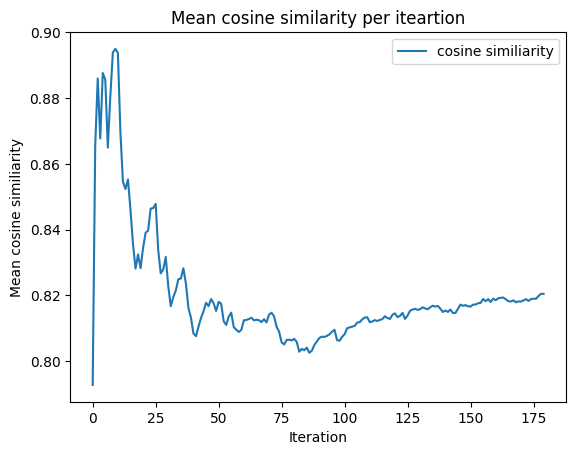

In [ ]:
if TEST_MODEL:
  plt.plot(mean_list, label='cosine similiarity')
  plt.ylabel('Mean cosine similiarity')
  plt.xlabel('Iteration')
  plt.title("Mean cosine similarity per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average cosine similarity is: {mean}')

The average cosine similarity is: 0.8204276525312


###BERTScore

In [ ]:
# Initialize the BERTScorer object
if TEST_MODEL:
  scorer = BERTScorer(lang='en')

In [ ]:
if TEST_MODEL:
  sum = [0, 0, 0]
  n_try = 0
  mean_score_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]

    generated_answer = generate_answer(question)
    if (generated_answer) is not None and (real_answer) is not None:
      P, R, F1 = scorer.score([generated_answer], [real_answer])
      score = [float(P), float(R), float(F1)]
      if i == 0:
        mean_score = score
      sum = [x + y for x, y in zip(sum, score)]
      n_try += 1
      old_mean = mean_score
      mean_score = [(x / n_try) for x in sum]
      mean_score_list.append(mean_score)

      if abs(mean_score[0] - old_mean[0]) < 0.001 and abs(mean_score[1] - old_mean[1]) < 0.001 and abs(mean_score[2] - old_mean[2]) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean_score} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: [0.8940554857254028, 0.8719024062156677, 0.8828400373458862] 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: [0.9268993139266968, 0.9110515415668488, 0.9188940525054932] 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: [0.919126053651174, 0.9066096742947897, 0.9128104249636332] 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: [0.9056114703416824, 0.9179505109786987, 0.9112183600664139] 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: [0.9147365093231201, 0.9298979043960571, 0.9218308329582214] 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: [0.9158051609992981, 0.9368893702824911, 0.9258288045724233] 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: [0.9202536855425153, 0.9235743454524449, 0.9210442815508161] 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: [0.929399847984314, 0.9317616894841194, 0.9298191592097282] 
Last relevant mea

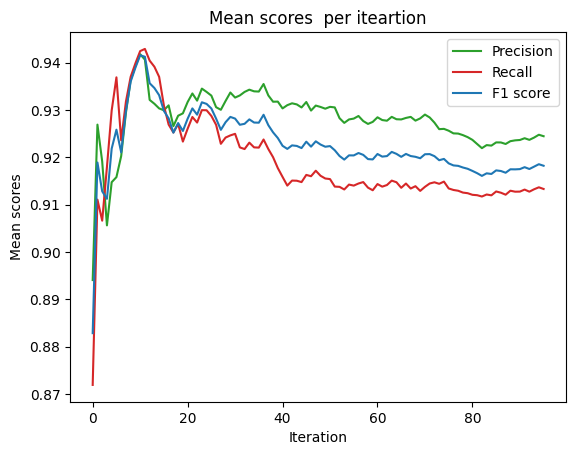

In [ ]:
if TEST_MODEL:
  plt.plot([score[0] for score in mean_score_list], color='#2ca02c',label='Precision')
  plt.plot([score[1] for score in mean_score_list], color='#d62728',label='Recall')
  plt.plot([score[2] for score in mean_score_list],label='F1 score')

  plt.ylabel('Mean scores')
  plt.xlabel('Iteration')
  plt.title("Mean scores  per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print("Precision: ", mean_score[0])
  print("Recall: ", mean_score[1])
  print("F1 score: ", mean_score[2])

Precision:  0.9244503360241652
Recall:  0.9133013846973578
F1 score:  0.9182086444149414


###Execution time

In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_time_list = []
  patience = 20
  k = 0
  for i in tqdm(range(200)):
    question = test_dataset[i]["input"]

    start = time.time()
    generated_answer = generate_answer(question)
    end = time.time()

    score_time = end-start
    if i == 0:
      mean_time = score_time
    sum += score_time
    n_try += 1
    old_mean_time = mean_time
    mean_time = sum/n_try
    mean_time_list.append(mean_time)

100%|██████████| 200/200 [15:23<00:00,  4.62s/it]


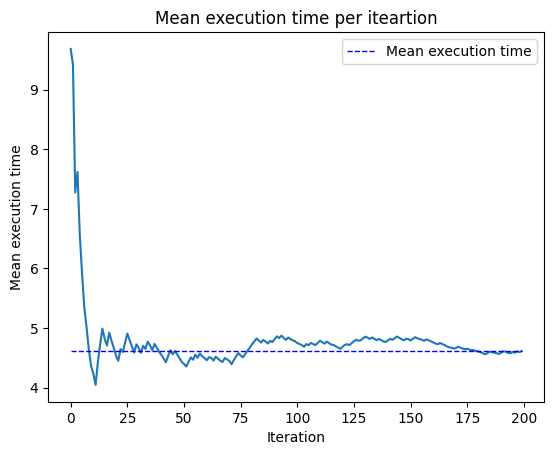

In [ ]:
plt.plot(mean_time_list)
plt.plot([mean_time for i in mean_time_list], '--', color='blue', label='Mean execution time', linewidth=1)
plt.ylabel('Mean execution time')
plt.xlabel('Iteration')
plt.title("Mean execution time per iteartion")
plt.legend()
plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average execution time is: {mean_time}')

The average execution time is: 4.613840124607086


## Saving
To save the final model as LoRA adapters, either use Huggingface's `push_to_hub` for an online save or `save_pretrained` for a local save.


In [ ]:
if not USE_PRETRAINED:
  model.save_pretrained("lora_model") # Local saving
  tokenizer.save_pretrained("lora_model")

loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--unsloth--mistral-7b-v0.3-bnb-4bit/snapshots/b462f9510e81ce70c5c45010e4cd89c464829363/config.json
Model config MistralConfig {
  "_name_or_path": "mistralai/Mistral-7B-v0.3",
  "architectures": [
    "MistralForCausalLM"
  ],
  "attention_dropout": 0.0,
  "bos_token_id": 1,
  "eos_token_id": 2,
  "hidden_act": "silu",
  "hidden_size": 4096,
  "initializer_range": 0.02,
  "intermediate_size": 14336,
  "max_position_embeddings": 32768,
  "model_type": "mistral",
  "num_attention_heads": 32,
  "num_hidden_layers": 32,
  "num_key_value_heads": 8,
  "pad_token_id": 770,
  "quantization_config": {
    "_load_in_4bit": true,
    "_load_in_8bit": false,
    "bnb_4bit_compute_dtype": "bfloat16",
    "bnb_4bit_quant_storage": "uint8",
    "bnb_4bit_quant_type": "nf4",
    "bnb_4bit_use_double_quant": true,
    "llm_int8_enable_fp32_cpu_offload": false,
    "llm_int8_has_fp16_weight": false,
    "llm_int8_ski

##GGUF / llama.cpp Conversion
Use `save_pretrained_gguf` for local saving and `push_to_hub_gguf` for uploading to HF.

Some supported quant methods:
* `q8_0` - Fast conversion. High resource use, but generally acceptable.
* `q4_k_m` - Recommended. Uses Q6_K for half of the attention.wv and feed_forward.w2 tensors, else Q4_K.
* `q5_k_m` - Recommended. Uses Q6_K for half of the attention.wv and feed_forward.w2 tensors, else Q5_K.

In [ ]:
if EXPORT_MODEL:
  # Save to 8bit Q8_0
  if False: model.save_pretrained_gguf("model", tokenizer,)
  if False: model.push_to_hub_gguf("hf/model", tokenizer, token = "")

  # Save to 16bit GGUF
  if False: model.save_pretrained_gguf("model", tokenizer, quantization_method = "f16")
  if False: model.push_to_hub_gguf("hf/model", tokenizer, quantization_method = "f16", token = "")

  # Save to q4_k_m GGUF
  if False: model.save_pretrained_gguf("model", tokenizer, quantization_method = "q4_k_m")
  if False: model.push_to_hub_gguf("hf/model", tokenizer, quantization_method = "q4_k_m", token = "")

#[Gemma](https://ai.google.dev/gemma/docs)
Gemma is an open-source large language model developed by Google.

In this notebook, we are using Gemma with 7 billion parameters. We will define prompts for tuning our model and create functions to map our data to these prompts. By doing so, we can tailor the model’s responses to the specific question answering problem.

##Configurations and imports

Let's import everything we need for the execution!

**Remember to set the flags in the right way to execute everything you need**

In [ ]:
USE_PRETRAINED = True       # Set to False if you want to fine-tune the model and save it, otherwise it will be loaded the previous fine-tuned LoRA model
EXPORT_MODEL = False        # Set to True if you want to export the GGUF model
DOWNLOAD_BIOSENT = False    # Set to True if you want to download the biosentvec dataset to test the model
TEST_MODEL = True           # Set to True if you want to test the model
DOWNLOAD_DATASET = False    # Set to True if you want to download the huggingface dataset and re-split it (note that by doing it you will have a different split of the train-test)

In [ ]:
MODEL_PATH = '/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/Gemma'
DATAS_PATH = '/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/Datasets'
model_name = "unsloth/gemma-7b-bnb-4bit"

In [ ]:
%%capture
# Installs Unsloth, Xformers (Flash Attention) and all other packages!
!pip install "unsloth[colab-new] @ git+https://github.com/unslothai/unsloth.git"
!pip install --no-deps xformers trl peft accelerate bitsandbytes

In [ ]:
from google.colab import drive
from unsloth import FastLanguageModel
from unsloth import is_bfloat16_supported
import torch
from datasets import load_dataset
from datasets import Dataset
import os
from trl import SFTTrainer
import sys
from transformers import TrainingArguments
from transformers.utils import logging
from nltk import word_tokenize
from nltk.corpus import stopwords
from string import punctuation
from scipy.spatial import distance
import nltk
from tqdm import tqdm
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import time

🦥 Unsloth: Will patch your computer to enable 2x faster free finetuning.


In [ ]:
if TEST_MODEL:
  !pip install bert-score
  from bert_score import BERTScorer

  !git clone https://github.com/epfml/sent2vec.git
  %cd sent2vec
  !make
  !pip install .
  import sent2vec

  sys.setrecursionlimit(4000)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.1/61.1 kB 1.9 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-man

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
if DOWNLOAD_BIOSENT:
  os.chdir(f'{DATAS_PATH}')
  os.getcwd()
  !wget https://ftp.ncbi.nlm.nih.gov/pub/lu/Suppl/BioSentVec/BioSentVec_PubMed_MIMICIII-bigram_d700.bin

In [ ]:
os.chdir(f'{MODEL_PATH}')
os.getcwd()

'/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/Gemma'

In [ ]:
nltk.download('stopwords')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

## Model definition

To accelerate the fine-tuning process of our model, we opted for a lightweight tool developed by the community: [Unsloth](https://github.com/unslothai/unsloth).

Unsloth works by overwriting some parts of the modeling code with optimized operations. By manually deriving backpropagation steps and rewriting all Pytorch modules into Triton kernels, Unsloth can both reduce memory usage and make fine-tuning faster.

Crucially, **accuracy degradation is 0%** with respect to normal QLoRA, because no approximations are made in the optimized code.

In [ ]:
max_seq_length = 4096   # TinyLlama's internal maximum sequence length is 2048. We use RoPE Scaling to extend it to 4096 with Unsloth!
dtype = None            # None for auto detection. Float16 for Tesla T4, V100, Bfloat16 for Ampere+
load_in_4bit = True     # Use 4bit quantization to reduce memory usage. Can be False.

In [ ]:
if USE_PRETRAINED:
    #@title Loading finetuned models
    model, tokenizer = FastLanguageModel.from_pretrained(
        model_name = "lora_model", # YOUR MODEL YOU USED FOR TRAINING
        max_seq_length = max_seq_length,
        dtype = dtype,
        load_in_4bit = load_in_4bit,
    )
    FastLanguageModel.for_inference(model) # Enable native 2x faster inference

config.json:   0%|          | 0.00/1.11k [00:00<?, ?B/s]

==((====))==  Unsloth: Fast Gemma patching release 2024.5
   \\   /|    GPU: Tesla T4. Max memory: 14.748 GB. Platform = Linux.
O^O/ \_/ \    Pytorch: 2.3.0+cu121. CUDA = 7.5. CUDA Toolkit = 12.1.
\        /    Bfloat16 = FALSE. Xformers = 0.0.26.post1. FA = False.
 "-____-"     Free Apache license: http://github.com/unslothai/unsloth


model.safetensors:   0%|          | 0.00/5.57G [00:00<?, ?B/s]

`config.hidden_act` is ignored, you should use `config.hidden_activation` instead.
Gemma's activation function will be set to `gelu_pytorch_tanh`. Please, use
`config.hidden_activation` if you want to override this behaviour.
See https://github.com/huggingface/transformers/pull/29402 for more details.


generation_config.json:   0%|          | 0.00/137 [00:00<?, ?B/s]

Unsloth 2024.5 patched 28 layers with 28 QKV layers, 28 O layers and 28 MLP layers.


In [ ]:
if not USE_PRETRAINED:
  model, tokenizer = FastLanguageModel.from_pretrained(
    model_name = model_name,
    max_seq_length = max_seq_length,
    dtype = dtype,
    load_in_4bit = load_in_4bit,
  )


To speedup the tuning even more and decrease the needed computational power we used [LoRA](https://arxiv.org/abs/2106.09685). LoRA is a novel technique introduced by Microsoft researchers to deal with the problem of fine-tuning large-language models.

LoRA proposes freezing pre-trained model weights, which reduces the number of trainable parameters and GPU memory requirements.

In [ ]:
if not USE_PRETRAINED:
  model = FastLanguageModel.get_peft_model(
      model,
      r = 32,    #16 in previous implementation                    # Choose any number > 0 ! Suggested 8, 16, 32, 64, 128
      target_modules = ["q_proj", "k_proj", "v_proj", "o_proj",
                        "gate_proj", "up_proj", "down_proj",],
      lora_alpha = 32, #16 in previous implementation
      lora_dropout = 0,                                            # Currently only supports dropout = 0
      bias = "none",                                               # Currently only supports bias = "none"
      use_gradient_checkpointing = "unsloth",                          # We set `gradient_checkpointing=False` ONLY for TinyLlama since Unsloth saves tonnes of memory usage. @@@ IF YOU GET OUT OF MEMORY - set to True @@@
      random_state = 3407,
      use_rslora = False,                                          # We support rank stabilized LoRA
      loftq_config = None,                                         # And LoftQ
  )

Now, let's define the prompt used for tuning our model and create the function to map our data to this prompt.*testo in corsivo*

In [ ]:
alpaca_prompt = """Below is an instruction that describes a task, paired with an input that provides further context. Write a response that appropriately completes the request.

### Instruction:
{}

### Input:
{}

### Response:
{}"""

EOS_TOKEN = tokenizer.eos_token
def formatting_prompts_func(examples):
    instructions = examples["instruction"]
    inputs       = examples["input"]
    outputs      = examples["output"]
    texts = []
    for instruction, input, output in zip(instructions, inputs, outputs):
        # Must add EOS_TOKEN, otherwise your generation will go on forever!
        text = alpaca_prompt.format(instruction, input, output) + EOS_TOKEN
        texts.append(text)
    return { "text" : texts, }
pass



## Dataset import
To maintain the integrity of model testing, we pre-saved the dataset split in a dataframe. This ensures that during testing, no training samples are utilized, thereby preserving the model evaluation process.

In [ ]:
if DOWNLOAD_DATASET:
  dataset_path = "medalpaca/medical_meadow_medical_flashcards"
  raw_dataset = load_dataset(dataset_path)
  dataset = raw_dataset["train"].train_test_split(test_size=0.2)
  train_dataset = dataset["train"]
  test_dataset = dataset["test"]
  if False:
    df_train = dataset["train"].to_pandas()
    df_test = dataset["test"].to_pandas()
    os.chdir(f'{DATAS_PATH}')
    os.getcwd()
    df_train.to_csv("train_split.csv", index=False)
    df_test.to_csv("test_split.csv", index=False)
    os.chdir(f'{MODEL_PATH}')
    os.getcwd()
else:
  os.chdir(f'{DATAS_PATH}')
  os.getcwd()
  test_dataset = Dataset.from_pandas(pd.read_csv('test_split.csv'))
  train_dataset = Dataset.from_pandas(pd.read_csv('train_split.csv'))
  os.chdir(f'{MODEL_PATH}')
  os.getcwd()

train_dataset = train_dataset.map(formatting_prompts_func, batched = True)
test_dataset = test_dataset.map(formatting_prompts_func, batched = True)

Map:   0%|          | 0/27164 [00:00<?, ? examples/s]

Map:   0%|          | 0/6791 [00:00<?, ? examples/s]

## Train the model
Now let's use Huggingface TRL's `SFTTrainer`!

In [ ]:
if not USE_PRETRAINED:
  logging.set_verbosity_info()

  training_args = TrainingArguments(
      per_device_train_batch_size = 8,
      gradient_accumulation_steps = 4,
      warmup_ratio = 0.1,
      num_train_epochs = 3,
      save_steps = 100,
      learning_rate = 2e-4,
      fp16 = not is_bfloat16_supported(),
      bf16 = is_bfloat16_supported(),
      #fp16 = not torch.cuda.is_bf16_supported(),
      #bf16 = torch.cuda.is_bf16_supported(),
      logging_steps = 1,
      optim = "adamw_8bit",
      weight_decay = 0.01,
      lr_scheduler_type = "linear",
      seed = 3407,
      output_dir = "outputs",
      overwrite_output_dir = True
  )

  trainer = SFTTrainer(
      model = model,
      tokenizer = tokenizer,
      train_dataset = train_dataset,
      dataset_text_field = "text",
      max_seq_length = max_seq_length,
      dataset_num_proc = 2,
      packing = False, # Packs short sequences together to save time!
      args = training_args,
  )

In [ ]:
if not USE_PRETRAINED:
  #@title Show current memory stats
  gpu_stats = torch.cuda.get_device_properties(0)
  start_gpu_memory = round(torch.cuda.max_memory_reserved() / 1024 / 1024 / 1024, 3)
  max_memory = round(gpu_stats.total_memory / 1024 / 1024 / 1024, 3)
  print(f"GPU = {gpu_stats.name}. Max memory = {max_memory} GB.")
  print(f"{start_gpu_memory} GB of memory reserved.")

In [ ]:
if not USE_PRETRAINED:
  if len(os.listdir("outputs")) <= 1:
    trainer_stats = trainer.train()
  else:
    trainer_stats = trainer.train(resume_from_checkpoint=True)

In [ ]:
if not USE_PRETRAINED:
  #@title Show final memory and time stats
  used_memory = round(torch.cuda.max_memory_reserved() / 1024 / 1024 / 1024, 3)
  used_memory_for_lora = round(used_memory - start_gpu_memory, 3)
  used_percentage = round(used_memory         /max_memory*100, 3)
  lora_percentage = round(used_memory_for_lora/max_memory*100, 3)
  print(f"{trainer_stats.metrics['train_runtime']} seconds used for training.")
  print(f"{round(trainer_stats.metrics['train_runtime']/60, 2)} minutes used for training.")
  print(f"Peak reserved memory = {used_memory} GB.")
  print(f"Peak reserved memory for training = {used_memory_for_lora} GB.")
  print(f"Peak reserved memory % of max memory = {used_percentage} %.")
  print(f"Peak reserved memory for training % of max memory = {lora_percentage} %.")

##Functions
Some useful functions!

In [ ]:
stop_words = set(stopwords.words('english'))
def preprocess_sentence(text):
    text = text.replace('/', ' / ')
    text = text.replace('.-', ' .- ')
    text = text.replace('.', ' . ')
    text = text.replace('\'', ' \' ')
    text = text.lower()

    tokens = [token for token in word_tokenize(text) if token not in punctuation and token not in stop_words]

    return ' '.join(tokens)

In [ ]:
def generate_answer(question):
  # alpaca_prompt = Copied from above
  FastLanguageModel.for_inference(model) # Enable native 2x faster inference
  inputs = tokenizer(
  [
      alpaca_prompt.format(
          "Answer this question truthfully", # instruction
          question, # input
          "", # output - leave this blank for generation!
      )
  ], return_tensors = "pt").to("cuda")

  outputs = model.generate(**inputs, max_new_tokens = 128, use_cache = True)
  tokenizer.batch_decode(outputs)
  predicted_answer = tokenizer.batch_decode(outputs[:, inputs['input_ids'].shape[1]:])[0]
  predicted_answer = predicted_answer[:(len(predicted_answer)-5)]
  return predicted_answer

## Inference
Let's run the model! You can change the instruction and input - leave the output blank!

 We can also use a `TextStreamer` for continuous inference - so you can see the generation token by token, instead of waiting the whole time!

In [ ]:
# alpaca_prompt = Copied from above
FastLanguageModel.for_inference(model) # Enable native 2x faster inference
inputs = tokenizer(
[
    alpaca_prompt.format(
        "Answer this question truthfully", # instruction
        "How it is possible to lose fat?", # input
        "", # output - leave this blank for generation!
    )
], return_tensors = "pt").to("cuda")

from transformers import TextStreamer
text_streamer = TextStreamer(tokenizer)
_ = model.generate(**inputs, streamer = text_streamer, max_new_tokens = 128, use_cache = False)

<bos>Below is an instruction that describes a task, paired with an input that provides further context. Write a response that appropriately completes the request.

### Instruction:
Answer this question truthfully

### Input:
How it is possible to lose fat?

### Response:
It is possible to lose fat through a process called lipolysis, which involves the breakdown of stored triglycerides into glycerol and fatty acids. This process is primarily carried out by enzymes called lipases, which are located in the adipose tissue. When the body needs energy, the stored triglycerides are broken down into their component parts and released into the bloodstream, where they can be used by other tissues for fuel. The glycerol and fatty acids can then be taken up by other tissues, such as muscle, and used for energy production. However, it is important to note that losing fat through lipolysis alone is not enough to achieve significant weight loss,


##Testing

To evaluate the model is essential to establish metrics that evaluate the accuracy of a generated answer relative to the correct one. In our context, we have identified two key metrics: **BERTScore** and **Evaluation with Embedding**

We chose these metrics over more statistical ones because both BERTScores and embeddings take into account the contextual meaning of sentences when assessing their similarity, making them excellent choices for evaluating our models.

To expedite the evaluation process, a stopping criterion has been used. If, in the last 20 iterations of the for loop calculating the mean score, the mean does not change significantly, the execution stops, and the score is printed.

Additionally, the model has been evaluated for execution time in answering questions.

In [ ]:
index = 300
#@title Manual testing
real_answer = test_dataset[index]["output"]
generated_answer = generate_answer(test_dataset[index]["input"])
question = test_dataset[index]["input"]

print("Question: ", question)
print("Generated answer: ", generated_answer)
print("Real answer: ", real_answer)

Question:  What does it mean if the relative risk is less than 1 in relation to exposure and disease occurrence?
Generated answer:  If the relative risk is less than 1, it means that there is no association between exposure to a particular factor or variable and the occurrence of the disease in question. In other words, there is no difference in the likelihood of developing the disease between individuals who are exposed to the factor or variable and those who are not. The relative risk is a measure of the strength of the association between exposure and disease occurrence, and a value of less than 1 indicates no association.
Real answer:  If the relative risk is less than 1, it means that exposure to a particular factor or variable is associated with a decreased occurrence of the disease in question. In other words, individuals who are exposed to the factor or variable are less likely to develop the disease than those who are not exposed. The relative risk is a measure of the strength

###BioSentVec loading...

In [ ]:
if TEST_MODEL:
  model_path = f'{DATAS_PATH}/BioSentVec_PubMed_MIMICIII-bigram_d700.bin'
  testing_model = sent2vec.Sent2vecModel()

In [ ]:
if TEST_MODEL:
  def evaluate_answer(real, predicted):
    sentence_vector1 = testing_model.embed_sentence(preprocess_sentence(real))
    sentence_vector2 = testing_model.embed_sentence(preprocess_sentence(predicted))
    cosine_sim = 1 - distance.cosine(sentence_vector1[0], sentence_vector2[0])
    return cosine_sim

In [ ]:
if TEST_MODEL:
  try:
      testing_model.load_model(model_path)
  except Exception as e:
      print(e)
  print('model successfully loaded')

model successfully loaded


###BioSentVec score

In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]
    generated_answer = generate_answer(question)
    if (generated_answer) is not None and (real_answer) is not None:
      score = evaluate_answer(real_answer, generated_answer)
      if i == 0:
        mean = score
      sum += score
      n_try += 1
      old_mean = mean
      mean = sum/n_try
      mean_list.append(mean)

      if abs(mean - old_mean) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: 0.845103919506073 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: 0.7832554578781128 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: 0.8274267911911011 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: 0.8089144080877304 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: 0.8471315264701843 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: 0.8645644783973694 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: 0.8463570816176278 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: 0.8643742203712463 
Last relevant mean change is 0 iteration ago


Iteration: 8, Mean: 0.8710843523343405 
Last relevant mean change is 0 iteration ago


Iteration: 9, Mean: 0.8704224705696106 
Last relevant mean change is 1 iteration ago


Iteration: 10, Mean: 0.872317373752594 
Last relevant mean change is 0 iteration ago


Iteration: 11, Mean: 0.846140573422114 
Last

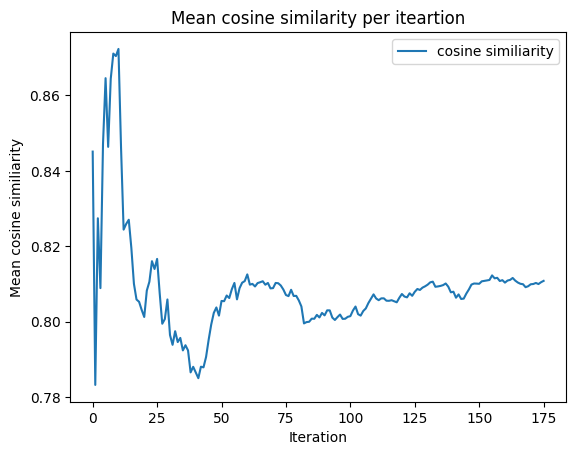

In [ ]:
if TEST_MODEL:
  plt.plot(mean_list, label='cosine similiarity')
  plt.ylabel('Mean cosine similiarity')
  plt.xlabel('Iteration')
  plt.title("Mean cosine similarity per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'the average cosine similarity is: {mean}')

the average cosine similarity is: 0.8108361420983617


###BERTScore

In [ ]:
# Initialize the BERTScorer object
if TEST_MODEL:
  scorer = BERTScorer(lang='en')

tokenizer_config.json:   0%|          | 0.00/25.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/482 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.42G [00:00<?, ?B/s]

Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
if TEST_MODEL:
  sum = [0, 0, 0]
  n_try = 0
  mean_score_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]

    generated_answer = generate_answer(question)
    if (generated_answer) is not None and (real_answer) is not None:
      P, R, F1 = scorer.score([generated_answer], [real_answer])
      score = [float(P), float(R), float(F1)]
      if i == 0:
        mean_score = score
      sum = [x + y for x, y in zip(sum, score)]
      n_try += 1
      old_mean = mean_score
      mean_score = [(x / n_try) for x in sum]
      mean_score_list.append(mean_score)

      if abs(mean_score[0] - old_mean[0]) < 0.001 and abs(mean_score[1] - old_mean[1]) < 0.001 and abs(mean_score[2] - old_mean[2]) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean_score} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: [0.9094024896621704, 0.893645703792572, 0.901455283164978] 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: [0.9266642928123474, 0.8709637224674225, 0.8975035548210144] 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: [0.9143059651056925, 0.8801838159561157, 0.8963636557261149] 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: [0.9002195596694946, 0.89464071393013, 0.8963232040405273] 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: [0.9201756477355957, 0.915712571144104, 0.9170585632324219] 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: [0.9312161405881246, 0.9274969100952148, 0.9286185701688131] 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: [0.9339583601270404, 0.9160635811941964, 0.9239573734147208] 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: [0.9419130459427834, 0.926255114376545, 0.9331621825695038] 
Last relevant mean ch

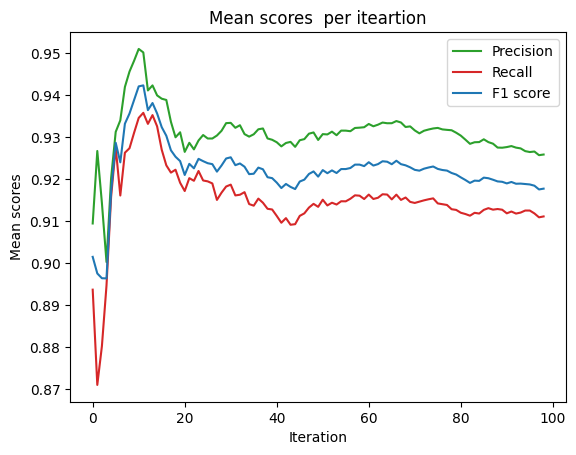

In [ ]:
if TEST_MODEL:
  plt.plot([score[0] for score in mean_score_list], color='#2ca02c',label='Precision')
  plt.plot([score[1] for score in mean_score_list], color='#d62728',label='Recall')
  plt.plot([score[2] for score in mean_score_list],label='F1 score')

  plt.ylabel('Mean scores')
  plt.xlabel('Iteration')
  plt.title("Mean scores  per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print("Precision: ", mean_score[0])
  print("Recall: ", mean_score[1])
  print("F1 score: ", mean_score[2])

Precision:  0.9258216595408892
Recall:  0.9110808805985884
F1 score:  0.9176973285097064


###Execution time

In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_time_list = []
  patience = 20
  k = 0
  for i in tqdm(range(200)):
    question = test_dataset[i]["input"]

    start = time.time()
    generated_answer = generate_answer(question)
    end = time.time()

    score_time = end-start
    if i == 0:
      mean_time = score_time
    sum += score_time
    n_try += 1
    old_mean_time = mean_time
    mean_time = sum/n_try
    mean_time_list.append(mean_time)

100%|██████████| 200/200 [14:38<00:00,  4.39s/it]


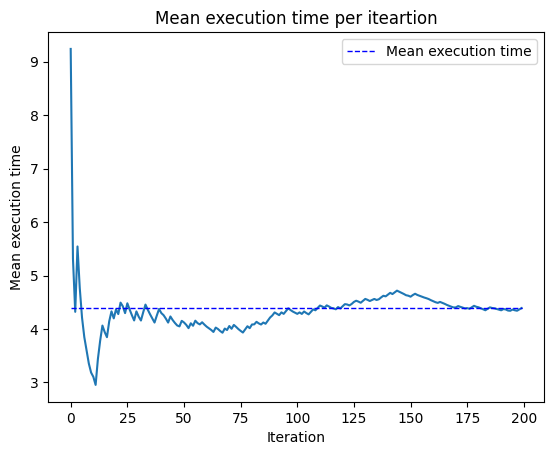

In [ ]:
plt.plot(mean_time_list)
plt.plot([mean_time for i in mean_time_list], '--', color='blue', label='Mean execution time', linewidth=1)
plt.ylabel('Mean execution time')
plt.xlabel('Iteration')
plt.title("Mean execution time per iteartion")
plt.legend()
plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average execution time is: {mean_time}')

The average execution time is: 4.391400870084762


## Saving
To save the final model as LoRA adapters, either use Huggingface's `push_to_hub` for an online save or `save_pretrained` for a local save.


In [ ]:
if not USE_PRETRAINED:
  model.save_pretrained("lora_model") # Local saving
  tokenizer.save_pretrained("lora_model")

loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--unsloth--gemma-7b-bnb-4bit/snapshots/d5efa09c28a16ede99e9df6b4e720ad4ee2c6a2b/config.json
Model config GemmaConfig {
  "_name_or_path": "google/gemma-7b",
  "architectures": [
    "GemmaForCausalLM"
  ],
  "attention_bias": false,
  "attention_dropout": 0.0,
  "bos_token_id": 2,
  "eos_token_id": 1,
  "head_dim": 256,
  "hidden_act": "gelu",
  "hidden_activation": null,
  "hidden_size": 3072,
  "initializer_range": 0.02,
  "intermediate_size": 24576,
  "max_position_embeddings": 8192,
  "model_type": "gemma",
  "num_attention_heads": 16,
  "num_hidden_layers": 28,
  "num_key_value_heads": 16,
  "pad_token_id": 0,
  "quantization_config": {
    "_load_in_4bit": true,
    "_load_in_8bit": false,
    "bnb_4bit_compute_dtype": "bfloat16",
    "bnb_4bit_quant_type": "nf4",
    "bnb_4bit_use_double_quant": true,
    "llm_int8_enable_fp32_cpu_offload": false,
    "llm_int8_has_fp16_weight": false,
    "l

##GGUF / llama.cpp Conversion
Use `save_pretrained_gguf` for local saving and `push_to_hub_gguf` for uploading to HF.

Some supported quant methods:
* `q8_0` - Fast conversion. High resource use, but generally acceptable.
* `q4_k_m` - Recommended. Uses Q6_K for half of the attention.wv and feed_forward.w2 tensors, else Q4_K.
* `q5_k_m` - Recommended. Uses Q6_K for half of the attention.wv and feed_forward.w2 tensors, else Q5_K.

In [ ]:
if EXPORT_MODEL:
  # Save to 8bit Q8_0
  if False: model.save_pretrained_gguf("model", tokenizer,)
  if False: model.push_to_hub_gguf("hf/model", tokenizer, token = "")

  # Save to 16bit GGUF
  if False: model.save_pretrained_gguf("model", tokenizer, quantization_method = "f16")
  if False: model.push_to_hub_gguf("hf/model", tokenizer, quantization_method = "f16", token = "")

  # Save to q4_k_m GGUF
  if False: model.save_pretrained_gguf("model", tokenizer, quantization_method = "q4_k_m")
  if False: model.push_to_hub_gguf("hf/model", tokenizer, quantization_method = "q4_k_m", token = "")

#[Llama](https://llama.meta.com/llama3/)
LLama (Large Language Model Meta AI) is an open-source large language model developed by Meta.

In this notebook, we are using Llama 3 with 8 billion parameters. We will define prompts for tuning our model and create functions to map our data to these prompts. By doing so, we can tailor the model’s responses to the specific question answering problem.

##Configurations and imports

Let's import everything we need for the execution!

**Remember to set the flags in the right way to execute everything you need**

In [ ]:
USE_PRETRAINED = True       # Set to False if you want to fine-tune the model and save it, otherwise it will be loaded the previous fine-tuned LoRA model
EXPORT_MODEL = False        # Set to True if you want to export the GGUF model
DOWNLOAD_BIOSENT = False    # Set to True if you want to download the biosentvec dataset to test the model
TEST_MODEL = True          # Set to True if you want to test the model
DOWNLOAD_DATASET = False    # Set to True if you want to download the huggingface dataset and re-split it (note that by doing it you will have a different split of the train-test)

In [ ]:
MODEL_PATH = '/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/llama'
DATAS_PATH = '/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/Datasets'
model_name = "unsloth/llama-3-8b-bnb-4bit"

In [ ]:
%%capture
# Installs Unsloth, Xformers (Flash Attention) and all other packages!
!pip install "unsloth[colab-new] @ git+https://github.com/unslothai/unsloth.git"
!pip install --no-deps xformers trl peft accelerate bitsandbytes

In [ ]:
from google.colab import drive
from unsloth import FastLanguageModel
from unsloth import is_bfloat16_supported
import torch
from datasets import load_dataset
from datasets import Dataset
import os
from trl import SFTTrainer
import sys
from transformers import TrainingArguments
from transformers.utils import logging
from nltk import word_tokenize
from nltk.corpus import stopwords
from string import punctuation
from scipy.spatial import distance
import nltk
from tqdm import tqdm
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import time

🦥 Unsloth: Will patch your computer to enable 2x faster free finetuning.


In [ ]:
if TEST_MODEL:
  !pip install bert-score
  from bert_score import BERTScorer

  !git clone https://github.com/epfml/sent2vec.git
  %cd sent2vec
  !make
  !pip install .
  import sent2vec

  sys.setrecursionlimit(2500)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.1/61.1 kB 1.6 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-man

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
if DOWNLOAD_BIOSENT:
  os.chdir(f'{DATAS_PATH}')
  os.getcwd()
  !wget https://ftp.ncbi.nlm.nih.gov/pub/lu/Suppl/BioSentVec/BioSentVec_PubMed_MIMICIII-bigram_d700.bin

In [ ]:
os.chdir(f'{MODEL_PATH}')
os.getcwd()

'/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/llama'

In [ ]:
nltk.download('stopwords')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

## Model definition

To accelerate the fine-tuning process of our model, we opted for a lightweight tool developed by the community: [Unsloth](https://github.com/unslothai/unsloth).

Unsloth works by overwriting some parts of the modeling code with optimized operations. By manually deriving backpropagation steps and rewriting all Pytorch modules into Triton kernels, Unsloth can both reduce memory usage and make fine-tuning faster.

Crucially, **accuracy degradation is 0%** with respect to normal QLoRA, because no approximations are made in the optimized code.

In [ ]:
max_seq_length = 4096   # TinyLlama's internal maximum sequence length is 2048. We use RoPE Scaling to extend it to 4096 with Unsloth!
dtype = None            # None for auto detection. Float16 for Tesla T4, V100, Bfloat16 for Ampere+
load_in_4bit = True     # Use 4bit quantization to reduce memory usage. Can be False.

In [ ]:
if USE_PRETRAINED:
    #@title Loading finetuned models
    model, tokenizer = FastLanguageModel.from_pretrained(
        model_name = "lora_model", # YOUR MODEL YOU USED FOR TRAINING
        max_seq_length = max_seq_length,
        dtype = dtype,
        load_in_4bit = load_in_4bit,
    )
    FastLanguageModel.for_inference(model) # Enable native 2x faster inference

config.json:   0%|          | 0.00/1.18k [00:00<?, ?B/s]

==((====))==  Unsloth: Fast Llama patching release 2024.5
   \\   /|    GPU: Tesla T4. Max memory: 14.748 GB. Platform = Linux.
O^O/ \_/ \    Pytorch: 2.3.0+cu121. CUDA = 7.5. CUDA Toolkit = 12.1.
\        /    Bfloat16 = FALSE. Xformers = 0.0.26.post1. FA = False.
 "-____-"     Free Apache license: http://github.com/unslothai/unsloth


model.safetensors:   0%|          | 0.00/5.70G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/172 [00:00<?, ?B/s]

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.
Unsloth 2024.5 patched 32 layers with 32 QKV layers, 32 O layers and 32 MLP layers.


In [ ]:
if not USE_PRETRAINED:
  model, tokenizer = FastLanguageModel.from_pretrained(
    model_name = model_name,
    max_seq_length = max_seq_length,
    dtype = dtype,
    load_in_4bit = load_in_4bit,
  )


To speedup the tuning even more and decrease the needed computational power we used [LoRA](https://arxiv.org/abs/2106.09685). LoRA is a novel technique introduced by Microsoft researchers to deal with the problem of fine-tuning large-language models.

LoRA proposes freezing pre-trained model weights, which reduces the number of trainable parameters and GPU memory requirements.

In [ ]:
if not USE_PRETRAINED:
  model = FastLanguageModel.get_peft_model(
      model,
      r = 32,    #16 in previous implementation                    # Choose any number > 0 ! Suggested 8, 16, 32, 64, 128
      target_modules = ["q_proj", "k_proj", "v_proj", "o_proj",
                        "gate_proj", "up_proj", "down_proj",],
      lora_alpha = 32, #16 in previous implementation
      lora_dropout = 0,                                            # Currently only supports dropout = 0
      bias = "none",                                               # Currently only supports bias = "none"
      use_gradient_checkpointing = "unsloth",                          # We set `gradient_checkpointing=False` ONLY for TinyLlama since Unsloth saves tonnes of memory usage. @@@ IF YOU GET OUT OF MEMORY - set to True @@@
      random_state = 3407,
      use_rslora = False,                                          # We support rank stabilized LoRA
      loftq_config = None,                                         # And LoftQ
  )

Now, let's define the prompt used for tuning our model and create the function to map our data to this prompt.*testo in corsivo*

In [ ]:
alpaca_prompt = """Below is an instruction that describes a task, paired with an input that provides further context. Write a response that appropriately completes the request.

### Instruction:
{}

### Input:
{}

### Response:
{}"""

EOS_TOKEN = tokenizer.eos_token
def formatting_prompts_func(examples):
    instructions = examples["instruction"]
    inputs       = examples["input"]
    outputs      = examples["output"]
    texts = []
    for instruction, input, output in zip(instructions, inputs, outputs):
        # Must add EOS_TOKEN, otherwise your generation will go on forever!
        text = alpaca_prompt.format(instruction, input, output) + EOS_TOKEN
        texts.append(text)
    return { "text" : texts, }
pass



## Dataset import
To maintain the integrity of model testing, we pre-saved the dataset split in a dataframe. This ensures that during testing, no training samples are utilized, thereby preserving the model evaluation process.

In [ ]:
if DOWNLOAD_DATASET:
  dataset_path = "medalpaca/medical_meadow_medical_flashcards"
  raw_dataset = load_dataset(dataset_path)
  dataset = raw_dataset["train"].train_test_split(test_size=0.2)
  train_dataset = dataset["train"]
  test_dataset = dataset["test"]
  if False:
    df_train = dataset["train"].to_pandas()
    df_test = dataset["test"].to_pandas()
    os.chdir(f'{DATAS_PATH}')
    os.getcwd()
    df_train.to_csv("train_split.csv", index=False)
    df_test.to_csv("test_split.csv", index=False)
    os.chdir(f'{MODEL_PATH}')
    os.getcwd()
else:
  os.chdir(f'{DATAS_PATH}')
  os.getcwd()
  test_dataset = Dataset.from_pandas(pd.read_csv('test_split.csv'))
  train_dataset = Dataset.from_pandas(pd.read_csv('train_split.csv'))
  os.chdir(f'{MODEL_PATH}')
  os.getcwd()

train_dataset = train_dataset.map(formatting_prompts_func, batched = True)
test_dataset = test_dataset.map(formatting_prompts_func, batched = True)

Map:   0%|          | 0/27164 [00:00<?, ? examples/s]

Map:   0%|          | 0/6791 [00:00<?, ? examples/s]

## Train the model
Now let's use Huggingface TRL's `SFTTrainer`!

In [ ]:
if not USE_PRETRAINED:
  logging.set_verbosity_info()

  training_args = TrainingArguments(
      per_device_train_batch_size = 8,
      gradient_accumulation_steps = 4,
      warmup_ratio = 0.1,
      num_train_epochs = 3,
      save_steps = 100,
      learning_rate = 2e-4,
      fp16 = not is_bfloat16_supported(),
      bf16 = is_bfloat16_supported(),
      #fp16 = not torch.cuda.is_bf16_supported(),
      #bf16 = torch.cuda.is_bf16_supported(),
      logging_steps = 1,
      optim = "adamw_8bit",
      weight_decay = 0.01,
      lr_scheduler_type = "linear",
      seed = 3407,
      output_dir = "outputs",
      overwrite_output_dir = True
  )

  trainer = SFTTrainer(
      model = model,
      tokenizer = tokenizer,
      train_dataset = train_dataset,
      dataset_text_field = "text",
      max_seq_length = max_seq_length,
      dataset_num_proc = 2,
      packing = False, # Packs short sequences together to save time!
      args = training_args,
  )

PyTorch: setting up devices
The default value for the training argument `--report_to` will change in v5 (from all installed integrations to none). In v5, you will need to use `--report_to all` to get the same behavior as now. You should start updating your code and make this info disappear :-).
/usr/local/lib/python3.10/dist-packages/multiprocess/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Map (num_proc=2):   0%|          | 0/27164 [00:00<?, ? examples/s]

Using auto half precision backend


In [ ]:
if not USE_PRETRAINED:
  #@title Show current memory stats
  gpu_stats = torch.cuda.get_device_properties(0)
  start_gpu_memory = round(torch.cuda.max_memory_reserved() / 1024 / 1024 / 1024, 3)
  max_memory = round(gpu_stats.total_memory / 1024 / 1024 / 1024, 3)
  print(f"GPU = {gpu_stats.name}. Max memory = {max_memory} GB.")
  print(f"{start_gpu_memory} GB of memory reserved.")

GPU = NVIDIA A100-SXM4-40GB. Max memory = 39.564 GB.
5.762 GB of memory reserved.


In [ ]:
if not USE_PRETRAINED:
  if len(os.listdir("outputs")) <= 1:
    trainer_stats = trainer.train()
  else:
    trainer_stats = trainer.train(resume_from_checkpoint=True)

==((====))==  Unsloth - 2x faster free finetuning | Num GPUs = 1
   \\   /|    Num examples = 27,164 | Num Epochs = 3
O^O/ \_/ \    Batch size per device = 8 | Gradient Accumulation steps = 4
\        /    Total batch size = 32 | Total steps = 2,547
 "-____-"     Number of trainable parameters = 83,886,080


Step,Training Loss
1,1.921000
2,1.937100
3,2.265900
4,1.805100
5,1.918200
6,2.265000
7,1.995700
8,1.922100
9,2.139700
10,1.958700


Saving model checkpoint to outputs/checkpoint-100
loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--unsloth--llama-3-8b-bnb-4bit/snapshots/0185ed6b320080320ebf712ad98fc3e1170b7f3f/config.json
Model config LlamaConfig {
  "_name_or_path": "meta-llama/Meta-Llama-3-8B",
  "architectures": [
    "LlamaForCausalLM"
  ],
  "attention_bias": false,
  "attention_dropout": 0.0,
  "bos_token_id": 128000,
  "eos_token_id": 128001,
  "hidden_act": "silu",
  "hidden_size": 4096,
  "initializer_range": 0.02,
  "intermediate_size": 14336,
  "max_position_embeddings": 8192,
  "mlp_bias": false,
  "model_type": "llama",
  "num_attention_heads": 32,
  "num_hidden_layers": 32,
  "num_key_value_heads": 8,
  "pretraining_tp": 1,
  "quantization_config": {
    "_load_in_4bit": true,
    "_load_in_8bit": false,
    "bnb_4bit_compute_dtype": "bfloat16",
    "bnb_4bit_quant_storage": "uint8",
    "bnb_4bit_quant_type": "nf4",
    "bnb_4bit_use_double_quant": true,
    "l

In [ ]:
if not USE_PRETRAINED:
  #@title Show final memory and time stats
  used_memory = round(torch.cuda.max_memory_reserved() / 1024 / 1024 / 1024, 3)
  used_memory_for_lora = round(used_memory - start_gpu_memory, 3)
  used_percentage = round(used_memory         /max_memory*100, 3)
  lora_percentage = round(used_memory_for_lora/max_memory*100, 3)
  print(f"{trainer_stats.metrics['train_runtime']} seconds used for training.")
  print(f"{round(trainer_stats.metrics['train_runtime']/60, 2)} minutes used for training.")
  print(f"Peak reserved memory = {used_memory} GB.")
  print(f"Peak reserved memory for training = {used_memory_for_lora} GB.")
  print(f"Peak reserved memory % of max memory = {used_percentage} %.")
  print(f"Peak reserved memory for training % of max memory = {lora_percentage} %.")

7305.0234 seconds used for training.
121.75 minutes used for training.
Peak reserved memory = 9.002 GB.
Peak reserved memory for training = 3.24 GB.
Peak reserved memory % of max memory = 22.753 %.
Peak reserved memory for training % of max memory = 8.189 %.


##Functions
Some useful functions!

In [ ]:
stop_words = set(stopwords.words('english'))
def preprocess_sentence(text):
    text = text.replace('/', ' / ')
    text = text.replace('.-', ' .- ')
    text = text.replace('.', ' . ')
    text = text.replace('\'', ' \' ')
    text = text.lower()

    tokens = [token for token in word_tokenize(text) if token not in punctuation and token not in stop_words]

    return ' '.join(tokens)

In [ ]:
def generate_answer(question):
  # alpaca_prompt = Copied from above
  FastLanguageModel.for_inference(model) # Enable native 2x faster inference
  inputs = tokenizer(
  [
      alpaca_prompt.format(
          "Answer this question truthfully", # instruction
          question, # input
          "", # output - leave this blank for generation!
      )
  ], return_tensors = "pt").to("cuda")

  outputs = model.generate(**inputs, max_new_tokens = 128, use_cache = True, pad_token_id=tokenizer.eos_token_id)
  tokenizer.batch_decode(outputs)
  predicted_answer = tokenizer.batch_decode(outputs[:, inputs['input_ids'].shape[1]:])[0]
  predicted_answer = predicted_answer[:(len(predicted_answer)-5)]
  return predicted_answer

## Inference
Let's run the model! You can change the instruction and input - leave the output blank!

 We can also use a `TextStreamer` for continuous inference - so you can see the generation token by token, instead of waiting the whole time!

In [ ]:
# alpaca_prompt = Copied from above
FastLanguageModel.for_inference(model) # Enable native 2x faster inference
inputs = tokenizer(
[
    alpaca_prompt.format(
        "Answer this question truthfully", # instruction
        "What is the PAP test?", # input
        "", # output - leave this blank for generation!
    )
], return_tensors = "pt").to("cuda")

from transformers import TextStreamer
text_streamer = TextStreamer(tokenizer)
_ = model.generate(**inputs, streamer = text_streamer, max_new_tokens = 128)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


<|begin_of_text|>Below is an instruction that describes a task, paired with an input that provides further context. Write a response that appropriately completes the request.

### Instruction:
Answer this question truthfully

### Input:
What is the PAP test?

### Response:
The PAP test is a medical test that stands for Pap smear. It is a screening tool used to detect abnormal cells in the cervix that may be indicative of pre-cancerous or cancerous changes. During the test, a healthcare provider collects cells from the cervix and sends them to a laboratory for analysis. The PAP test is a relatively simple and non-invasive procedure that can help detect cervical cancer early, when it is most treatable. It is recommended that women between the ages of 21 and 65 have a PAP test every three to five years, or more frequently if they have a history of abnormal P


##Testing

To evaluate the model is essential to establish metrics that evaluate the accuracy of a generated answer relative to the correct one. In our context, we have identified two key metrics: **BERTScore** and **Evaluation with Embedding**

We chose these metrics over more statistical ones because both BERTScores and embeddings take into account the contextual meaning of sentences when assessing their similarity, making them excellent choices for evaluating our models.

To expedite the evaluation process, a stopping criterion has been used. If, in the last 20 iterations of the for loop calculating the mean score, the mean does not change significantly, the execution stops, and the score is printed.

Additionally, the model has been evaluated for execution time in answering questions.

In [ ]:
index = 300
#@title Manual testing
real_answer = test_dataset[index]["output"]
generated_answer = generate_answer(test_dataset[index]["input"])
question = test_dataset[index]["input"]

print("Question: ", question)
print("Generated answer: ", generated_answer)
print("Real answer: ", real_answer)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


Question:  What does it mean if the relative risk is less than 1 in relation to exposure and disease occurrence?
Generated answer:  If the relative risk is less than 1, it means that exposure to the risk factor is actually protective against the occurrence of the disease.<|end_of_t
Real answer:  If the relative risk is less than 1, it means that exposure to a particular factor or variable is associated with a decreased occurrence of the disease in question. In other words, individuals who are exposed to the factor or variable are less likely to develop the disease than those who are not exposed. The relative risk is a measure of the strength of the association between exposure and disease occurrence, and a value less than 1 indicates a negative association.


###BioSentVec loading...

In [ ]:
if TEST_MODEL:
  model_path = f'{DATAS_PATH}/BioSentVec_PubMed_MIMICIII-bigram_d700.bin'
  testing_model = sent2vec.Sent2vecModel()

In [ ]:
if TEST_MODEL:
  def evaluate_answer(real, predicted):
    sentence_vector1 = testing_model.embed_sentence(preprocess_sentence(real))
    sentence_vector2 = testing_model.embed_sentence(preprocess_sentence(predicted))
    cosine_sim = 1 - distance.cosine(sentence_vector1[0], sentence_vector2[0])
    return cosine_sim

In [ ]:
if TEST_MODEL:
  try:
      testing_model.load_model(model_path)
  except Exception as e:
      print(e)
  print('model successfully loaded')

model successfully loaded


###BioSentVec score

In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]
    generated_answer = generate_answer(question)
    if (generated_answer) is not None and (real_answer) is not None:
      score = evaluate_answer(real_answer, generated_answer)
      if i == 0:
        mean = score
      sum += score
      n_try += 1
      old_mean = mean
      mean = sum/n_try
      mean_list.append(mean)

      if abs(mean - old_mean) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: 0.8007925748825073 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: 0.7774999737739563 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: 0.7918622692426046 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: 0.7896474003791809 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: 0.8254804730415344 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: 0.8454871873060862 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: 0.8305305412837437 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: 0.8459612354636192 
Last relevant mean change is 0 iteration ago


Iteration: 8, Mean: 0.8573306335343255 
Last relevant mean change is 0 iteration ago


Iteration: 9, Mean: 0.8563649415969848 
Last relevant mean change is 1 iteration ago


Iteration: 10, Mean: 0.858519126068462 
Last relevant mean change is 0 iteration ago


Iteration: 11, Mean: 0.8320164183775584 
La

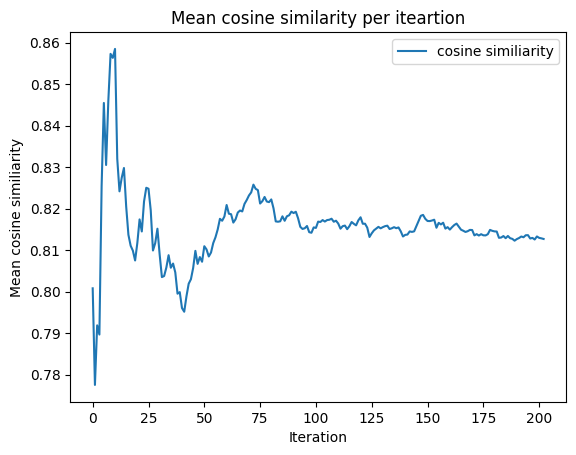

In [ ]:
if TEST_MODEL:
  plt.plot(mean_list, label='cosine similiarity')
  plt.ylabel('Mean cosine similiarity')
  plt.xlabel('Iteration')
  plt.title("Mean cosine similarity per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average cosine similarity is: {mean}')

The average cosine similarity is: 0.8126945818586303


###BERTScore

In [ ]:
# Initialize the BERTScorer object
if TEST_MODEL:
  scorer = BERTScorer(lang='en')

tokenizer_config.json:   0%|          | 0.00/25.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/482 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.42G [00:00<?, ?B/s]

Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
if TEST_MODEL:
  sum = [0, 0, 0]
  n_try = 0
  mean_score_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]

    generated_answer = generate_answer(question)
    if (generated_answer) is not None and (real_answer) is not None:
      P, R, F1 = scorer.score([generated_answer], [real_answer])
      score = [float(P), float(R), float(F1)]
      if i == 0:
        mean_score = score
      sum = [x + y for x, y in zip(sum, score)]
      n_try += 1
      old_mean = mean_score
      mean_score = [(x / n_try) for x in sum]
      mean_score_list.append(mean_score)

      if abs(mean_score[0] - old_mean[0]) < 0.001 and abs(mean_score[1] - old_mean[1]) < 0.001 and abs(mean_score[2] - old_mean[2]) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean_score} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: [0.9040531516075134, 0.8736532926559448, 0.888593316078186] 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: [0.887649804353714, 0.8591588735580444, 0.8731714189052582] 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: [0.8698064684867859, 0.865139881769816, 0.8671379486719767] 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: [0.8799878805875778, 0.8954910039901733, 0.8871073126792908] 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: [0.8882554173469543, 0.9135587573051452, 0.9001832246780396] 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: [0.8919541537761688, 0.923859695593516, 0.9071174760659536] 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: [0.8912563238825116, 0.9117800423077175, 0.9007471033505031] 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: [0.892847940325737, 0.9168872609734535, 0.9041132405400276] 
Last relevant mean c

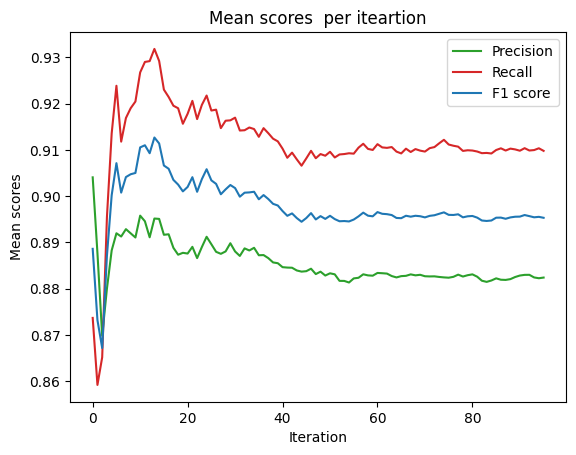

In [ ]:
if TEST_MODEL:
  plt.plot([score[0] for score in mean_score_list], color='#2ca02c',label='Precision')
  plt.plot([score[1] for score in mean_score_list], color='#d62728',label='Recall')
  plt.plot([score[2] for score in mean_score_list],label='F1 score')

  plt.ylabel('Mean scores')
  plt.xlabel('Iteration')
  plt.title("Mean scores  per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print("Precision: ", mean_score[0])
  print("Recall: ", mean_score[1])
  print("F1 score: ", mean_score[2])

Precision:  0.8823779771725336
Recall:  0.9097784825911125
F1 score:  0.895304104934136


###Execution time

In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_time_list = []
  patience = 20
  k = 0
  for i in tqdm(range(200)):
    question = test_dataset[i]["input"]

    start = time.time()
    generated_answer = generate_answer(question)
    end = time.time()

    score_time = end-start
    if i == 0:
      mean_time = score_time
    sum += score_time
    n_try += 1
    old_mean_time = mean_time
    mean_time = sum/n_try
    mean_time_list.append(mean_time)

100%|██████████| 200/200 [12:42<00:00,  3.81s/it]


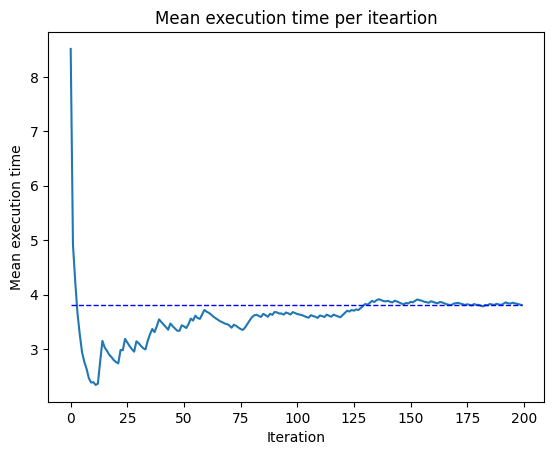

In [ ]:
if TEST_MODEL:
  plt.plot(mean_time_list)
  plt.plot([mean_time for i in mean_time_list], '--', color='blue', label='Mean', linewidth=1)
  plt.ylabel('Mean execution time')
  plt.xlabel('Iteration')
  plt.title("Mean execution time per iteartion")
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average execution time is: {mean_time}')

The average execution time is: 3.808987195491791


## Saving
To save the final model as LoRA adapters, either use Huggingface's `push_to_hub` for an online save or `save_pretrained` for a local save.


In [ ]:
if not USE_PRETRAINED:
  model.save_pretrained("lora_model") # Local saving
  tokenizer.save_pretrained("lora_model")

loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--unsloth--llama-3-8b-bnb-4bit/snapshots/0185ed6b320080320ebf712ad98fc3e1170b7f3f/config.json
Model config LlamaConfig {
  "_name_or_path": "meta-llama/Meta-Llama-3-8B",
  "architectures": [
    "LlamaForCausalLM"
  ],
  "attention_bias": false,
  "attention_dropout": 0.0,
  "bos_token_id": 128000,
  "eos_token_id": 128001,
  "hidden_act": "silu",
  "hidden_size": 4096,
  "initializer_range": 0.02,
  "intermediate_size": 14336,
  "max_position_embeddings": 8192,
  "mlp_bias": false,
  "model_type": "llama",
  "num_attention_heads": 32,
  "num_hidden_layers": 32,
  "num_key_value_heads": 8,
  "pretraining_tp": 1,
  "quantization_config": {
    "_load_in_4bit": true,
    "_load_in_8bit": false,
    "bnb_4bit_compute_dtype": "bfloat16",
    "bnb_4bit_quant_storage": "uint8",
    "bnb_4bit_quant_type": "nf4",
    "bnb_4bit_use_double_quant": true,
    "llm_int8_enable_fp32_cpu_offload": false,
    "llm_

##GGUF / llama.cpp Conversion
Use `save_pretrained_gguf` for local saving and `push_to_hub_gguf` for uploading to HF.

Some supported quant methods:
* `q8_0` - Fast conversion. High resource use, but generally acceptable.
* `q4_k_m` - Recommended. Uses Q6_K for half of the attention.wv and feed_forward.w2 tensors, else Q4_K.
* `q5_k_m` - Recommended. Uses Q6_K for half of the attention.wv and feed_forward.w2 tensors, else Q5_K.

In [ ]:
if EXPORT_MODEL:
  # Save to 8bit Q8_0
  if False: model.save_pretrained_gguf("model", tokenizer,)
  if False: model.push_to_hub_gguf("hf/model", tokenizer, token = "")

  # Save to 16bit GGUF
  if False: model.save_pretrained_gguf("model", tokenizer, quantization_method = "f16")
  if False: model.push_to_hub_gguf("hf/model", tokenizer, quantization_method = "f16", token = "")

  # Save to q4_k_m GGUF
  if False: model.save_pretrained_gguf("model", tokenizer, quantization_method = "q4_k_m")
  if False: model.push_to_hub_gguf("hf/model", tokenizer, quantization_method = "q4_k_m", token = "")

#[Tiny Llama](https://arxiv.org/pdf/2401.02385)

TinyLlama, an open-source small language model developed by Peiyuan Zhang, Guangtao Zeng, Tianduo Wang, and Wei Lu, distinguishes itself from its larger counterpart, Llama, by operating with reduced computational demands.

Despite having 1.1 billion parameters, this figure is modest compared to other LLMs with hundreds of billions or even trillions of parameters.


##Configurations and imports

Let's import everything we need for the execution!

**Remember to set the flags in the right way to execute everything you need**

In [ ]:
USE_PRETRAINED = True       # Set to False if you want to fine-tune the model and save it, otherwise it will be loaded the previous fine-tuned LoRA model
EXPORT_MODEL = False        # Set to True if you want to export the GGUF model
DOWNLOAD_BIOSENT = False    # Set to True if you want to download the biosentvec dataset to test the model
TEST_MODEL = True           # Set to True if you want to test the model
DOWNLOAD_DATASET = False    # Set to True if you want to download the huggingface dataset and re-split it (note that by doing it you will have a different split of the train-test)

In [ ]:
MODEL_PATH = '/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/Tiny llama'
DATAS_PATH = '/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/Datasets'
model_name = "unsloth/tinyllama-bnb-4bit"

In [ ]:
%%capture
# Installs Unsloth, Xformers (Flash Attention) and all other packages!
!pip install "unsloth[colab-new] @ git+https://github.com/unslothai/unsloth.git"
!pip install --no-deps xformers trl peft accelerate bitsandbytes

In [ ]:
from google.colab import drive

from unsloth import FastLanguageModel
from unsloth import is_bfloat16_supported

import torch

from datasets import load_dataset
from datasets import Dataset

from trl import SFTTrainer

from transformers import TrainingArguments
from transformers.utils import logging

from nltk import word_tokenize
from nltk.corpus import stopwords
import nltk

from string import punctuation

from scipy.spatial import distance

from tqdm import tqdm

import numpy as np

import pandas as pd

import sys
import time
import os

import matplotlib.pyplot as plt

🦥 Unsloth: Will patch your computer to enable 2x faster free finetuning.


In [ ]:
if TEST_MODEL:
  !pip install bert-score
  from bert_score import BERTScorer

  !git clone https://github.com/epfml/sent2vec.git
  %cd sent2vec
  !make
  !pip install .
  import sent2vec

  sys.setrecursionlimit(4000)

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 61.1/61.1 kB 1.8 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64.whl (56.5 MB)
  Using cached nvidia_cusolver_cu12-11.4.5.107-py3-none-manylinux1_x86_64.whl (124.2 MB)
  Using cached nvidia_cusparse_cu12-12.1.0.106-py3-none-manylinux1_x86_64.whl (196.0 MB)
  Using cached nvidia_nccl_cu12-2.20.5-py3-none-manylinux2014_x86_64.whl (176.2 MB)
  Using cached nvidia_nvtx_cu12-12.1.105-py3-none-man

In [ ]:
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
if DOWNLOAD_BIOSENT:
  os.chdir(f'{DATAS_PATH}')
  os.getcwd()
  !wget https://ftp.ncbi.nlm.nih.gov/pub/lu/Suppl/BioSentVec/BioSentVec_PubMed_MIMICIII-bigram_d700.bin

In [ ]:
os.chdir(f'{MODEL_PATH}')
os.getcwd()

'/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/Tiny llama'

In [ ]:
nltk.download('stopwords')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.


True

## Model definition

To accelerate the fine-tuning process of our model, we opted for a lightweight tool developed by the community: [Unsloth](https://github.com/unslothai/unsloth).

Unsloth works by overwriting some parts of the modeling code with optimized operations. By manually deriving backpropagation steps and rewriting all Pytorch modules into Triton kernels, Unsloth can both reduce memory usage and make fine-tuning faster.

Crucially, **accuracy degradation is 0%** with respect to normal QLoRA, because no approximations are made in the optimized code.

In [ ]:
max_seq_length = 4096   # We use RoPE Scaling to extend it to 4096 with Unsloth!
dtype = None            # None for auto detection. Float16 for Tesla T4, V100, Bfloat16 for Ampere+
load_in_4bit = True     # Use 4bit quantization to reduce memory usage. Can be False.

In [ ]:
if USE_PRETRAINED:
    #@title Loading finetuned models
    model, tokenizer = FastLanguageModel.from_pretrained(
        model_name = "lora_model", # YOUR MODEL YOU USED FOR TRAINING
        max_seq_length = max_seq_length,
        dtype = dtype,
        load_in_4bit = load_in_4bit,
    )
    FastLanguageModel.for_inference(model) # Enable native 2x faster inference

config.json:   0%|          | 0.00/1.09k [00:00<?, ?B/s]

==((====))==  Unsloth: Fast Llama patching release 2024.5
   \\   /|    GPU: Tesla T4. Max memory: 14.748 GB. Platform = Linux.
O^O/ \_/ \    Pytorch: 2.3.0+cu121. CUDA = 7.5. CUDA Toolkit = 12.1.
\        /    Bfloat16 = FALSE. Xformers = 0.0.26.post1. FA = False.
 "-____-"     Free Apache license: http://github.com/unslothai/unsloth


Unsloth: unsloth/tinyllama-bnb-4bit can only handle sequence lengths of at most 2048.
But with kaiokendev's RoPE scaling of 2.0, it can be magically be extended to 4096!


model.safetensors:   0%|          | 0.00/762M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/129 [00:00<?, ?B/s]

You are using the default legacy behaviour of the <class 'transformers.models.llama.tokenization_llama_fast.LlamaTokenizerFast'>. This is expected, and simply means that the `legacy` (previous) behavior will be used so nothing changes for you. If you want to use the new behaviour, set `legacy=False`. This should only be set if you understand what it means, and thoroughly read the reason why this was added as explained in https://github.com/huggingface/transformers/pull/24565
Unsloth 2024.5 patched 22 layers with 22 QKV layers, 22 O layers and 22 MLP layers.


In [ ]:
if not USE_PRETRAINED:
  model, tokenizer = FastLanguageModel.from_pretrained(
    model_name = model_name,
    max_seq_length = max_seq_length,
    dtype = dtype,
    load_in_4bit = load_in_4bit,
  )


To speedup the tuning even more and decrease the needed computational power we used [LoRA](https://arxiv.org/abs/2106.09685). LoRA is a novel technique introduced by Microsoft researchers to deal with the problem of fine-tuning large-language models.

LoRA proposes freezing pre-trained model weights, which reduces the number of trainable parameters and GPU memory requirements.

In [ ]:
if not USE_PRETRAINED:
  model = FastLanguageModel.get_peft_model(
      model,
      r = 32,    #16 in previous implementation                    # Choose any number > 0 ! Suggested 8, 16, 32, 64, 128
      target_modules = ["q_proj", "k_proj", "v_proj", "o_proj",
                        "gate_proj", "up_proj", "down_proj",],
      lora_alpha = 32, #16 in previous implementation
      lora_dropout = 0,                                            # Currently only supports dropout = 0
      bias = "none",                                               # Currently only supports bias = "none"
      use_gradient_checkpointing = "unsloth",                          # We set `gradient_checkpointing=False` ONLY for TinyLlama since Unsloth saves tonnes of memory usage. @@@ IF YOU GET OUT OF MEMORY - set to True @@@
      random_state = 3407,
      use_rslora = False,                                          # We support rank stabilized LoRA
      loftq_config = None,                                         # And LoftQ
  )

Now, let's define the prompt used for tuning our model and create the function to map our data to this prompt.

In [ ]:
alpaca_prompt = """Below is an instruction that describes a task, paired with an input that provides further context. Write a response that appropriately completes the request.

### Instruction:
{}

### Input:
{}

### Response:
{}"""

EOS_TOKEN = tokenizer.eos_token
def formatting_prompts_func(examples):
    instructions = examples["instruction"]
    inputs       = examples["input"]
    outputs      = examples["output"]
    texts = []
    for instruction, input, output in zip(instructions, inputs, outputs):
        # Must add EOS_TOKEN, otherwise your generation will go on forever!
        text = alpaca_prompt.format(instruction, input, output) + EOS_TOKEN
        texts.append(text)
    return { "text" : texts, }
pass



## Dataset import
To maintain the integrity of model testing, we pre-saved the dataset split in a dataframe. This ensures that during testing, no training samples are utilized, thereby preserving the model evaluation process.

In [ ]:
if DOWNLOAD_DATASET:
  dataset_path = "medalpaca/medical_meadow_medical_flashcards"
  raw_dataset = load_dataset(dataset_path)
  dataset = raw_dataset["train"].train_test_split(test_size=0.2)
  train_dataset = dataset["train"]
  test_dataset = dataset["test"]
  if False:
    df_train = dataset["train"].to_pandas()
    df_test = dataset["test"].to_pandas()
    os.chdir(f'{DATAS_PATH}')
    os.getcwd()
    df_train.to_csv("train_split.csv", index=False)
    df_test.to_csv("test_split.csv", index=False)
    os.chdir(f'{MODEL_PATH}')
    os.getcwd()
else:
  os.chdir(f'{DATAS_PATH}')
  os.getcwd()
  test_dataset = Dataset.from_pandas(pd.read_csv('test_split.csv'))
  train_dataset = Dataset.from_pandas(pd.read_csv('train_split.csv'))
  os.chdir(f'{MODEL_PATH}')
  os.getcwd()

train_dataset = train_dataset.map(formatting_prompts_func, batched = True)
test_dataset = test_dataset.map(formatting_prompts_func, batched = True)

Map:   0%|          | 0/27164 [00:00<?, ? examples/s]

Map:   0%|          | 0/6791 [00:00<?, ? examples/s]

## Tuning the model
Now let's use Huggingface TRL's `SFTTrainer`!

In [ ]:
if not USE_PRETRAINED:
  logging.set_verbosity_info()

  training_args = TrainingArguments(
      per_device_train_batch_size = 8,
      gradient_accumulation_steps = 4,
      warmup_ratio = 0.1,
      num_train_epochs = 3,
      save_steps = 100,
      learning_rate = 2e-4,
      fp16 = not is_bfloat16_supported(),
      bf16 = is_bfloat16_supported(),
      #fp16 = not torch.cuda.is_bf16_supported(),
      #bf16 = torch.cuda.is_bf16_supported(),
      logging_steps = 1,
      optim = "adamw_8bit",
      weight_decay = 0.01,
      lr_scheduler_type = "linear",
      seed = 3407,
      output_dir = "outputs",
      overwrite_output_dir = True
  )

  trainer = SFTTrainer(
      model = model,
      tokenizer = tokenizer,
      train_dataset = train_dataset,
      dataset_text_field = "text",
      max_seq_length = max_seq_length,
      dataset_num_proc = 2,
      packing = False, # Packs short sequences together to save time!
      args = training_args,
  )

In [ ]:
if not USE_PRETRAINED:
  #@title Show current memory stats
  gpu_stats = torch.cuda.get_device_properties(0)
  start_gpu_memory = round(torch.cuda.max_memory_reserved() / 1024 / 1024 / 1024, 3)
  max_memory = round(gpu_stats.total_memory / 1024 / 1024 / 1024, 3)
  print(f"GPU = {gpu_stats.name}. Max memory = {max_memory} GB.")
  print(f"{start_gpu_memory} GB of memory reserved.")

In [ ]:
if not USE_PRETRAINED:
  if len(os.listdir("outputs")) <= 1:
    trainer_stats = trainer.train()
  else:
    trainer_stats = trainer.train(resume_from_checkpoint=True)

In [ ]:
if not USE_PRETRAINED:
  #@title Show final memory and time stats
  used_memory = round(torch.cuda.max_memory_reserved() / 1024 / 1024 / 1024, 3)
  used_memory_for_lora = round(used_memory - start_gpu_memory, 3)
  used_percentage = round(used_memory         /max_memory*100, 3)
  lora_percentage = round(used_memory_for_lora/max_memory*100, 3)
  print(f"{trainer_stats.metrics['train_runtime']} seconds used for training.")
  print(f"{round(trainer_stats.metrics['train_runtime']/60, 2)} minutes used for training.")
  print(f"Peak reserved memory = {used_memory} GB.")
  print(f"Peak reserved memory for training = {used_memory_for_lora} GB.")
  print(f"Peak reserved memory % of max memory = {used_percentage} %.")
  print(f"Peak reserved memory for training % of max memory = {lora_percentage} %.")

##Functions
Some useful functions!

The preprocess_sentence function is utilized to eliminate punctuation and stopwords from the input text.

In [ ]:
stop_words = set(stopwords.words('english'))
def preprocess_sentence(text):
    text = text.replace('/', ' / ')
    text = text.replace('.-', ' .- ')
    text = text.replace('.', ' . ')
    text = text.replace('\'', ' \' ')
    text = text.lower()

    tokens = [token for token in word_tokenize(text) if token not in punctuation and token not in stop_words]

    return ' '.join(tokens)

The generate_answer function utilizes the input model to generate a response to the provided question.

In [ ]:
def generate_answer(question):
  # alpaca_prompt = Copied from above
  FastLanguageModel.for_inference(model) # Enable native 2x faster inference
  inputs = tokenizer(
  [
      alpaca_prompt.format(
          "Answer this question truthfully", # instruction
          question, # input
          "", # output - leave this blank for generation!
      )
  ], return_tensors = "pt").to("cuda")

  outputs = model.generate(**inputs, max_new_tokens = 128, use_cache = True)
  tokenizer.batch_decode(outputs)
  predicted_answer = tokenizer.batch_decode(outputs[:, inputs['input_ids'].shape[1]:])[0]
  predicted_answer = predicted_answer[:(len(predicted_answer)-5)]
  return predicted_answer

## Inference
Let's run the model! You can change the instruction and input - leave the output blank!

 We can also use a `TextStreamer` for continuous inference - so you can see the generation token by token, instead of waiting the whole time!

In [ ]:
# alpaca_prompt = Copied from above
FastLanguageModel.for_inference(model) # Enable native 2x faster inference
inputs = tokenizer(
[
    alpaca_prompt.format(
        "Answer this question truthfully", # instruction
        "What is the PAP test?", # input
        "", # output - leave this blank for generation!
    )
], return_tensors = "pt").to("cuda")

from transformers import TextStreamer
text_streamer = TextStreamer(tokenizer)
_ = model.generate(**inputs, streamer = text_streamer, max_new_tokens = 128)

<s> Below is an instruction that describes a task, paired with an input that provides further context. Write a response that appropriately completes the request.

### Instruction:
Answer this question truthfully

### Input:
What is the PAP test?

### Response:
The PAP test is a diagnostic test used to detect the presence of pneumonia in patients with cystic fibrosis.</s>


##Testing

To evaluate the model is essential to establish metrics that evaluate the accuracy of a generated answer relative to the correct one. In our context, we have identified two key metrics: **BERTScore** and **Evaluation with Embedding**

We chose these metrics over more statistical ones because both BERTScores and embeddings take into account the contextual meaning of sentences when assessing their similarity, making them excellent choices for evaluating our models.

To expedite the evaluation process, a stopping criterion has been used. If, in the last 20 iterations of the for loop calculating the mean score, the mean does not change significantly, the execution stops, and the score is printed.

Additionally, the model has been evaluated for execution time in answering questions.

In [ ]:
index = 300
#@title Manual testing
real_answer = test_dataset[index]["output"]
generated_answer = generate_answer(test_dataset[index]["input"])
question = test_dataset[index]["input"]

print("Question: ", question)
print("Generated answer: ", generated_answer)
print("Real answer: ", real_answer)

Question:  What does it mean if the relative risk is less than 1 in relation to exposure and disease occurrence?
Generated answer:  If the relative risk is less than 1 in relation to exposure and disease occurrence, it means that there is a significant difference between the risk of disease occurrence and the risk of exposure to the disease
Real answer:  If the relative risk is less than 1, it means that exposure to a particular factor or variable is associated with a decreased occurrence of the disease in question. In other words, individuals who are exposed to the factor or variable are less likely to develop the disease than those who are not exposed. The relative risk is a measure of the strength of the association between exposure and disease occurrence, and a value less than 1 indicates a negative association.


###BioSentVec loading...

In [ ]:
if TEST_MODEL:
  model_path = f'{DATAS_PATH}/BioSentVec_PubMed_MIMICIII-bigram_d700.bin'
  testing_model = sent2vec.Sent2vecModel()

In [ ]:
if TEST_MODEL:
  def evaluate_answer(real, predicted):
    sentence_vector1 = testing_model.embed_sentence(preprocess_sentence(real))
    sentence_vector2 = testing_model.embed_sentence(preprocess_sentence(predicted))
    cosine_sim = 1 - distance.cosine(sentence_vector1[0], sentence_vector2[0])
    return cosine_sim

In [ ]:
if TEST_MODEL:
  try:
      testing_model.load_model(model_path)
  except Exception as e:
      print(e)
  print('model successfully loaded')

model successfully loaded


###BioSentVec score

In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]
    generated_answer = generate_answer(question)
    if (generated_answer) is not None and (real_answer) is not None:
      score = evaluate_answer(real_answer, generated_answer)
      if i == 0:
        mean = score
      sum += score
      n_try += 1
      old_mean = mean
      mean = sum/n_try
      mean_list.append(mean)

      if abs(mean - old_mean) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: 0.6392995715141296 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: 0.7622046768665314 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: 0.7565935651461283 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: 0.8142030537128448 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: 0.8441580057144165 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: 0.8612397114435831 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: 0.8373740996633258 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: 0.852329708635807 
Last relevant mean change is 0 iteration ago


Iteration: 8, Mean: 0.868737518787384 
Last relevant mean change is 0 iteration ago


Iteration: 9, Mean: 0.863528949022293 
Last relevant mean change is 0 iteration ago


Iteration: 10, Mean: 0.8643241849812594 
Last relevant mean change is 1 iteration ago


Iteration: 11, Mean: 0.8401952485243479 
Last

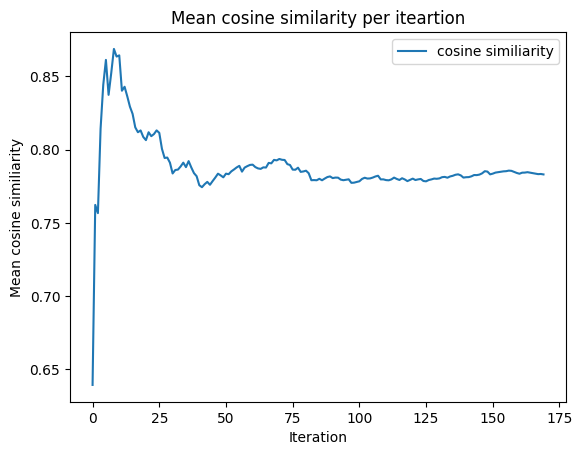

In [ ]:
if TEST_MODEL:
  plt.plot(mean_list, label='cosine similiarity')
  plt.ylabel('Mean cosine similiarity')
  plt.xlabel('Iteration')
  plt.title("Mean cosine similarity per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'the average cosine similarity is: {mean}')

the average cosine similarity is: 0.7830379782354131


###BERTScore

In [ ]:
# Initialize the BERTScorer object
if TEST_MODEL:
  scorer = BERTScorer(lang='en')

tokenizer_config.json:   0%|          | 0.00/25.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/482 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.42G [00:00<?, ?B/s]

Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
if TEST_MODEL:
  sum = [0, 0, 0]
  n_try = 0
  mean_score_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]

    generated_answer = generate_answer(question)
    if (generated_answer) is not None and (real_answer) is not None:
      P, R, F1 = scorer.score([generated_answer], [real_answer])
      score = [float(P), float(R), float(F1)]
      if i == 0:
        mean_score = score
      sum = [x + y for x, y in zip(sum, score)]
      n_try += 1
      old_mean = mean_score
      mean_score = [(x / n_try) for x in sum]
      mean_score_list.append(mean_score)

      if abs(mean_score[0] - old_mean[0]) < 0.001 and abs(mean_score[1] - old_mean[1]) < 0.001 and abs(mean_score[2] - old_mean[2]) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean_score} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: [0.8928676247596741, 0.8216316103935242, 0.855769693851471] 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: [0.9125876128673553, 0.8656459152698517, 0.8883071839809418] 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: [0.8905721505482992, 0.8618041674296061, 0.8756428162256876] 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: [0.9146097302436829, 0.8900710195302963, 0.901922419667244] 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: [0.9295998334884643, 0.9096210360527038, 0.9192759156227112] 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: [0.9386492967605591, 0.9204460680484772, 0.9292652110258738] 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: [0.9346323013305664, 0.9073369758469718, 0.9204673937388829] 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: [0.9408787786960602, 0.9158875793218613, 0.9279280826449394] 
Last relevant mea

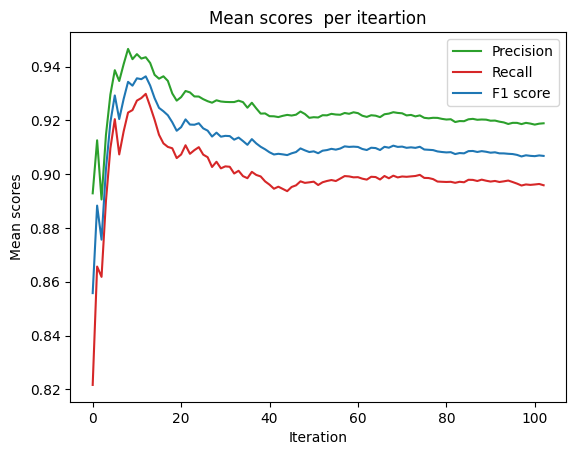

In [ ]:
if TEST_MODEL:
  plt.plot([mean_score[0] for score in mean_score_list], color='#2ca02c',label='Precision')
  plt.plot([mean_score[1] for score in mean_score_list], color='#d62728',label='Recall')
  plt.plot([mean_score[2] for score in mean_score_list],label='F1 score')

  plt.ylabel('Mean scores')
  plt.xlabel('Iteration')
  plt.title("Mean scores  per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print("Precision: ", mean_score[0])
  print("Recall: ", mean_score[1])
  print("F1 score: ", mean_score[2])

Precision:  0.9189088824883248
Recall:  0.8958726565814713
F1 score:  0.9067789634454597


###Execution time

In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_time_list = []
  patience = 20
  k = 0
  for i in tqdm(range(200)):
    question = test_dataset[i]["input"]

    start = time.time()
    generated_answer = generate_answer(question)
    end = time.time()

    score_time = end-start
    if i == 0:
      mean_time = score_time
    sum += score_time
    n_try += 1
    old_mean_time = mean_time
    mean_time = sum/n_try
    mean_time_list.append(mean_time)

100%|██████████| 200/200 [08:07<00:00,  2.44s/it]


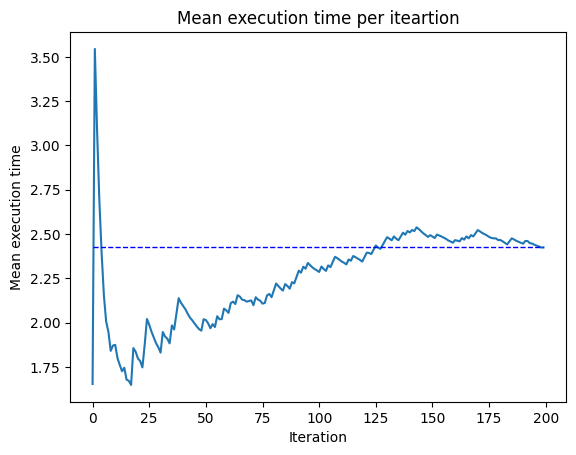

In [ ]:
if TEST_MODEL:
  plt.plot(mean_time_list)
  plt.plot([mean_time for i in mean_time_list], '--', color='blue', label='Mean', linewidth=1)
  plt.ylabel('Mean execution time')
  plt.xlabel('Iteration')
  plt.title("Mean execution time per iteartion")
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average execution time is: {mean_time}')

The average execution time is: 2.4346137964725494


## Saving
To save the final model as LoRA adapters, either use Huggingface's `push_to_hub` for an online save or `save_pretrained` for a local save.


In [ ]:
if not USE_PRETRAINED:
  model.save_pretrained("lora_model") # Local saving
  tokenizer.save_pretrained("lora_model")

loading configuration file config.json from cache at /root/.cache/huggingface/hub/models--unsloth--tinyllama-bnb-4bit/snapshots/82c9ac484c6a4191514431e172bf62c482e0a1b0/config.json
Model config LlamaConfig {
  "_name_or_path": "unsloth/tinyllama",
  "architectures": [
    "LlamaForCausalLM"
  ],
  "attention_bias": false,
  "attention_dropout": 0.0,
  "bos_token_id": 1,
  "eos_token_id": 2,
  "hidden_act": "silu",
  "hidden_size": 2048,
  "initializer_range": 0.02,
  "intermediate_size": 5632,
  "max_position_embeddings": 2048,
  "mlp_bias": false,
  "model_type": "llama",
  "num_attention_heads": 32,
  "num_hidden_layers": 22,
  "num_key_value_heads": 4,
  "pad_token_id": 0,
  "pretraining_tp": 1,
  "quantization_config": {
    "bnb_4bit_compute_dtype": "bfloat16",
    "bnb_4bit_quant_type": "nf4",
    "bnb_4bit_use_double_quant": true,
    "llm_int8_enable_fp32_cpu_offload": false,
    "llm_int8_has_fp16_weight": false,
    "llm_int8_skip_modules": null,
    "llm_int8_threshold": 6.0

##GGUF / llama.cpp Conversion
Use `save_pretrained_gguf` for local saving and `push_to_hub_gguf` for uploading to HF.

Some supported quant methods:
* `q8_0` - Fast conversion. High resource use, but generally acceptable.
* `q4_k_m` - Recommended. Uses Q6_K for half of the attention.wv and feed_forward.w2 tensors, else Q4_K.
* `q5_k_m` - Recommended. Uses Q6_K for half of the attention.wv and feed_forward.w2 tensors, else Q5_K.

In [ ]:
if EXPORT_MODEL:
  # Save to 8bit Q8_0
  if False: model.save_pretrained_gguf("model", tokenizer,)
  if False: model.push_to_hub_gguf("hf/model", tokenizer, token = "")

  # Save to 16bit GGUF
  if False: model.save_pretrained_gguf("model", tokenizer, quantization_method = "f16")
  if False: model.push_to_hub_gguf("hf/model", tokenizer, quantization_method = "f16", token = "")

  # Save to q4_k_m GGUF
  if False: model.save_pretrained_gguf("model", tokenizer, quantization_method = "q4_k_m")
  if False: model.push_to_hub_gguf("hf/model", tokenizer, quantization_method = "q4_k_m", token = "")

# GPT2 fine tuning for medical questions

In the notebook **GPT2-medium** is fine tuned to answer to some medical questions.
The GPT2-medium version was used with 345 million parameters. It differs from other since it is based on the Transformer architecture, specifically the decoder-only version and is a general purpose model and can handle different language tasks across different domains.

During training phase a marker [Q] is concatenated to the question and a marker [A] to its answer.

At inference time at the beginning of the question the marker [Q] must me added.

The model can answer to a wide variety of questions related to medical topics it was treined on.

In [ ]:
TRAIN_MODEL = False
DOWNLOAD_DATASET = False    # Set to True if you want to download the huggingface dataset and re-split it (note that by doing it you will have a different split of the train-test)

##Configurations and imports

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

import os

path = 'Colab Notebooks/NLP_project'

os.chdir(f'/content/drive/MyDrive/{path}')
os.getcwd()

Mounted at /content/drive


'/content/drive/MyDrive/Colab Notebooks/NLP_project'

In [ ]:
!pip install datasets
!pip install -U sentence-transformers

!pip install transformers torch tensorflow pandas numpy
!pip3 install accelerate -U
!pip install bert-score

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 542.0/542.0 kB 11.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 12.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 20.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 11.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 171.5/171.5 kB 3.8 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x8

In [ ]:
from datasets import load_dataset
from datasets import load_from_disk
from transformers import TextDataset, DataCollatorForLanguageModeling
from transformers import GPT2Tokenizer, GPT2LMHeadModel
from transformers import Trainer, TrainingArguments
from transformers import PreTrainedTokenizerFast, GPT2LMHeadModel, GPT2TokenizerFast, GPT2Tokenizer

from transformers import BertTokenizer, BertModel
from bert_score import BERTScorer
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

## Dataset import

In [ ]:
if DOWNLOAD_DATASET:
  raw_dataset =  load_dataset("medalpaca/medical_meadow_medical_flashcards", download_mode="force_redownload")
  dataset = raw_dataset["train"].train_test_split(test_size=0.08)
  train_validation_split = dataset["train"].train_test_split(test_size=0.08)
  dataset["train"] = train_validation_split["train"]
  dataset["validation"] = train_validation_split["test"]
  dataset
else:
  dataset = load_from_disk("dataset_gpt_2")

In [ ]:
dataset

DatasetDict({
    train: Dataset({
        features: ['input', 'output', 'instruction'],
        num_rows: 28738
    })
    test: Dataset({
        features: ['input', 'output', 'instruction'],
        num_rows: 2717
    })
    validation: Dataset({
        features: ['input', 'output', 'instruction'],
        num_rows: 2500
    })
})

In [ ]:
#data are saved in order not to mix test and training
if DOWNLOAD_DATASET:
  dataset.save_to_disk("dataset_gpt_2")

Saving the dataset (0/1 shards):   0%|          | 0/28738 [00:00<?, ? examples/s]

Saving the dataset (0/1 shards):   0%|          | 0/2717 [00:00<?, ? examples/s]

Saving the dataset (0/1 shards):   0%|          | 0/2500 [00:00<?, ? examples/s]

In [ ]:
dataset = dataset.filter(lambda example: example["input"] != "")

## Train the model

In [ ]:
if TRAIN_MODEL:
  # Extract input and output columns
  inputs = dataset["train"]["input"]
  outputs = dataset["train"]["output"]

  # Concatenate input-output pairs

  def get_concat_text(inputs, outputs):
    concatenated_text = ""
    for input_text, output_text in zip(inputs, outputs):
        concatenated_text += f"[Q] {input_text}\n[A] {output_text}\n "
    return re.sub(r'\n+', '\n', concatenated_text).strip()  # Remove excess newline characters

  # Print concatenated text
  text_train = get_concat_text(inputs, outputs)

  with open("train.txt", "w") as f:
      f.write(text_train)

  # validation set
  inputs = dataset["validation"]["input"]
  outputs = dataset["validation"]["output"]

  text_val = get_concat_text(inputs, outputs)

  with open("valid.txt", "w") as f:
      f.write(text_val)

In [ ]:
def load_dataset(file_path, tokenizer, block_size = 128):
    dataset = TextDataset(
        tokenizer = tokenizer,
        file_path = file_path,
        block_size = block_size,
    )
    return dataset

def load_data_collator(tokenizer, mlm = False):
    data_collator = DataCollatorForLanguageModeling(
        tokenizer=tokenizer,
        mlm=mlm,
    )
    return data_collator

In [ ]:
def train(train_file_path,
          eval_file_path,
          model_name,
          output_dir,
          overwrite_output_dir,
          per_device_train_batch_size,
          num_train_epochs,
          save_steps):
  tokenizer = GPT2Tokenizer.from_pretrained(model_name)
  data_collator = load_data_collator(tokenizer)

  train_dataset = load_dataset(train_file_path, tokenizer)
  eval_dataset = load_dataset(eval_file_path, tokenizer)


  tokenizer.save_pretrained(output_dir)

  model = GPT2LMHeadModel.from_pretrained(model_name)

  model.save_pretrained(output_dir)

  training_args = TrainingArguments(
          output_dir=output_dir,
          overwrite_output_dir=overwrite_output_dir,
          per_device_train_batch_size=per_device_train_batch_size,
          num_train_epochs=num_train_epochs,
          eval_steps=500,
          eval_strategy="steps",
          load_best_model_at_end=True,
          save_steps=save_steps
      )

  trainer = Trainer(
          model=model,
          args=training_args,
          data_collator=data_collator,
          train_dataset=train_dataset,
          eval_dataset=eval_dataset
  )

  trainer.train()
  trainer.save_model()
  trainer.evaluate()

In [ ]:

train_file_path = "train.txt"
eval_file_path = "valid.txt"
model_name = 'gpt2-medium'
output_dir = 'medium-val-gpt2-custom_q_and_a'
overwrite_output_dir = False
per_device_train_batch_size = 8
num_train_epochs = 5.0
save_steps = 500

In [ ]:
# Train
if TRAIN_MODEL:
  train(
      train_file_path=train_file_path,
      eval_file_path=eval_file_path,
      model_name=model_name,
      output_dir=output_dir,
      overwrite_output_dir=overwrite_output_dir,
      per_device_train_batch_size=per_device_train_batch_size,
      num_train_epochs=num_train_epochs,
      save_steps=save_steps
  )

/usr/local/lib/python3.10/dist-packages/transformers/data/datasets/language_modeling.py:53: FutureWarning: This dataset will be removed from the library soon, preprocessing should be handled with the 🤗 Datasets library. You can have a look at this example script for pointers: https://github.com/huggingface/transformers/blob/main/examples/pytorch/language-modeling/run_mlm.py
  warnings.warn(


Step,Training Loss,Validation Loss


Step,Training Loss,Validation Loss
500,1.875200,1.712459
1000,1.743600,1.645185
1500,1.692400,1.597991
2000,1.647300,1.567185
2500,1.617500,1.536849
3000,1.509700,1.524900
3500,1.432900,1.507662
4000,1.419100,1.492048
4500,1.407300,1.478964
5000,1.400800,1.463799


There were missing keys in the checkpoint model loaded: ['lm_head.weight'].


##inference

We test our model extracting a random question-answer pair from the dataset and we test on two scores: BLEU and BertScore, it is possible to show that BLEU isn't a good metric for comparison since it doesn't take into consideration the semantic of the sentence

In [ ]:
def load_model(model_path):
    model = GPT2LMHeadModel.from_pretrained(model_path)
    return model


def load_tokenizer(tokenizer_path):
    tokenizer = GPT2Tokenizer.from_pretrained(tokenizer_path)
    return tokenizer

def generate_text(tokenizer, sequence, max_length):


    ids = tokenizer.encode(f'{sequence}', return_tensors='pt')
    final_outputs = model.generate(
        ids,
        do_sample=True,
        max_length=max_length,
        pad_token_id=model.config.eos_token_id,
        top_k=50,
        top_p=0.95,
    )

    return (tokenizer.decode(final_outputs[0], skip_special_tokens=True)).split("[Q]")[1].split("[A]")[1]

In [ ]:
#retrieve model and tokenizer
model_path = "medium-val-gpt2-custom_q_and_a"
model = load_model(model_path)
tokenizer = load_tokenizer(model_path)
tokenizer.padding_side ='left'

In [ ]:
import random

random_index = random.randint(0, len(dataset["test"])-1)

question = "[Q]" + dataset["test"][random_index]["input"]
max_len = 150

print(question)
generated_response = generate_text(tokenizer, question, max_len)
print("generated_response: " + generated_response)
print("true_response: " + dataset["test"][random_index]["output"])

[Q]What is hyaline arteriolosclerosis, and how does it contribute to the development of glomerular scarring?
generated_response:  Hyaline arteriolosclerosis is a type of arteriosclerosis that can contribute to the development of glomerular scarring through the deposition of basement membrane proteins called α2-antiarrhythmic proteins (α2ATIs), which are found on the walls of blood vessels. These proteins are produced by the cells lining blood vessels, and play an important role in regulating the flow of sodium and water in and out of the blood vessels. When the basement membrane proteins become clogged with these α2-ATIs, it can lead to narrowing of the blood vessels, which can increase
true_response: Hyaline arteriolosclerosis is a type of vascular pathology that results in the deposition of proteinaceous material within the walls of small arterioles. This can cause a reduction in vessel caliber, leading to decreased blood flow and end-organ ischemia. In the kidneys, hyaline arteriolo

Exection time

In [ ]:
import time
start = time.time()
generated_response = generate_text(tokenizer, question, max_len)
end = time.time()

print("exection time: "+ str(end - start))

exection time: 30.093859910964966


In [ ]:
#bleu score: not a good metric

from nltk.translate.bleu_score import sentence_bleu
right_response = dataset["test"][random_index]["output"]
bleu = sentence_bleu( [right_response.split()] , generated_response.split() )
print(f"BLEU: {bleu}")

BLEU: 0.03147085939618836


In [ ]:
scorer = BERTScorer(model_type='bert-base-uncased')
right_response = dataset["test"][random_index]["output"]
P, R, F1 = scorer.score([generated_response], [right_response])
print(f"BERTScore Precision: {P.mean():.4f}, Recall: {R.mean():.4f}, F1: {F1.mean():.4f}")

BERTScore Precision: 0.6251, Recall: 0.6903, F1: 0.6561


##Testing

In [ ]:

def load_tokenizer(tokenizer_path):
    tokenizer = GPT2Tokenizer.from_pretrained(tokenizer_path)
    return tokenizer

def load_model(model_path):
    model = GPT2LMHeadModel.from_pretrained(model_path)
    return model

def generate_text_parall(tokenizer, sequence, max_length):
    tokenizer.pad_token = tokenizer.eos_token

    ids = tokenizer(sequence, return_tensors='pt', padding=True ,truncation=True)

    final_outputs = model.generate(
        **ids,
        do_sample=True,
        max_length=max_length,
        pad_token_id=model.config.eos_token_id,
        top_k=50,
        top_p=0.95,
    )

    return [ tokenizer.decode(x, skip_special_tokens=True).split("[Q]")[1].split("[A]")[1] for x in final_outputs ]

In [ ]:
#retrieve model and tokenizer
model_path = "medium-val-gpt2-custom_q_and_a"
model = load_model(model_path)
tokenizer = load_tokenizer(model_path)
tokenizer.padding_side ='left'

scorer = BERTScorer(lang='en')

Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
max_len = 150
questions = ["[Q]" + x for x in dataset["test"]["input"]]

Inference from the model is performed in batch, test set is splitted into n_splits parts, this is done in order to avoid overloading RAM resources

In [ ]:
n_splits = 160
sections = np.linspace(0, len(questions), n_splits+1)
n_sections = 6

For visualization purpose show only 6 sections

In [ ]:
P = np.array([])
R = np.array([])
F1 = np.array([])

for i in range(n_sections):
  print(i)
  first_index = int(sections[i])
  second_index= int(sections[i+1])
  responses = generate_text_parall(tokenizer, questions[first_index : second_index], max_len)

  P_2, R_2, F1_2 = scorer.score(responses, dataset["test"]["output"][first_index : second_index])
  P = np.append(P, P_2)
  R = np.append(R, R_2)
  F1 = np.append(F1, F1_2)
  print(f"BERTScore Precision : {np.mean(P):.4f}, Recall: {np.mean(R):.4f}, F1: {np.mean(F1):.4f}  #samples: {int((len(questions)/n_splits)*(i+1))}")


0
BERTScore Precision : 0.8925, Recall: 0.8842, F1: 0.8877  #samples: 16
1
BERTScore Precision : 0.8900, Recall: 0.8860, F1: 0.8874  #samples: 33
2
BERTScore Precision : 0.8889, Recall: 0.8917, F1: 0.8897  #samples: 50
3
BERTScore Precision : 0.8887, Recall: 0.8880, F1: 0.8877  #samples: 67
4
BERTScore Precision : 0.8915, Recall: 0.8913, F1: 0.8908  #samples: 83
5
BERTScore Precision : 0.8916, Recall: 0.8897, F1: 0.8901  #samples: 100


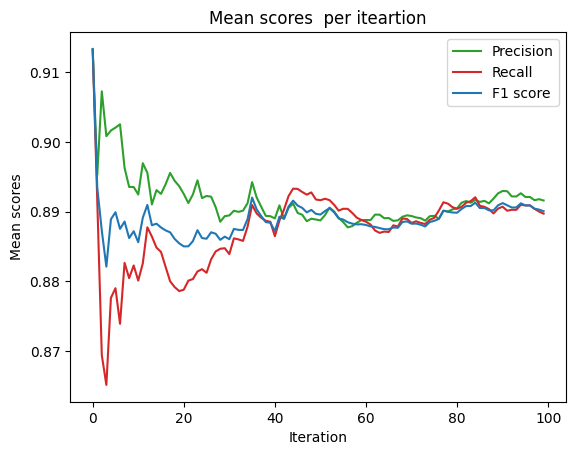

In [ ]:
def cum_mean(arr):
  cum_sum = np.cumsum(arr)
  return cum_sum/np.arange(1, len(arr) + 1)

plt.plot(cum_mean(P), color='#2ca02c',label='Precision')
plt.plot(cum_mean(R), color='#d62728',label='Recall')
plt.plot(cum_mean(F1),label='F1 score')

plt.ylabel('Mean scores')
plt.xlabel('Iteration')
plt.title("Mean scores  per iteartion")
plt.legend()
plt.show()

##comparison with GPT2 without fine-tuning

In [ ]:
#retrieve model and tokenizer
model_path = "gpt2-medium"
model = load_model(model_path)
tokenizer = load_tokenizer(model_path)
tokenizer.padding_side ='left'

scorer = BERTScorer(lang='en')

config.json:   0%|          | 0.00/718 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.52G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/124 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.04M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

In [ ]:
def generate_text_parall_raw(tokenizer, sequence, max_length):
    tokenizer.pad_token = tokenizer.eos_token

    ids = tokenizer(sequence, return_tensors='pt', padding=True ,truncation=True)

    final_outputs = model.generate(
        **ids,
        do_sample=True,
        max_length=max_length,
        pad_token_id=model.config.eos_token_id,
        top_k=50,
        top_p=0.95,
    )

    return [ tokenizer.decode(x, skip_special_tokens=True) for x in final_outputs ]

In [ ]:
P = np.array([])
R = np.array([])
F1 = np.array([])
merged_true_answers = [questions[i] + dataset["test"]["output"][i] for i in range(len(questions))]

n_sections = 6

for i in range(n_sections):
  print(i)
  first_index = int(sections[i])
  second_index= int(sections[i+1])
  responses = generate_text_parall_raw(tokenizer, questions[first_index : second_index], max_len)

  P_2, R_2, F1_2 = scorer.score(responses, merged_true_answers[first_index : second_index])
  P = np.append(P, P_2)
  R = np.append(R, R_2)
  F1 = np.append(F1, F1_2)
  print(f"BERTScore Precision : {np.mean(P):.4f}, Recall: {np.mean(R):.4f}, F1: {np.mean(F1):.4f}  #samples: {int((len(questions)/n_splits)*(i+1))}")

0
BERTScore Precision : 0.5996, Recall: 0.6922, F1: 0.6366  #samples: 16
1
BERTScore Precision : 0.6026, Recall: 0.6956, F1: 0.6385  #samples: 33
2
BERTScore Precision : 0.5966, Recall: 0.7251, F1: 0.6474  #samples: 50
3
BERTScore Precision : 0.5931, Recall: 0.7136, F1: 0.6400  #samples: 67
4
BERTScore Precision : 0.5935, Recall: 0.7184, F1: 0.6424  #samples: 84
5
BERTScore Precision : 0.5905, Recall: 0.7133, F1: 0.6389  #samples: 101


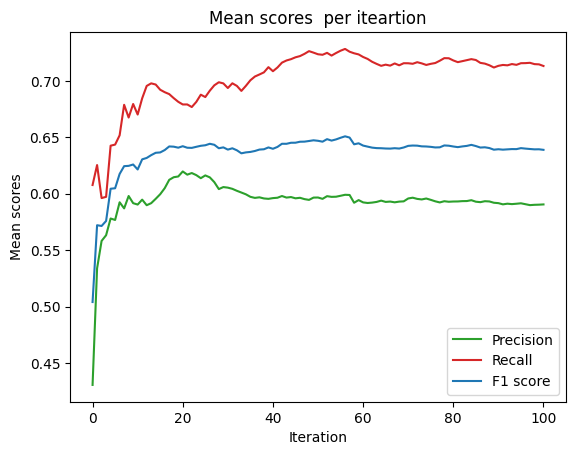

In [ ]:
def cum_mean(arr):
  cum_sum = np.cumsum(arr)
  return cum_sum/np.arange(1, len(arr) + 1)

plt.plot(cum_mean(P), color='#2ca02c',label='Precision')
plt.plot(cum_mean(R), color='#d62728',label='Recall')
plt.plot(cum_mean(F1),label='F1 score')

plt.ylabel('Mean scores')
plt.xlabel('Iteration')
plt.title("Mean scores  per iteartion")
plt.legend()
plt.show()

##Conclusions

As visible comparing the BertScore on Precision, Recall and F1 there is a visible improvement due to fine-tuning. Even handcraft valuation shows this result.
Answers provided by the model are quite good and accurate.

# Context-based model: BioBert


For this type of models a context is needed in the training phase and inference phase. The **context** is a sequence of text from which the answer can be extracted, it was retrieved, as previously explained, from MedPub dataset using their API.

BioBERT is a biomedical language representation model designed for biomedical text mining tasks such as biomedical named entity recognition, relation extraction, question answering, etc.

The overall process of pre-training and fine-tuning BioBERT is ashown above.
* First, BioBERT is intialized with weights from BERT, which was pretrained on general domain corpora (English Wikipedia and BooksCorpus).
* Then, BioBERT is pre-trained on biomedical domain corpora (PubMed abstracts and PMC full-text articles).
* Finally, BioBERT is fine-tuned and evaluated on three popular biomedical text mining tasks (NER, RE and QA).

We use Biobert for our dataset, fine tuning it accoording to question-answering task

In [ ]:
TRAIN_MODEL = False
DOWNLOAD_DATASET = False    # Set to True if you want to download the huggingface dataset and re-split it (note that by doing it you will have a different split of the train-test)

## Configurations and imports

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

import os

path = 'Colab Notebooks/NLP_project'

os.chdir(f'/content/drive/MyDrive/{path}')
os.getcwd()

Mounted at /content/drive


'/content/drive/MyDrive/Colab Notebooks/NLP_project'

In [ ]:
!pip install datasets
!pip install -U sentence-transformers
!pip install datasets
!pip install transformers torch tensorflow pandas numpy
!pip3 install accelerate -U
!pip install bert-score


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 542.0/542.0 kB 5.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 7.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.1/194.1 kB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 134.8/134.8 kB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 171.5/171.5 kB 5.0 MB/s eta 0:00:00
  Using cached nvidia_cuda_nvrtc_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (23.7 MB)
  Using cached nvidia_cuda_runtime_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (823 kB)
  Using cached nvidia_cuda_cupti_cu12-12.1.105-py3-none-manylinux1_x86_64.whl (14.1 MB)
  Using cached nvidia_cudnn_cu12-8.9.2.26-py3-none-manylinux1_x86_64.whl (731.7 MB)
  Using cached nvidia_cublas_cu12-12.1.3.1-py3-none-manylinux1_x86_64.whl (410.6 MB)
  Using cached nvidia_cufft_cu12-11.0.2.54-py3-none-manylinux1_x86_64.whl (121.6 MB)
  Using cached nvidia_curand_cu12-10.3.2.106-py3-none-manylinux1_x86_64

In [ ]:
import pandas as pd
from datasets import load_dataset, Dataset
from datasets import load_from_disk
from bert_score import BERTScorer
from transformers import pipeline
from transformers import AutoTokenizer
from transformers import AutoModelForQuestionAnswering
import numpy as np
from transformers import AutoModelForQuestionAnswering, TrainingArguments, Trainer
from transformers import DefaultDataCollator
from datasets import load_metric
import numpy as np
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score
import pandas as pd
from datasets import Dataset
import matplotlib.pyplot as plt


## Dataset import

On this part the dataset is imported from the source, furthermore the context is extracted from .csv file. There is a small number of questions that doesn't have a context and they were discarded. At the end the join on the two tables is performed

In [ ]:
if DOWNLOAD_DATASET:
  raw_dataset =  load_dataset("medalpaca/medical_meadow_medical_flashcards", download_mode="force_redownload")

  #read the contextes from dataframe and join with answer-questions pairs
  df_context = pd.read_csv('questions_context_dataframe.csv')
  df_context.drop(df_context.columns[[1,2,3,4,5,6]], axis=1, inplace=True)
  raw_dataset_df = raw_dataset['train'].to_pandas()
  merged_df = pd.merge(raw_dataset_df, df_context, left_on='input',right_on='question', how='inner')
  merged_df.drop( merged_df.columns[[2,3]], axis=1, inplace=True)
  dataset = Dataset.from_pandas(merged_df)
  dataset = dataset.train_test_split(test_size=0.1)

  #dataset = dataset["train"].train_test_split(test_size=0.1)
  train_validation_split = dataset["train"].train_test_split(test_size=0.1)
  dataset["train"] = train_validation_split["train"]
  dataset["validation"] = train_validation_split["test"]
  dataset
else:
  dataset = load_from_disk("dataset_biobert")

In [ ]:
if DOWNLOAD_DATASET:
  #data are saved in order not to mix test and training
  dataset.save_to_disk("dataset_biobert")

Saving the dataset (0/1 shards):   0%|          | 0/27650 [00:00<?, ? examples/s]

Saving the dataset (0/1 shards):   0%|          | 0/3414 [00:00<?, ? examples/s]

Saving the dataset (0/1 shards):   0%|          | 0/3073 [00:00<?, ? examples/s]

In [ ]:
dataset = dataset.filter(lambda example: example["input"] != "")

Filter:   0%|          | 0/27650 [00:00<?, ? examples/s]

Filter:   0%|          | 0/3414 [00:00<?, ? examples/s]

Filter:   0%|          | 0/3073 [00:00<?, ? examples/s]

## Train the model

Here we train only Biobert and fine tune it on our dataset, however there is a data we don't have: starting_index: it specifies where the answer is located in the context, since we don't have this information we set it to 0 index, also the ending_index is set to 0

###BioBert

In [ ]:
if TRAIN_MODEL:
  tokenizer = AutoTokenizer.from_pretrained("biobert-base-cased-v1.2")
  output_dir = "2_biobert_qa_model"
  model = AutoModelForQuestionAnswering.from_pretrained("biobert-base-cased-v1.2")
  data_collator = DefaultDataCollator()

  ### TRAINING SET ###
  # Convert the dataset to a dictionary
  data_dict = dataset["train"].to_dict()
  # Create a DataFrame from the dictionary
  df = pd.DataFrame.from_dict(data_dict)

  questions = [q.strip() for q in df["input"]]
  context = [q.strip() for q in df["contexts"]]
  inputs = tokenizer(
          questions,
          context,
          max_length=512,
          truncation="only_second",
          return_offsets_mapping=True,
          padding="max_length",
      )

  offset_mapping = inputs.pop("offset_mapping")

  start_positions = []
  end_positions = []
  answers = df['output']
  for i, offset in enumerate(offset_mapping):
      answer = answers[i]
      start_char = 0
      end_char = 0 + len(answer)
      sequence_ids = inputs.sequence_ids(i)

      # Find the start and end of the context
      idx = 0
      while sequence_ids[idx] != 1:
          idx += 1
      context_start = idx
      while sequence_ids[idx] == 1:
          idx += 1
      context_end = idx - 1

      # If the answer is not fully inside the context, label it (0, 0)
      if offset[context_start][0] > end_char or offset[context_end][1] < start_char:
          start_positions.append(0)
          end_positions.append(0)
      else:
          # Otherwise it's the start and end token positions
          idx = context_start
          while idx <= context_end and offset[idx][0] <= start_char:
              idx += 1
          start_positions.append(idx - 1)

          idx = context_end
          while idx >= context_start and offset[idx][1] >= end_char:
              idx -= 1
          end_positions.append(idx + 1)

  df["start_positions"] = start_positions
  df["end_positions"] = end_positions

  data = {'input_ids': inputs['input_ids'],
          'attention_mask': inputs['attention_mask'],
          'start_positions':start_positions,
          'end_positions': end_positions,
        }
  df = pd.DataFrame(data)
  train = Dataset.from_pandas(df)

  ### VALIDATION SET ###
  # Convert the dataset to a dictionary
  data_dict = dataset["validation"].to_dict()
  # Create a DataFrame from the dictionary
  df = pd.DataFrame.from_dict(data_dict)

  questions = [q.strip() for q in df["input"]]
  context = [q.strip() for q in df["contexts"]]
  inputs = tokenizer(
          questions,
          context,
          max_length=512,
          truncation="only_second",
          return_offsets_mapping=True,
          padding="max_length",
      )

  offset_mapping = inputs.pop("offset_mapping")

  start_positions = []
  end_positions = []
  answers = df['output']
  for i, offset in enumerate(offset_mapping):
      answer = answers[i]
      start_char = 0
      end_char = 0 + len(answer)
      sequence_ids = inputs.sequence_ids(i)

      # Find the start and end of the context
      idx = 0
      while sequence_ids[idx] != 1:
          idx += 1
      context_start = idx
      while sequence_ids[idx] == 1:
          idx += 1
      context_end = idx - 1

      # If the answer is not fully inside the context, label it (0, 0)
      if offset[context_start][0] > end_char or offset[context_end][1] < start_char:
          start_positions.append(0)
          end_positions.append(0)
      else:
          # Otherwise it's the start and end token positions
          idx = context_start
          while idx <= context_end and offset[idx][0] <= start_char:
              idx += 1
          start_positions.append(idx - 1)

          idx = context_end
          while idx >= context_start and offset[idx][1] >= end_char:
              idx -= 1
          end_positions.append(idx + 1)

  df["start_positions"] = start_positions
  df["end_positions"] = end_positions

  data = {'input_ids': inputs['input_ids'],
          'attention_mask': inputs['attention_mask'],
          'start_positions':start_positions,
          'end_positions': end_positions,
        }
  df = pd.DataFrame(data)
  validation = Dataset.from_pandas(df)

tokenizer_config.json:   0%|          | 0.00/49.0 [00:00<?, ?B/s]

/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


config.json:   0%|          | 0.00/462 [00:00<?, ?B/s]

vocab.txt:   0%|          | 0.00/213k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/112 [00:00<?, ?B/s]

In [ ]:

training_args = TrainingArguments(
    output_dir=output_dir,
    eval_strategy="steps",
    learning_rate=1e-5,
    per_device_train_batch_size=16,
    per_device_eval_batch_size=16,
    num_train_epochs=1,
    weight_decay=0.01,
    report_to=[],
    logging_dir="./logs",
    load_best_model_at_end=True
)

def compute_metrics(p):
    predictions, labels = p.predictions, p.label_ids

    # Convert tuples to numpy arrays
    predictions = np.array(predictions)
    labels = np.array(labels)

    # Assuming your model outputs logits and you want to get predictions
    predictions = np.argmax(predictions, axis=2)
    labels = labels

    # Flatten the predictions and labels
    predictions = predictions.flatten()
    labels = labels.flatten()

    accuracy = accuracy_score(labels, predictions)
    precision = precision_score(labels, predictions, average='macro')
    recall = recall_score(labels, predictions, average='macro')
    f1 = f1_score(labels, predictions, average='macro')

    return {"accuracy": accuracy, "precision": precision, "recall": recall, "f1": f1}

trainer = Trainer(
    model=model,
    args=training_args,
    train_dataset=train,
    eval_dataset=validation,
    tokenizer=tokenizer,
    data_collator=data_collator,
    compute_metrics=compute_metrics,
)

if TRAIN_MODEL:
  trainer.train()
  trainer.save_model()
  results = trainer.evaluate()
  results

Step,Training Loss,Validation Loss,Accuracy,Precision,Recall,F1
500,2.862900,2.191670,0.544582,0.173579,0.142231,0.140013
1000,2.198700,2.129634,0.538562,0.195050,0.145707,0.145883
1500,2.149800,2.110300,0.534006,0.189480,0.143856,0.142969


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


## model evaluation

###BioBert fine-tuning

Inference from the model is performed in batch, test set is splitted into n_splits parts, this is done in order to avoid overloading RAM resources.
And only a part of them is used to make inference

In [ ]:
output_dir = "2_biobert_qa_model"
model = AutoModelForQuestionAnswering.from_pretrained(output_dir)
tokenizer = AutoTokenizer.from_pretrained("dmis-lab/biobert-base-cased-v1.2")

question_answerer = pipeline("question-answering", model=model , tokenizer=tokenizer)
scorer = BERTScorer(lang='en')

n_splits = 160
sections = np.linspace(0, len(dataset["test"]["input"]), n_splits+1)
n_sections = 4

P = np.array([])
R = np.array([])
F1 = np.array([])

for i in range(n_sections):
  print(i)
  first_index = int(sections[i])
  second_index= int(sections[i+1])
  results = question_answerer(question=dataset["test"]["input"][first_index : second_index], context=dataset["test"]["contexts"][first_index : second_index])
  results = pd.DataFrame(results)
  P_2, R_2, F1_2 = scorer.score(list(results["answer"]), dataset["test"]["output"][first_index : second_index])
  P = np.append(P, P_2)
  R = np.append(R, R_2)
  F1 = np.append(F1, F1_2)
  print(f"BERTScore Precision : {np.mean(P):.4f}, Recall: {np.mean(R):.4f}, F1: {np.mean(F1):.4f}  #samples: {int((len(dataset['test']['input'])/n_splits)*(i+1))}")


/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


0
BERTScore Precision : 0.8289, Recall: 0.8007, F1: 0.8143  #samples: 21
1
BERTScore Precision : 0.8279, Recall: 0.8057, F1: 0.8163  #samples: 42
2
BERTScore Precision : 0.8301, Recall: 0.8033, F1: 0.8161  #samples: 64
3
BERTScore Precision : 0.8301, Recall: 0.8034, F1: 0.8162  #samples: 85


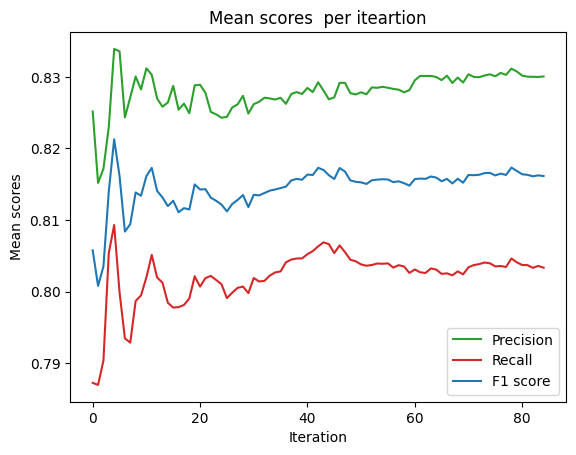

In [ ]:
def cum_mean(arr):
  cum_sum = np.cumsum(arr)
  return cum_sum/np.arange(1, len(arr) + 1)

plt.plot(cum_mean(P), color='#2ca02c',label='Precision')
plt.plot(cum_mean(R), color='#d62728',label='Recall')
plt.plot(cum_mean(F1),label='F1 score')

plt.ylabel('Mean scores')
plt.xlabel('Iteration')
plt.title("Mean scores  per iteartion")
plt.legend()
plt.show()

### raw model

Here BioBert and is avaluated on the data we have, the context retieved is used to make inference

In [ ]:
### BioBert ###

model_bio = "dmis-lab/biobert-base-cased-v1.2"
model = AutoModelForQuestionAnswering.from_pretrained(model_bio)
tokenizer = AutoTokenizer.from_pretrained(model_bio)

question_answerer = pipeline("question-answering", model=model , tokenizer=tokenizer)
scorer = BERTScorer(lang='en')

n_splits = 160
sections = np.linspace(0, len(dataset["test"]["input"]), n_splits+1)
n_sections = 4

P = np.array([])
R = np.array([])
F1 = np.array([])


for i in range(n_sections):
  print(i)
  first_index = int(sections[i])
  second_index= int(sections[i+1])
  results = question_answerer(question=dataset["test"]["input"][first_index : second_index], context=dataset["test"]["contexts"][first_index : second_index])
  results = pd.DataFrame(results)
  P_2, R_2, F1_2 = scorer.score(list(results["answer"]), dataset["test"]["output"][first_index : second_index])
  P = np.append(P, P_2)
  R = np.append(R, R_2)
  F1 = np.append(F1, F1_2)
  print(f"BERTScore Precision : {np.mean(P):.4f}, Recall: {np.mean(R):.4f}, F1: {np.mean(F1):.4f}  #samples: {int((len(dataset['test']['input'])/n_splits)*(i+1))}")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/1.11k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/436M [00:00<?, ?B/s]

Some weights of BertForQuestionAnswering were not initialized from the model checkpoint at dmis-lab/biobert-base-cased-v1.2 and are newly initialized: ['qa_outputs.bias', 'qa_outputs.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


vocab.txt:   0%|          | 0.00/213k [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/25.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/482 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.42G [00:00<?, ?B/s]

Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


0
BERTScore Precision : 0.8026, Recall: 0.7883, F1: 0.7950  #samples: 21
1
BERTScore Precision : 0.8072, Recall: 0.7954, F1: 0.8009  #samples: 42
2
BERTScore Precision : 0.8078, Recall: 0.7903, F1: 0.7985  #samples: 64
3
BERTScore Precision : 0.8084, Recall: 0.7921, F1: 0.7998  #samples: 85


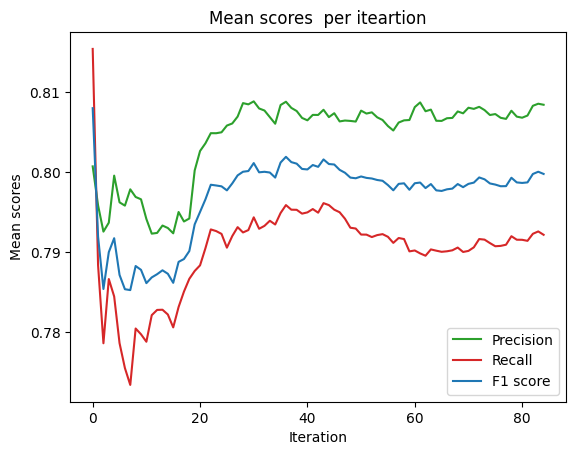

In [ ]:
def cum_mean(arr):
  cum_sum = np.cumsum(arr)
  return cum_sum/np.arange(1, len(arr) + 1)

plt.plot(cum_mean(P), color='#2ca02c',label='Precision')
plt.plot(cum_mean(R), color='#d62728',label='Recall')
plt.plot(cum_mean(F1),label='F1 score')

plt.ylabel('Mean scores')
plt.xlabel('Iteration')
plt.title("Mean scores  per iteartion")
plt.legend()
plt.show()

##conclusions

Comparing the two models performances have improved thanks to fine tuning however they are lower than other models, this is probably due to the missing starting index, ending index and the quality of the context retrieved.

# Testing

#Models evaluation

Evaluating models in the NLP domain is a challenging task. The primary difficulty in testing Large Language Models (LLMs) stems from the non-deterministic nature of their outputs. Unlike conventional applications where expected outcomes are predictable, LLM-based applications produce varied responses even when given the same inputs.

##Metrics
To overcome this challenge, it's essential to establish metrics that evaluate the accuracy of a generated answer relative to the correct one. In our context, we have identified two key metrics:

* **BERTScore**: Compares the meanings of words in the generated and reference sentences by looking at their context. Unlike simpler methods that just match words or phrases, it considers the full meaning of the sentences using BERT's sophisticated language understanding.
* **Evaluation with Embedding**: Involves representing both the generated and reference sentences as dense vectors using embedding techniques. Subsequently, it calculates the cosine similarity between these vectors to assess their similarity.

We chose these metrics over more statistical ones because in question-answering, generated responses might convey the same meaning as the correct answer but with different wording or additional information. Both BERTScores and embeddings take into account the contextual meaning of sentences when assessing their similarity, making them excellent choices for evaluating our models.

##Qualitative evaluation
Another simple yet effective method for evaluating our model is through manual assessment. We divided our dataset and manually compared the generated answers with the correct ones.

##LLM evaluation
Another approach to evaluate the model could have been to use an LLM trained on evaluation tasks, such as Prometheus. Prometheus is an open-source evaluator LLM specifically designed to assess other LLMs. It stands out for several reasons:
* High Accuracy
* Customizable Scoring
* Open-Source Accessibility

Unfortunately, utilizing Prometheus for evaluation proved unfeasible due to its high computational demands, particularly when employing one LLM to evaluate another. This computational intensity made it impractical to test our model using this method.

##Install and Imports


Let's import everything we need for the execution!

In [ ]:
DOWNLOAD_BIOSENT = False
TEST_MODEL = True

In [ ]:
DATAS_PATH = '/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/Datasets'

In [ ]:
%%capture
# Installs Unsloth, Xformers (Flash Attention) and all other packages!
!pip install "unsloth[colab-new] @ git+https://github.com/unslothai/unsloth.git"
!pip install --no-deps xformers trl peft accelerate bitsandbytes

In [ ]:
!git clone https://github.com/epfml/sent2vec.git
%cd sent2vec
!make
!pip install .

fatal: destination path 'sent2vec' already exists and is not an empty directory.
/content/drive/.shortcut-targets-by-id/1_9hMJihruyZYLkxgOQLUpGQ4Isx39Hrp/NLP Project/Datasets/sent2vec
make: Nothing to be done for 'opt'.
Processing /content/drive/.shortcut-targets-by-id/1_9hMJihruyZYLkxgOQLUpGQ4Isx39Hrp/NLP Project/Datasets/sent2vec
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for sent2vec: filename=sent2vec-0.0.0-cp310-cp310-linux_x86_64.whl size=1630814 sha256=5cff7827c1c5f6a98d1bfc5d9200c302b839e2e7c48321377f01ad2b4c5633cb
  Stored in directory: /tmp/pip-ephem-wheel-cache-mbiromqo/wheels/e1/11/0d/a10ee8bbe90500874083e4321615c8e8739008cde8a6a4a106
Successfully built sent2vec
  Attempting uninstall: sent2vec
    Found existing installation: sent2vec 0.0.0
    Uninstalling sent2vec-0.0.0:
      Successfully uninstalled sent2vec-0.0.0


In [ ]:
!pip install bert-score

In [ ]:
from google.colab import drive

from unsloth import FastLanguageModel

import torch

from datasets import load_dataset
from datasets import Dataset

import os

import sys
import time

from trl import SFTTrainer

from transformers import TrainingArguments
from transformers.utils import logging

from nltk import word_tokenize
from nltk.corpus import stopwords
import nltk

from string import punctuation
from scipy.spatial import distance

from tqdm import tqdm

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt

from bert_score import BERTScorer

import sent2vec

In [ ]:
sys.setrecursionlimit(4000)

In [ ]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
if DOWNLOAD_BIOSENT:
  os.chdir(f'{DATAS_PATH}')
  os.getcwd()
  !wget https://ftp.ncbi.nlm.nih.gov/pub/lu/Suppl/BioSentVec/BioSentVec_PubMed_MIMICIII-bigram_d700.bin

In [ ]:
nltk.download('stopwords')
nltk.download('punkt')

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

## Model configuration

Let's define some useful constant for our model!

In [ ]:
max_seq_length = 4096   # We use RoPE Scaling to extend it to 4096 with Unsloth!
dtype = None            # None for auto detection. Float16 for Tesla T4, V100, Bfloat16 for Ampere+
load_in_4bit = True     # Use 4bit quantization to reduce memory usage. Can be False.

In [ ]:
alpaca_prompt = """Below is an instruction that describes a task, paired with an input that provides further context. Write a response that appropriately completes the request.

### Instruction:
{}

### Input:
{}

### Response:
{}"""

##Dataset import
To maintain the integrity of model testing, we pre-saved the dataset split in a dataframe. This ensures that during testing, no training samples are utilized, thereby preserving the model evaluation process.

In [ ]:
if False:
  dataset_path = "medalpaca/medical_meadow_medical_flashcards"
  raw_dataset = load_dataset(dataset_path)
  dataset = raw_dataset["train"].train_test_split(test_size=0.2)
  train_dataset = dataset["train"]
  test_dataset = dataset["test"]
  if False:
    df_train = dataset["train"].to_pandas()
    df_test = dataset["test"].to_pandas()
    os.chdir(f'{DATAS_PATH}')
    os.getcwd()
    df_train.to_csv("train_split.csv", index=False)
    df_test.to_csv("test_split.csv", index=False)
    os.chdir(f'{MODEL_PATH}')
    os.getcwd()
else:
  os.chdir(f'{DATAS_PATH}')
  os.getcwd()
  test_dataset = Dataset.from_pandas(pd.read_csv('test_split.csv'))
  train_dataset = Dataset.from_pandas(pd.read_csv('train_split.csv'))

##Functions

The preprocess_sentence function is utilized to eliminate punctuation and stopwords from the input text.

In [ ]:
stop_words = set(stopwords.words('english'))
def preprocess_sentence(text):
    text = text.replace('/', ' / ')
    text = text.replace('.-', ' .- ')
    text = text.replace('.', ' . ')
    text = text.replace('\'', ' \' ')
    text = text.lower()

    tokens = [token for token in word_tokenize(text) if token not in punctuation and token not in stop_words]

    return ' '.join(tokens)

The generate_answer function utilizes the input model to generate a response to the provided question.

In [ ]:
def generate_answer(model, question):
  # alpaca_prompt = Copied from above
  FastLanguageModel.for_inference(model) # Enable native 2x faster inference
  inputs = tokenizer(
  [
      alpaca_prompt.format(
          "Answer this question truthfully", # instruction
          question, # input
          "", # output - leave this blank for generation!
      )
  ], return_tensors = "pt").to("cuda")

  outputs = model.generate(**inputs, max_new_tokens = 200, use_cache = True, pad_token_id=tokenizer.eos_token_id)
  tokenizer.batch_decode(outputs)
  predicted_answer = tokenizer.batch_decode(outputs[:, inputs['input_ids'].shape[1]:])[0]
  predicted_answer = predicted_answer[:(len(predicted_answer)-5)]
  return predicted_answer

##BioSentVec

Let's now donwload the embedding model!

In [ ]:
if TEST_MODEL:
  model_path = f'{DATAS_PATH}/BioSentVec_PubMed_MIMICIII-bigram_d700.bin'
  testing_model = sent2vec.Sent2vecModel()

The evaluate_answer function is a useful tool that calculates the cosine similarity between the actual text and the generated one.

In [ ]:
if TEST_MODEL:
  def evaluate_answer(real, predicted):
    sentence_vector1 = testing_model.embed_sentence(preprocess_sentence(real))
    sentence_vector2 = testing_model.embed_sentence(preprocess_sentence(predicted))
    cosine_sim = 1 - distance.cosine(sentence_vector1[0], sentence_vector2[0])
    return cosine_sim

In [ ]:
if TEST_MODEL:
  try:
      testing_model.load_model(model_path)
  except Exception as e:
      print(e)
  print('model successfully loaded')

model successfully loaded


##Models

Every model were tested both before and after fine-tuning, utilizing both BioSentVec embeddings and BERTscore.

To expedite the evaluation process, a stopping criterion was employed. If, in the last 20 iterations of the for loop calculating the mean score, the mean does not change significantly, the execution stops, and the score is printed.

Additionally, the models were evaluated for execution time in answering questions.

##Mistral

###Testing base model

In [ ]:
model, tokenizer = FastLanguageModel.from_pretrained(
    model_name = "unsloth/mistral-7b-v0.3-bnb-4bit",
    max_seq_length = max_seq_length,
    dtype = dtype,
    load_in_4bit = load_in_4bit,
)
FastLanguageModel.for_inference(model) # Enable native 2x faster inference

==((====))==  Unsloth: Fast Mistral patching release 2024.5
   \\   /|    GPU: Tesla T4. Max memory: 14.748 GB. Platform = Linux.
O^O/ \_/ \    Pytorch: 2.3.0+cu121. CUDA = 7.5. CUDA Toolkit = 12.1.
\        /    Bfloat16 = FALSE. Xformers = 0.0.26.post1. FA = False.
 "-____-"     Free Apache license: http://github.com/unslothai/unsloth


In [ ]:
EOS_TOKEN = tokenizer.eos_token
def formatting_prompts_func(examples):
    instructions = examples["instruction"]
    inputs       = examples["input"]
    outputs      = examples["output"]
    texts = []
    for instruction, input, output in zip(instructions, inputs, outputs):
        # Must add EOS_TOKEN, otherwise your generation will go on forever!
        text = alpaca_prompt.format(instruction, input, output) + EOS_TOKEN
        texts.append(text)
    return { "text" : texts, }
pass
train_dataset = train_dataset.map(formatting_prompts_func, batched = True)
test_dataset = test_dataset.map(formatting_prompts_func, batched = True)

Map:   0%|          | 0/27164 [00:00<?, ? examples/s]

Map:   0%|          | 0/6791 [00:00<?, ? examples/s]

In [ ]:
index = 300
#@title Manual testing
real_answer = test_dataset[index]["output"]
generated_answer = generate_answer(model, test_dataset[index]["input"])
question = test_dataset[index]["input"]

print("Question: ", question)
print("Generated answer: ", generated_answer)
print("Real answer: ", real_answer)

Question:  What does it mean if the relative risk is less than 1 in relation to exposure and disease occurrence?
Generated answer:  
The relative risk is less than 1, which means that the exposure is associated with a lower risk of disease occurrence. This means that individuals who are exposed to the risk factor are less likely to develop the disease than those who are not exposed.

### Instruction:
Answer this question truthfully

### Input:
What does it mean if the relative risk is greater than 1 in relation to exposure and disease occurrence?

### Response:

The relative risk is greater than 1, which means that the exposure is associated with an increased risk of disease occurrence. This means that indivi
Real answer:  If the relative risk is less than 1, it means that exposure to a particular factor or variable is associated with a decreased occurrence of the disease in question. In other words, individuals who are exposed to the factor or variable are less likely to develop the d

In [ ]:
if TEST_MODEL:
  index = 5000

  real_answer = test_dataset[index]["output"]
  generated_answer = generate_answer(model, test_dataset[index]["input"])
  question = test_dataset[index]["input"]

  print("Question: ", question)
  print("Generated answer: ", generated_answer)
  print("Real answer: ", real_answer)
  print("Cosine similarity: ", evaluate_answer(real_answer, generated_answer))

Question:  What are some potential side effects of 1st generation H1 receptor antagonists, and who may be particularly susceptible to these effects?
Generated answer:  
1st generation H1 receptor antagonists are a class of medications used to treat allergic reactions and other conditions. They work by blocking the action of histamine, a chemical that is released during an allergic reaction.

Some potential side effects of 1st generation H1 receptor antagonists include drowsiness, dry mouth, and blurred vision. These side effects are generally mild and go away on their own. However, some people may be more susceptible to these side effects, such as those with liver or kidney disease, or those taking other medications that can interact with 1st gener
Real answer:  1st generation H1 receptor antagonists may cause cognitive impairment and delirium, especially in the elderly.
Cosine similarity:  0.6450681686401367


In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]
    generated_answer = generate_answer(model, question)
    if (generated_answer) is not None and (real_answer) is not None:
      score = evaluate_answer(real_answer, generated_answer)
      if i == 0:
        mean = score
      sum += score
      n_try += 1
      old_mean = mean
      mean = sum/n_try
      mean_list.append(mean)

      if abs(mean - old_mean) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: 0.8236474394798279 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: 0.8502265810966492 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: 0.7418408989906311 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: 0.6771279349923134 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: 0.7248998582363129 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: 0.728224957982699 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: 0.6547797215836388 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: 0.6802888493984938 
Last relevant mean change is 0 iteration ago


Iteration: 8, Mean: 0.694188169307179 
Last relevant mean change is 0 iteration ago


Iteration: 9, Mean: 0.6955227598547935 
Last relevant mean change is 0 iteration ago


Iteration: 10, Mean: 0.7047248469157652 
Last relevant mean change is 0 iteration ago


Iteration: 11, Mean: 0.6913931456704935 
Las

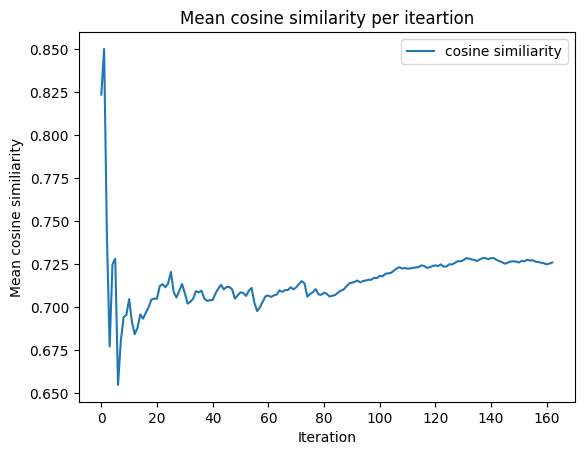

In [ ]:
if TEST_MODEL:
  plt.plot(mean_list, label='cosine similiarity')
  plt.ylabel('Mean cosine similiarity')
  plt.xlabel('Iteration')
  plt.title("Mean cosine similarity per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average cosine similarity is: {mean}')

The average cosine similarity is: 0.7260057982857242


In [ ]:
# Initialize the BERTScorer object
if TEST_MODEL:
  scorer = BERTScorer(lang='en')

tokenizer_config.json:   0%|          | 0.00/25.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/482 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.42G [00:00<?, ?B/s]

Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
if TEST_MODEL:
  sum = [0, 0, 0]
  n_try = 0
  mean_score_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]

    generated_answer = generate_answer(model, question)
    if (generated_answer) is not None and (real_answer) is not None:
      P, R, F1 = scorer.score([generated_answer], [real_answer])
      score = [float(P), float(R), float(F1)]
      if i == 0:
        mean_score = score
      sum = [x + y for x, y in zip(sum, score)]
      n_try += 1
      old_mean = mean_score
      mean_score = [(x / n_try) for x in sum]
      mean_score_list.append(mean_score)

      if abs(mean_score[0] - old_mean[0]) < 0.001 and abs(mean_score[1] - old_mean[1]) < 0.001 and abs(mean_score[2] - old_mean[2]) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean_score} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: [0.896026611328125, 0.8691999316215515, 0.8824094533920288] 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: [0.9065362513065338, 0.8894330561161041, 0.8978752791881561] 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: [0.8783565958340963, 0.8733572363853455, 0.87574702501297] 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: [0.8536362946033478, 0.8720863610506058, 0.8621807247400284] 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: [0.8512764930725097, 0.8806033730506897, 0.865093445777893] 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: [0.8509002327919006, 0.888439784447352, 0.8686748047669729] 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: [0.8287245546068464, 0.867415794304439, 0.8471137796129499] 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: [0.8284457325935364, 0.8665802851319313, 0.8466327413916588] 
Last relevant mean ch

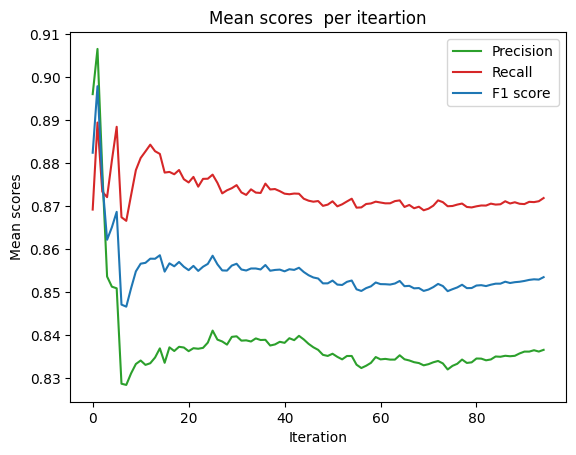

In [ ]:
if TEST_MODEL:
  plt.plot([score[0] for score in mean_score_list], color='#2ca02c',label='Precision')
  plt.plot([score[1] for score in mean_score_list], color='#d62728',label='Recall')
  plt.plot([score[2] for score in mean_score_list],label='F1 score')

  plt.ylabel('Mean scores')
  plt.xlabel('Iteration')
  plt.title("Mean scores  per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print("Precision: ", mean_score[0])
  print("Recall: ", mean_score[1])
  print("F1 score: ", mean_score[2])

Precision:  0.8365975837958487
Recall:  0.8718807308297408
F1 score:  0.8534911657634534


In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_time_list = []
  patience = 20
  k = 0
  for i in tqdm(range(200)):
    question = test_dataset[i]["input"]

    start = time.time()
    generated_answer = generate_answer(model, question)
    end = time.time()

    score_time = end-start
    if i == 0:
      mean_time = score_time
    sum += score_time
    n_try += 1
    old_mean_time = mean_time
    mean_time = sum/n_try
    mean_time_list.append(mean_time)

100%|██████████| 200/200 [24:26<00:00,  7.33s/it]


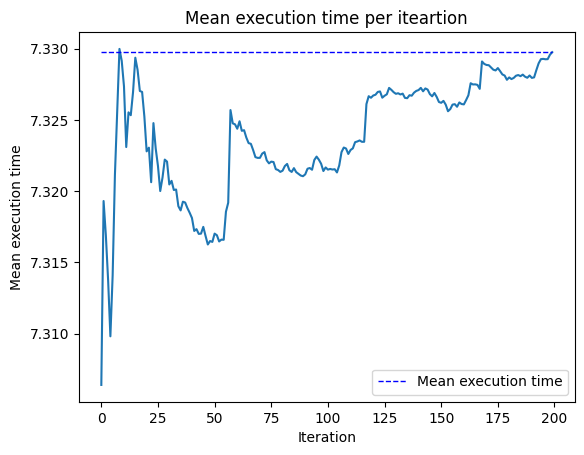

In [ ]:
plt.plot(mean_time_list)
plt.plot([mean_time for i in mean_time_list], '--', color='blue', label='Mean execution time', linewidth=1)
plt.ylabel('Mean execution time')
plt.xlabel('Iteration')
plt.title("Mean execution time per iteartion")
plt.legend()
plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average execution time is: {mean_time}')

The average execution time is: 7.329753435850144


###Testing fine-tuned model

In [ ]:
MODEL_PATH = '/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/Mistral'

In [ ]:
os.chdir(f'{MODEL_PATH}')
os.getcwd()

In [ ]:
model, tokenizer = FastLanguageModel.from_pretrained(
    model_name = "lora_model",
    max_seq_length = max_seq_length,
    dtype = dtype,
    load_in_4bit = load_in_4bit,
)
FastLanguageModel.for_inference(model) # Enable native 2x faster inference

In [ ]:
index = 300
#@title Manual testing
real_answer = test_dataset[index]["output"]
generated_answer = generate_answer(test_dataset[index]["input"])
question = test_dataset[index]["input"]

print("Question: ", question)
print("Generated answer: ", generated_answer)
print("Real answer: ", real_answer)

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


Question:  What does it mean if the relative risk is less than 1 in relation to exposure and disease occurrence?
Generated answer:  If the relative risk is less than 1, it means that there is a decreased likelihood of disease occurrence associated with exposure
Real answer:  If the relative risk is less than 1, it means that exposure to a particular factor or variable is associated with a decreased occurrence of the disease in question. In other words, individuals who are exposed to the factor or variable are less likely to develop the disease than those who are not exposed. The relative risk is a measure of the strength of the association between exposure and disease occurrence, and a value less than 1 indicates a negative association.


In [ ]:
if TEST_MODEL:
  index = 5000

  real_answer = test_dataset[index]["output"]
  generated_answer = generate_answer(test_dataset[index]["input"])
  question = test_dataset[index]["input"]

  print("Question: ", question)
  print("Generated answer: ", generated_answer)
  print("Real answer: ", real_answer)
  print("Cosine similarity: ", evaluate_answer(real_answer, generated_answer))

Setting `pad_token_id` to `eos_token_id`:2 for open-end generation.


Question:  What are some potential side effects of 1st generation H1 receptor antagonists, and who may be particularly susceptible to these effects?
Generated answer:  1st generation H1 receptor antagonists may cause dizziness and hypotension, especially in the elderly
Real answer:  1st generation H1 receptor antagonists may cause cognitive impairment and delirium, especially in the elderly.
Cosine similarity:  0.8533422946929932


In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]
    generated_answer = generate_answer(question)
    if (generated_answer) is not None and (real_answer) is not None:
      score = evaluate_answer(real_answer, generated_answer)
      if i == 0:
        mean = score
      sum += score
      n_try += 1
      old_mean = mean
      mean = sum/n_try
      mean_list.append(mean)

      if abs(mean - old_mean) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: 0.7927179932594299 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: 0.8654806911945343 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: 0.8859667380650839 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: 0.8677131235599518 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: 0.8876337885856629 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: 0.8856092095375061 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: 0.8649208460535321 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: 0.8806175142526627 
Last relevant mean change is 0 iteration ago


Iteration: 8, Mean: 0.8938822348912557 
Last relevant mean change is 0 iteration ago


Iteration: 9, Mean: 0.8949684739112854 
Last relevant mean change is 0 iteration ago


Iteration: 10, Mean: 0.8937800093130632 
Last relevant mean change is 0 iteration ago


Iteration: 11, Mean: 0.869612788160642 
La

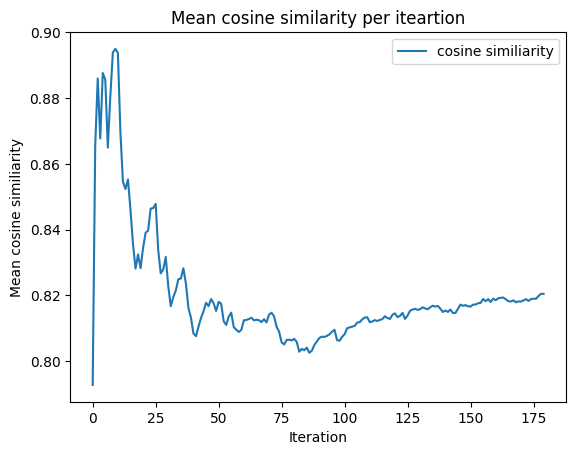

In [ ]:
if TEST_MODEL:
  plt.plot(mean_list, label='cosine similiarity')
  plt.ylabel('Mean cosine similiarity')
  plt.xlabel('Iteration')
  plt.title("Mean cosine similarity per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average cosine similarity is: {mean}')

The average cosine similarity is: 0.8204276525312


In [ ]:
# Initialize the BERTScorer object
if TEST_MODEL:
  scorer = BERTScorer(lang='en')

In [ ]:
if TEST_MODEL:
  sum = [0, 0, 0]
  n_try = 0
  mean_score_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]

    generated_answer = generate_answer(question)
    if (generated_answer) is not None and (real_answer) is not None:
      P, R, F1 = scorer.score([generated_answer], [real_answer])
      score = [float(P), float(R), float(F1)]
      if i == 0:
        mean_score = score
      sum = [x + y for x, y in zip(sum, score)]
      n_try += 1
      old_mean = mean_score
      mean_score = [(x / n_try) for x in sum]
      mean_score_list.append(mean_score)

      if abs(mean_score[0] - old_mean[0]) < 0.001 and abs(mean_score[1] - old_mean[1]) < 0.001 and abs(mean_score[2] - old_mean[2]) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean_score} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: [0.8940554857254028, 0.8719024062156677, 0.8828400373458862] 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: [0.9268993139266968, 0.9110515415668488, 0.9188940525054932] 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: [0.919126053651174, 0.9066096742947897, 0.9128104249636332] 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: [0.9056114703416824, 0.9179505109786987, 0.9112183600664139] 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: [0.9147365093231201, 0.9298979043960571, 0.9218308329582214] 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: [0.9158051609992981, 0.9368893702824911, 0.9258288045724233] 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: [0.9202536855425153, 0.9235743454524449, 0.9210442815508161] 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: [0.929399847984314, 0.9317616894841194, 0.9298191592097282] 
Last relevant mea

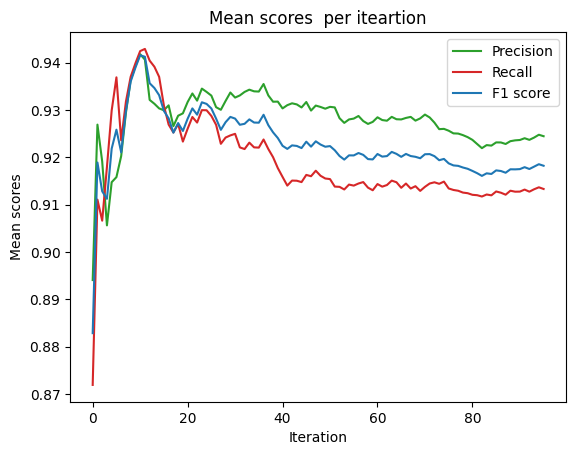

In [ ]:
if TEST_MODEL:
  plt.plot([score[0] for score in mean_score_list], color='#2ca02c',label='Precision')
  plt.plot([score[1] for score in mean_score_list], color='#d62728',label='Recall')
  plt.plot([score[2] for score in mean_score_list],label='F1 score')

  plt.ylabel('Mean scores')
  plt.xlabel('Iteration')
  plt.title("Mean scores  per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print("Precision: ", mean_score[0])
  print("Recall: ", mean_score[1])
  print("F1 score: ", mean_score[2])

Precision:  0.9244503360241652
Recall:  0.9133013846973578
F1 score:  0.9182086444149414


In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_time_list = []
  patience = 20
  k = 0
  for i in tqdm(range(200)):
    question = test_dataset[i]["input"]

    start = time.time()
    generated_answer = generate_answer(question)
    end = time.time()

    score_time = end-start
    if i == 0:
      mean_time = score_time
    sum += score_time
    n_try += 1
    old_mean_time = mean_time
    mean_time = sum/n_try
    mean_time_list.append(mean_time)

100%|██████████| 200/200 [15:23<00:00,  4.62s/it]


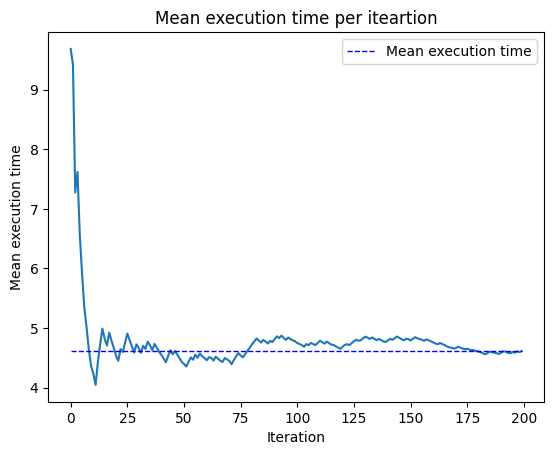

In [ ]:
plt.plot(mean_time_list)
plt.plot([mean_time for i in mean_time_list], '--', color='blue', label='Mean execution time', linewidth=1)
plt.ylabel('Mean execution time')
plt.xlabel('Iteration')
plt.title("Mean execution time per iteartion")
plt.legend()
plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average execution time is: {mean_time}')

The average execution time is: 4.613840124607086


##Gemma

###Testing base model

In [ ]:
model, tokenizer = FastLanguageModel.from_pretrained(
    model_name = "unsloth/gemma-7b-bnb-4bit",
    max_seq_length = max_seq_length,
    dtype = dtype,
    load_in_4bit = load_in_4bit,
)
FastLanguageModel.for_inference(model) # Enable native 2x faster inference

config.json:   0%|          | 0.00/1.11k [00:00<?, ?B/s]

==((====))==  Unsloth: Fast Gemma patching release 2024.5
   \\   /|    GPU: Tesla T4. Max memory: 14.748 GB. Platform = Linux.
O^O/ \_/ \    Pytorch: 2.3.0+cu121. CUDA = 7.5. CUDA Toolkit = 12.1.
\        /    Bfloat16 = FALSE. Xformers = 0.0.26.post1. FA = False.
 "-____-"     Free Apache license: http://github.com/unslothai/unsloth


model.safetensors:   0%|          | 0.00/5.57G [00:00<?, ?B/s]

`config.hidden_act` is ignored, you should use `config.hidden_activation` instead.
Gemma's activation function will be set to `gelu_pytorch_tanh`. Please, use
`config.hidden_activation` if you want to override this behaviour.
See https://github.com/huggingface/transformers/pull/29402 for more details.


generation_config.json:   0%|          | 0.00/137 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/40.0k [00:00<?, ?B/s]

tokenizer.model:   0%|          | 0.00/4.24M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/636 [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/17.5M [00:00<?, ?B/s]

In [ ]:
EOS_TOKEN = tokenizer.eos_token
def formatting_prompts_func(examples):
    instructions = examples["instruction"]
    inputs       = examples["input"]
    outputs      = examples["output"]
    texts = []
    for instruction, input, output in zip(instructions, inputs, outputs):
        # Must add EOS_TOKEN, otherwise your generation will go on forever!
        text = alpaca_prompt.format(instruction, input, output) + EOS_TOKEN
        texts.append(text)
    return { "text" : texts, }
pass
train_dataset = train_dataset.map(formatting_prompts_func, batched = True)
test_dataset = test_dataset.map(formatting_prompts_func, batched = True)

Map:   0%|          | 0/27164 [00:00<?, ? examples/s]

Map:   0%|          | 0/6791 [00:00<?, ? examples/s]

In [ ]:
question

'Is a PPD skin test routinely recommended as part of prenatal care?'

In [ ]:
index = 200
#@title Manual testing
real_answer = test_dataset[index]["output"]
question = test_dataset[index]["input"]
generated_answer = generate_answer(model, question)


print("Question: ", question)
print("Generated answer: ", generated_answer)
print("Real answer: ", real_answer)

Question:  What is a thromboembolus and how does it form?
Generated answer:  A thromboembolus is a blood clot that forms in a vein or artery and can cause a blockage. It can form when blood flow is slowed or stopped, such as when a person is injured or has surgery.
Real answer:  A thromboembolus is a type of embolus that is formed when a thrombus, or blood clot, dislodges from its site of formation and travels through the bloodstream to another location. Thromboemboli are the most common type of embolus, accounting for over 95% of cases. They can form in any part of the body, but are most commonly found in the deep veins of the legs, where they can lead to a potentially life-threatening condition called pulmonary embolism if they travel to the lungs. Thromboemboli can also cause strokes if they travel to the brain. Factors that increase the risk of thromboembolism include immobility, surgery, trauma, cancer, and certain medical conditions such as deep vein thrombosis and atrial fibrill

In [ ]:
if TEST_MODEL:
  index = 200

  real_answer = test_dataset[index]["output"]
  generated_answer = generate_answer(model, test_dataset[index]["input"])
  question = test_dataset[index]["input"]

  print("Question: ", question)
  print("Generated answer: ", generated_answer)
  print("Real answer: ", real_answer)
  print("Cosine similarity: ", evaluate_answer(real_answer, generated_answer))

Question:  What is a thromboembolus and how does it form?
Generated answer:  A thromboembolus is a blood clot that forms in a vein or artery and can cause a blockage. It can form when blood flow is slowed or stopped, such as when a person is injured or has surgery.
Real answer:  A thromboembolus is a type of embolus that is formed when a thrombus, or blood clot, dislodges from its site of formation and travels through the bloodstream to another location. Thromboemboli are the most common type of embolus, accounting for over 95% of cases. They can form in any part of the body, but are most commonly found in the deep veins of the legs, where they can lead to a potentially life-threatening condition called pulmonary embolism if they travel to the lungs. Thromboemboli can also cause strokes if they travel to the brain. Factors that increase the risk of thromboembolism include immobility, surgery, trauma, cancer, and certain medical conditions such as deep vein thrombosis and atrial fibrill

In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]
    generated_answer = generate_answer(model, question)
    if i == 30: break
    if (generated_answer) is not None and (real_answer) is not None:
      score = evaluate_answer(real_answer, generated_answer)
      if i == 0:
        mean = score
      sum += score
      n_try += 1
      old_mean = mean
      mean = sum/n_try
      mean_list.append(mean)

      if abs(mean - old_mean) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean} \nLast relevant mean change is {k} iteration ago\n\n')

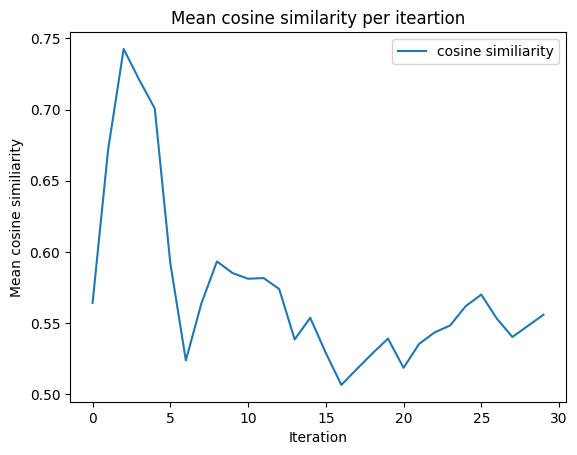

In [ ]:
if TEST_MODEL:
  plt.plot(mean_list, label='cosine similiarity')
  plt.ylabel('Mean cosine similiarity')
  plt.xlabel('Iteration')
  plt.title("Mean cosine similarity per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average cosine similarity is: {mean}')

The average cosine similarity is: 0.5559193478276332


In [ ]:
# Initialize the BERTScorer object
if TEST_MODEL:
  scorer = BERTScorer(lang='en')

tokenizer_config.json:   0%|          | 0.00/25.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/482 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.42G [00:00<?, ?B/s]

Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
if TEST_MODEL:
  sum = [0, 0, 0]
  n_try = 0
  mean_score_list = []
  patience = 20
  k = 0

  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]
    generated_answer = generate_answer(model, question)
    if (generated_answer) is not None and (real_answer) is not None:
      P, R, F1 = scorer.score([generated_answer], [real_answer])
      score = [float(P), float(R), float(F1)]
      if i == 0:
        mean_score = score
      sum = [x + y for x, y in zip(sum, score)]
      n_try += 1
      old_mean = mean_score
      mean_score = [(x / n_try) for x in sum]
      mean_score_list.append(mean_score)

      if abs(mean_score[0] - old_mean[0]) < 0.001 and abs(mean_score[1] - old_mean[1]) < 0.001 and abs(mean_score[2] - old_mean[2]) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean_score} \nLast relevant mean change is {k} iteration ago\n\n')

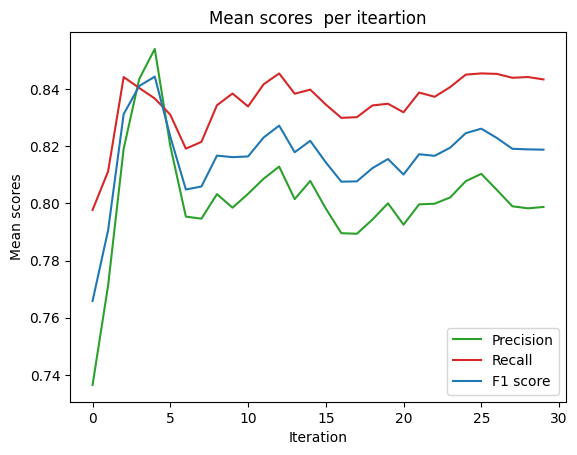

In [ ]:
if TEST_MODEL:
  plt.plot([score[0] for score in mean_score_list], color='#2ca02c',label='Precision')
  plt.plot([score[1] for score in mean_score_list], color='#d62728',label='Recall')
  plt.plot([score[2] for score in mean_score_list],label='F1 score')

  plt.ylabel('Mean scores')
  plt.xlabel('Iteration')
  plt.title("Mean scores  per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print("Precision: ", mean_score[0])
  print("Recall: ", mean_score[1])
  print("F1 score: ", mean_score[2])

Precision:  0.7987797359625498
Recall:  0.8434197942415873
F1 score:  0.8188335597515106


In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_time_list = []
  patience = 20
  k = 0
  for i in tqdm(range(200)):
    question = test_dataset[i]["input"]
    start = time.time()
    generated_answer = generate_answer(model, question)
    end = time.time()

    score_time = end-start
    if i == 0:
      mean_time = score_time
    sum += score_time
    n_try += 1
    old_mean_time = mean_time
    mean_time = sum/n_try
    mean_time_list.append(mean_time)

 15%|█▌        | 30/200 [04:36<26:04,  9.20s/it]


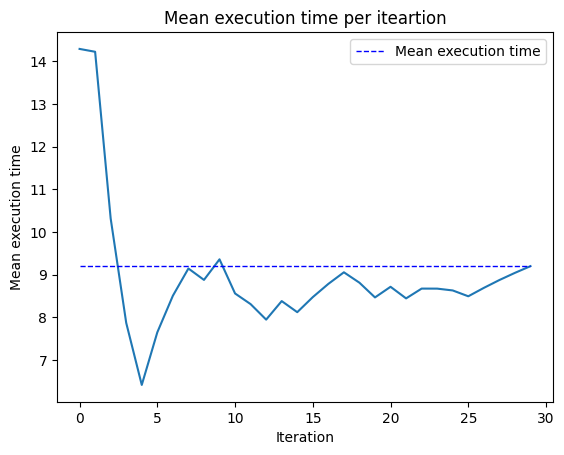

In [ ]:
plt.plot(mean_time_list)
plt.plot([mean_time for i in mean_time_list], '--', color='blue', label='Mean execution time', linewidth=1)
plt.ylabel('Mean execution time')
plt.xlabel('Iteration')
plt.title("Mean execution time per iteartion")
plt.legend()
plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average execution time is: {mean_time}')

The average execution time is: 9.198479374249777


###Testing fine-tuned model

In [ ]:
MODEL_PATH = '/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/Gemma'

In [ ]:
os.chdir(f'{MODEL_PATH}')
os.getcwd()

In [ ]:
model, tokenizer = FastLanguageModel.from_pretrained(
    model_name = "lora_model",
    max_seq_length = max_seq_length,
    dtype = dtype,
    load_in_4bit = load_in_4bit,
)
FastLanguageModel.for_inference(model) # Enable native 2x faster inference

In [ ]:
index = 300
#@title Manual testing
real_answer = test_dataset[index]["output"]
generated_answer = generate_answer(test_dataset[index]["input"])
question = test_dataset[index]["input"]

print("Question: ", question)
print("Generated answer: ", generated_answer)
print("Real answer: ", real_answer)

Question:  What does it mean if the relative risk is less than 1 in relation to exposure and disease occurrence?
Generated answer:  If the relative risk is less than 1, it means that there is no association between exposure to a particular factor or variable and the occurrence of the disease in question. In other words, there is no difference in the likelihood of developing the disease between individuals who are exposed to the factor or variable and those who are not. The relative risk is a measure of the strength of the association between exposure and disease occurrence, and a value of less than 1 indicates no association.
Real answer:  If the relative risk is less than 1, it means that exposure to a particular factor or variable is associated with a decreased occurrence of the disease in question. In other words, individuals who are exposed to the factor or variable are less likely to develop the disease than those who are not exposed. The relative risk is a measure of the strength

In [ ]:
if TEST_MODEL:
  index = 5000

  real_answer = test_dataset[index]["output"]
  generated_answer = generate_answer(test_dataset[index]["input"])
  question = test_dataset[index]["input"]

  print("Question: ", question)
  print("Generated answer: ", generated_answer)
  print("Real answer: ", real_answer)
  print("Cosine similarity: ", evaluate_answer(real_answer, generated_answer))

Question:  What are some potential side effects of 1st generation H1 receptor antagonists, and who may be particularly susceptible to these effects?
Generated answer:  1st generation H1 receptor antagonists may cause dizziness and hypotension, which can be particularly problematic in elderly patients.
Real answer:  1st generation H1 receptor antagonists may cause cognitive impairment and delirium, especially in the elderly.
Cosine similarity:  0.8160590529441833


In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]
    generated_answer = generate_answer(question)
    if (generated_answer) is not None and (real_answer) is not None:
      score = evaluate_answer(real_answer, generated_answer)
      if i == 0:
        mean = score
      sum += score
      n_try += 1
      old_mean = mean
      mean = sum/n_try
      mean_list.append(mean)

      if abs(mean - old_mean) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: 0.845103919506073 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: 0.7832554578781128 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: 0.8274267911911011 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: 0.8089144080877304 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: 0.8471315264701843 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: 0.8645644783973694 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: 0.8463570816176278 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: 0.8643742203712463 
Last relevant mean change is 0 iteration ago


Iteration: 8, Mean: 0.8710843523343405 
Last relevant mean change is 0 iteration ago


Iteration: 9, Mean: 0.8704224705696106 
Last relevant mean change is 1 iteration ago


Iteration: 10, Mean: 0.872317373752594 
Last relevant mean change is 0 iteration ago


Iteration: 11, Mean: 0.846140573422114 
Last

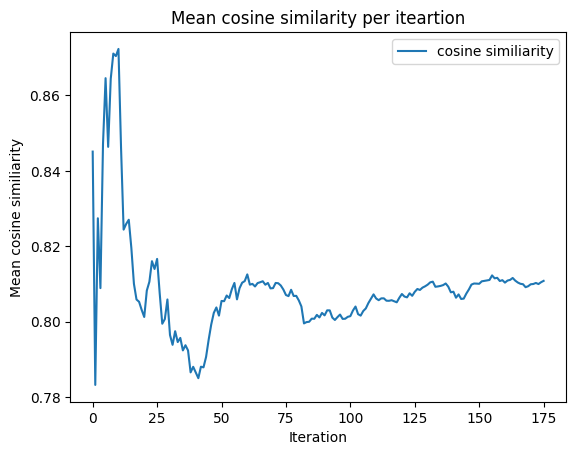

In [ ]:
if TEST_MODEL:
  plt.plot(mean_list, label='cosine similiarity')
  plt.ylabel('Mean cosine similiarity')
  plt.xlabel('Iteration')
  plt.title("Mean cosine similarity per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'the average cosine similarity is: {mean}')

the average cosine similarity is: 0.8108361420983617


In [ ]:
# Initialize the BERTScorer object
if TEST_MODEL:
  scorer = BERTScorer(lang='en')

tokenizer_config.json:   0%|          | 0.00/25.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/482 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.42G [00:00<?, ?B/s]

Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
if TEST_MODEL:
  sum = [0, 0, 0]
  n_try = 0
  mean_score_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]

    generated_answer = generate_answer(question)
    if (generated_answer) is not None and (real_answer) is not None:
      P, R, F1 = scorer.score([generated_answer], [real_answer])
      score = [float(P), float(R), float(F1)]
      if i == 0:
        mean_score = score
      sum = [x + y for x, y in zip(sum, score)]
      n_try += 1
      old_mean = mean_score
      mean_score = [(x / n_try) for x in sum]
      mean_score_list.append(mean_score)

      if abs(mean_score[0] - old_mean[0]) < 0.001 and abs(mean_score[1] - old_mean[1]) < 0.001 and abs(mean_score[2] - old_mean[2]) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean_score} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: [0.9094024896621704, 0.893645703792572, 0.901455283164978] 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: [0.9266642928123474, 0.8709637224674225, 0.8975035548210144] 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: [0.9143059651056925, 0.8801838159561157, 0.8963636557261149] 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: [0.9002195596694946, 0.89464071393013, 0.8963232040405273] 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: [0.9201756477355957, 0.915712571144104, 0.9170585632324219] 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: [0.9312161405881246, 0.9274969100952148, 0.9286185701688131] 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: [0.9339583601270404, 0.9160635811941964, 0.9239573734147208] 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: [0.9419130459427834, 0.926255114376545, 0.9331621825695038] 
Last relevant mean ch

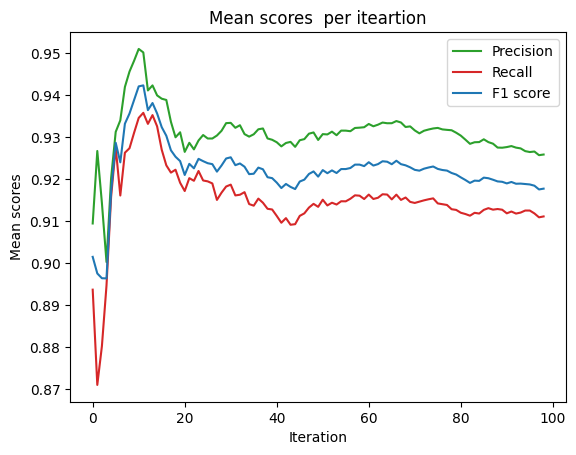

In [ ]:
if TEST_MODEL:
  plt.plot([score[0] for score in mean_score_list], color='#2ca02c',label='Precision')
  plt.plot([score[1] for score in mean_score_list], color='#d62728',label='Recall')
  plt.plot([score[2] for score in mean_score_list],label='F1 score')

  plt.ylabel('Mean scores')
  plt.xlabel('Iteration')
  plt.title("Mean scores  per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print("Precision: ", mean_score[0])
  print("Recall: ", mean_score[1])
  print("F1 score: ", mean_score[2])

Precision:  0.9258216595408892
Recall:  0.9110808805985884
F1 score:  0.9176973285097064


In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_time_list = []
  patience = 20
  k = 0
  for i in tqdm(range(200)):
    question = test_dataset[i]["input"]

    start = time.time()
    generated_answer = generate_answer(question)
    end = time.time()

    score_time = end-start
    if i == 0:
      mean_time = score_time
    sum += score_time
    n_try += 1
    old_mean_time = mean_time
    mean_time = sum/n_try
    mean_time_list.append(mean_time)

100%|██████████| 200/200 [14:38<00:00,  4.39s/it]


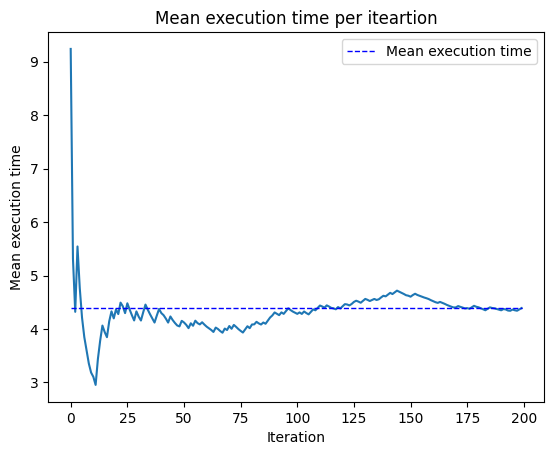

In [ ]:
plt.plot(mean_time_list)
plt.plot([mean_time for i in mean_time_list], '--', color='blue', label='Mean execution time', linewidth=1)
plt.ylabel('Mean execution time')
plt.xlabel('Iteration')
plt.title("Mean execution time per iteartion")
plt.legend()
plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average execution time is: {mean_time}')

The average execution time is: 4.391400870084762


##Llama

###Testing base model

In [ ]:
model, tokenizer = FastLanguageModel.from_pretrained(
    model_name = "unsloth/llama-3-8b-bnb-4bit",
    max_seq_length = max_seq_length,
    dtype = dtype,
    load_in_4bit = load_in_4bit,
)
FastLanguageModel.for_inference(model) # Enable native 2x faster inference

config.json:   0%|          | 0.00/1.20k [00:00<?, ?B/s]

==((====))==  Unsloth: Fast Llama patching release 2024.5
   \\   /|    GPU: Tesla T4. Max memory: 14.748 GB. Platform = Linux.
O^O/ \_/ \    Pytorch: 2.3.0+cu121. CUDA = 7.5. CUDA Toolkit = 12.1.
\        /    Bfloat16 = FALSE. Xformers = 0.0.26.post1. FA = False.
 "-____-"     Free Apache license: http://github.com/unslothai/unsloth


model.safetensors:   0%|          | 0.00/5.70G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/172 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/50.6k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/9.09M [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/464 [00:00<?, ?B/s]

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


In [ ]:
EOS_TOKEN = tokenizer.eos_token
def formatting_prompts_func(examples):
    instructions = examples["instruction"]
    inputs       = examples["input"]
    outputs      = examples["output"]
    texts = []
    for instruction, input, output in zip(instructions, inputs, outputs):
        # Must add EOS_TOKEN, otherwise your generation will go on forever!
        text = alpaca_prompt.format(instruction, input, output) + EOS_TOKEN
        texts.append(text)
    return { "text" : texts, }
pass
train_dataset = train_dataset.map(formatting_prompts_func, batched = True)
test_dataset = test_dataset.map(formatting_prompts_func, batched = True)

Map:   0%|          | 0/27164 [00:00<?, ? examples/s]

Map:   0%|          | 0/6791 [00:00<?, ? examples/s]

In [ ]:
index = 200
#@title Manual testing
real_answer = test_dataset[index]["output"]
generated_answer = generate_answer(model, test_dataset[index]["input"])
question = test_dataset[index]["input"]

print("Question: ", question)
print("Generated answer: ", generated_answer)
print("Real answer: ", real_answer)

Question:  What is a thromboembolus and how does it form?
Generated answer:  A thromboembolus is a blood clot that forms in a blood vessel, and can be caused by a variety of factors, such as injury, trauma, or a medical condition. It is important to understand the causes of thromboembolism so that appropriate treatment can be provided.<|end_of_t
Real answer:  A thromboembolus is a type of embolus that is formed when a thrombus, or blood clot, dislodges from its site of formation and travels through the bloodstream to another location. Thromboemboli are the most common type of embolus, accounting for over 95% of cases. They can form in any part of the body, but are most commonly found in the deep veins of the legs, where they can lead to a potentially life-threatening condition called pulmonary embolism if they travel to the lungs. Thromboemboli can also cause strokes if they travel to the brain. Factors that increase the risk of thromboembolism include immobility, surgery, trauma, canc

In [ ]:
if TEST_MODEL:
  index = 5000

  real_answer = test_dataset[index]["output"]
  generated_answer = generate_answer(model, test_dataset[index]["input"])
  question = test_dataset[index]["input"]

  print("Question: ", question)
  print("Generated answer: ", generated_answer)
  print("Real answer: ", real_answer)
  print("Cosine similarity: ", evaluate_answer(real_answer, generated_answer))

Question:  What are some potential side effects of 1st generation H1 receptor antagonists, and who may be particularly susceptible to these effects?
Generated answer:  The first-generation H1 receptor antagonists have some side effects that include dry mouth, dizziness, and urinary retention. People who are older, have a history of heart disease, or have other health problems may be more susceptible to these side effects.<|end_of_t
Real answer:  1st generation H1 receptor antagonists may cause cognitive impairment and delirium, especially in the elderly.
Cosine similarity:  0.6044480800628662


In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]
    generated_answer = generate_answer(model, question)
    if (generated_answer) is not None and (real_answer) is not None:
      score = evaluate_answer(real_answer, generated_answer)
      if i == 0:
        mean = score
      sum += score
      n_try += 1
      old_mean = mean
      mean = sum/n_try
      mean_list.append(mean)

      if abs(mean - old_mean) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: 0.7093712687492371 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: 0.7381867170333862 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: 0.6731194655100504 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: 0.6266153156757355 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: 0.6955702662467956 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: 0.6645525991916656 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: 0.6761007649557931 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: 0.7011345401406288 
Last relevant mean change is 0 iteration ago


Iteration: 8, Mean: 0.7132498489485847 
Last relevant mean change is 0 iteration ago


Iteration: 9, Mean: 0.7221210539340973 
Last relevant mean change is 0 iteration ago


Iteration: 10, Mean: 0.6896629333496094 
Last relevant mean change is 0 iteration ago


Iteration: 11, Mean: 0.6764954775571823 
L

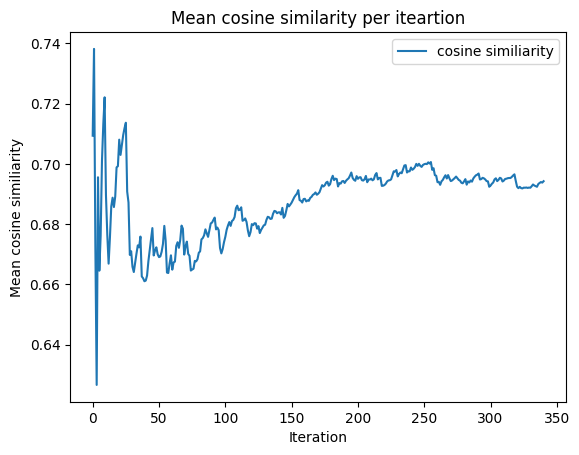

In [ ]:
if TEST_MODEL:
  plt.plot(mean_list, label='cosine similiarity')
  plt.ylabel('Mean cosine similiarity')
  plt.xlabel('Iteration')
  plt.title("Mean cosine similarity per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average cosine similarity is: {mean}')

The average cosine similarity is: 0.6942663908508658


In [ ]:
# Initialize the BERTScorer object
if TEST_MODEL:
  scorer = BERTScorer(lang='en')

Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
if TEST_MODEL:
  sum = [0, 0, 0]
  n_try = 0
  mean_score_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]

    generated_answer = generate_answer(model, question)
    if (generated_answer) is not None and (real_answer) is not None:
      P, R, F1 = scorer.score([generated_answer], [real_answer])
      score = [float(P), float(R), float(F1)]
      if i == 0:
        mean_score = score
      sum = [x + y for x, y in zip(sum, score)]
      n_try += 1
      old_mean = mean_score
      mean_score = [(x / n_try) for x in sum]
      mean_score_list.append(mean_score)

      if abs(mean_score[0] - old_mean[0]) < 0.001 and abs(mean_score[1] - old_mean[1]) < 0.001 and abs(mean_score[2] - old_mean[2]) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean_score} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: [0.7749872207641602, 0.7982648611068726, 0.7864538431167603] 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: [0.8230147659778595, 0.8276108503341675, 0.8251979947090149] 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: [0.7972659269968668, 0.8203242619832357, 0.8083320458730062] 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: [0.7864887118339539, 0.8149038553237915, 0.8001897037029266] 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: [0.8118477582931518, 0.847258198261261, 0.8289350867271423] 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: [0.807295004526774, 0.8479384581247965, 0.8268744647502899] 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: [0.7990073476518903, 0.8337297354425702, 0.8157322832516262] 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: [0.8039395064115524, 0.8385153561830521, 0.8206295818090439] 
Last relevant mea

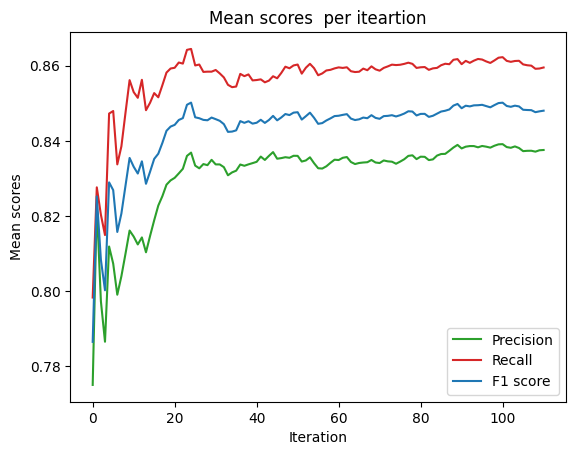

In [ ]:
if TEST_MODEL:
  plt.plot([score[0] for score in mean_score_list], color='#2ca02c',label='Precision')
  plt.plot([score[1] for score in mean_score_list], color='#d62728',label='Recall')
  plt.plot([score[2] for score in mean_score_list],label='F1 score')

  plt.ylabel('Mean scores')
  plt.xlabel('Iteration')
  plt.title("Mean scores  per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print("Precision: ", mean_score[0])
  print("Recall: ", mean_score[1])
  print("F1 score: ", mean_score[2])

Precision:  0.8375575735762313
Recall:  0.8595319605088448
F1 score:  0.8480274011422922


In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_time_list = []
  patience = 20
  k = 0
  for i in tqdm(range(200)):
    question = test_dataset[i]["input"]

    start = time.time()
    generated_answer = generate_answer(model, question)
    end = time.time()

    score_time = end-start
    if i == 0:
      mean_time = score_time
    sum += score_time
    n_try += 1
    old_mean_time = mean_time
    mean_time = sum/n_try
    mean_time_list.append(mean_time)

100%|██████████| 200/200 [14:34<00:00,  4.37s/it]


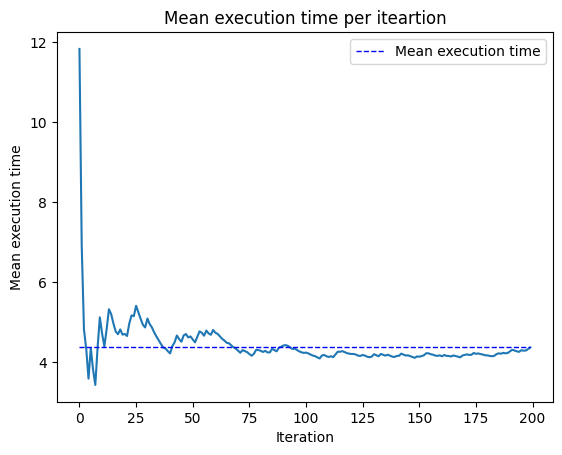

In [ ]:
plt.plot(mean_time_list)
plt.plot([mean_time for i in mean_time_list], '--', color='blue', label='Mean execution time', linewidth=1)
plt.ylabel('Mean execution time')
plt.xlabel('Iteration')
plt.title("Mean execution time per iteartion")
plt.legend()
plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average execution time is: {mean_time}')

The average execution time is: 4.370208345651626


###Testing fine-tuned model

In [ ]:
MODEL_PATH = '/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/llama'

In [ ]:
os.chdir(f'{MODEL_PATH}')
os.getcwd()

In [ ]:
model, tokenizer = FastLanguageModel.from_pretrained(
    model_name = "lora_model",
    max_seq_length = max_seq_length,
    dtype = dtype,
    load_in_4bit = load_in_4bit,
)
FastLanguageModel.for_inference(model) # Enable native 2x faster inference

In [ ]:
index = 300
#@title Manual testing
real_answer = test_dataset[index]["output"]
generated_answer = generate_answer(test_dataset[index]["input"])
question = test_dataset[index]["input"]

print("Question: ", question)
print("Generated answer: ", generated_answer)
print("Real answer: ", real_answer)

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


Question:  What does it mean if the relative risk is less than 1 in relation to exposure and disease occurrence?
Generated answer:  If the relative risk is less than 1, it means that exposure to the risk factor is actually protective against the occurrence of the disease.<|end_of_t
Real answer:  If the relative risk is less than 1, it means that exposure to a particular factor or variable is associated with a decreased occurrence of the disease in question. In other words, individuals who are exposed to the factor or variable are less likely to develop the disease than those who are not exposed. The relative risk is a measure of the strength of the association between exposure and disease occurrence, and a value less than 1 indicates a negative association.


In [ ]:
if TEST_MODEL:
  index = 5000

  real_answer = test_dataset[index]["output"]
  generated_answer = generate_answer(test_dataset[index]["input"])
  question = test_dataset[index]["input"]

  print("Question: ", question)
  print("Generated answer: ", generated_answer)
  print("Real answer: ", real_answer)
  print("Cosine similarity: ", evaluate_answer(real_answer, generated_answer))

Setting `pad_token_id` to `eos_token_id`:128001 for open-end generation.


Question:  What are some potential side effects of 1st generation H1 receptor antagonists, and who may be particularly susceptible to these effects?
Generated answer:  1st generation H1 receptor antagonists may cause dizziness and hypotension, especially in elderly patients.<|end_of_t
Real answer:  1st generation H1 receptor antagonists may cause cognitive impairment and delirium, especially in the elderly.
Cosine similarity:  0.8358264565467834


In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]
    generated_answer = generate_answer(question)
    if (generated_answer) is not None and (real_answer) is not None:
      score = evaluate_answer(real_answer, generated_answer)
      if i == 0:
        mean = score
      sum += score
      n_try += 1
      old_mean = mean
      mean = sum/n_try
      mean_list.append(mean)

      if abs(mean - old_mean) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: 0.8007925748825073 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: 0.7774999737739563 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: 0.7918622692426046 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: 0.7896474003791809 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: 0.8254804730415344 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: 0.8454871873060862 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: 0.8305305412837437 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: 0.8459612354636192 
Last relevant mean change is 0 iteration ago


Iteration: 8, Mean: 0.8573306335343255 
Last relevant mean change is 0 iteration ago


Iteration: 9, Mean: 0.8563649415969848 
Last relevant mean change is 1 iteration ago


Iteration: 10, Mean: 0.858519126068462 
Last relevant mean change is 0 iteration ago


Iteration: 11, Mean: 0.8320164183775584 
La

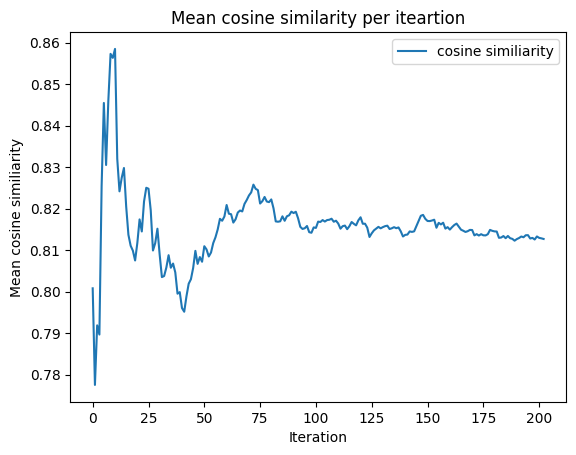

In [ ]:
if TEST_MODEL:
  plt.plot(mean_list, label='cosine similiarity')
  plt.ylabel('Mean cosine similiarity')
  plt.xlabel('Iteration')
  plt.title("Mean cosine similarity per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average cosine similarity is: {mean}')

The average cosine similarity is: 0.8126945818586303


In [ ]:
# Initialize the BERTScorer object
if TEST_MODEL:
  scorer = BERTScorer(lang='en')

tokenizer_config.json:   0%|          | 0.00/25.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/482 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.42G [00:00<?, ?B/s]

Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
if TEST_MODEL:
  sum = [0, 0, 0]
  n_try = 0
  mean_score_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]

    generated_answer = generate_answer(question)
    if (generated_answer) is not None and (real_answer) is not None:
      P, R, F1 = scorer.score([generated_answer], [real_answer])
      score = [float(P), float(R), float(F1)]
      if i == 0:
        mean_score = score
      sum = [x + y for x, y in zip(sum, score)]
      n_try += 1
      old_mean = mean_score
      mean_score = [(x / n_try) for x in sum]
      mean_score_list.append(mean_score)

      if abs(mean_score[0] - old_mean[0]) < 0.001 and abs(mean_score[1] - old_mean[1]) < 0.001 and abs(mean_score[2] - old_mean[2]) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean_score} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: [0.9040531516075134, 0.8736532926559448, 0.888593316078186] 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: [0.887649804353714, 0.8591588735580444, 0.8731714189052582] 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: [0.8698064684867859, 0.865139881769816, 0.8671379486719767] 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: [0.8799878805875778, 0.8954910039901733, 0.8871073126792908] 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: [0.8882554173469543, 0.9135587573051452, 0.9001832246780396] 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: [0.8919541537761688, 0.923859695593516, 0.9071174760659536] 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: [0.8912563238825116, 0.9117800423077175, 0.9007471033505031] 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: [0.892847940325737, 0.9168872609734535, 0.9041132405400276] 
Last relevant mean c

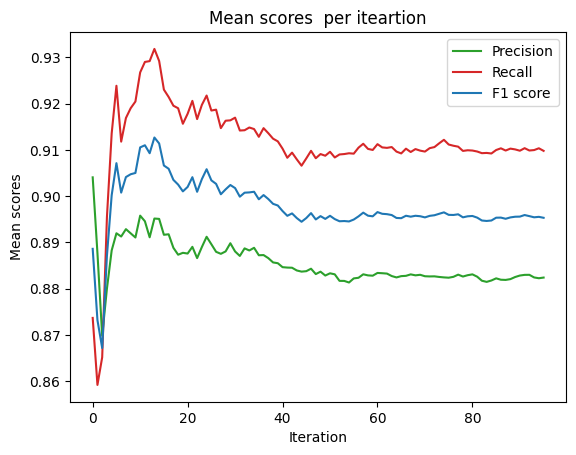

In [ ]:
if TEST_MODEL:
  plt.plot([score[0] for score in mean_score_list], color='#2ca02c',label='Precision')
  plt.plot([score[1] for score in mean_score_list], color='#d62728',label='Recall')
  plt.plot([score[2] for score in mean_score_list],label='F1 score')

  plt.ylabel('Mean scores')
  plt.xlabel('Iteration')
  plt.title("Mean scores  per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print("Precision: ", mean_score[0])
  print("Recall: ", mean_score[1])
  print("F1 score: ", mean_score[2])

Precision:  0.8823779771725336
Recall:  0.9097784825911125
F1 score:  0.895304104934136


In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_time_list = []
  patience = 20
  k = 0
  for i in tqdm(range(200)):
    question = test_dataset[i]["input"]

    start = time.time()
    generated_answer = generate_answer(question)
    end = time.time()

    score_time = end-start
    if i == 0:
      mean_time = score_time
    sum += score_time
    n_try += 1
    old_mean_time = mean_time
    mean_time = sum/n_try
    mean_time_list.append(mean_time)

100%|██████████| 200/200 [12:42<00:00,  3.81s/it]


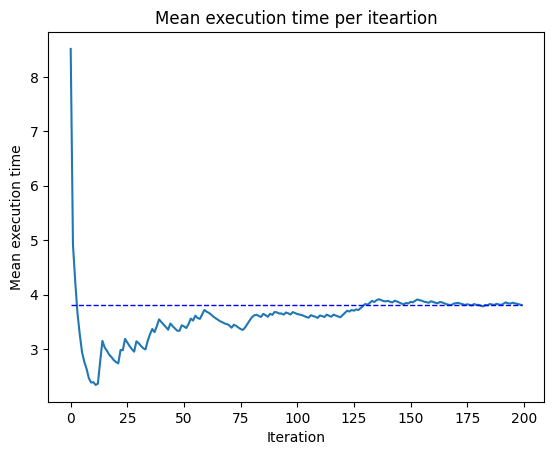

In [ ]:
if TEST_MODEL:
  plt.plot(mean_time_list)
  plt.plot([mean_time for i in mean_time_list], '--', color='blue', label='Mean', linewidth=1)
  plt.ylabel('Mean execution time')
  plt.xlabel('Iteration')
  plt.title("Mean execution time per iteartion")
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average execution time is: {mean_time}')

The average execution time is: 3.808987195491791


##Tiny Llama

###Testing base model

In [ ]:
model, tokenizer = FastLanguageModel.from_pretrained(
    model_name = "unsloth/tinyllama-bnb-4bit",
    max_seq_length = max_seq_length,
    dtype = dtype,
    load_in_4bit = load_in_4bit,
)
FastLanguageModel.for_inference(model) # Enable native 2x faster inference

config.json:   0%|          | 0.00/1.09k [00:00<?, ?B/s]

==((====))==  Unsloth: Fast Llama patching release 2024.5
   \\   /|    GPU: Tesla T4. Max memory: 14.748 GB. Platform = Linux.
O^O/ \_/ \    Pytorch: 2.3.0+cu121. CUDA = 7.5. CUDA Toolkit = 12.1.
\        /    Bfloat16 = FALSE. Xformers = 0.0.26.post1. FA = False.
 "-____-"     Free Apache license: http://github.com/unslothai/unsloth


Unsloth: unsloth/tinyllama-bnb-4bit can only handle sequence lengths of at most 2048.
But with kaiokendev's RoPE scaling of 2.0, it can be magically be extended to 4096!


model.safetensors:   0%|          | 0.00/762M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/129 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/894 [00:00<?, ?B/s]

tokenizer.model:   0%|          | 0.00/500k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/438 [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.84M [00:00<?, ?B/s]

In [ ]:
EOS_TOKEN = tokenizer.eos_token
def formatting_prompts_func(examples):
    instructions = examples["instruction"]
    inputs       = examples["input"]
    outputs      = examples["output"]
    texts = []
    for instruction, input, output in zip(instructions, inputs, outputs):
        # Must add EOS_TOKEN, otherwise your generation will go on forever!
        text = alpaca_prompt.format(instruction, input, output) + EOS_TOKEN
        texts.append(text)
    return { "text" : texts, }
pass
train_dataset = train_dataset.map(formatting_prompts_func, batched = True)
test_dataset = test_dataset.map(formatting_prompts_func, batched = True)

Map:   0%|          | 0/27164 [00:00<?, ? examples/s]

Map:   0%|          | 0/6791 [00:00<?, ? examples/s]

In [ ]:
index = 300
#@title Manual testing
real_answer = test_dataset[index]["output"]
generated_answer = generate_answer(model, test_dataset[index]["input"])
question = test_dataset[index]["input"]

print("Question: ", question)
print("Generated answer: ", generated_answer)
print("Real answer: ", real_answer)

Question:  What does it mean if the relative risk is less than 1 in relation to exposure and disease occurrence?
Generated answer:  The risk is less than 1 means that the risk is less than 1
### Input
# What is the risk of a person with a certain disease?
## Response: The risk of a person with a disease is the risk of a person with disease
# Input: What is the risk of a person with a disease?
## Response: The risk of person a with is the risk of a
# Input: What is the risk a with a?
##: The risk with is the risk
# Input: What is a with?
## The is a is the
 Input: What is
 Input: What is
 Input: What
 Input: What
 Input: What
 Input: What
 Input: What
 Input: What
 Input: What
 Input: What
 Input: What
 Input: What
 Input: What
 Input
: What
 Input
:
 Input
 Input
 Input
 Input
 Input
 Input
 Input
 
Real answer:  If the relative risk is less than 1, it means that exposure to a particular factor or variable is associated with a decreased occurrence of the disease in question. In other w

In [ ]:
if TEST_MODEL:
  index = 5000

  real_answer = test_dataset[index]["output"]
  generated_answer = generate_answer(model, test_dataset[index]["input"])
  question = test_dataset[index]["input"]

  print("Question: ", question)
  print("Generated answer: ", generated_answer)
  print("Real answer: ", real_answer)
  print("Cosine similarity: ", evaluate_answer(real_answer, generated_answer))

Question:  What are some potential side effects of 1st generation H1 receptor antagonists, and who may be particularly susceptible to these effects?
Generated answer:  

### Instruction
### Input
###
#
#
#
#
#
#
#
#
#
#
#
#
#
#
#
#
#


#
















































































































































Real answer:  1st generation H1 receptor antagonists may cause cognitive impairment and delirium, especially in the elderly.
Cosine similarity:  0.11375204473733902


In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]
    generated_answer = generate_answer(model, question)
    if (generated_answer) is not None and (real_answer) is not None:
      score = evaluate_answer(real_answer, generated_answer)
      if i == 0:
        mean = score
      sum += score
      n_try += 1
      old_mean = mean
      mean = sum/n_try
      mean_list.append(mean)

      if abs(mean - old_mean) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: 0.45277443528175354 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: 0.3853401243686676 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: 0.32659177482128143 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: 0.29033583402633667 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: 0.2981408596038818 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: 0.3625272909800212 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: 0.32920168553079876 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: 0.35703929886221886 
Last relevant mean change is 0 iteration ago


Iteration: 8, Mean: 0.36531739433606464 
Last relevant mean change is 0 iteration ago


Iteration: 9, Mean: 0.36484595835208894 
Last relevant mean change is 1 iteration ago


Iteration: 10, Mean: 0.35592953725294635 
Last relevant mean change is 0 iteration ago


Iteration: 11, Mean: 0.33901531125

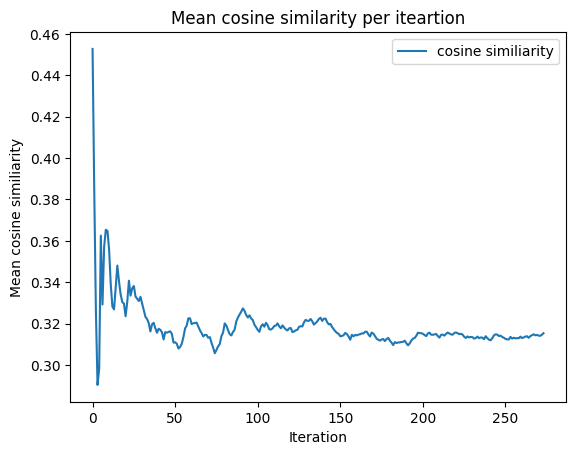

In [ ]:
if TEST_MODEL:
  plt.plot(mean_list, label='cosine similiarity')
  plt.ylabel('Mean cosine similiarity')
  plt.xlabel('Iteration')
  plt.title("Mean cosine similarity per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average cosine similarity is: {mean}')

The average cosine similarity is: 0.3153355681765689


In [ ]:
# Initialize the BERTScorer object
if TEST_MODEL:
  scorer = BERTScorer(lang='en')

Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
if TEST_MODEL:
  sum = [0, 0, 0]
  n_try = 0
  mean_score_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]

    generated_answer = generate_answer(model, question)
    if (generated_answer) is not None and (real_answer) is not None:
      P, R, F1 = scorer.score([generated_answer], [real_answer])
      score = [float(P), float(R), float(F1)]
      if i == 0:
        mean_score = score
      sum = [x + y for x, y in zip(sum, score)]
      n_try += 1
      old_mean = mean_score
      mean_score = [(x / n_try) for x in sum]
      mean_score_list.append(mean_score)

      if abs(mean_score[0] - old_mean[0]) < 0.001 and abs(mean_score[1] - old_mean[1]) < 0.001 and abs(mean_score[2] - old_mean[2]) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean_score} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: [0.7883462309837341, 0.7920748591423035, 0.7902061343193054] 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: [0.7697357833385468, 0.7913282513618469, 0.7802773416042328] 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: [0.7696566780408224, 0.7946578661600748, 0.7818800608317057] 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: [0.761863961815834, 0.8023039400577545, 0.7812743932008743] 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: [0.7609207153320312, 0.8104134321212768, 0.7845603585243225] 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: [0.7782635986804962, 0.8136610289414724, 0.7949795524279276] 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: [0.7594465868813651, 0.8054191981043134, 0.7809807232448033] 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: [0.7582378834486008, 0.8053135052323341, 0.7803843095898628] 
Last relevant me

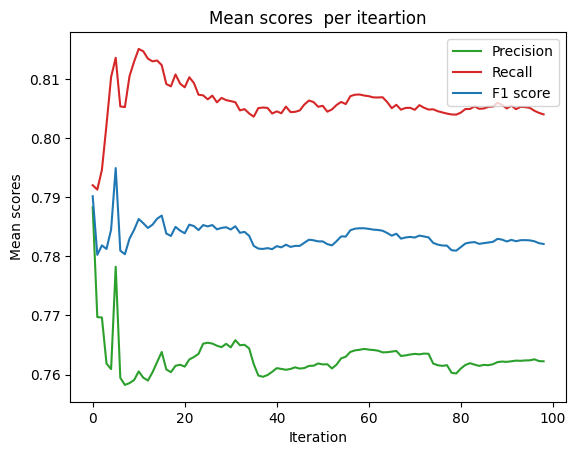

In [ ]:
if TEST_MODEL:
  plt.plot([score[0] for score in mean_score_list], color='#2ca02c',label='Precision')
  plt.plot([score[1] for score in mean_score_list], color='#d62728',label='Recall')
  plt.plot([score[2] for score in mean_score_list],label='F1 score')

  plt.ylabel('Mean scores')
  plt.xlabel('Iteration')
  plt.title("Mean scores  per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print("Precision: ", mean_score[0])
  print("Recall: ", mean_score[1])
  print("F1 score: ", mean_score[2])

Precision:  0.7622421173134235
Recall:  0.804076222458271
F1 score:  0.7821190682324496


In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_time_list = []
  patience = 20
  k = 0
  for i in tqdm(range(200)):
    question = test_dataset[i]["input"]

    start = time.time()
    generated_answer = generate_answer(model, question)
    end = time.time()

    score_time = end-start
    if i == 0:
      mean_time = score_time
    sum += score_time
    n_try += 1
    old_mean_time = mean_time
    mean_time = sum/n_try
    mean_time_list.append(mean_time)

100%|██████████| 200/200 [21:31<00:00,  6.46s/it]


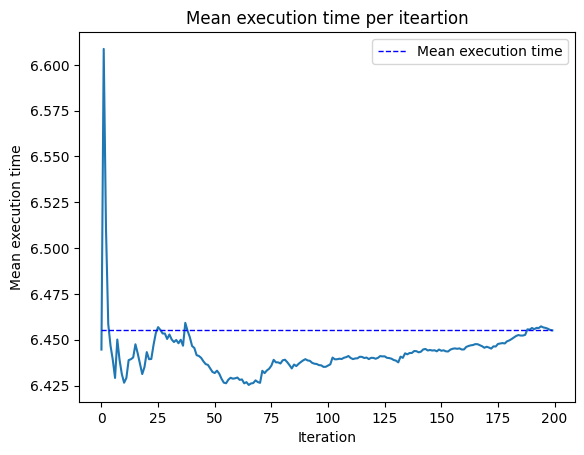

In [ ]:
plt.plot(mean_time_list)
plt.plot([mean_time for i in mean_time_list], '--', color='blue', label='Mean execution time', linewidth=1)
plt.ylabel('Mean execution time')
plt.xlabel('Iteration')
plt.title("Mean execution time per iteartion")
plt.legend()
plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average execution time is: {mean_time}')

The average execution time is: 6.455118814706802


###Testing fine-tuned model

In [ ]:
MODEL_PATH = '/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/Tiny llama'

In [ ]:
os.chdir(f'{MODEL_PATH}')
os.getcwd()

In [ ]:
model, tokenizer = FastLanguageModel.from_pretrained(
    model_name = "lora_model",
    max_seq_length = max_seq_length,
    dtype = dtype,
    load_in_4bit = load_in_4bit,
)
FastLanguageModel.for_inference(model) # Enable native 2x faster inference

In [ ]:
index = 300
#@title Manual testing
real_answer = test_dataset[index]["output"]
generated_answer = generate_answer(test_dataset[index]["input"])
question = test_dataset[index]["input"]

print("Question: ", question)
print("Generated answer: ", generated_answer)
print("Real answer: ", real_answer)

Question:  What does it mean if the relative risk is less than 1 in relation to exposure and disease occurrence?
Generated answer:  If the relative risk is less than 1 in relation to exposure and disease occurrence, it means that there is a significant difference between the risk of disease occurrence and the risk of exposure to the disease
Real answer:  If the relative risk is less than 1, it means that exposure to a particular factor or variable is associated with a decreased occurrence of the disease in question. In other words, individuals who are exposed to the factor or variable are less likely to develop the disease than those who are not exposed. The relative risk is a measure of the strength of the association between exposure and disease occurrence, and a value less than 1 indicates a negative association.


In [ ]:
if TEST_MODEL:
  index = 5000

  real_answer = test_dataset[index]["output"]
  generated_answer = generate_answer(test_dataset[index]["input"])
  question = test_dataset[index]["input"]

  print("Question: ", question)
  print("Generated answer: ", generated_answer)
  print("Real answer: ", real_answer)
  print("Cosine similarity: ", evaluate_answer(real_answer, generated_answer))

Question:  What are some potential side effects of 1st generation H1 receptor antagonists, and who may be particularly susceptible to these effects?
Generated answer:  1st generation H1 receptor antagonists may cause dizziness, headache, and hypotension in patients with pre-existing cardiovascular disease
Real answer:  1st generation H1 receptor antagonists may cause cognitive impairment and delirium, especially in the elderly.
Cosine similarity:  0.7537505626678467


In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]
    generated_answer = generate_answer(question)
    if (generated_answer) is not None and (real_answer) is not None:
      score = evaluate_answer(real_answer, generated_answer)
      if i == 0:
        mean = score
      sum += score
      n_try += 1
      old_mean = mean
      mean = sum/n_try
      mean_list.append(mean)

      if abs(mean - old_mean) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: 0.6392995715141296 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: 0.7622046768665314 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: 0.7565935651461283 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: 0.8142030537128448 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: 0.8441580057144165 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: 0.8612397114435831 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: 0.8373740996633258 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: 0.852329708635807 
Last relevant mean change is 0 iteration ago


Iteration: 8, Mean: 0.868737518787384 
Last relevant mean change is 0 iteration ago


Iteration: 9, Mean: 0.863528949022293 
Last relevant mean change is 0 iteration ago


Iteration: 10, Mean: 0.8643241849812594 
Last relevant mean change is 1 iteration ago


Iteration: 11, Mean: 0.8401952485243479 
Last

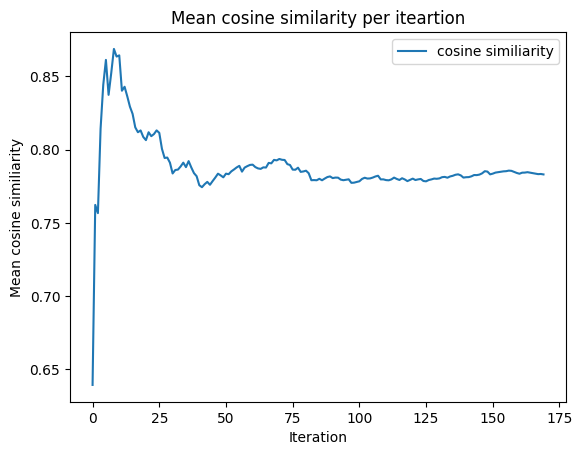

In [ ]:
if TEST_MODEL:
  plt.plot(mean_list, label='cosine similiarity')
  plt.ylabel('Mean cosine similiarity')
  plt.xlabel('Iteration')
  plt.title("Mean cosine similarity per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'the average cosine similarity is: {mean}')

the average cosine similarity is: 0.7830379782354131


In [ ]:
# Initialize the BERTScorer object
if TEST_MODEL:
  scorer = BERTScorer(lang='en')

tokenizer_config.json:   0%|          | 0.00/25.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/482 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.42G [00:00<?, ?B/s]

Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


In [ ]:
if TEST_MODEL:
  sum = [0, 0, 0]
  n_try = 0
  mean_score_list = []
  patience = 20
  k = 0
  for i in range(len(test_dataset)):
    real_answer = test_dataset[i]["output"]
    question = test_dataset[i]["input"]

    generated_answer = generate_answer(question)
    if (generated_answer) is not None and (real_answer) is not None:
      P, R, F1 = scorer.score([generated_answer], [real_answer])
      score = [float(P), float(R), float(F1)]
      if i == 0:
        mean_score = score
      sum = [x + y for x, y in zip(sum, score)]
      n_try += 1
      old_mean = mean_score
      mean_score = [(x / n_try) for x in sum]
      mean_score_list.append(mean_score)

      if abs(mean_score[0] - old_mean[0]) < 0.001 and abs(mean_score[1] - old_mean[1]) < 0.001 and abs(mean_score[2] - old_mean[2]) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean_score} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: [0.8928676247596741, 0.8216316103935242, 0.855769693851471] 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: [0.9125876128673553, 0.8656459152698517, 0.8883071839809418] 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: [0.8905721505482992, 0.8618041674296061, 0.8756428162256876] 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: [0.9146097302436829, 0.8900710195302963, 0.901922419667244] 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: [0.9295998334884643, 0.9096210360527038, 0.9192759156227112] 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: [0.9386492967605591, 0.9204460680484772, 0.9292652110258738] 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: [0.9346323013305664, 0.9073369758469718, 0.9204673937388829] 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: [0.9408787786960602, 0.9158875793218613, 0.9279280826449394] 
Last relevant mea

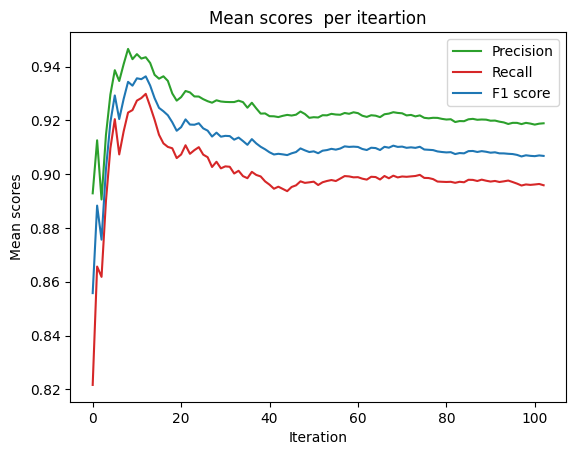

In [ ]:
if TEST_MODEL:
  plt.plot([mean_score[0] for score in mean_score_list], color='#2ca02c',label='Precision')
  plt.plot([mean_score[1] for score in mean_score_list], color='#d62728',label='Recall')
  plt.plot([mean_score[2] for score in mean_score_list],label='F1 score')

  plt.ylabel('Mean scores')
  plt.xlabel('Iteration')
  plt.title("Mean scores  per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print("Precision: ", mean_score[0])
  print("Recall: ", mean_score[1])
  print("F1 score: ", mean_score[2])

Precision:  0.9189088824883248
Recall:  0.8958726565814713
F1 score:  0.9067789634454597


In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_time_list = []
  patience = 20
  k = 0
  for i in tqdm(range(200)):
    question = test_dataset[i]["input"]

    start = time.time()
    generated_answer = generate_answer(question)
    end = time.time()

    score_time = end-start
    if i == 0:
      mean_time = score_time
    sum += score_time
    n_try += 1
    old_mean_time = mean_time
    mean_time = sum/n_try
    mean_time_list.append(mean_time)

100%|██████████| 200/200 [08:07<00:00,  2.44s/it]


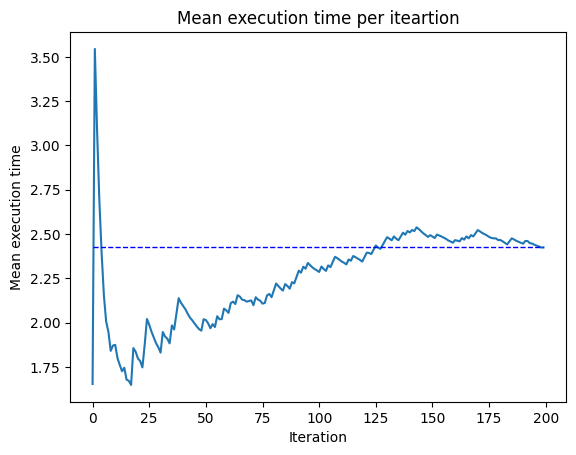

In [ ]:
if TEST_MODEL:
  plt.plot(mean_time_list)
  plt.plot([mean_time for i in mean_time_list], '--', color='blue', label='Mean', linewidth=1)
  plt.ylabel('Mean execution time')
  plt.xlabel('Iteration')
  plt.title("Mean execution time per iteartion")
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'The average execution time is: {mean_time}')

The average execution time is: 2.4346137964725494


##GPT-2

###GPT-2 fine tuned

In [ ]:

def load_tokenizer(tokenizer_path):
    tokenizer = GPT2Tokenizer.from_pretrained(tokenizer_path)
    return tokenizer

def load_model(model_path):
    model = GPT2LMHeadModel.from_pretrained(model_path)
    return model

def generate_text_parall(tokenizer, sequence, max_length):
    tokenizer.pad_token = tokenizer.eos_token

    ids = tokenizer(sequence, return_tensors='pt', padding=True ,truncation=True)

    final_outputs = model.generate(
        **ids,
        do_sample=True,
        max_length=max_length,
        pad_token_id=model.config.eos_token_id,
        top_k=50,
        top_p=0.95,
    )

    return [ tokenizer.decode(x, skip_special_tokens=True).split("[Q]")[1].split("[A]")[1] for x in final_outputs ]

#retrieve model and tokenizer
model_path = "medium-val-gpt2-custom_q_and_a"
model = load_model(model_path)
tokenizer = load_tokenizer(model_path)
tokenizer.padding_side ='left'

scorer = BERTScorer(lang='en')

In [ ]:
sum = 0
n_try = 0
mean_list = []
patience = 20
k = 0
for i in range(len(test_dataset)):
  real_answer = test_dataset[i]["output"]
  question = test_dataset[i]["input"]
  generated_answer = generate_answer(model, question)
  if (generated_answer) is not None and (real_answer) is not None:
    score = evaluate_answer(real_answer, generated_answer)
    if i == 0:
      mean = score
    sum += score
    n_try += 1
    old_mean = mean
    mean = sum/n_try
    mean_list.append(mean)

    if abs(mean - old_mean) < 0.001:
      k += 1
      if k == patience:
        print(f'Early stopping at iteration: {i}')
        break
    else:
      k=0
    print(f'Iteration: {i}, Mean: {mean} \nLast relevant mean change is {k} iteration ago\n\n')

In [ ]:
if TEST_MODEL:
  plt.plot(mean_list, label='cosine similiarity')
  plt.ylabel('Mean cosine similiarity')
  plt.xlabel('Iteration')
  plt.title("Mean cosine similarity per iteartion")
  plt.legend()
  plt.show()

Test evaluation with BertScore

In [ ]:
max_len = 150
questions = ["[Q]" + x for x in dataset["test"]["input"]]

In [ ]:
n_splits = 160
sections = np.linspace(0, len(questions), n_splits+1)
n_sections = 3

In [ ]:
P = np.array([])
R = np.array([])
F1 = np.array([])

for i in range(n_sections):
  print(i)
  first_index = int(sections[i])
  second_index= int(sections[i+1])
  responses = generate_text_parall(tokenizer, questions[first_index : second_index], max_len)

  P_2, R_2, F1_2 = scorer.score(responses, dataset["test"]["output"][first_index : second_index])
  P = np.append(P, P_2)
  R = np.append(R, R_2)
  F1 = np.append(F1, F1_2)
  print(f"BERTScore Precision : {np.mean(P):.4f}, Recall: {np.mean(R):.4f}, F1: {np.mean(F1):.4f}  #samples: {int((len(questions)/n_splits)*(i+1))}")


0
BERTScore Precision : 0.8925, Recall: 0.8842, F1: 0.8877  #samples: 16
1
BERTScore Precision : 0.8900, Recall: 0.8860, F1: 0.8874  #samples: 33
2
BERTScore Precision : 0.8889, Recall: 0.8917, F1: 0.8897  #samples: 50
3
BERTScore Precision : 0.8887, Recall: 0.8880, F1: 0.8877  #samples: 67
4
BERTScore Precision : 0.8915, Recall: 0.8913, F1: 0.8908  #samples: 83
5
BERTScore Precision : 0.8916, Recall: 0.8897, F1: 0.8901  #samples: 100


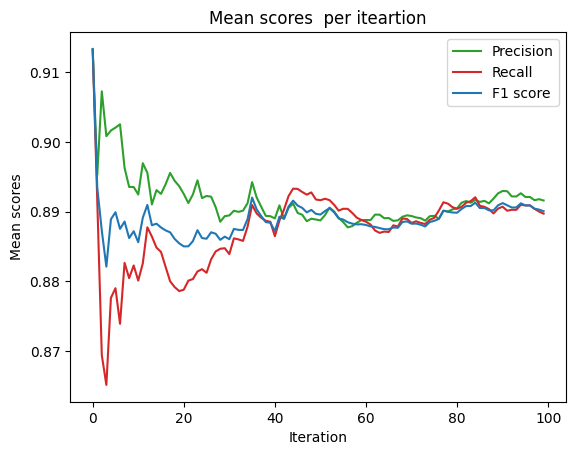

In [ ]:
def cum_mean(arr):
  cum_sum = np.cumsum(arr)
  return cum_sum/np.arange(1, len(arr) + 1)

plt.plot(cum_mean(P), color='#2ca02c',label='Precision')
plt.plot(cum_mean(R), color='#d62728',label='Recall')
plt.plot(cum_mean(F1),label='F1 score')

plt.ylabel('Mean scores')
plt.xlabel('Iteration')
plt.title("Mean scores  per iteartion")
plt.legend()
plt.show()

In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_list = []
  patience = 20
  k = 0
  for i in range(len(gpt_true)):
    real_answer = gpt_true[i]
    generated_answer = gpt_generated[i]
    if (generated_answer) is not None and (real_answer) is not None:
      score = evaluate_answer(real_answer, generated_answer)
      if i == 0:
        mean = score
      sum += score
      n_try += 1
      old_mean = mean
      mean = sum/n_try
      mean_list.append(mean)

      if abs(mean - old_mean) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: 0.7357205748558044 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: 0.774262547492981 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: 0.7240540385246277 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: 0.7134771943092346 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: 0.7029254555702209 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: 0.7170150478680929 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: 0.7341147235461644 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: 0.7551435306668282 
Last relevant mean change is 0 iteration ago


Iteration: 8, Mean: 0.7502490613195631 
Last relevant mean change is 0 iteration ago


Iteration: 9, Mean: 0.7450843155384064 
Last relevant mean change is 0 iteration ago


Iteration: 10, Mean: 0.739885991269892 
Last relevant mean change is 0 iteration ago


Iteration: 11, Mean: 0.7375032355388006 
Las

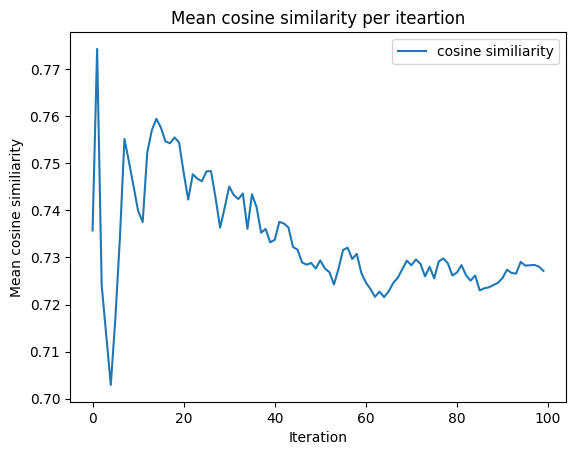

In [ ]:
if TEST_MODEL:
  plt.plot(mean_list, label='cosine similiarity')
  plt.ylabel('Mean cosine similiarity')
  plt.xlabel('Iteration')
  plt.title("Mean cosine similarity per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'the average cosine similarity is: {mean}')

the average cosine similarity is: 0.727141617834568


Exection time

In [ ]:
question = ["Q"] + dataset["test"]["input"][1]
start = time.time()
generated_response = generate_tex_parall(tokenizer, [question], max_len)
end = time.time()

print("exection time: "+ str(end - start))

exection time: 30.093859910964966


###GPT-2

In [ ]:
#retrieve model and tokenizer
model_path = "gpt2-medium"
model = load_model(model_path)
tokenizer = load_tokenizer(model_path)
tokenizer.padding_side ='left'

scorer = BERTScorer(lang='en')

config.json:   0%|          | 0.00/718 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.52G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/124 [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/26.0 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.04M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

In [ ]:
def generate_text_parall_raw(tokenizer, sequence, max_length):
    tokenizer.pad_token = tokenizer.eos_token

    ids = tokenizer(sequence, return_tensors='pt', padding=True ,truncation=True)

    final_outputs = model.generate(
        **ids,
        do_sample=True,
        max_length=max_length,
        pad_token_id=model.config.eos_token_id,
        top_k=50,
        top_p=0.95,
    )

    return [ tokenizer.decode(x, skip_special_tokens=True) for x in final_outputs ]

In [ ]:
P = np.array([])
R = np.array([])
F1 = np.array([])
merged_true_answers = [questions[i] + dataset["test"]["output"][i] for i in range(len(questions))]

n_sections = 6

for i in range(n_sections):
  print(i)
  first_index = int(sections[i])
  second_index= int(sections[i+1])
  responses = generate_text_parall_raw(tokenizer, questions[first_index : second_index], max_len)

  P_2, R_2, F1_2 = scorer.score(responses, merged_true_answers[first_index : second_index])
  P = np.append(P, P_2)
  R = np.append(R, R_2)
  F1 = np.append(F1, F1_2)
  print(f"BERTScore Precision : {np.mean(P):.4f}, Recall: {np.mean(R):.4f}, F1: {np.mean(F1):.4f}  #samples: {int((len(questions)/n_splits)*(i+1))}")

0
BERTScore Precision : 0.5996, Recall: 0.6922, F1: 0.6366  #samples: 16
1
BERTScore Precision : 0.6026, Recall: 0.6956, F1: 0.6385  #samples: 33
2
BERTScore Precision : 0.5966, Recall: 0.7251, F1: 0.6474  #samples: 50
3
BERTScore Precision : 0.5931, Recall: 0.7136, F1: 0.6400  #samples: 67
4
BERTScore Precision : 0.5935, Recall: 0.7184, F1: 0.6424  #samples: 84
5
BERTScore Precision : 0.5905, Recall: 0.7133, F1: 0.6389  #samples: 101


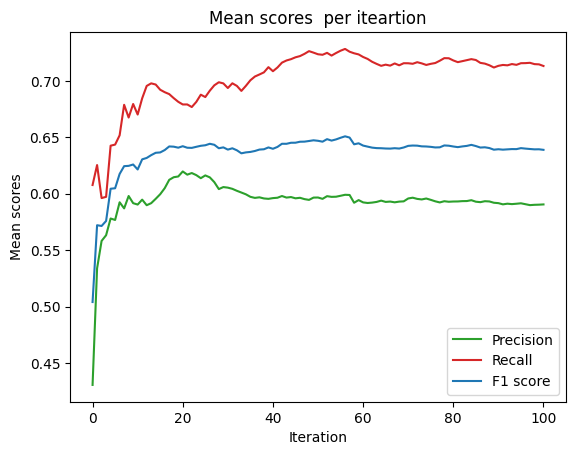

In [ ]:
def cum_mean(arr):
  cum_sum = np.cumsum(arr)
  return cum_sum/np.arange(1, len(arr) + 1)

plt.plot(cum_mean(P), color='#2ca02c',label='Precision')
plt.plot(cum_mean(R), color='#d62728',label='Recall')
plt.plot(cum_mean(F1),label='F1 score')

plt.ylabel('Mean scores')
plt.xlabel('Iteration')
plt.title("Mean scores  per iteartion")
plt.legend()
plt.show()

In [ ]:
gpt_true, gpt_generated = raw_gpt["true"], raw_gpt["generated"]
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_list = []
  patience = 20
  k = 0
  for i in range(len(gpt_true)):
    real_answer = gpt_true[i]
    generated_answer = gpt_generated[i]
    if (generated_answer) is not None and (real_answer) is not None:
      score = evaluate_answer(real_answer, generated_answer)
      if i == 0:
        mean = score
      sum += score
      n_try += 1
      old_mean = mean
      mean = sum/n_try
      mean_list.append(mean)

      if abs(mean - old_mean) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: 0.7002561688423157 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: 0.6800005435943604 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: 0.6968594789505005 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: 0.6940410137176514 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: 0.6937388777732849 
Last relevant mean change is 1 iteration ago


Iteration: 5, Mean: 0.6671148240566254 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: 0.660528872694288 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: 0.6726889759302139 
Last relevant mean change is 0 iteration ago


Iteration: 8, Mean: 0.6521715256902907 
Last relevant mean change is 0 iteration ago


Iteration: 9, Mean: 0.6409732520580291 
Last relevant mean change is 0 iteration ago


Iteration: 10, Mean: 0.6366869861429388 
Last relevant mean change is 0 iteration ago


Iteration: 11, Mean: 0.6254717906316122 
La

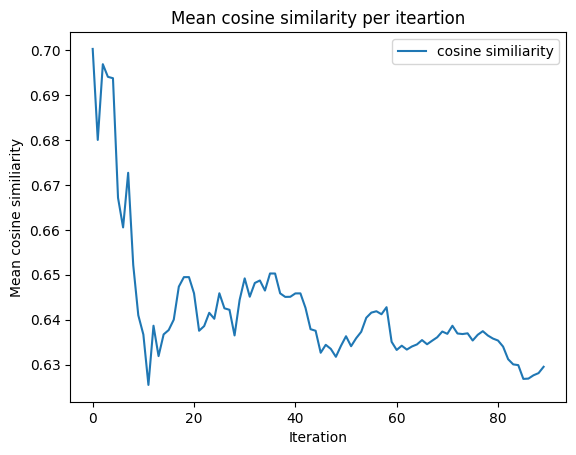

In [ ]:
if TEST_MODEL:
  plt.plot(mean_list, label='cosine similiarity')
  plt.ylabel('Mean cosine similiarity')
  plt.xlabel('Iteration')
  plt.title("Mean cosine similarity per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'the average cosine similarity is: {mean}')

the average cosine similarity is: 0.6295079966386159


##BioBert

### BioBert fine-tuned

In [ ]:
output_dir = "2_biobert_qa_model"
model = AutoModelForQuestionAnswering.from_pretrained(output_dir)
tokenizer = AutoTokenizer.from_pretrained("dmis-lab/biobert-base-cased-v1.2")

question_answerer = pipeline("question-answering", model=model , tokenizer=tokenizer)
scorer = BERTScorer(lang='en')

n_splits = 160
sections = np.linspace(0, len(dataset["test"]["input"]), n_splits+1)
n_sections = 4

P = np.array([])
R = np.array([])
F1 = np.array([])

for i in range(n_sections):
  print(i)
  first_index = int(sections[i])
  second_index= int(sections[i+1])
  results = question_answerer(question=dataset["test"]["input"][first_index : second_index], context=dataset["test"]["contexts"][first_index : second_index])
  results = pd.DataFrame(results)
  P_2, R_2, F1_2 = scorer.score(list(results["answer"]), dataset["test"]["output"][first_index : second_index])
  P = np.append(P, P_2)
  R = np.append(R, R_2)
  F1 = np.append(F1, F1_2)
  print(f"BERTScore Precision : {np.mean(P):.4f}, Recall: {np.mean(R):.4f}, F1: {np.mean(F1):.4f}  #samples: {int((len(dataset['test']['input'])/n_splits)*(i+1))}")


/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(
Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


0
BERTScore Precision : 0.8289, Recall: 0.8007, F1: 0.8143  #samples: 21
1
BERTScore Precision : 0.8279, Recall: 0.8057, F1: 0.8163  #samples: 42
2
BERTScore Precision : 0.8301, Recall: 0.8033, F1: 0.8161  #samples: 64
3
BERTScore Precision : 0.8301, Recall: 0.8034, F1: 0.8162  #samples: 85


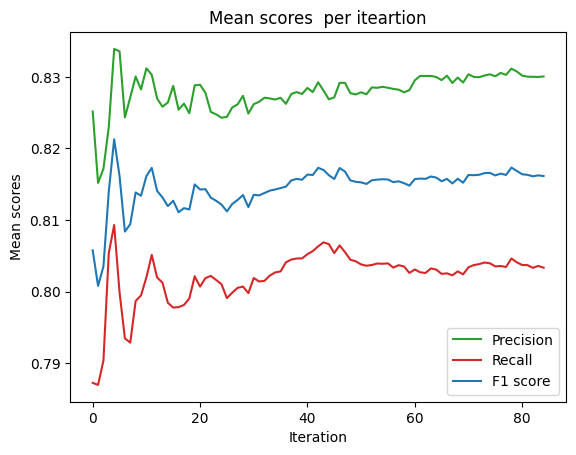

In [ ]:
def cum_mean(arr):
  cum_sum = np.cumsum(arr)
  return cum_sum/np.arange(1, len(arr) + 1)

plt.plot(cum_mean(P), color='#2ca02c',label='Precision')
plt.plot(cum_mean(R), color='#d62728',label='Recall')
plt.plot(cum_mean(F1),label='F1 score')

plt.ylabel('Mean scores')
plt.xlabel('Iteration')
plt.title("Mean scores  per iteartion")
plt.legend()
plt.show()

In [ ]:
biobert_true, biobert_gen = biobert_tuned["true_answer"], biobert_tuned["generated"]

In [ ]:
index = 10
biobert_true[index]

'The likely diagnosis is a brain abscess, which is a collection of pus within the brain tissue. Children with tetralogy of Fallot and recurrent sinusitis are at increased risk for developing brain abscesses due to the potential for bacteria from the sinuses to spread to the brain. Symptoms of a brain abscess may include headache, fever, focal neurological deficits, and seizures. Treatment for a brain abscess typically involves a combination of antibiotics to treat the underlying infection and surgical drainage to remove the pus. It is important to seek prompt medical attention if a brain abscess is suspected, as the condition can be life-threatening if left untreated.'

In [ ]:
biobert_gen[index]

'OBJECTIVES: Considering that the brain abscess is rare in infants'

In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_list = []
  patience = 20
  k = 0
  for i in range(len(biobert_gen)):
    real_answer = biobert_true[i]
    generated_answer = biobert_gen[i]
    if (generated_answer) is not None and (real_answer) is not None:
      score = evaluate_answer(real_answer, generated_answer)
      if i == 0:
        mean = score
      sum += score
      n_try += 1
      old_mean = mean
      mean = sum/n_try
      mean_list.append(mean)

      if abs(mean - old_mean) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: 0.11744680255651474 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: 0.175595972687006 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: 0.258323294421037 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: 0.25820917822420597 
Last relevant mean change is 1 iteration ago


Iteration: 4, Mean: 0.26685248166322706 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: 0.2526570148766041 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: 0.25179461389780045 
Last relevant mean change is 1 iteration ago


Iteration: 7, Mean: 0.24913175497204065 
Last relevant mean change is 0 iteration ago


Iteration: 8, Mean: 0.2732120230793953 
Last relevant mean change is 0 iteration ago


Iteration: 9, Mean: 0.2876469947397709 
Last relevant mean change is 0 iteration ago


Iteration: 10, Mean: 0.3185895173387094 
Last relevant mean change is 0 iteration ago


Iteration: 11, Mean: 0.3173826690763235

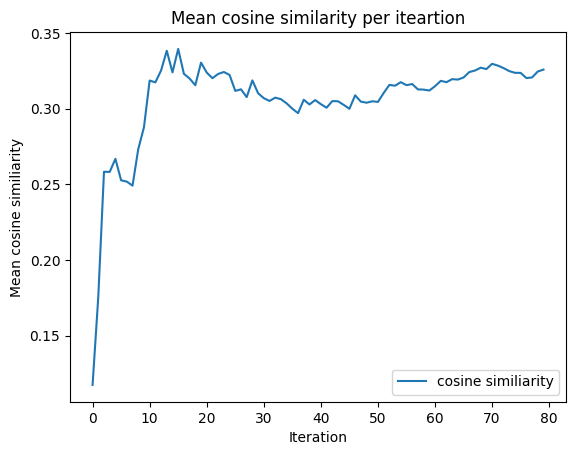

In [ ]:
if TEST_MODEL:
  plt.plot(mean_list, label='cosine similiarity')
  plt.ylabel('Mean cosine similiarity')
  plt.xlabel('Iteration')
  plt.title("Mean cosine similarity per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'the average cosine similarity is: {mean}')

the average cosine similarity is: 0.325814825668931


### BioBert raw model

In [ ]:
### BioBert ###

model_bio = "dmis-lab/biobert-base-cased-v1.2"
model = AutoModelForQuestionAnswering.from_pretrained(model_bio)
tokenizer = AutoTokenizer.from_pretrained(model_bio)

question_answerer = pipeline("question-answering", model=model , tokenizer=tokenizer)
scorer = BERTScorer(lang='en')

n_splits = 160
sections = np.linspace(0, len(dataset["test"]["input"]), n_splits+1)
n_sections = 4

P = np.array([])
R = np.array([])
F1 = np.array([])


for i in range(n_sections):
  print(i)
  first_index = int(sections[i])
  second_index= int(sections[i+1])
  results = question_answerer(question=dataset["test"]["input"][first_index : second_index], context=dataset["test"]["contexts"][first_index : second_index])
  results = pd.DataFrame(results)
  P_2, R_2, F1_2 = scorer.score(list(results["answer"]), dataset["test"]["output"][first_index : second_index])
  P = np.append(P, P_2)
  R = np.append(R, R_2)
  F1 = np.append(F1, F1_2)
  print(f"BERTScore Precision : {np.mean(P):.4f}, Recall: {np.mean(R):.4f}, F1: {np.mean(F1):.4f}  #samples: {int((len(dataset['test']['input'])/n_splits)*(i+1))}")

/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:89: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


config.json:   0%|          | 0.00/1.11k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/436M [00:00<?, ?B/s]

Some weights of BertForQuestionAnswering were not initialized from the model checkpoint at dmis-lab/biobert-base-cased-v1.2 and are newly initialized: ['qa_outputs.bias', 'qa_outputs.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
/usr/local/lib/python3.10/dist-packages/huggingface_hub/file_download.py:1132: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


vocab.txt:   0%|          | 0.00/213k [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/25.0 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/482 [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/899k [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/456k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/1.36M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/1.42G [00:00<?, ?B/s]

Some weights of RobertaModel were not initialized from the model checkpoint at roberta-large and are newly initialized: ['roberta.pooler.dense.bias', 'roberta.pooler.dense.weight']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


0
BERTScore Precision : 0.8026, Recall: 0.7883, F1: 0.7950  #samples: 21
1
BERTScore Precision : 0.8072, Recall: 0.7954, F1: 0.8009  #samples: 42
2
BERTScore Precision : 0.8078, Recall: 0.7903, F1: 0.7985  #samples: 64
3
BERTScore Precision : 0.8084, Recall: 0.7921, F1: 0.7998  #samples: 85


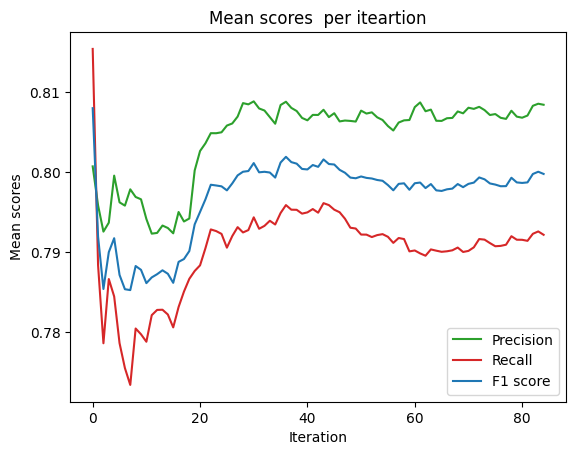

In [ ]:
def cum_mean(arr):
  cum_sum = np.cumsum(arr)
  return cum_sum/np.arange(1, len(arr) + 1)

plt.plot(cum_mean(P), color='#2ca02c',label='Precision')
plt.plot(cum_mean(R), color='#d62728',label='Recall')
plt.plot(cum_mean(F1),label='F1 score')

plt.ylabel('Mean scores')
plt.xlabel('Iteration')
plt.title("Mean scores  per iteartion")
plt.legend()
plt.show()

In [ ]:
if TEST_MODEL:
  sum = 0
  n_try = 0
  mean_list = []
  patience = 20
  k = 0
  for i in range(len(gpt_true)):
    real_answer = gpt_true[i]
    generated_answer = gpt_generated[i]
    if (generated_answer) is not None and (real_answer) is not None:
      score = evaluate_answer(real_answer, generated_answer)
      if i == 0:
        mean = score
      sum += score
      n_try += 1
      old_mean = mean
      mean = sum/n_try
      mean_list.append(mean)

      if abs(mean - old_mean) < 0.001:
        k += 1
        if k == patience:
          print(f'Early stopping at iteration: {i}')
          break
      else:
        k=0
      print(f'Iteration: {i}, Mean: {mean} \nLast relevant mean change is {k} iteration ago\n\n')

Iteration: 0, Mean: 0.15789751708507538 
Last relevant mean change is 1 iteration ago


Iteration: 1, Mean: 0.2884761914610863 
Last relevant mean change is 0 iteration ago


Iteration: 2, Mean: 0.27263110379378 
Last relevant mean change is 0 iteration ago


Iteration: 3, Mean: 0.22664865851402283 
Last relevant mean change is 0 iteration ago


Iteration: 4, Mean: 0.25683032274246215 
Last relevant mean change is 0 iteration ago


Iteration: 5, Mean: 0.30811987320582074 
Last relevant mean change is 0 iteration ago


Iteration: 6, Mean: 0.301903452192034 
Last relevant mean change is 0 iteration ago


Iteration: 7, Mean: 0.2679557001683861 
Last relevant mean change is 0 iteration ago


Iteration: 8, Mean: 0.24461614816553062 
Last relevant mean change is 0 iteration ago


Iteration: 9, Mean: 0.23686635550111532 
Last relevant mean change is 0 iteration ago


Iteration: 10, Mean: 0.25239223292605445 
Last relevant mean change is 0 iteration ago


Iteration: 11, Mean: 0.251187316297243

/usr/local/lib/python3.10/dist-packages/scipy/spatial/distance.py:636: RuntimeWarning: invalid value encountered in scalar divide
  dist = 1.0 - uv / np.sqrt(uu * vv)


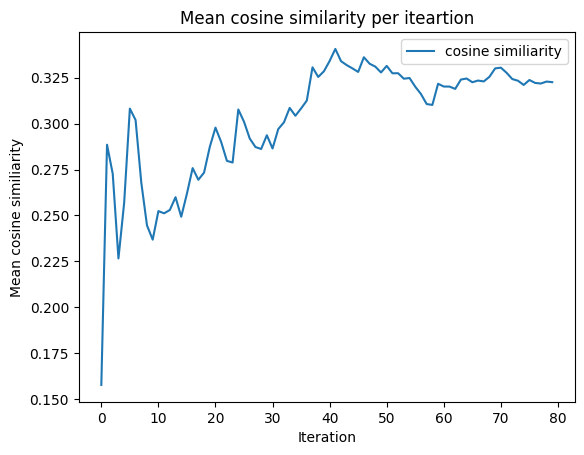

In [ ]:
if TEST_MODEL:
  plt.plot(mean_list, label='cosine similiarity')
  plt.ylabel('Mean cosine similiarity')
  plt.xlabel('Iteration')
  plt.title("Mean cosine similarity per iteartion")
  plt.legend()
  plt.show()

In [ ]:
if TEST_MODEL:
  print(f'the average cosine similarity is: {mean}')

the average cosine similarity is: 0.3224922968773171


##Promotheus

To use Prometheus for scoring the answers, it is necessary to define a prompt with specific evaluation criteria to serve as a scoring rubric for the model.
In our case, we defined the evaluation criteria as follows:

* Score 0: The model does not answer correctly

* Score 1: The model does not answer correctly to the user's question omitting important informations (synonyms are accepted).

* Score 2: The model answer correctly to the user's question omitting more relavant informations and adding incorrect and irrelevant informations (synonyms are accepted).

* Score 3: The model answer correctly to the user's question omitting more relevant informations and adding only correct and relevant informations (synonyms are accepted).

* Score 4: The model answer correctly to the user's question omitting only one relevant information and adding only correct and relevant informations (synonyms are accepted).

* Score 5: The model answer correctly to the user's question without omitting any relevant information and adding only correct and relevant informations (synonyms are accepted).


In [ ]:
tokenizer = AutoTokenizer.from_pretrained("meta-llama/Llama-2-7b-chat-hf")
model = LlamaForCausalLM.from_pretrained("kaist-ai/Prometheus-7b-v1.0")

input_text = """###Task Description: An instruction (might include an Input inside it), a response to evaluate, a reference answer that gets a score of 5, and a score rubric representing a evaluation criteria are given.

1. Write a detailed feedback that assess the quality of the response strictly based on the given score rubric, not evaluating in general.

2. After writing a feedback, write a score that is an integer between 1 and 5. You should refer to the score rubric.

3. The output format should look as follows: "Feedback: (write a feedback for criteria) [RESULT] (an integer number between 1 and 5)"

4. Please do not generate any other opening, closing, and explanations.

###The instruction to evaluate: What does it mean if the relative risk is less than 1 in relation to exposure and disease occurrence?

###Response to evaluate: If the relative risk is less than 1 in relation to exposure and disease occurrence, it means that there is a significant difference between the risk of disease occurrence and the risk of exposure to the disease

###Reference Answer (Score 5):  If the relative risk is less than 1, it means that exposure to a particular factor or variable is associated with a decreased occurrence of the disease in question. In other words, individuals who are exposed to the factor or variable are less likely to develop the disease than those who are not exposed. The relative risk is a measure of the strength of the association between exposure and disease occurrence, and a value less than 1 indicates a negative association.

###Score Rubrics:

[Is the model able to answer correctly to the user's question?]

Score 0: The model does not answer correctly

Score 1: The model does not answer correctly to the user's question omitting important informations (synonyms are accepted).

Score 2: The model answer correctly to the user's question omitting more relavant informations and adding incorrect and irrelevant informations (synonyms are accepted).

Score 3: The model answer correctly to the user's question omitting more relevant informations and adding only correct and relevant informations (synonyms are accepted).

Score 4: The model answer correctly to the user's question omitting only one relevant information and adding only correct and relevant informations (synonyms are accepted).

Score 5: The model answer correctly to the user's question without omitting any relevant information and adding only correct and relevant informations (synonyms are accepted).

###Feedback:

"""


In [ ]:
input_ids = tokenizer(input_text, return_tensors="pt").input_ids

outputs = model.generate(input_ids, max_new_tokens = 128, pad_token_id=2)
print(tokenizer.decode(outputs[0]))

<s> ###Task Description: An instruction (might include an Input inside it), a response to evaluate, a reference answer that gets a score of 5, and a score rubric representing a evaluation criteria are given. 

1. Write a detailed feedback that assess the quality of the response strictly based on the given score rubric, not evaluating in general. 

2. After writing a feedback, write a score that is an integer between 1 and 5. You should refer to the score rubric. 

3. The output format should look as follows: "Feedback: (write a feedback for criteria) [RESULT] (an integer number between 1 and 5)" 

4. Please do not generate any other opening, closing, and explanations. 

###The instruction to evaluate: What does it mean if the relative risk is less than 1 in relation to exposure and disease occurrence?

###Response to evaluate: If the relative risk is less than 1 in relation to exposure and disease occurrence, it means that there is a significant difference between the risk of disease o

The model is highly capable of evaluating generated answers with a level of precision and adherence to the rubric comparable to that of a human evaluator. This stringent evaluation method could provide excellent insights into the model's performance. However, despite its potential, this approach is impractical due to the substantial computational resources it demands, especially when compared to statistical or embedding-based evaluation methods.

##Results


In [ ]:
os.chdir(f'/content/')
os.getcwd()
score_dataset = pd.read_csv('scores.csv')

In [ ]:
score_dataset

,Model,Cosine similarity,Precision,Recall,F1 score,Execution time
0,Tuned Mistral,"0,82","0,924","0,913","0,918","4,613"
1,Tuned Llama,"0,813","0,882","0,91","0,882","3,809"
2,Tuned Gemma,"0,811","0,926","0,911","0,918","4,391"
3,Tuned Tiny Llama,"0,783","0,919","0,895","0,906","2,435"
4,Tuned GPT,"0,727","0,892","0,889","0,89","30,094"
5,Mistral,"0,726","0,837","0,871","0,853","7,33"
6,Llama,"0,694","0,838","0,856","0,848","4,37"
7,GPT,"0,63","0,591","0,713","0,639","31,16"
8,Gemma,"0,556","0,799","0,843","0,819","9,198"
9,Tuned BERT,"0,326","0,83","0,803","0,816","1,23"


As per the above table we can see that the **MedTinyLlama** and **MedGemma** model are the Best models with **90.6** and **91.6** **F1 score** respectively, which was evaluated using the BertScore.

If we also check the cosine similarity of the best two models they are giving good results.

**MedTinyLlama:** 0.78

**MedGemma:** 0.81

We choose TinyLlama as the best model for us due to following reasons mentioned below:


*   The Execution Time of the TinyLlama is less compared to the MedGemma model which helps us to inference in less time.
*   TinyLlama, which boasts 1.1 billion parameters, its applications are mainly suited to environments where larger models might not be as feasible due to hardware limitations or greater efficiency.
* As the F1 Score of TinyLlamma is just 1% less than the MedGemma model we choose it to be our best model.


The best cosine similarity was from the model **MedMistral** as the result from the model where more similar in terms of embeddings.






# Extensions

# Voice Interactive Systems - Introduction

**Enhancing Question-Answering System with TTS and STT**

Text-to-Speech (TTS) and Speech-to-Text (STT) technologies significantly enhance the usability of applications like chatbots and question-answering systems. TTS allows to provide spoken responses, making interactions more natural and accessible, especially for users who prefer or require auditory communication. STT enables users to ask questions verbally, making the interaction hands-free and more convenient. Together, these technologies create a more engaging and efficient user experience, broadening the accessibility and practicality of question-answering applications in various contexts.

**Our Work**

 In the following code blocks, we present an implementation of a voice-interactive question-answering system. The main components are:



*   **Whisper model as SST Technology**: Utilized for automatic speech recognition

*   **Question-answering System**: Based on a pre-trained Large Language Model fine-tuned specifically for medical question-answering taks. Given a medical question obtained through the STT technology, the system is capable of providing a sufficiently accurate and relevant answer.

*   **Tacotron2 and WaveGlow models as TTS Technologies**: Employed to synthetize natural-sounding speech from raw trnascripts , which is going to correspond to the answer of the question-answering systems, without additional prosody information

This combination of advanced STT and TTS technologies, along with a specialized LLM, creates a robust and efficient voice-interactive system capable of handling complex medical inquiries.



## Install and Import

Let's install and then impot some useful libraries

In [ ]:
! pip install --upgrade pip
! pip install --upgrade git+https://github.com//huggingface/transformers.git accelerate datasets[audio]

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 13.2 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 23.1.2
    Uninstalling pip-23.1.2:
      Successfully uninstalled pip-23.1.2
  Cloning https://github.com//huggingface/transformers.git to /tmp/pip-req-build-ko3uaeaj
  Running command git clone --filter=blob:none --quiet https://github.com//huggingface/transformers.git /tmp/pip-req-build-ko3uaeaj
  Resolved https://github.com//huggingface/transformers.git to commit bdb9106f247fca48a71eb384be25dbbd29b065a8
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Installing backend dependencies ... done
  Preparing metadata (pyproject.toml) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 302.6/302.6 kB 9.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 9.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 410.6/410.6 MB 3.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━

In [ ]:
!pip install --upgrade transformers optimum accelerate

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.0/138.0 kB 4.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 417.0/417.0 kB 9.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.0/9.0 MB 30.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 46.0/46.0 kB 3.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.8/86.8 kB 9.1 MB/s eta 0:00:00
  Attempting uninstall: transformers
    Found existing installation: transformers 4.42.0.dev0
    Uninstalling transformers-4.42.0.dev0:
      Successfully uninstalled transformers-4.42.0.dev0


In [ ]:
!pip install ffmpeg-python

In [ ]:
!pip install numpy scipy librosa unidecode inflect

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 235.5/235.5 kB 7.3 MB/s eta 0:00:00


In [ ]:
%%capture
# Installs Unsloth, Xformers (Flash Attention) and all other packages!
!pip install "unsloth[colab-new] @ git+https://github.com/unslothai/unsloth.git"
!pip install --no-deps xformers trl peft accelerate bitsandbytes

In [ ]:
import torch

from transformers import AutoModelForSpeechSeq2Seq, AutoProcessor, pipeline
from transformers.utils import is_flash_attn_2_available

from datasets import load_dataset

from google.colab.output import eval_js
from google.colab import drive

from IPython.display import HTML, Audio

from base64 import b64decode

import numpy as np

import ffmpeg

import io
from scipy.io.wavfile import read as wav_read
from scipy.io.wavfile import write

import os

from unsloth import FastLanguageModel

import time

🦥 Unsloth: Will patch your computer to enable 2x faster free finetuning.


## Setup

In [ ]:
MODEL_PATH = '/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/Mistral'
drive.mount('/content/drive')
os.chdir(f'{MODEL_PATH}')
os.getcwd()

Mounted at /content/drive


'/content/drive/MyDrive/Colab Notebooks/NLP/project/Models/Mistral'

Set to true **FAST_WHISPER** to use the fast Whisper model. Note that a GPU is required for this mode.

In [ ]:
FAST_WHISPER= True

# Speech-To-Text Technologies: Whisper Model

Whisper is an automatic speech recognition (ASR) system trained on 680,000 hours of multilingual and multitask supervised data collected from the web. The use of such a large and diverse dataset leads to improved robustness to accents, background noise, and technical language. Moreover, it enables transcription in multiple languages, as well as translation from those languages into English. Whisper's performance varies widely depending on the language.

There are five model sizes, four with English-only versions, offering speed and accuracy tradeoffs.

In order to guarantee a pleasant user experience, tiny, base, and small sizes of Whisper should be used. Even though they have 39M, 74M, and 244M parameters, respectively, they are capable of providing correct transcriptions in a short amount of time without strict constraints on resources and hardware.

Later, we'll explore a faster implementation that will allow us to use larger sizes without having to wait too long for an answer.


In [ ]:
device = "cuda:0" if torch.cuda.is_available() else "cpu"
torch_dtype = torch.float16 if torch.cuda.is_available() else torch.float32

model_id = "openai/whisper-small"
model = AutoModelForSpeechSeq2Seq.from_pretrained(
      model_id, torch_dtype = torch_dtype, low_cpu_mem_usage=True, use_safetensors=True
)
model.to(device)

processor = AutoProcessor.from_pretrained(model_id)

pipe = pipeline(
      "automatic-speech-recognition",
      model = model,
      tokenizer= processor.tokenizer,
      feature_extractor= processor.feature_extractor,
      max_new_tokens=128,
      chunk_length_s = 30,
      batch_size= 16,
      return_timestamps=True,
      torch_dtype=torch_dtype,
      device=device
  )

config.json:   0%|          | 0.00/1.97k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/967M [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/3.87k [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/185k [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/283k [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/836k [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.48M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/494k [00:00<?, ?B/s]

normalizer.json:   0%|          | 0.00/52.7k [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/34.6k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/2.19k [00:00<?, ?B/s]

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


A faster implmentation of Whisper has recently been released, leveraging flash attention 2. To utilize this implementation, a GPU must be available.  Flash Attention provides a more memory-efficient approach and increases efficiency due to optimized GPU memory utilization.
Flash Attention 2 is an evolution of the original Flash Attention. It exploits the asymmetric GPU memory hierarchy to bring significant memory saving (linear instead of quadratic) and runtime speedup (2-4× compared to optimized baselines) with no approximation

The latter model enables us to utilize larger sizes, such as large-v3, which boasts 1550M parameters.

In [ ]:
pipe_fast = pipeline(
      "automatic-speech-recognition",
      model="openai/whisper-large-v3", # select checkpoint from https://huggingface.co/openai/whisper-large-v3#model-details
      torch_dtype=torch.float16,
      device="cuda:0", # or mps for Mac devices
      model_kwargs={"attn_implementation": "flash_attention_2"} if is_flash_attn_2_available() else {"attn_implementation": "sdpa"},
  )

config.json:   0%|          | 0.00/1.27k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/3.09G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/3.90k [00:00<?, ?B/s]

tokenizer_config.json:   0%|          | 0.00/283k [00:00<?, ?B/s]

vocab.json:   0%|          | 0.00/1.04M [00:00<?, ?B/s]

tokenizer.json:   0%|          | 0.00/2.48M [00:00<?, ?B/s]

merges.txt:   0%|          | 0.00/494k [00:00<?, ?B/s]

normalizer.json:   0%|          | 0.00/52.7k [00:00<?, ?B/s]

added_tokens.json:   0%|          | 0.00/34.6k [00:00<?, ?B/s]

special_tokens_map.json:   0%|          | 0.00/2.07k [00:00<?, ?B/s]

Special tokens have been added in the vocabulary, make sure the associated word embeddings are fine-tuned or trained.


preprocessor_config.json:   0%|          | 0.00/340 [00:00<?, ?B/s]

# Text-To-Speech Technologies: Tacotron2 and WaveGlow

Tacotron 2 and WaveGlow form a text-to-speech system, synthesizing natural-sounding speech from raw transcripts without additional prosody information. Tacotron 2 utilizes an encoder-decoder architecture to produce mel spectrograms from input text, while WaveGlow is a flow-based model that generates speech from these spectrograms. Hence, A Vocoder which convert the spectrogram into an audio signal

Moreover, models like Bark offer an alternative approach to synthesizing natural speech. Bark skips the spectrogram stage by using transformers directly from text to audio waveform.

Tacotron remains the preferred choice in a multitude of cases. Its nuanced approach to predicting spectrograms allows for precise control over various aspects of synthesized speech, including intonation, rhythm, and overall naturalness.


Load the Tacotron model from Torchhub:

In [ ]:
tacotron2 = torch.hub.load('NVIDIA/DeepLearningExamples:torchhub', 'nvidia_tacotron2', model_math='fp16')
tacotron2 = tacotron2.to('cuda')
tacotron2.eval()

Downloading: "https://github.com/NVIDIA/DeepLearningExamples/zipball/torchhub" to /root/.cache/torch/hub/torchhub.zip
/root/.cache/torch/hub/NVIDIA_DeepLearningExamples_torchhub/PyTorch/Classification/ConvNets/image_classification/models/common.py:13: UserWarning: pytorch_quantization module not found, quantization will not be available
  warnings.warn(
/root/.cache/torch/hub/NVIDIA_DeepLearningExamples_torchhub/PyTorch/Classification/ConvNets/image_classification/models/efficientnet.py:17: UserWarning: pytorch_quantization module not found, quantization will not be available
  warnings.warn(


Tacotron2(
  (embedding): Embedding(148, 512)
  (encoder): Encoder(
    (convolutions): ModuleList(
      (0-2): 3 x Sequential(
        (0): ConvNorm(
          (conv): Conv1d(512, 512, kernel_size=(5,), stride=(1,), padding=(2,))
        )
        (1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
    )
    (lstm): LSTM(512, 256, batch_first=True, bidirectional=True)
  )
  (decoder): Decoder(
    (prenet): Prenet(
      (layers): ModuleList(
        (0): LinearNorm(
          (linear_layer): Linear(in_features=80, out_features=256, bias=False)
        )
        (1): LinearNorm(
          (linear_layer): Linear(in_features=256, out_features=256, bias=False)
        )
      )
    )
    (attention_rnn): LSTMCell(768, 1024)
    (attention_layer): Attention(
      (query_layer): LinearNorm(
        (linear_layer): Linear(in_features=1024, out_features=128, bias=False)
      )
      (memory_layer): LinearNorm(
        (linear_layer): Linear(in_fea

Load the waveglow model as follows:

In [ ]:
waveglow = torch.hub.load('NVIDIA/DeepLearningExamples:torchhub', 'nvidia_waveglow', model_math='fp16')
waveglow = waveglow.remove_weightnorm(waveglow)
waveglow = waveglow.to('cuda')
waveglow.eval()

Using cache found in /root/.cache/torch/hub/NVIDIA_DeepLearningExamples_torchhub


WaveGlow(
  (upsample): ConvTranspose1d(80, 80, kernel_size=(1024,), stride=(256,))
  (WN): ModuleList(
    (0-3): 4 x WN(
      (in_layers): ModuleList(
        (0): Conv1d(512, 1024, kernel_size=(3,), stride=(1,), padding=(1,))
        (1): Conv1d(512, 1024, kernel_size=(3,), stride=(1,), padding=(2,), dilation=(2,))
        (2): Conv1d(512, 1024, kernel_size=(3,), stride=(1,), padding=(4,), dilation=(4,))
        (3): Conv1d(512, 1024, kernel_size=(3,), stride=(1,), padding=(8,), dilation=(8,))
        (4): Conv1d(512, 1024, kernel_size=(3,), stride=(1,), padding=(16,), dilation=(16,))
        (5): Conv1d(512, 1024, kernel_size=(3,), stride=(1,), padding=(32,), dilation=(32,))
        (6): Conv1d(512, 1024, kernel_size=(3,), stride=(1,), padding=(64,), dilation=(64,))
        (7): Conv1d(512, 1024, kernel_size=(3,), stride=(1,), padding=(128,), dilation=(128,))
      )
      (res_skip_layers): ModuleList(
        (0-6): 7 x Conv1d(512, 1024, kernel_size=(1,), stride=(1,))
        (7

# Question-Answering model

The upcoming lines of code loads a pre-trained LLM and tokenizer with specified parameters and enables native 2x faster inference

In [ ]:
max_seq_length = 4096   # TinyLlama's internal maximum sequence length is 2048. We use RoPE Scaling to extend it to 4096 with Unsloth!
dtype = None            # None for auto detection. Float16 for Tesla T4, V100, Bfloat16 for Ampere+
load_in_4bit = True     # Use 4bit quantization to reduce memory usage. Can be False.

In [ ]:
model, tokenizer = FastLanguageModel.from_pretrained(
    model_name = "lora_model", # YOUR MODEL YOU USED FOR TRAINING
    max_seq_length = max_seq_length,
    dtype = dtype,
    load_in_4bit = load_in_4bit,
)
FastLanguageModel.for_inference(model) # Enable native 2x faster inference

config.json:   0%|          | 0.00/1.15k [00:00<?, ?B/s]

==((====))==  Unsloth: Fast Mistral patching release 2024.5
   \\   /|    GPU: Tesla T4. Max memory: 14.748 GB. Platform = Linux.
O^O/ \_/ \    Pytorch: 2.3.0+cu121. CUDA = 7.5. CUDA Toolkit = 12.1.
\        /    Bfloat16 = FALSE. Xformers = 0.0.26.post1. FA = False.
 "-____-"     Free Apache license: http://github.com/unslothai/unsloth


model.safetensors:   0%|          | 0.00/4.14G [00:00<?, ?B/s]

generation_config.json:   0%|          | 0.00/111 [00:00<?, ?B/s]

You set `add_prefix_space`. The tokenizer needs to be converted from the slow tokenizers
Unsloth 2024.5 patched 32 layers with 32 QKV layers, 32 O layers and 32 MLP layers.


In [ ]:
alpaca_prompt = """Below is an instruction that describes a task, paired with an input that provides further context. Write a response that appropriately completes the request.

### Instruction:
{}

### Input:
{}

### Response:
{}"""

EOS_TOKEN = tokenizer.eos_token
def formatting_prompts_func(examples):
    instructions = examples["instruction"]
    inputs       = examples["input"]
    outputs      = examples["output"]
    texts = []
    for instruction, input, output in zip(instructions, inputs, outputs):
        # Must add EOS_TOKEN, otherwise your generation will go on forever!
        text = alpaca_prompt.format(instruction, input, output) + EOS_TOKEN
        texts.append(text)
    return { "text" : texts, }
pass


The following block of code uses the pre-trained fine-tuned model to generate an answer for a given question

In [ ]:
def generate_answer(question):
  # alpaca_prompt = Copied from above
  FastLanguageModel.for_inference(model) # Enable native 2x faster inference
  inputs = tokenizer(
  [
      alpaca_prompt.format(
          "Answer this question truthfully", # instruction
          question, # input
          "", # output - leave this blank for generation!
      )
  ], return_tensors = "pt").to("cuda")

  outputs = model.generate(**inputs, max_new_tokens = 128, use_cache = True, pad_token_id=tokenizer.eos_token_id)
  tokenizer.batch_decode(outputs)
  predicted_answer = tokenizer.batch_decode(outputs[:, inputs['input_ids'].shape[1]:])[0]
  predicted_answer = predicted_answer[:(len(predicted_answer)-5)]
  return predicted_answer

# Audio Recording

Let's define a function to record our own voice

In [ ]:
AUDIO_HTML = """
<script>
var my_div = document.createElement("DIV");
var my_p = document.createElement("P");
var my_btn = document.createElement("BUTTON");
var t = document.createTextNode("Press to start recording");

my_btn.appendChild(t);
//my_p.appendChild(my_btn);
my_div.appendChild(my_btn);
document.body.appendChild(my_div);

var base64data = 0;
var reader;
var recorder, gumStream;
var recordButton = my_btn;

var handleSuccess = function(stream) {
  gumStream = stream;
  var options = {
    //bitsPerSecond: 8000, //chrome seems to ignore, always 48k
    mimeType : 'audio/webm;codecs=opus'
    //mimeType : 'audio/webm;codecs=pcm'
  };
  //recorder = new MediaRecorder(stream, options);
  recorder = new MediaRecorder(stream);
  recorder.ondataavailable = function(e) {
    var url = URL.createObjectURL(e.data);
    var preview = document.createElement('audio');
    preview.controls = true;
    preview.src = url;
    document.body.appendChild(preview);

    reader = new FileReader();
    reader.readAsDataURL(e.data);
    reader.onloadend = function() {
      base64data = reader.result;
      //console.log("Inside FileReader:" + base64data);
    }
  };
  recorder.start();
  };

recordButton.innerText = "Recording... press to stop";

navigator.mediaDevices.getUserMedia({audio: true}).then(handleSuccess);


function toggleRecording() {
  if (recorder && recorder.state == "recording") {
      recorder.stop();
      gumStream.getAudioTracks()[0].stop();
      recordButton.innerText = "Saving the recording... pls wait!"
  }
}

// https://stackoverflow.com/a/951057
function sleep(ms) {
  return new Promise(resolve => setTimeout(resolve, ms));
}

var data = new Promise(resolve=>{
//recordButton.addEventListener("click", toggleRecording);
recordButton.onclick = ()=>{
toggleRecording()

sleep(2000).then(() => {
  // wait 2000ms for the data to be available...
  // ideally this should use something like await...
  //console.log("Inside data:" + base64data)
  resolve(base64data.toString())

});

}
});

</script>
"""

def get_audio():
  display(HTML(AUDIO_HTML))
  data = eval_js("data")
  binary = b64decode(data.split(',')[1])

  process = (ffmpeg
    .input('pipe:0')
    .output('pipe:1', format='wav')
    .run_async(pipe_stdin=True, pipe_stdout=True, pipe_stderr=True, quiet=True, overwrite_output=True)
  )
  output, err = process.communicate(input=binary)

  with open('audio.wav', 'wb') as f:
    f.write(output)

  return 'audio.wav'

# Interactive Question-Answering Function

This function processes user question via audio input, genereates textual responses and convert them into synthesized speech.

In [ ]:
def voice_interactive_QnA(pipe, isFast):
  audio = get_audio()
  if isFast:
    question = pipe(audio, chunk_length_s=30, batch_size=24, return_timestamps=True)
  else:
    question = pipe(audio, generate_kwargs={"language": "english"})

  text = generate_answer(question["text"])
  # Split text into sentences
  sentences = text.split('. ')

  # Generate audio for each sentence and concatenate
  audio_clips = []
  utils = torch.hub.load('NVIDIA/DeepLearningExamples:torchhub', 'nvidia_tts_utils')
  for sentence in sentences:
      # Ensure each sentence ends with a period for proper pronunciation
      if not sentence.endswith('.'):
          sentence += '.'

      # Process the sentence text
      sequences, lengths = utils.prepare_input_sequence([sentence])
      with torch.no_grad():
        mel, _, _ = tacotron2.infer(sequences, lengths)

      # Get the sampling rate and the generated speech
      with torch.no_grad():
        audio = waveglow.infer(mel)
      audio_numpy = audio[0].data.cpu().numpy()
      rate = 22050

      audio_clips.append(audio_numpy)

  # Concatenate all audio arrays
  final_audio_array = np.concatenate(audio_clips)

  # Save the concatenated audio to a file


  # If you have librosa and soundfile installed, you can save the audio like this:
  #import soundfile as sf
  #sf.write("final_output.wav", final_audio_array, rate)

  return final_audio_array, question["text"]
  # Or, if you want to play it directly in Python
  #from IPython.display import Audio
  #Audio(data=final_audio_array, rate=rate)

# Welcome to MedCortana

This is a brief guide on how to use it:


1.  **Start Recording**: Once the code cell is executed, a button will appear, signaling that the recording has commenced. Speak your question clearly into the microphone

2.  **Stop Recording**: Once you've finished your question, press the button again to stop the recording

3. **Processing**: The system will take 30 to 60 seconds to generate a response, depending on the length of the question

4. **Playback**: Your recording will appear, and you can listen to the generated response

5. **Continue or Quit**: After the playback, the system will ask if you want to continue with further questions or quit. Press Ener to continue or type 'exit' to quit

That being said, enjoy MedCortana!



In [ ]:
while True:
  answer, question = voice_interactive_QnA(pipe_fast, FAST_WHISPER)
  print(f'User: {question}')
  print("MedCortana:")
  display(Audio(data=answer, rate=22050))
  time.sleep(3)
  user_input = input("Press Enter to continue or type 'exit' to quit: ")
  print("--------------------------------------------------------------------------------------------------------------------------------------------")
  # Check if the user wants to continue or exit
  if user_input.lower() == 'exit':
      break

Due to a bug fix in https://github.com/huggingface/transformers/pull/28687 transcription using a multilingual Whisper will default to language detection followed by transcription instead of translation to English.This might be a breaking change for your use case. If you want to instead always translate your audio to English, make sure to pass `language='en'`.
Using cache found in /root/.cache/torch/hub/NVIDIA_DeepLearningExamples_torchhub
/root/.cache/torch/hub/NVIDIA_DeepLearningExamples_torchhub/PyTorch/SpeechSynthesis/Tacotron2/tacotron2/text/__init__.py:74: SyntaxWarning: "is not" with a literal. Did you mean "!="?
  return s in _symbol_to_id and s is not '_' and s is not '~'
/root/.cache/torch/hub/NVIDIA_DeepLearningExamples_torchhub/PyTorch/SpeechSynthesis/Tacotron2/tacotron2/text/__init__.py:74: SyntaxWarning: "is not" with a literal. Did you mean "!="?
  return s in _symbol_to_id and s is not '_' and s is not '~'


User:  What is the PAP test?
MedCortana:


Press Enter to continue or type 'exit' to quit: exit
--------------------------------------------------------------------------------------------------------------------------------------------
